In [20]:
from disease import Disease, StringAPI
import requests
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt
import pandas as pd
import json
import numpy as np
import random

allCancers = list(set(nx.ancestors(efo_graph, "MONDO:0004992")))



def compute_clustering(diseases, filename):
    output = []
    for name, efo_id in diseases:
        disease = Disease(name, efo_id)
        try:
            num_edges, z_score = disease.quantify_clustering()
            output.append({'name' : name, 'efoID' : efo_id, 'num_edges' : num_edges, 'z_score' : z_score})
        except Exception as e:
            print(f"Error processing {name}: {e}")
    with open(filename, 'w') as file:
        for entry in output:
            file.write(f"Name: {entry['name']}, EFO ID: {entry['efoID']}, Num Edges: {entry['num_edges']}, Z-Score: {entry['z_score']}\n")
    return output

def compare(cancerous, noncancerous, sample_size=50):
    if len(noncancerous) > sample_size:
        non_cancerous_sample = random.sample(noncancerous, sample_size)
    else:
        non_cancerous_sample = noncancerous
        
    if len(cancerous) > sample_size:
        cancerous_sample = random.sample(cancerous, sample_size)
    else:
        cancerous_sample = cancerous
        
    cancer_edges = [d['num_edges'] for d in cancerous_sample]
    non_cancer_edges = [d['num_edges'] for d in non_cancerous_sample]
    
    cancer_z = [d['z_score'] for d in cancerous_sample]
    non_cancer_z = [d['z_score'] for  d in non_cancerous_sample]
    
    t_stat, p_value = ttest_ind(cancer_edges, non_cancer_edges, equal_var=False)

    plt.boxplot([cancer_edges, non_cancer_edges], labels=['Cancerous', 'Non-Cancerous'])
    plt.title(f'Clustering Comparison\np-value: {p_value:.2e}')
    plt.ylabel('Number of Edges')
    plt.show()

    print(f"True number of edges\nT-statistic: {t_stat}, P-value: {p_value}\n")
    
    t_stat, p_value = ttest_ind(cancer_z, non_cancer_z, equal_var=False)

    plt.boxplot([cancer_z, non_cancer_z], labels=['Cancerous', 'Non-Cancerous'])
    plt.title(f'Clustering Comparison\np-value: {p_value:.2e}')
    plt.ylabel('Z scores for random numbers of edges')
    plt.show()

    print(f"Z scores for random numbers of edges\nT-statistic: {t_stat}, P-value: {p_value}\n")

In [1]:
with open("data/allDiseases.txt", "r") as file:
    diseases = []
    for line in file:
        id, name = line.strip().split('\t')
        diseases.append({'efoID' : id.replace(":", "_"), 'name' : name})
print(len(diseases))
print(diseases)
    


1322
[{'efoID': 'EFO_0000274', 'name': 'atopic eczema'}, {'efoID': 'EFO_0000676', 'name': 'psoriatic arthritis, psoriasis'}, {'efoID': 'EFO_0005427', 'name': 'social communication impairment'}, {'efoID': 'EFO_0006516', 'name': 'superior frontal gyrus grey matter volume measurement'}, {'efoID': 'MONDO_0018309', 'name': 'Hirschsprung disease'}, {'efoID': 'EFO_0006522', 'name': 'asymmetrical dimethylarginine measurement'}, {'efoID': 'EFO_0006523', 'name': 'symmetrical dimethylarginine measurement'}, {'efoID': 'EFO_0004314', 'name': 'forced expiratory volume'}, {'efoID': 'EFO_0005854', 'name': 'allergic rhinitis'}, {'efoID': 'EFO_0003918', 'name': 'obstructive sleep apnea'}, {'efoID': 'EFO_0003884', 'name': 'chronic kidney disease'}, {'efoID': 'EFO_0004239', 'name': 'chronic hepatitis B virus infection'}, {'efoID': 'EFO_0004216', 'name': 'attention deficit hyperactivity disorder, conduct disorder'}, {'efoID': 'EFO_0000305', 'name': 'contraception, breast carcinoma'}, {'efoID': 'EFO_0001663

In [19]:
cancerous, noncancerous = filter_cancerous_diseases(diseases)
print(len(cancerous))
print(len(noncancerous))


[('contraception, breast carcinoma', 'EFO_0000305'), ('carrier status, prostate carcinoma', 'EFO_0001663'), ('urinary bladder carcinoma', 'MONDO_0004986'), ('laryngeal squamous cell carcinoma', 'EFO_0006352'), ('esophageal carcinoma', 'EFO_0002916'), ('lung carcinoma', 'EFO_0001071'), ('squamous cell carcinoma', 'EFO_0000707'), ('lung adenocarcinoma', 'EFO_0000571'), ('nasopharyngeal neoplasm', 'EFO_0004252'), ('non-small cell lung carcinoma', 'EFO_0003060'), ('triple-negative breast cancer', 'EFO_0005537'), ('colorectal cancer', 'MONDO_0005575'), ('endometrial endometrioid carcinoma', 'EFO_1001514'), ('endometrial carcinoma', 'EFO_1001512'), ('squamous cell lung carcinoma', 'EFO_0000708'), ('gastric carcinoma', 'EFO_0000178'), ('gastric adenocarcinoma', 'EFO_0000503'), ('estrogen-receptor negative breast cancer', 'EFO_1000650'), ('ovarian mucinous adenocarcinoma', 'EFO_0006462'), ('cervical carcinoma', 'EFO_0001061'), ('pancreatic carcinoma', 'EFO_0002618'), ('gastric cardia carcinoma

In [23]:
print(len(noncancerous))
print(len(cancerous[:10]))

1222
10


Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000305/associations?projection=associationByStudy
Genes: 252

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GLG1%0dRAD51L1%0dintergenic%0dFGFR2%0dMAP3K1%0dTOX3%0dESR1%0dC6orf97%0dSLC4A7%0dKLF4%0dACTL7A%0dRAD23B%0dTNRC9%0dLOC643714%0dLSP1%0dCDKN2A%0dCDKN2B%0dANKRD16%0dFBXO18%0dZNF365%0dZMIZ1%0dFGF3%0dMYEOV%0dCCND1%0dORAOV1%0dFGF19%0dFGF4%0dECHDC1%0dRNF146%0dMRPS30%0dERBB4%0dLRRN2%0dPIK3C2B%0dMDM4%0dLGR6%0dUBE2T%0dPTPN7%0dFTO%0dKIAA1752%0dTERT%0dPTHLH%0dMERIT40%0dPEX14%0dEBF1%0dNTN4%0dBRCA2%0dN4BP2L1%0dMIR1972-2%0dMKL1%0dTNIP3%0dSLC45A1%0dSIAH2%0dTCF7L2%0dNR%0dBCL2L15%0dAP4B1%0dDCLRE1B%0dHIPK1%0dPTPN22%0dMETAP1D%0dDLX1%0dDLX2%0dDIRC3%0dITPR1%0dEGOT%0dTGFBR2%0dTET2%0dADAM29%0dRAB3C%0dFOXQ1%0dRANBP9%0dARHGEF5%0dNOBOX%0dMYC%0dMIR1208%0dDNAJC1%0dMLLT10%0dDKFZp761E198%0dOVOL1%0dSNX32%0dCFL1%0dMUS81%0dN4BP2L2%0dPAX9%0dSLC25A21%0dCCDC88C%0dCDYL2%0dSSBP4%0dISYNA1%0dELL%0dC19orf61%0dKCNN4

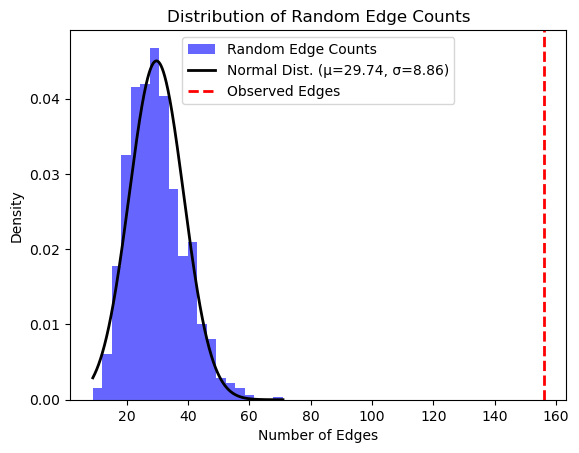

z score for a random nodes: 14.249402640782451

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001663/associations?projection=associationByStudy
Genes: 195

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dTCF2%0dLOC340602%0dNUDT10%0dNUDT11%0dEHBP1%0dSLC22A3%0dMSMB%0dKLK3%0dLMTK2%0dHNF1B%0dCTBP2%0dJAZF1%0dNR%0dINSC%0dTET2%0dACOXL%0dIGF2%0dIGF2AS%0dINS%0dTH%0dC16orf78%0dVGLL3%0dPDLIM5%0dKIF13A%0dSPATA16%0dBAI3%0dPTPRU%0dPKIA%0dDAB2IC%0dUPF2%0dANP32D%0dDNAH12%0dMYEOV%0dBAIAP2L1%0dRNASE9%0dSYK%0dC9orf123%0dCLVS2%0dCWC22%0dLOC63930%0dINHBA%0dDNAH5%0dPPP1R14A%0dMIR656%0dEEFSEC%0dCD180%0dTNRC6B%0dSNX16%0dANXA13%0dLOC285830%0dNKX3.1%0dANK2%0dNR2F2%0dTSEN2%0dEVC%0dAMIGO2%0dTTLL1%0dBIK%0dMCAT%0dPACSIN2%0dCD200R1L%0dITAGA6%0dMIR622%0dMIR4319%0dCEP152%0dPLCL1%0dABLIM1%0dTMTC2%0dACTBL2%0dC7orf66%0dTNC%0dCNTN6%0dNCRNA00284%0dTHADA%0dACTC1%0dMN1%0dZNF280B%0dC18orf34%0dC

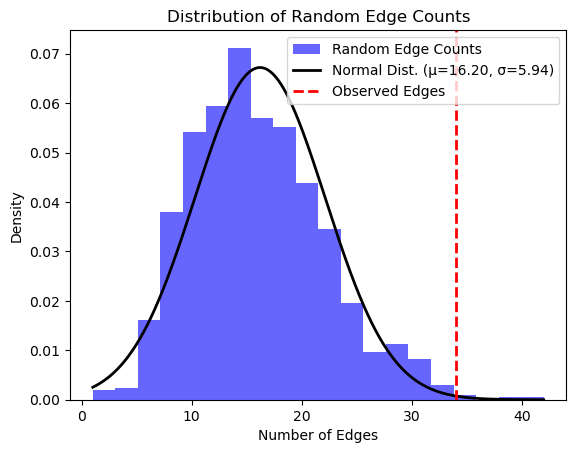

z score for a random nodes: 2.9984151742214142

P-value: 6.5e-05
--------------------------------------------



In [28]:
output1 = compute_clustering(cancerous[:2])


In [85]:
print(cancerous[99])
print(cancerous[65])

for i in range(len(cancerous)):
    if 'EFO_1000166' in cancerous[i]:
        print(i)

('colorectal carcinoma', 'EFO_1001951')
('renal carcinoma', 'EFO_0002890')
62


[{'name': 'contraception, breast carcinoma', 'efoID': 'EFO_0000305', 'num_edges': 156, 'z_score': 14.249402640782451}, {'name': 'carrier status, prostate carcinoma', 'efoID': 'EFO_0001663', 'num_edges': 34, 'z_score': 2.9984151742214142}]
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004986/associations?projection=associationByStudy
Genes: 46

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TMEM129%0dSLBP%0dTACC3%0dFGFR3%0dMYC%0dTP63%0dPSCA%0dBC042052%0dSLC14A1%0dCLK3%0dCYP1A2%0dACTRT3%0dMYNN%0dTERC%0dLRRC34%0dLSP1%0dC20orf187%0dLOC339593%0dCDKAL1%0dNR%0dJAG1%0dPOU5F1B%0dPVT1%0dCBX6%0dAPOBEC3A%0dCCNE1%0dNAT2%0dTERT%0dCLPTM1L%0dUGT1A%0dGSTM1%0dFOXF2%0dHTR5A%0dPAXIP1%0dINSIG1%0dPRKAR2B%0dTAGAP%0dRSPH3%0dEZR%0dFMN1%0dCLPTML%0dintergenic%0dSLC14A2%0dUHRF1BP1%0dNBEA%0dCWC27&species=9606

Proteins: 41

Number of edges: 14

Random edges calculation completed.



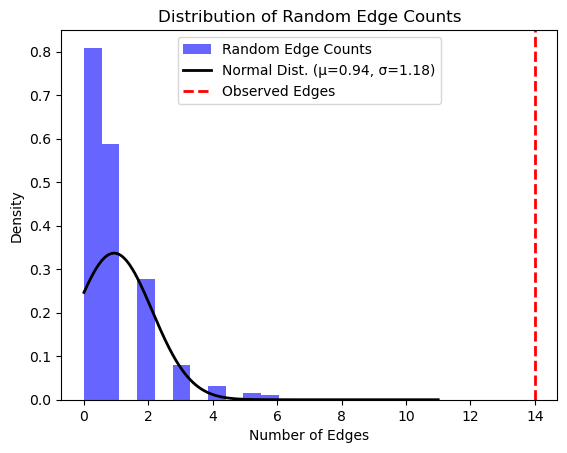

z score for a random nodes: 11.033594888483126

P-value: 3.42e-07
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006352/associations?projection=associationByStudy
Genes: 12

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=AIF1%0dHLA%0dFADS1%0dFADS2%0dFADS3%0dFEN1%0dEPHA7%0dVCAN%0dGRIN2A%0dTBX5%0dRTTN%0dAKR1C1&species=9606

Proteins: 12

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve da

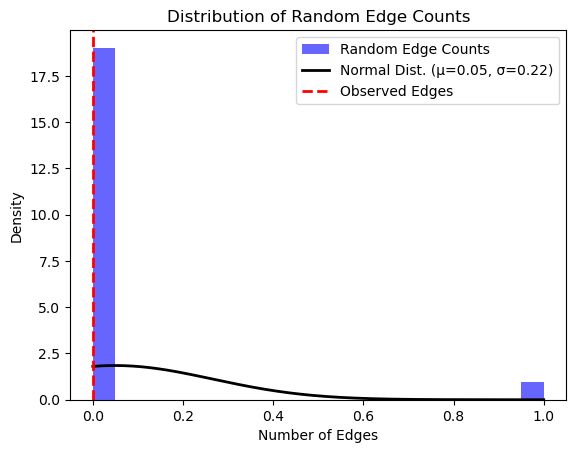

z score for a random nodes: -0.22699055229393256

P-value: 1.0
--------------------------------------------



In [31]:
print(output1)
output2 = compute_clustering(cancerous[2:4])

[{'name': 'urinary bladder carcinoma', 'efoID': 'MONDO_0004986', 'num_edges': 14, 'z_score': 11.033594888483126}, {'name': 'laryngeal squamous cell carcinoma', 'efoID': 'EFO_0006352', 'num_edges': 0, 'z_score': -0.22699055229393256}]
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002916/associations?projection=associationByStudy
Genes: 28

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEATR3%0dHAP1%0dXBP1%0dST6GAL1%0dSMG6%0dPTPN2%0dCHEK2%0dPLCE1%0dNOC3L%0dHSCB%0dC12orf51%0dCSNK1A1%0dTBL1XR1%0dSEMA5B%0dANP32A%0dPDE4D%0dACAD10%0dRUNX1%0dUNC5CL%0dRPL6%0dSLC39A6%0dADH1B%0dADH4%0dIGFB2%0dSLC10A2%0dBRAP%0dALDH2%0dADH6&species=9606

Proteins: 27

Number of edges: 7

Random edges calculation completed.



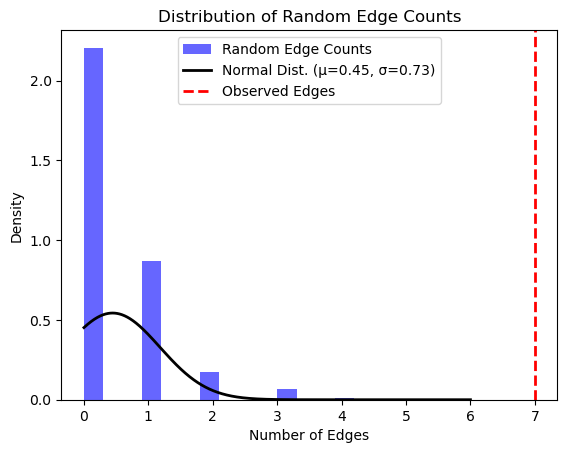

z score for a random nodes: 8.928703172379574

P-value: 0.0055
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001071/associations?projection=associationByStudy
Genes: 391

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CHRNA3%0dCLPTM1L%0dBAT3%0dTGM5%0dNR%0dGPC5%0dTERT%0dintergenic%0dCHRNA5%0dPSMA4%0dLOC123688%0dCHRNB4%0dCRP%0dIL1RAP%0dPTHR2%0dPPL%0dTP63%0dMIPEP%0dMTMR3%0dMSH5%0dhTERT%0dBPTF%0dTNFAIP6%0dRIF1%0dVTI1A%0dROS1%0dDCBLD1%0dHLA class II%0dERCC2%0dXPD%0dPHACTR2%0dPMS1%0dSTAT1%0dHIBCH%0dINPP1%0dBRCA2%0dFRY%0dCHEK2%0dRAD52%0dSMAD6%0dSMAD3%0dGNG2%0dNID2%0dFRMD6%0dLRFN2%0dSP4%0dDNAH11%0dDBT%0dRTCA-AS1%0dLMNA%0dNONE%0dKCNT2%0dPLD5%0dLINC01347%0dCEP170%0dTTC34%0dACTRT2%0dAK5%0dDNAJB4%0dGIPC2%0dMGC27382%0dPTGFR%0dFHL2%0dLOC285000%0dMLK7-AS1%0dTMEM237%0dITSN2%0dNCOA1%0dFSHR%0dNRXN1%0dLOC102800447%0dETAA1%0dLOC101927701%0dMBOAT2%0dRBMS3%0dCACNA2D3%0dADRA2C%0dFAM86EP%0dLOC101928279

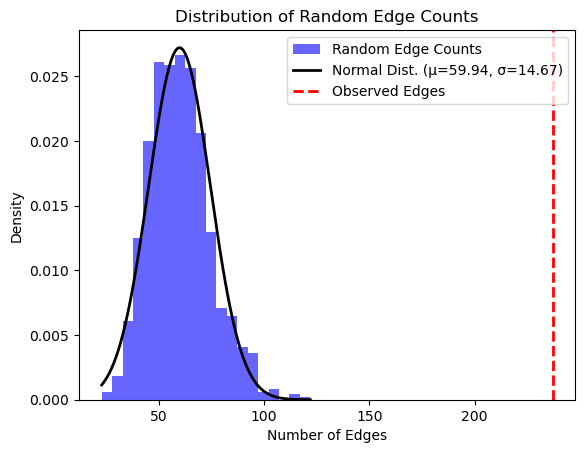

z score for a random nodes: 12.071968623705683

P-value: 0.0
--------------------------------------------



In [32]:
print(output2)
output2 = compute_clustering(cancerous[4:6])

[{'name': 'esophageal carcinoma', 'efoID': 'EFO_0002916', 'num_edges': 7, 'z_score': 8.928703172379574}, {'name': 'lung carcinoma', 'efoID': 'EFO_0001071', 'num_edges': 237, 'z_score': 12.071968623705683}]
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004986/associations?projection=associationByStudy
Genes: 46

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TMEM129%0dSLBP%0dTACC3%0dFGFR3%0dMYC%0dTP63%0dPSCA%0dBC042052%0dSLC14A1%0dCLK3%0dCYP1A2%0dACTRT3%0dMYNN%0dTERC%0dLRRC34%0dLSP1%0dC20orf187%0dLOC339593%0dCDKAL1%0dNR%0dJAG1%0dPOU5F1B%0dPVT1%0dCBX6%0dAPOBEC3A%0dCCNE1%0dNAT2%0dTERT%0dCLPTM1L%0dUGT1A%0dGSTM1%0dFOXF2%0dHTR5A%0dPAXIP1%0dINSIG1%0dPRKAR2B%0dTAGAP%0dRSPH3%0dEZR%0dFMN1%0dCLPTML%0dintergenic%0dSLC14A2%0dUHRF1BP1%0dNBEA%0dCWC27&species=9606

Proteins: 41

Number of edges: 14

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clu

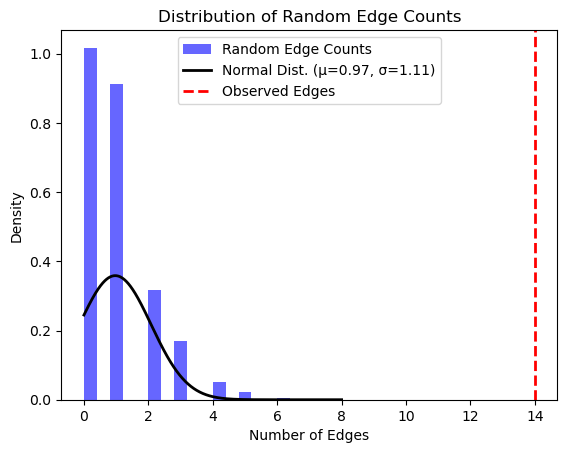

z score for a random nodes: 11.712645151134145

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/ppi_enrichment
Failed to retrieve PPI enrichment data.
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006352/associations?projection=associationByStudy
Genes: 12

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=AIF1%0dHLA%0dFADS1%0dFADS2%0dFADS3%0dFEN1%0dEPHA7%0dVCAN%0dGRIN2A%0dTBX5%0dRTTN%0dAKR1C1&species=9606

Failed to retrieve data: 429

Failed to retrieve protein mappings.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/image/network
Error processing laryngeal squamous cell carcinoma: 'NoneType' object 

In [33]:
print(output2)
output3 = compute_clustering(cancerous[2:4])

[{'name': 'urinary bladder carcinoma', 'efoID': 'MONDO_0004986', 'num_edges': 14, 'z_score': 11.712645151134145}]
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000707/associations?projection=associationByStudy
Genes: 52

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEATR3%0dHAP1%0dXBP1%0dST6GAL1%0dSMG6%0dPTPN2%0dCHEK2%0dSLC39A6%0dBRCA2%0dFRY%0dLRFN2%0dSP4%0dDNAH11%0dSLC45A2%0dIRF4%0dTYR%0dHERC2%0dDEF8%0dMC1R%0dRALY%0dFOXP1%0dTPRG1%0dTP63%0dHLA-DQA1%0dBNC2%0dCNTLN%0dOCA2%0dSPATA33%0dRP1-168P16.2%0dRP11-428J1.2%0dLINC01149%0dLPP%0dALS2CR12%0dTRPS1%0dCCR12P%0dDTNBP1%0dSEC16A%0dBACH2%0dKRT5%0dRPL5P32%0dTPM3P2%0dTUBB3%0dPARK2%0dSRC%0dST3GAL1%0dERBB2IP%0dintergenic%0dRP11-395F4.1%0dHAPLN3%0dCSMD1%0dPRF1%0dPPP2R2C&species=9606

Proteins: 45

Number of edges: 15

Random edges calculation completed.



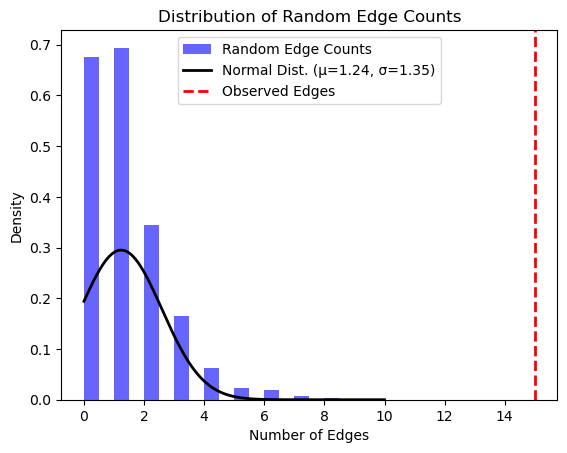

z score for a random nodes: 10.174953635449082

P-value: 7.19e-07
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000571/associations?projection=associationByStudy
Genes: 171

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TP63%0dTERT%0dCLPTM1L%0dAPOM%0dBAT3%0dTRNAA-UGC%0dCHRNA5%0dCHRNA3%0dBPTF%0dBTNL2%0dNR%0dUBAC1%0dDLG2%0dIntergenic%0dNWD2%0dKIAA1239%0dCAPZB%0dAFTPH%0dAQP3%0dSECISBP2L%0dRNLS%0dFAM194B%0dEPHB1%0dRP11-753N8.1%0dAC097713.3%0dLMCD1-AS1%0dC1D%0dFOXP1%0dAC020626.1%0dNTM%0dAKR1B10%0dROBO2%0dNAALADL2%0dTLDC2%0dSATB1%0dTMEM218%0dTUB%0dRP11-269F21.3%0dZNRD1%0dNAF1%0dSLC52A1%0dZFP3%0dHSD17B2%0dMPHOSPH6%0dTBK1%0dRASSF3%0dSBF2%0dLOC554223%0dHLA-G%0dKIAA1456%0dDLC1%0dMPZL2%0dACTR2%0dSPRED2%0dLOC101054525%0dTRPC6%0dLPCAT1%0dHLA-A%0dHCG9%0dGABBR1%0dMOG%0dMICALCL%0dPARVA%0dNRG1%0dLRFN1%0dGMFG%0dGIPC2%0dMGC27382%0dADAMTS7%0dETAA1%0dLOC101927701%0dOBFC1%0dSLK%0dCEACAM21%0dCEACAM4%

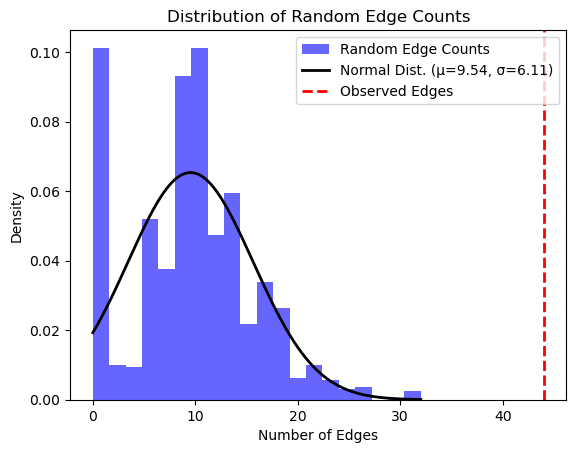

z score for a random nodes: 5.6444559077857175

P-value: 6.19e-13
--------------------------------------------



In [34]:
print(output3)
output4 = compute_clustering(cancerous[6:8])

[{'name': 'squamous cell carcinoma', 'efoID': 'EFO_0000707', 'num_edges': 15, 'z_score': 10.174953635449082}, {'name': 'lung adenocarcinoma', 'efoID': 'EFO_0000571', 'num_edges': 44, 'z_score': 5.6444559077857175}]
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004252/associations?projection=associationByStudy
Genes: 97

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ITGA9%0dTNFRSF19%0dHLA-DQ%0dHLA-DR%0dHLA-A%0dHLA-C%0dHLA-B%0dMDS1%0dEVI1%0dCDKN2B%0dCDNK2A%0dGABBR1%0dHLA-F%0dHLA%0dCREB5%0dKIF2B%0dWBSCR17%0dC5%0dMIR1973%0dADAM12%0dRHBDD1%0dERG%0dDGKB%0dDLD%0dTUSC1%0dRBFOX1%0dADCY3%0dNTRK2%0dVRK2%0dMIR4432%0dKCNQ4%0dDPP6%0dFBXL7%0dZNF365%0dPPFIA2%0dRHOT1%0dCOMMD10%0dNRG3%0dPCLO%0dMIR548%0dCRTAC1%0dOLFM4%0dBC038529%0dFAM155A%0dJAK2%0dZFHX3%0dETV3%0dIMPACT%0dLINC00290%0dSPERT%0dHIP1%0dCPA6%0dOSR1%0dLRMP%0dEDN2%0dFLT4%0dN4BP2L1%0dGAS7%0dINTU%0dSMAD3%0dEYS%0dGRIK1%0dMANEA%0dFAM19A5%0dHMGXB3%0dEPC1%0dC1orf130%0dADD2%0dLOC10050737%0

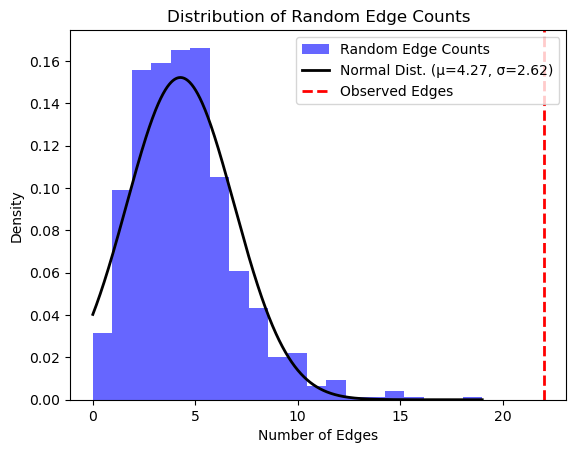

z score for a random nodes: 6.765615888360051

P-value: 1.68e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003060/associations?projection=associationByStudy
Genes: 44

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=EIF4E2%0dETS2%0dDSCAM%0dSLC17A8%0dNR1H4%0dSCYL2%0dGAS2L3%0dAPCDD1%0dNAPG%0dFAM38B%0dNR%0dC3orf21%0dFAM154A%0dCPS1%0dMIER2%0dintergenic%0dANKS1A%0dDLST%0dTHSD7B%0dNCOA2%0dCDH8%0dLIPC%0dNALCN%0dSLC35D2%0dGPR113%0dLINC00290%0dCAMK2D%0dTNS3%0dSEPT7%0dCDKN2A%0dTP63%0dBAZ1A%0dVTI1A%0dTERT%0dFOXP4%0dBPTF%0dMYNN%0dMHC%0dCASP8%0dNRG1%0dMPZL3%0dCHRNA5%0dCYP2A6%0dDCBLD1&species=9606

Proteins: 43

Number of edges: 6

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org

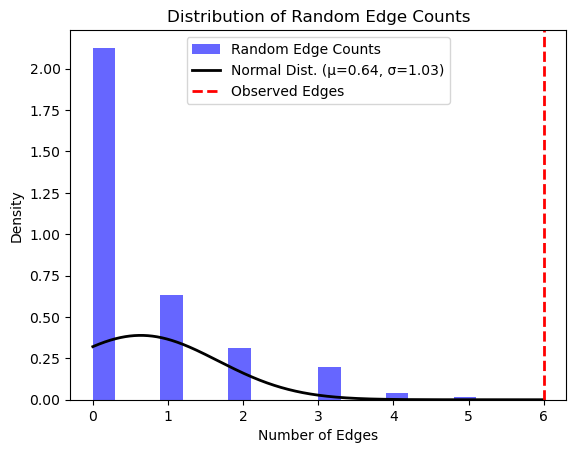

z score for a random nodes: 5.22571812628736

P-value: 0.0032
--------------------------------------------



In [35]:
print(output4)
output5 = compute_clustering(cancerous[8:10])

[{'name': 'nasopharyngeal neoplasm', 'efoID': 'EFO_0004252', 'num_edges': 22, 'z_score': 6.765615888360051}, {'name': 'non-small cell lung carcinoma', 'efoID': 'EFO_0003060', 'num_edges': 6, 'z_score': 5.22571812628736}]
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005537/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=MDM4%0dPTHLH%0dTERT%0dintergenic%0dESR1&species=9606

Proteins: 5

Number of edges: 0

Random edges calculation completed.



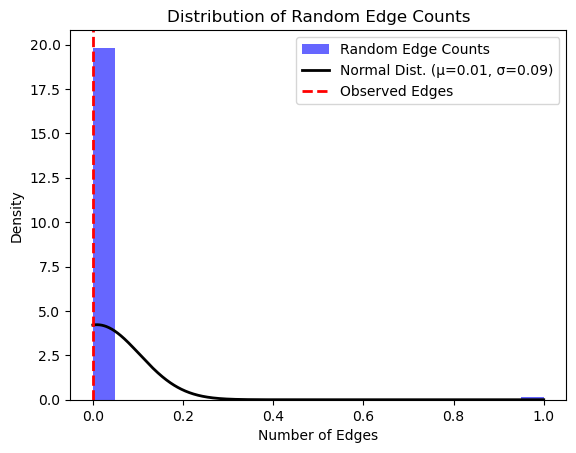

z score for a random nodes: -0.09529814069846938

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005575/associations?projection=associationByStudy
Genes: 278

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=EPB41L2%0dTMEM200A%0dFAM190A%0dTENM3%0dAGA%0dintergenic%0dLOC101928923%0dDPP10%0dLINC01121%0dGRIA1%0dHCN1%0dMGST1%0dPIK3C2G%0dIL16%0dKIAA1456%0dLONRF1%0dRPL27AP8%0dSUCLA2%0dVN1R86P%0dZNF492%0dPNMAL1%0dMORC1%0dDPP6%0dFLJ22763%0dGATA3%0dGATA-AS1%0dMEIS1%0dDNMT3AP1%0dNPM1P5%0dST8SIA2%0dMRPL42P4%0dTNS3%0dACOXL%0dLCORL%0dRPL21P46%0dELOVL5%0dDCC%0dBMP4%0dRHPN2%0dCDH1%0dDUSP10%0dLAMA5%0dMYNN%0dDIP2B%0dATF1%0dNR%0dEIF3H%0dSMAD7%0dMYC%0dBMP2%0dNABP1%0dCRAC1%0dHMPS%0dGREM1%0dCCND2%0dTBX3%0dLAMC1%0dC1orf110%0dDCBLD1%0dGOPC%0dCDKN1A%0dPOLD3%0dSHROOM2%0dPOU5FIP1%0dHsG57825%0dDQ515897%0dPLEKHG6%0dTNFRSF1A%0dCD9%0dMYRF%0dFADS1%0dFADS2%0dFEN1%0dNXN%0dTGFB1%0dB9D2%0dPITX1%0dHAO1%

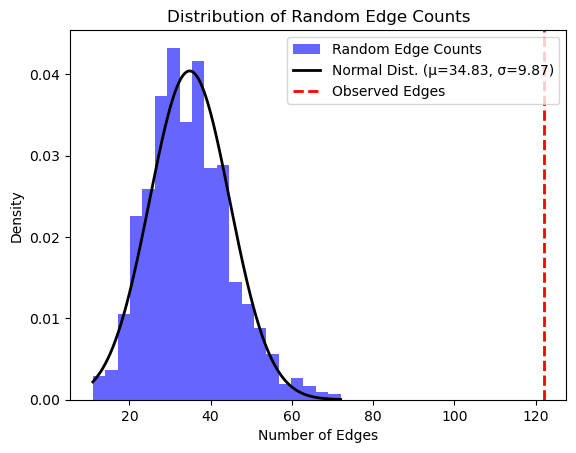

z score for a random nodes: 8.832497451928058

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/ppi_enrichment
Failed to retrieve PPI enrichment data.
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001514/associations?projection=associationByStudy
Genes: 10

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEY2%0dNCOA7%0dMYC%0dEIF2AK%0dBMF%0dAKT1%0dSIVA1%0dHNF1B%0dCYP19A1%0dKLF12&species=9606

Failed to retrieve data: 429

Failed to retrieve protein mappings.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/image/network
Error processing endometrial endometrioid carcinoma: 'NoneType' object has no attribu

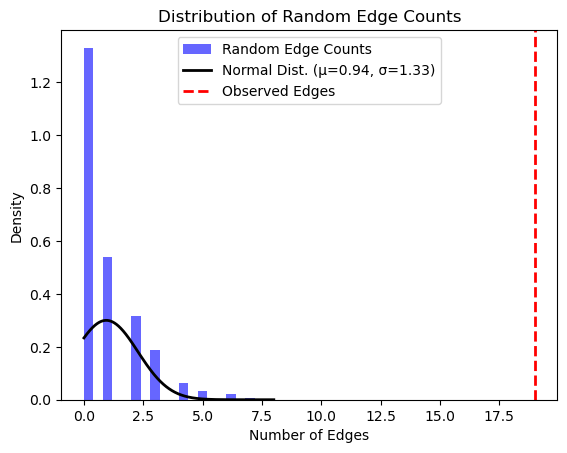

z score for a random nodes: 13.575820369220034

P-value: 1.55e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000708/associations?projection=associationByStudy
Genes: 199

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dRP11-576M8.2%0dRP11-410D17.2%0dLCORL%0dIPPK%0dESM1%0dDCLK1%0dCTD-2503O16.4%0dAL109618.1%0dDCUN1D4%0dTHRB%0dZSCAN9%0dFAM155A%0dAC007389.3%0dIL1RL2%0dNF1%0dBTBD9%0dPC%0dWWOX%0dRP11-369E15.1%0dNBAS%0dEZH2%0dTMEM221%0dSLC22A2%0dPLD5%0dDLG2%0dTMEFF1%0dKB-1980E6.3%0dGALNTL6%0dGPD2%0dLRP11%0dNPAS3%0dRP4-724E13.2%0dELOVL5%0dGABRB1%0dHS2ST1%0dSVOPL%0dSNTG2%0dSLC1A6%0dMETTL20%0dFAM124B%0dSPI1%0dGHR%0dRP11-526D8.7%0dDAB2IP%0dSH2B3%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dIntergenic%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dGBAP1%0dKCNH1%0dKCNN3%0dADAR%0dDCAF8%0dLOC101928565%0dXCL2%0dEDN2%0dHIVEP3%0dKDM4A%0dLINC01361%0dLOC101927587%

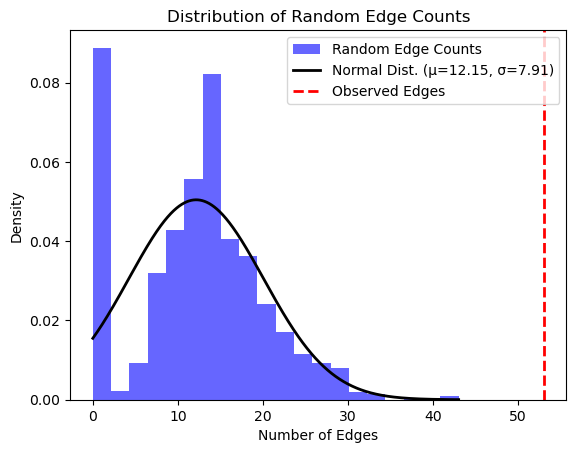

z score for a random nodes: 5.1666667650467835

P-value: 1.9e-12
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000178/associations?projection=associationByStudy
Genes: 25

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PLCE1%0dNOC3L%0dNR%0dZBTB20%0dPRKAA1%0dPTGER4%0dLRFN2%0dSP4%0dDNAH11%0dPSCA%0dMTX1%0dHCN3%0dMUC1%0dintergenic%0dATM%0dTTC33%0dUNC5CL%0dTSPO2%0dOPCML%0dASH1L%0dlnc-POLR3G-4%0dGCLET%0dNSUN3%0dLOC285419%0dANKRD50&species=9606

Proteins: 22

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: ht

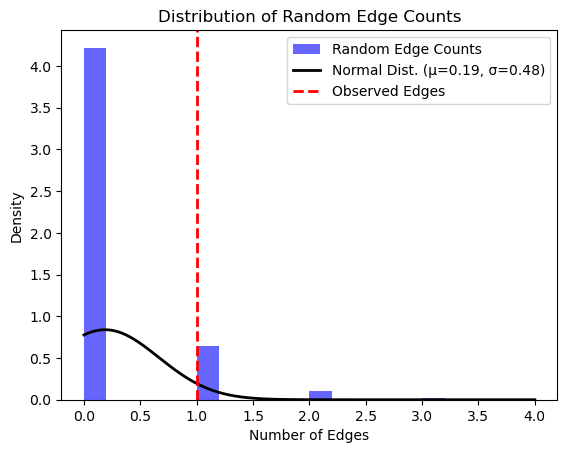

z score for a random nodes: 1.710041075614297

P-value: 0.3798
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000503/associations?projection=associationByStudy
Genes: 7

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dMTX1%0dHCN3%0dMUC1%0dATM%0dCHD6%0dPSCA&species=9606

Proteins: 7

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests fo

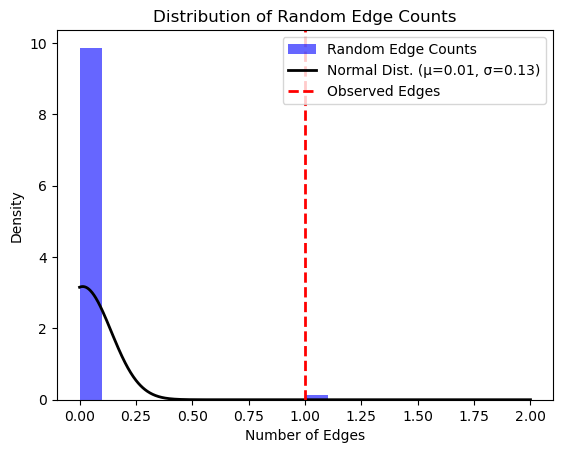

z score for a random nodes: 7.843202074411681

P-value: 0.0573
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000650/associations?projection=associationByStudy
Genes: 66

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEPACAM%0dHEPN1%0dCCDC15%0dSLC37A2%0dTMEM218%0dFEZ1%0dMGC39545%0dSTT3A%0dCHEK1%0dACRV1%0dPATE1%0dPATE2%0dPATE3%0dPATE4%0dHYLS1%0dPKNOX2%0dROBO4%0dTERT%0dTNFSF10%0dNR%0dESR1%0dKLF5%0dLGR6%0dWDR43%0dMIR4757%0dFTO%0dMDM4%0dANKLE1%0dADCY9%0dL3MBTL3%0dKDELC2%0dCDH2%0dCCNE1%0dANXA13%0dRPL23AP53%0dPEX14%0dIntergenic%0dINHBB%0dZNF365%0dLSP1%0dPTHLH%0dTOX3%0dADHB8%0dMERIT40%0dPPIL3%0dCLK1%0dFAM126B%0dNDUFB3%0dKLF12%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dRALY%0dFRY%0dMTX1%0dNEK10%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dSH2B3%0dGBAP1%0dKCNH1&species=9606

Proteins: 60

Number of edges: 23

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://stri

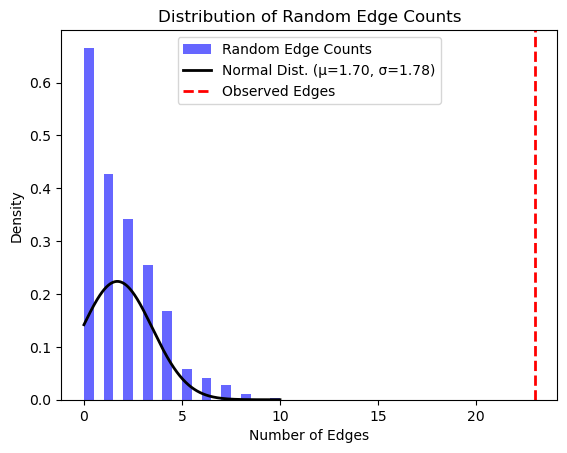

z score for a random nodes: 11.952356914056848

P-value: 1.59e-10
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006462/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HOXD3%0dPAX8%0dIFNL3%0dIFNL4%0dNR&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://

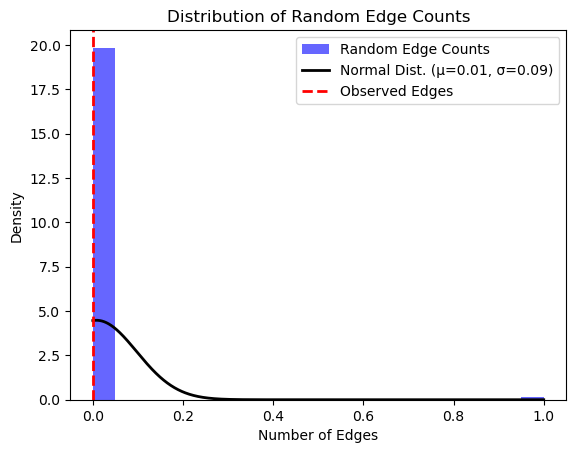

z score for a random nodes: -0.08980265101338747

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001061/associations?projection=associationByStudy
Genes: 40

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA%0dHLA-B%0dHLA-DPB2%0dHLA-DRB1%0dHLA-DQA1%0dMICA%0dintergenic%0dZNF804B%0dEXOC1%0dGSDMB%0dNR%0dADGRV1%0dHPVC1%0dLINC01445%0dVSTM2A-OT1%0dVSTM2A%0dTTC34%0dACACB%0dIntergenic%0dINS-IGF2%0dSOX9%0dPAX8%0dCLPTM1L%0dHLA-DQB1%0dMICB%0dMCCD1%0dGABRB1%0dTBXAS1%0dSGK223%0dCLDN23%0dSULF1%0dSLCO5A1%0dSUGT1P3%0dELF1%0dLRRC28%0dMEF2A%0dLOC100505817%0dFBXO15%0dTNF%0dHLA-C&species=9606

Proteins: 33

Number of edges: 19

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org

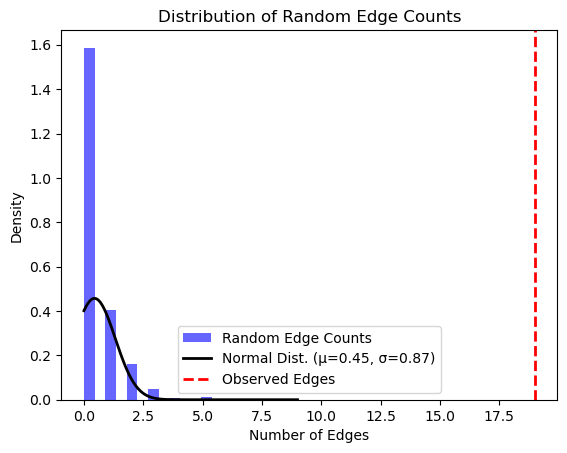

z score for a random nodes: 21.242508697405846

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002618/associations?projection=associationByStudy
Genes: 175

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=BACH1%0dDAB2%0dPRLHR%0dTFF1%0dFAM19A5%0dMIPEPP2%0dBAI3%0dSLC1A1%0dARID1B%0dTFRC%0dNR%0dARL4C%0dDPP6%0dFAM91A1%0dFOXQ1%0dLOC284998%0dLOC387933%0dLOC730242%0dLOC731559%0dMYO1D%0dNDFIP2%0dPARK2%0dPRPSAP2%0dRNF149%0dRNF43%0dRNF5P1%0dTHSD7B%0dBICD1%0dABO%0dKLF12%0dKLF5%0dNR5A2%0dCLPTM1L%0dSBF2%0dc18orf1%0dintergenic%0dGRID1%0dGTF2H1%0dZFP1%0dCTRB1%0dCFDP1%0dTMEM170A%0dCHST6%0dCHST5%0dTMEM231%0dGABARAPL2%0dADAT1%0dKARS%0dTERF21P%0dLDHD%0dBCAR1%0dCTRB2%0dFA2H%0dWDR59%0dZNFR1%0dLINC00977%0dMIR1208%0dPVT1%0dMYC%0dADAMTS13%0dURAD%0dFLT3%0dPAN3-AS1%0dPAN3%0dGSX1%0dPDX1-AS1%0dPDX1%0dATP5EP2%0dCDX2%0dSNORD125%0dRHBDD3%0dEWSR1%0dCHEK2%0dTTC28%0dHSCB%0dCCDC117%0dXBP1%0dZNRF3%0dKREM

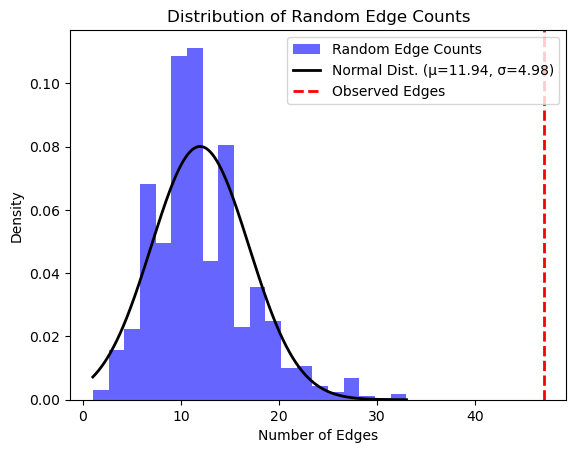

z score for a random nodes: 7.033980007652857

P-value: 1.08e-09
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001252/associations?projection=associationByStudy
Genes: 1

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PRKAA1&species=9606

Proteins: 1

Number of edges: 52

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-he

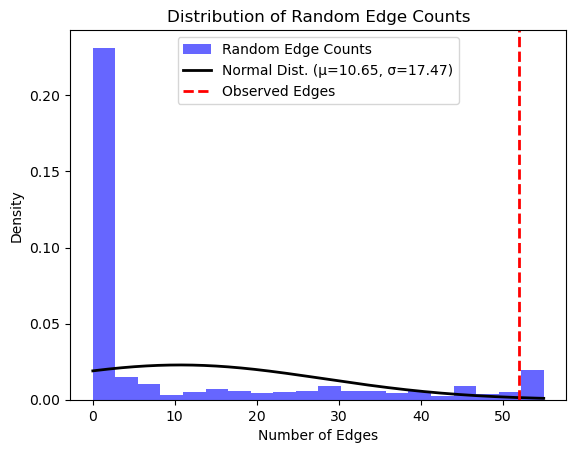

z score for a random nodes: 2.3667149452639182

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004992/associations?projection=associationByStudy
Genes: 16

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PPL%0dGLYR1%0dPHB%0dZNF652%0dKCNE2%0dRCAN1%0dNR%0dRP11-266A24.1%0dTMX1%0dCNIH3%0dPRSS1%0dEPHB6%0dTRPV6%0dTRPV5%0dPIP%0dTP53&species=9606

Proteins: 15

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for ran

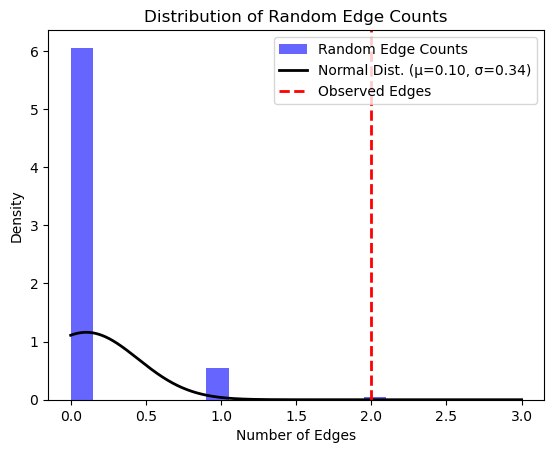

z score for a random nodes: 5.513253812304348

P-value: 0.1195
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004288/associations?projection=associationByStudy
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dISM1%0dHCN1%0dDSG3%0dPARVG%0dC20orf27%0dDPP10%0dSYMPK&species=9606

Proteins: 8

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too M

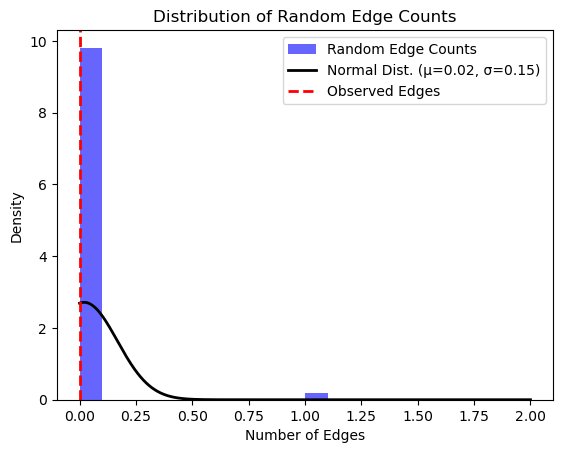

z score for a random nodes: -0.13608276348795437

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001075/associations?projection=associationByStudy
Genes: 110

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=C19orf62%0dMERIT40%0dANKLE1%0dBNC2%0dLOC648570%0dCNTLN%0dHOXD1%0dHOXD3%0dMYC%0dTHEM75%0dSKAP1%0dNR%0dTIPARP%0dintergenic%0dCHMP4C%0dFABP5%0dPMP2%0dFABP12%0dIMPA1%0dSLC10A5%0dZFAND1%0dSNX16%0dFABP4%0dNEBL%0dC10orf113%0dC10orf114%0dSKIDA1%0dDNAJC1%0dMLLT10%0dHNF1B%0dACACA%0dC17orf78%0dTADA2A%0dDUSP14%0dSYNRG%0dDDX52%0dTBC1D3F%0dTBC1D3%0dMRPL45%0dGPR179%0dSOCS7%0dARHGAP23%0dBRIP1%0dLINC02183%0dBRCA1%0dIntergenic%0dPDSS1%0dSH2D4B%0dLOC646730%0dBTBD10%0dPTH%0dHSPB7%0dZBTB7B%0dTET2%0dJAZF1%0dARHGEF5%0dPCAT1/PCAT2%0dMIR1208/PVT1%0dCDKN2A/CDKN2B%0dHABP2%0dINCENP%0dTPCN2%0dCCDC88C%0dSTXBP4%0dGATAD2A%0dBCL2L11%0dBRCA2%0dRAD51B%0dBABAM1%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHL

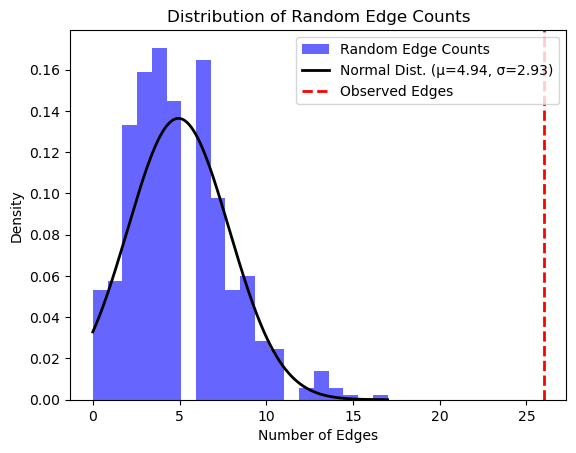

z score for a random nodes: 7.198726421915859

P-value: 1.89e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000042/associations?projection=associationByStudy
Genes: 1

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR&species=9606

Proteins: 1

Number of edges: 55

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header

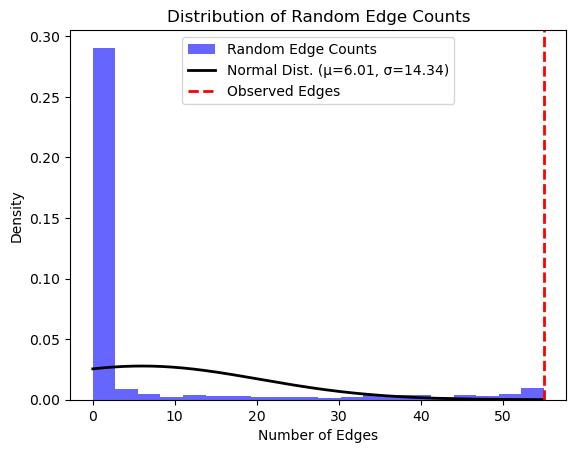

z score for a random nodes: 3.415228880542065

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001515/associations?projection=associationByStudy
Genes: 20

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dIntergenic%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dSH2B3%0dGBAP1%0dKCNH1&species=9606

Proteins: 19

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to ret

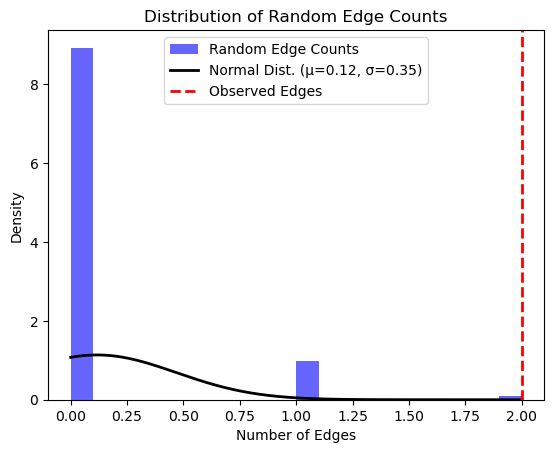

z score for a random nodes: 5.3622790436298775

P-value: 0.09
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001516/associations?projection=associationByStudy
Genes: 27

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dFST%0dMAGEC1%0dLOC105376360%0dPRPSAP1%0dGABRG3%0dLOC105377300%0dGK2%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dIntergenic%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dSH2B3%0dGBAP1%0dKCNH1&species=9606

Proteins: 24

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Request

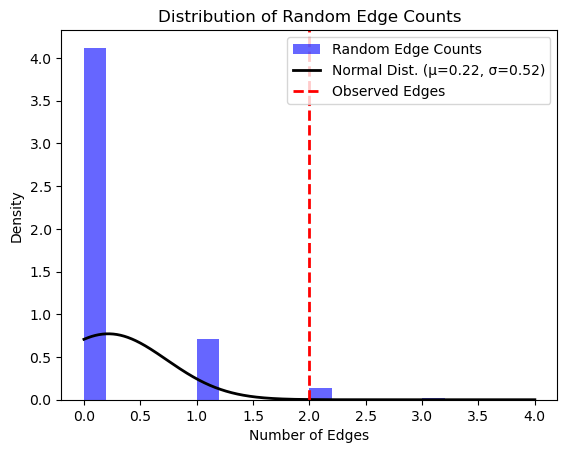

z score for a random nodes: 3.4503220148421643

P-value: 0.1324
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000182/associations?projection=associationByStudy
Genes: 31

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DRB1%0dHLA-DQA1%0dGRIK1%0dHLA_DRB1%0dHLA_DQA1%0dHLA-DQ%0dHLA-DR%0dMICA%0dSTAT4%0dGLB1%0dC2%0dC14orf143%0dUBE4B%0dKIF1B%0dPGD%0dCDK14%0dTM6SF2%0dWNT3A%0dWNT9A%0dPNPLA3%0dVEPH1%0dFZD4%0dHLA%0dDYSF%0dSAMM50%0dTLL1%0dDLC1%0dAGA%0dMIR572%0dMRPS11%0dHLA-DQB1&species=9606

Proteins: 27

Number of edges: 8

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 4

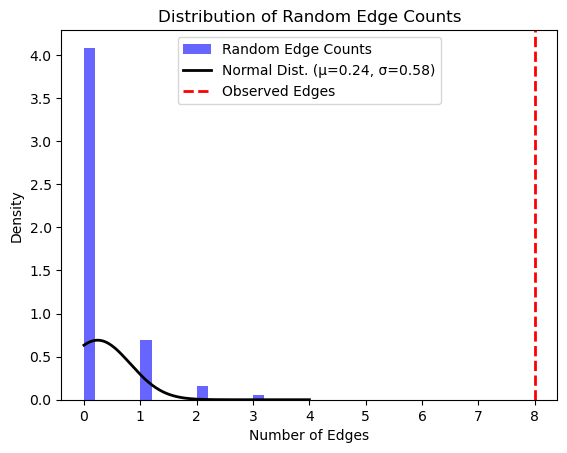

z score for a random nodes: 13.435181306488

P-value: 4.58e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004606/associations?projection=associationByStudy
Genes: 4

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DCC%0dNR%0dABCB4%0dABCB1&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.or

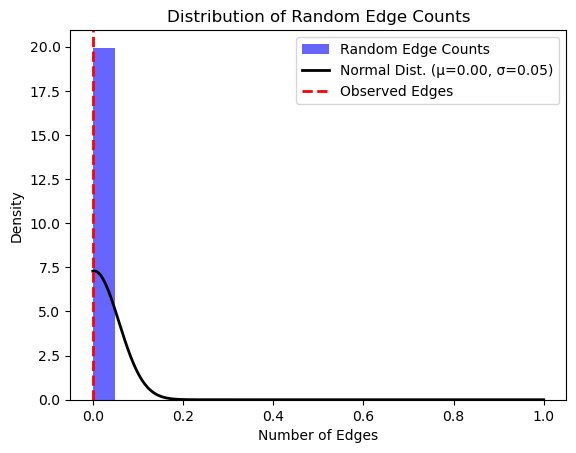

z score for a random nodes: -0.05485459945386285

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005406/associations?projection=associationByStudy
Genes: 97

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=Intergenic%0dintergenic%0dFAT3%0dRNF4%0dSnoU13%0dCOX15%0dCNNM1%0dWNT8B%0dNKX2-3%0dPLEKHG6%0dCD9%0dMHC%0dEIF3H%0dSATB2%0dGATA3%0dLINC00917%0dZMIZ1-AS1%0dZMIZ1%0dPOLR3A%0dSMAD3%0dGREM1%0dBOC%0dBMP5%0dTBX3%0dMED13L%0dKLF5%0dBMP2%0dCCND2%0dRAB40B%0dMETRLN%0dHEXDC%0dMYC%0dBMP4%0dHAO1%0dYAP1%0dPTPN1%0dPOLD3%0dNXN%0dLINC00603%0dPTGER4%0dTERT%0dCLPTM1L%0dMYO1G%0dSNHG15%0dCCM2%0dTBRG4%0dDACT1%0dTCF7L2%0dLOC146513%0dFOXL1%0dVTI1A%0dA1CF%0dPRKG1%0dSMAD7%0dDIP2B%0dATF1%0dATOH1%0dSMARCAD1%0dBMPR1B%0dFKBP5%0dTEAD3%0dDUSP10%0dLAMA5%0dRPS21%0dMYRF%0dFEN1%0dFADS1%0dTGFB1%0dB9D2%0dRHPN2%0dGPATCH1%0dc11orf53%0dCOLCA1%0dCOLCA2%0dCTNNB1%0dPNKD%0dTMBIM1%0dSTARD13%0dRFC3%0dPITX1%0dH2AFY%0

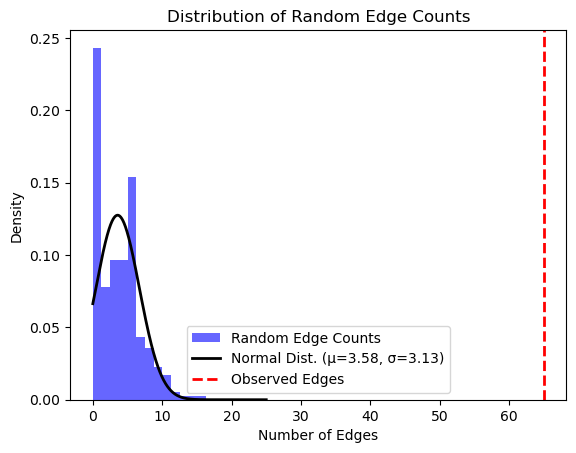

z score for a random nodes: 19.628966101532853

P-value: 3.11e-15
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002892/associations?projection=associationByStudy
Genes: 22

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FOXE1%0dNKX2-1%0dTMOD1%0dC9orf97%0dNCBP1%0dXPA%0dHEMGN%0dKRT18P13%0dC9orf156%0dDIRC3%0dNRG1%0dMBIP%0dFOXE-1%0dNR%0dPCNXL2%0dLRRC34%0dTERC%0dNREP%0dEPB41L4A%0dOBFC1%0dSMAD3%0dTERT&species=9606

Proteins: 20

Number of edges: 8

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no

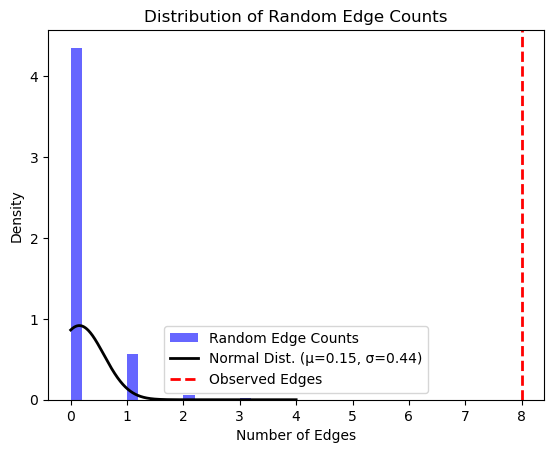

z score for a random nodes: 18.021660084021597

P-value: 6.37e-07
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004193/associations?projection=associationByStudy
Genes: 144

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RCC2%0dARHGEF10L%0dPADI4%0dPADI6%0dRHOU%0dUBAC2%0dMC1R%0dEXOC2%0dTP53%0dTGM3%0dRGS22%0dTERT%0dKRT5%0dCDKN2A%0dCDKN2B%0dKLF14%0dCLPTM1L%0dMYCN%0dFAM49A%0dALS2CR12%0dCASP8%0dCASP10%0dZFHX4%0dZFHX4-AS1%0dGATA3%0dRP11-428L9.1%0dRP11-428L9.2%0dIRF4%0dSLC45A2%0dRALY%0dTYR%0dOCA2%0dFOXP1%0dBNC2%0dLPP%0dHLA-DQA2%0dCUX1%0dZBTB10%0dLINC00111%0dPLIN3%0dHLA-B%0dTNS3%0dNEU1%0dOBFC1%0dMIR3939%0dCASC15%0dJDP2%0dCPVL%0dRAC1%0dPHTF1%0dST3GAL6%0dCTLA4%0dAC099344.3%0dSEC16A%0dATP11A%0dHAL%0dTRPS1%0dRAET1M%0dCTC-537E7.3%0dRP11-130C19.3%0dAC107057.1%0dCCR12P%0dGPX4%0dZBTB7B%0dCCDC88B%0dZNF365%0dAC020743.2%0dSMC2%0dPPARGC1B%0dCTC-518P12.6%0dAC017060.1%0dSCARNA8%0dFGF10%0dCYP1B1%0dRN7

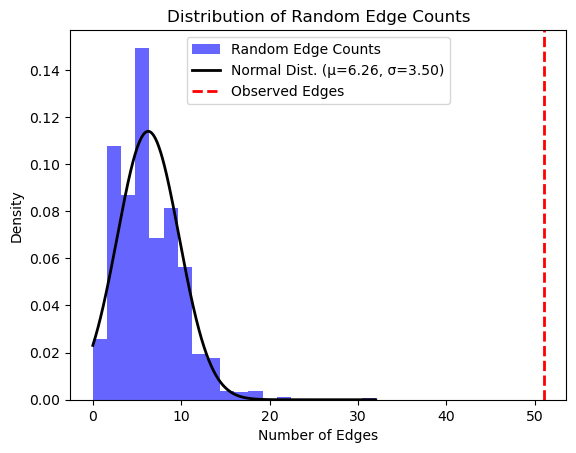

z score for a random nodes: 12.773774109641588

P-value: 7.5e-13
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006953/associations?projection=associationByStudy
Genes: 70

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CHRNA3%0dNR%0dSDR9C7%0dLMCD1-AS1%0dSTAT6%0dPCSK2%0dADARB2%0dGPATCH2%0dKIAA0753%0dTUB%0dSYT9%0dRNLS%0dFAM194B%0dEPHB1%0dRP11-753N8.1%0dAC097713.3%0dC1D%0dFOXP1%0dAC020626.1%0dNTM%0dAKR1B10%0dROBO2%0dNAALADL2%0dTLDC2%0dSATB1%0dTMEM218%0dRP11-269F21.3%0dRP11-576M8.2%0dRP11-410D17.2%0dLCORL%0dIPPK%0dESM1%0dDCLK1%0dCTD-2503O16.4%0dAL109618.1%0dDCUN1D4%0dTHRB%0dZSCAN9%0dFAM155A%0dAC007389.3%0dIL1RL2%0dNF1%0dBTBD9%0dPC%0dWWOX%0dRP11-369E15.1%0dNBAS%0dEZH2%0dTMEM221%0dSLC22A2%0dPLD5%0dDLG2%0dTMEFF1%0dKB-1980E6.3%0dGALNTL6%0dGPD2%0dLRP11%0dNPAS3%0dRP4-724E13.2%0dELOVL5%0dGABRB1%0dHS2ST1%0dSVOPL%0dSNTG2%0dSLC1A6%0dMETTL20%0dFAM124B%0dSPI1%0dGHR%0dRP11-526D8.7&species=9606



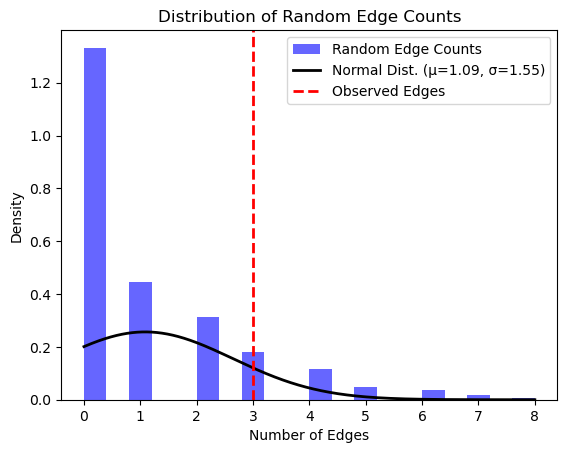

z score for a random nodes: 1.230885489964338

P-value: 0.1377
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0010176/associations?projection=associationByStudy
Genes: 85

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SCARNA8%0dEPB41L1%0dTYR%0dAC004824.1%0dALS2CR12%0dSNORD77%0dAC010745.4%0dRP1-168P16.2%0dGOLPH3L%0dFOXP1%0dY_RNA%0dLINC01149%0dJDP2%0dLPP%0dRP11-335H2.2%0dLINC00111%0dZNF276%0dBCAS4%0dZBTB7B%0dCTLA4%0dPPARGC1B%0dRP11-428J1.2%0dHLA-B%0dZNF365%0dCTC-518P12.6%0dRP5-1028L10.2%0dAC107057.1%0dRNU6-846P%0dRAC1%0dTNS3%0dAC020743.2%0dRP11-278I4.2%0dCCDC88B%0dATP11A%0dSMC2%0dRP1-186E20.1%0dHAL%0dBRCA2%0dST3GAL6%0dHLA-DPA1%0dU3%0dGPX4%0dTGM3%0dCCR6%0dAC017060.1%0dCFL1%0dCCR12P%0dCYP1B1%0dTERT%0dRN7SKP240%0dRP11-128M1.1%0dHLA-DQA1%0dCUX1%0dMIR29A%0dHERC2%0dPHTF1%0dCDKN2B-AS1%0dBACH2%0dBNC2%0dKRT5%0dCLPTM1%0dERG%0dEXO1%0dRP4-799G3.2%0dRNYes4P15%0dMC1R%0dDEF8%0dRP11-115I9.1%0dIRF4

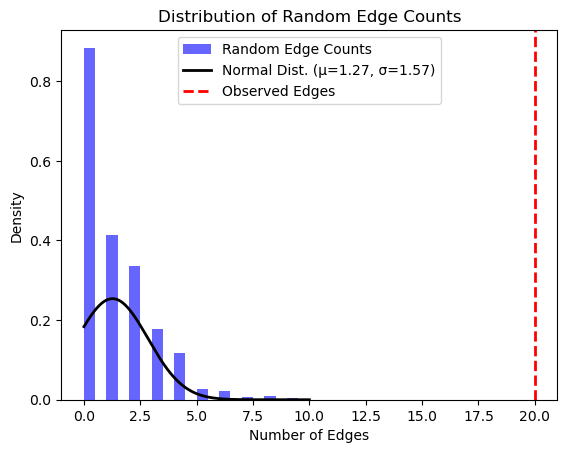

z score for a random nodes: 11.917158126398636

P-value: 3.22e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000181/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DQB1%0dCCHCR1%0dZNRD1-AS1%0dintergenic%0dNR&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for

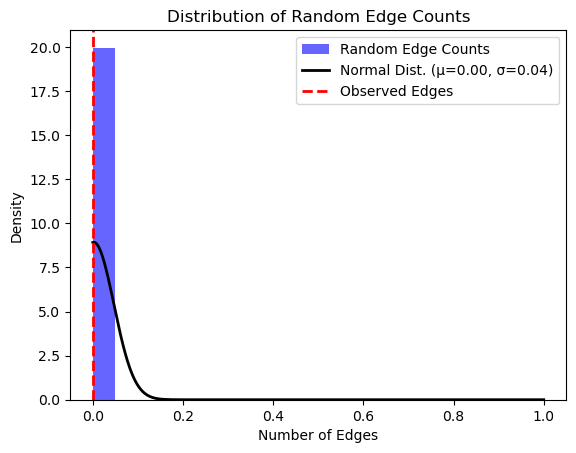

z score for a random nodes: -0.04476614810358452

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009260/associations?projection=associationByStudy
Genes: 23

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RGS22%0dNR%0dCDKN2B%0dKRT5%0dFOXP1%0dCPVL%0dDEFB135%0dRHOU%0dMC1R%0dIRF4%0dLINC-PINT%0dFAM49A%0dZFHX4%0dCLPTM1L%0dALS2CR12%0dTYR%0dRALY%0dASIP%0dTGM3%0dTHNSL2%0dRCC2%0dLOC105755953%0dIntergenic&species=9606

Proteins: 21

Number of edges: 5

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.or

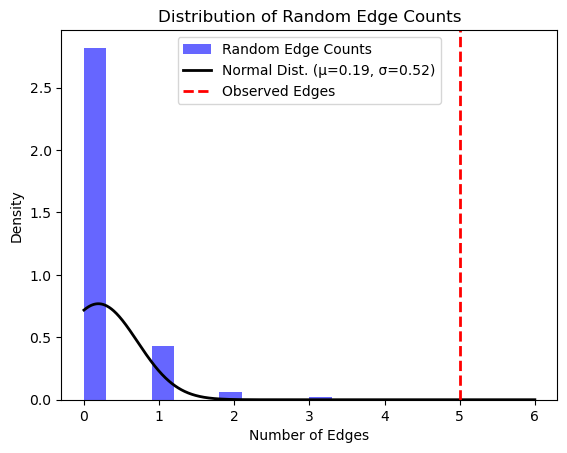

z score for a random nodes: 9.26784074125314

P-value: 9.62e-08
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001927/associations?projection=associationByStudy
Genes: 36

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ARNT%0dSETDB1%0dIntergenic%0dALS2CR12%0dFOXP1%0dEIF4E3%0dTPRG1%0dTP63%0dSLC45A2%0dIRF4%0dHLA-DQA1%0dBACH2%0dAGR3%0dAHR%0dTRPS1%0dTYRP1%0dBNC2%0dCNTLN%0dSEC16A%0dZNF143%0dWEE1%0dTYR%0dCADM1%0dBUD13%0dKRT6A%0dKRT5%0dHAL%0dOCA2%0dTCF25%0dTUBB3%0dRALY%0dNR%0dBRCA2%0dRALY-ASIP%0dMC1R%0dLPP&species=9606

Proteins: 35

Number of edges: 16

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nod

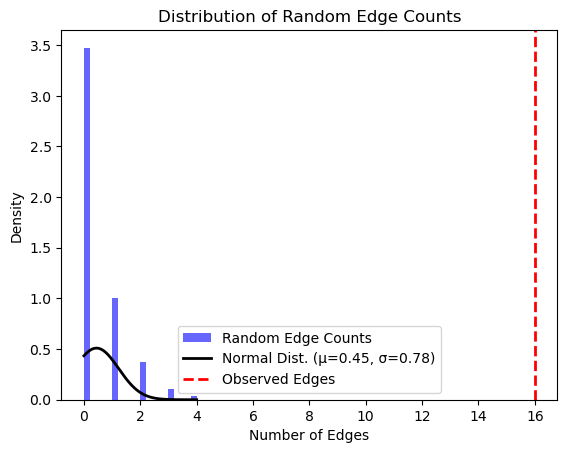

z score for a random nodes: 19.867747609665404

P-value: 1.31e-14
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000649/associations?projection=associationByStudy
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dFGFR2%0dCASC16%0dintergenic%0dRAB9P1%0dZNF613%0dRHOBTB2%0dPDLIM2&species=9606

Proteins: 6

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/

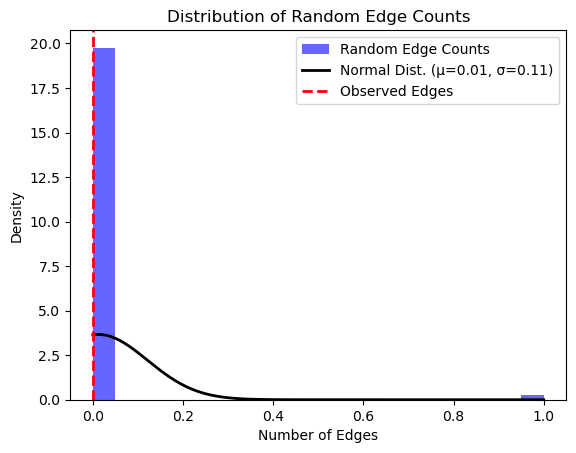

z score for a random nodes: -0.11020775375559674

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009781/associations?projection=associationByStudy
Genes: 1

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FGFR2&species=9606

Proteins: 1

Number of edges: 16

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-heade

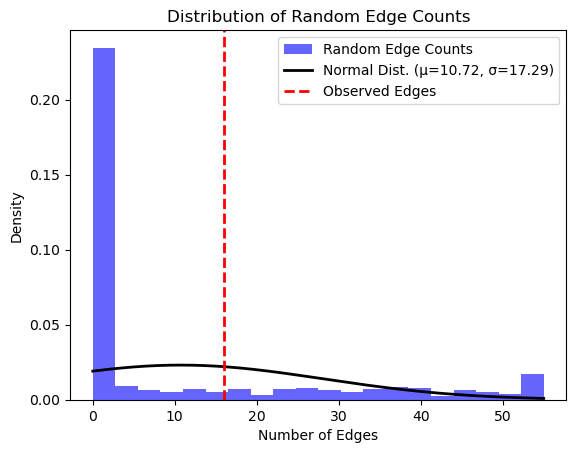

z score for a random nodes: 0.3056259014176983

P-value: 0.0762
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009361/associations?projection=associationByStudy
Genes: 6

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SLC22A16%0dZBTB20%0dCCDC141%0dRASGRF2%0dIntergenic%0dNR&species=9606

Proteins: 6

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Reques

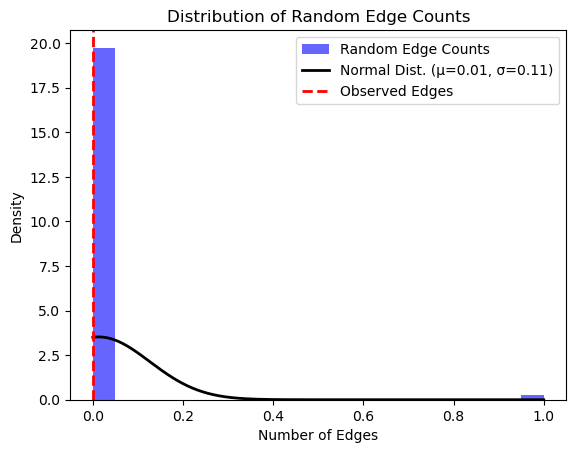

z score for a random nodes: -0.11476596157913455

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000702/associations?projection=associationByStudy
Genes: 75

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DYNC2H1%0dEPHB1%0dPPP2R3A%0dBBX%0dMARCH1%0dMIR5684%0dNONE%0dLINC00290%0dFCHO2%0dADGRV1%0dNEDD9%0dHMGN4%0dABT1%0dZNF322%0dGUSBP2%0dIFITM4P%0dHCG4%0dTRIM39-RPP21%0dHLA-E%0dSFTA2%0dHCG22%0dC6orf15%0dBAG6%0dNEU1%0dHLA-DRB1%0dHLA-DQA1%0dBMP6%0dSCIN%0dSKAP2%0dHOXA1%0dFAM167A-AS1%0dC8orf48%0dSGCZ%0dSH3GL2%0dADAMTSL1%0dNRP1%0dLINC00838%0dCRTAM%0dSTK33%0dFUT4%0dPIWIL4%0dRAD52%0dA2ML1%0dPHC1%0dBRCA2%0dLINC00383%0dRGS6%0dFOXN3%0dALDH1A2%0dAQP9%0dCHRNB4%0dLOC646938%0dLOC101927286%0dADAD2%0dVSTM1%0dTMA16%0dFSTL4%0dWSPAR%0dBTN3A1%0dIER3%0dLINC00243%0dHLA-C%0dHLA-B%0dCOL21A1%0dDST%0dUMAD1%0dIL33%0dDISC1FP1%0dLINC00936%0dLINC00615%0dTMEM179%0dMIR4710%0dCHRNA5%0dUBE2G1%0dSPNS3&speci

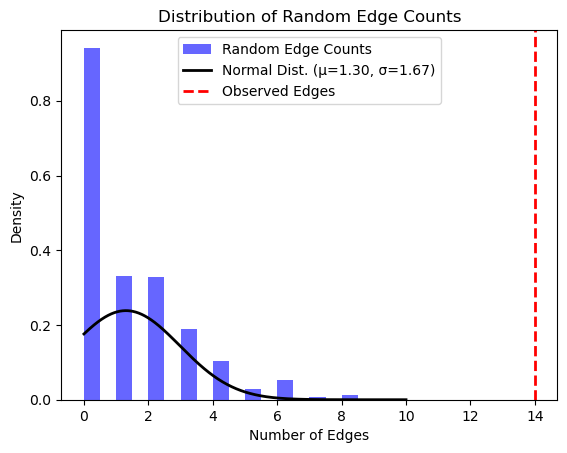

z score for a random nodes: 7.587874903699759

P-value: 1.33e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000681/associations?projection=associationByStudy
Genes: 25

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ITPR2%0dNR%0dSCARB1%0dEPAS1%0dPP13439%0dintergenic%0dMYC%0dPVT1%0dZEB2%0dPDZD2%0dAX746803%0dAK094674%0dBTBD11%0dSAMD5%0dDPF3%0dKDELC2%0dTNFRSF10B%0dRHOBTB2%0dOBFC1%0dATM%0dFAF1%0dLRRIQ4%0dRBFOX1%0dSLC6A18%0dSTEAP3&species=9606

Proteins: 21

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url

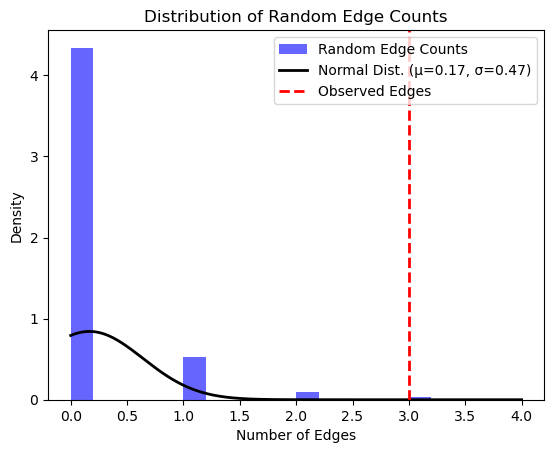

z score for a random nodes: 5.981992248064476

P-value: 0.0631
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000478/associations?projection=associationByStudy
Genes: 45

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FOXP1%0dNR%0dBARX1%0dPTPDC1%0dFOXF1%0dCRTC1%0dMTRNR2L9%0dMGST1%0dLMO3%0dPRSS55%0dRP1L1%0dDPYSL2%0dCEP72%0dASZ1%0dRNF144A%0dLOC339788%0dACTBL2%0dPLK2%0dAPOB%0dAK098570%0dLSP1P3%0dLDAH%0dGDF7%0dALDH1A2%0dCFTR%0dMSRA%0dBLK%0dLINC00208%0dLOC105369996%0dTBX5%0dKHDRBS2%0dTPPP%0dMHC%0dTMOD1%0dSATB2%0dLOC732275%0dCDR1%0dSPANXB2%0dRND3%0dRBM43%0dLOC340268%0dSNORD114-31%0dLOC100130814%0dHTR3C%0dC2orf43&species=9606

Proteins: 34

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Request

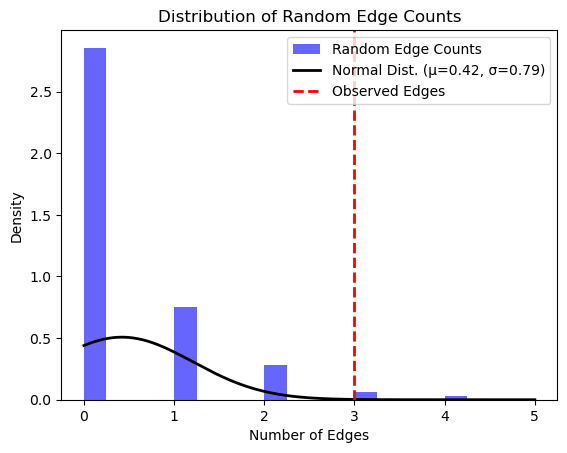

z score for a random nodes: 3.2812687430489373

P-value: 0.0104
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005221/associations?projection=associationByStudy
Genes: 26

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FBXO36%0dSLC16A14%0dSP110%0dSP140%0dSP140L%0dSP100%0dC10orf107%0dARID5B%0dMIR548AV%0dCACNA2D2%0dC3orf18%0dHEMK1%0dCISH%0dMAPKAPK3%0dMIR4787%0dDOCK3%0dLOC102546298%0dNDST1%0dSYNPO%0dMYOZ3%0dRBM22%0dDCTN4%0dSMIM3%0dIRGM%0dZNF300%0dZNF300P1&species=9606

Proteins: 22

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: To

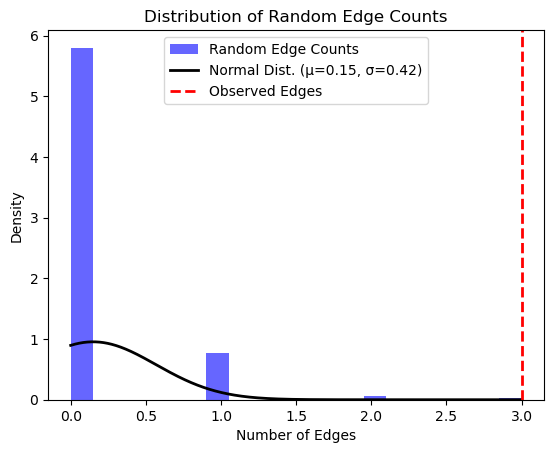

z score for a random nodes: 6.819110773457565

P-value: 0.00019
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1002017/associations?projection=associationByStudy
Genes: 11

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dOBFC1%0dNRG1%0dDIRC3%0dMSRB3%0dVAV3%0dPCNXL2%0dNKX2-1%0dSEPT11%0dFHIT%0dFOXE1&species=9606

Proteins: 10

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 

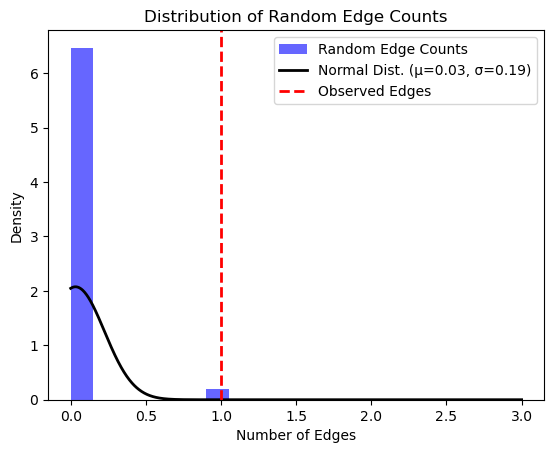

z score for a random nodes: 5.0340252924218145

P-value: 0.0503
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000641/associations?projection=associationByStudy
Genes: 9

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NRG1%0dDIRC3%0dMSRB3%0dVAV3%0dPCNXL2%0dNKX2-1%0dSEPT11%0dFHIT%0dFOXE1&species=9606

Proteins: 8

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: T

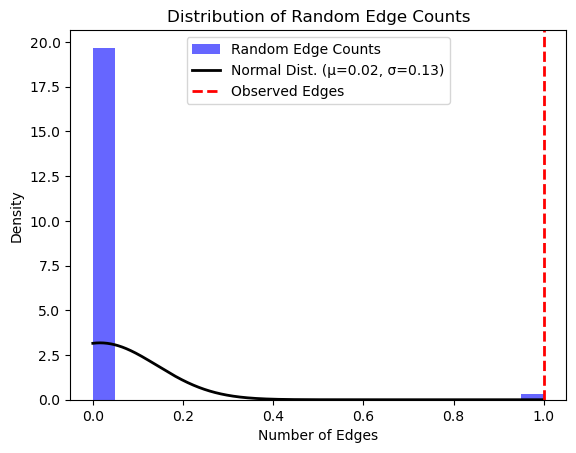

z score for a random nodes: 7.8421935706790595

P-value: 0.0153
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001931/associations?projection=associationByStudy
Genes: 15

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GALNT14%0dMUC21%0dHLA-DQA1%0dBTBD11%0dADH1B%0dLINC01229%0dintergenic%0dKCNC4%0dLOC105369574%0dTENM3%0dADCY2%0dCSGALNACT1%0dWDFY3%0dLOC105374446%0dHLA-DQB1&species=9606

Proteins: 12

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to 

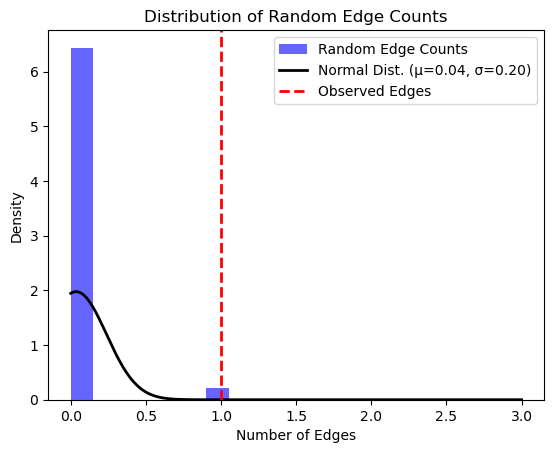

z score for a random nodes: 4.778135803951819

P-value: 0.0492
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005570/associations?projection=associationByStudy
Genes: 15

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GPN1%0dC2orf16%0dZNF512%0dCCDC121%0dADH1B%0dCLPTM1L%0dCDKN2B-AS1%0dLAMC3%0dLOC105376298%0dLOC105370811%0dNR2F2-AS1%0dintergenic%0dMICB%0dAIF1%0dHLA-DQB1&species=9606

Proteins: 11

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to ret

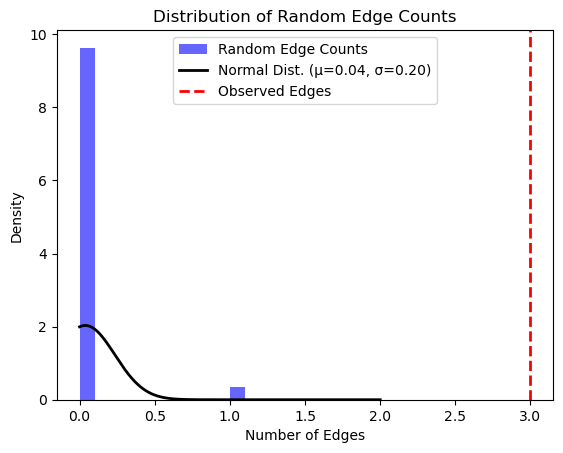

z score for a random nodes: 15.084783045542013

P-value: 1.68e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000657/associations?projection=associationByStudy
Genes: 11

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dEFR3A%0dAC011343.1%0dSLC22A23%0dANO1%0dPYGL%0dNIN%0dABHD12B%0dCDX1%0dKLF14%0dLINC00513&species=9606

Proteins: 9

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for 

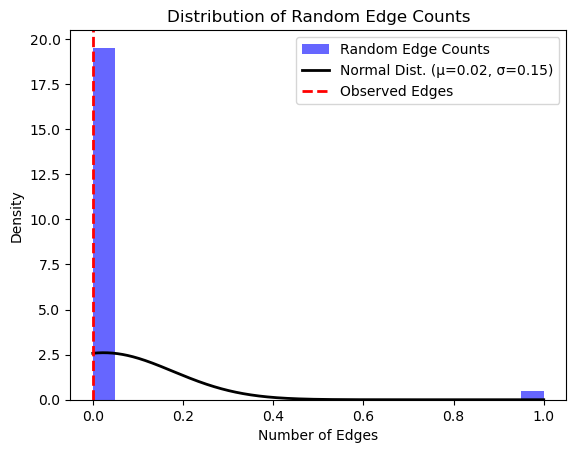

z score for a random nodes: -0.156812512046795

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001950/associations?projection=associationByStudy
Genes: 7

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PTGER3%0dSTAB1%0dTLR9%0dNISCH%0dFAM118A%0dFBLN1%0dNR&species=9606

Proteins: 7

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for

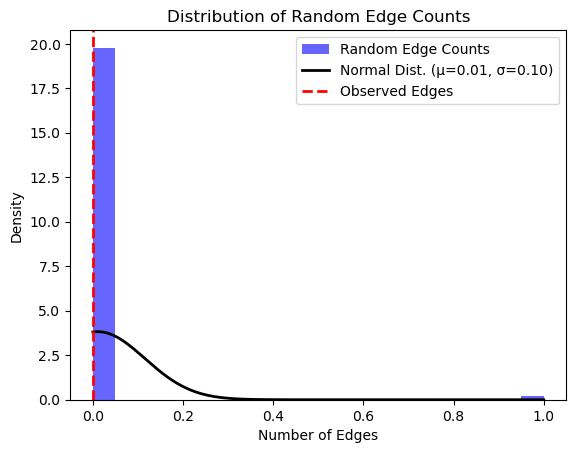

z score for a random nodes: -0.10546253270162945

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005088/associations?projection=associationByStudy
Genes: 31

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TERT%0dCLPTM1L%0dDMRT1%0dATF7IP%0dSPRY4%0dKITLG%0dintergenic%0dBAK1%0dSLC25A44%0dUCK2%0dDAZL%0dCENPE%0dCATSPER3%0dPITX1%0dPRDM14%0dHEATR3%0dRAD51C%0dTEX14%0dMCM3AP%0dC17orf47%0dPPM1E%0dSEPT4%0dTRIM37%0dSKA2%0dRFWD3%0dGLG1%0dMLKL%0dLIPG%0dMAD1L1%0dSMARCAD1%0dHPGDS&species=9606

Proteins: 30

Number of edges: 7

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve d

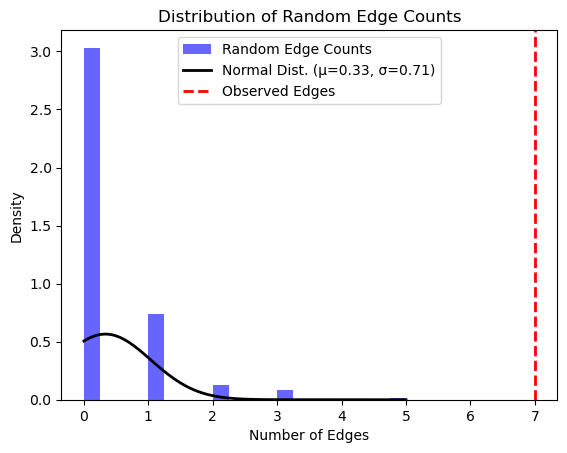

z score for a random nodes: 9.446422999234217

P-value: 3.98e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006861/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PRKACB%0dLOC643174%0dTOX3%0dRAD51B%0dNR&species=9606

Proteins: 4

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: htt

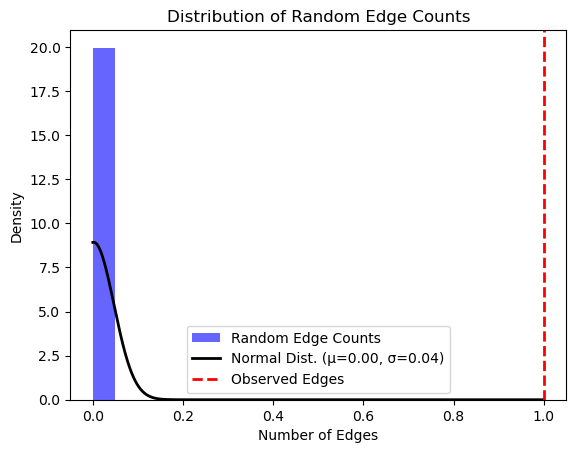

z score for a random nodes: 22.338307903688676

P-value: 0.0654
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004806/associations?projection=associationByStudy
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PTHR2%0dPPL&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no

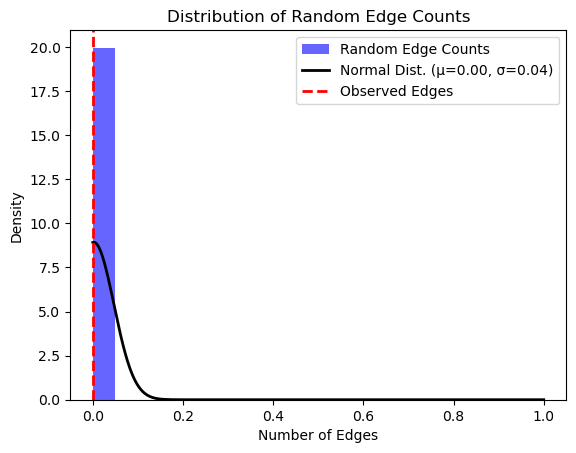

z score for a random nodes: -0.04476614810358452

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004284/associations?projection=associationByStudy
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ADH1B%0dADH7%0dADH1C%0dHEL308%0dADH%0dFAM175A%0dALDH2%0dNR&species=9606

Proteins: 8

Number of edges: 9

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requ

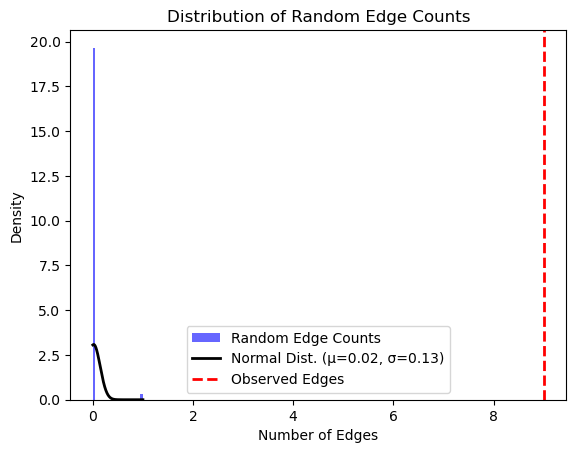

z score for a random nodes: 69.48965893010794

P-value: 4.44e-15
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000326/associations?projection=associationByStudy
Genes: 32

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dRTEL1%0dTERT%0dCCDC26%0dCDKN2A%0dCDKN2B%0dPHLDB1%0dEGFR%0dTERC%0dNR%0dC12orf41%0dPAPPA2%0dKLF7%0dLMF1%0dSLC16A8%0dMPG%0dRAVER2%0dHEATR3%0dTP53%0dLRRC4C%0dMDM4%0dIDH1%0dOBFC1%0dAKAP6%0dETFA%0dZBTB16%0dVTI1A%0dAKT3%0dLRIG1%0dMAML2%0dVTl1A%0dPOLR3B&species=9606

Proteins: 30

Number of edges: 21

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve dat

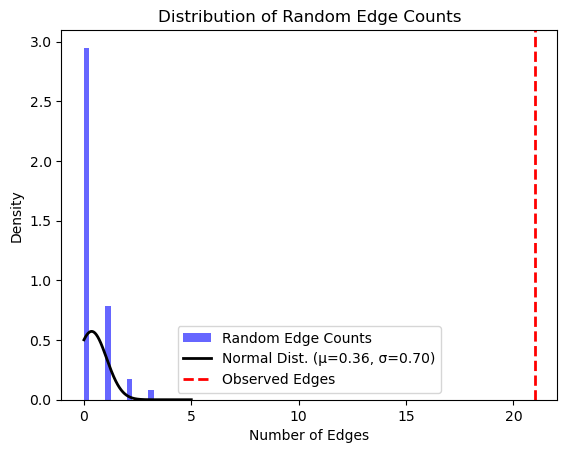

z score for a random nodes: 29.614672036710484

P-value: 8.13e-08
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000096/associations?projection=associationByStudy
Genes: 14

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DQB1%0dintergenic%0dC6orf15%0dSTG%0dPSORS1%0dCXCR5%0dHLA%0dETS1%0dLPP%0dBCL2%0dPVT1%0dC17orf62%0dCD86%0dSLC14A2&species=9606

Proteins: 12

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random n

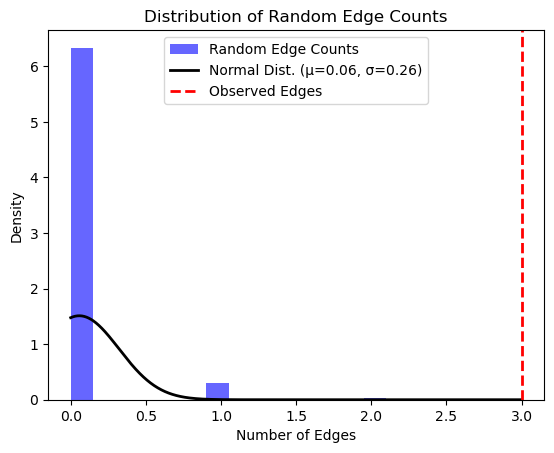

z score for a random nodes: 11.143331307702553

P-value: 0.0068
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004230/associations?projection=associationByStudy
Genes: 38

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HNF1B%0dSFPQ%0dintergenic%0dADAM12%0dLINGO2%0dLOC643623%0dLOC100131869%0dRNASET2%0dCACNA2D3%0dECT2L%0dTET2%0dSH2B3%0dGUCY1A2%0dCDKN2B-AS1%0dGMCL1%0dMGAT5B%0dLITAF%0dLSAMP%0dKLF4%0dNPAS3%0dHOXB1%0dTSHZ1%0dNANP%0dZNF429%0dRNGTT%0dARL5B%0dSCAF8%0dTDP2%0dPSMC3IP%0dTMTC1%0dCSRNP3%0dEZH2%0dFBP1%0dGDPD5%0dPRCP%0dLIMA1%0dCLEC3A%0dNCAM2&species=9606

Proteins: 35

Number of edges: 5

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed

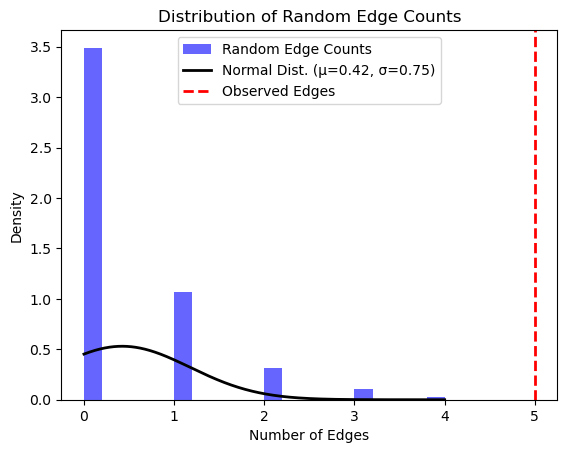

z score for a random nodes: 6.081236297756612

P-value: 4.96e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005922/associations?projection=associationByStudy
Genes: 17

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TMEM173%0dTP53%0dATP1B2%0dHLA%0dCDKN2B%0dCDKN2A%0dNR%0dPLCE1%0dKIAA1516%0dCASP8%0dALS2CR12%0dRUNX1%0dCHEK2%0dCCDC117%0dXBP1%0dPDE4D%0dPDE4DN2&species=9606

Proteins: 15

Number of edges: 7

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clu

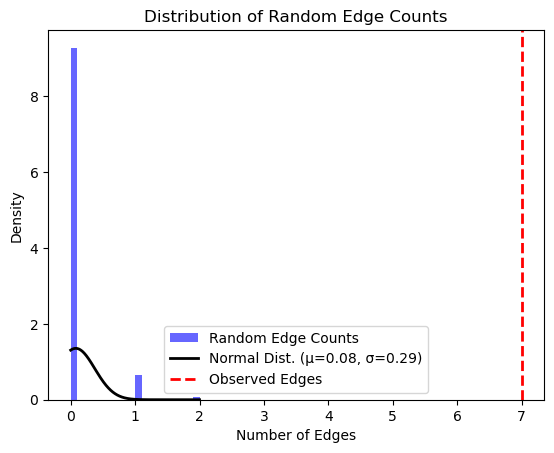

z score for a random nodes: 23.49695474488356

P-value: 0.0106
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009443/associations?projection=associationByStudy
Genes: 17

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SIAH2%0dPDE7B%0dCCDC170%0dESR1%0dBET1%0dASPH%0dCDKN2B-AS1%0dDCAF12%0dFGFR2%0dDOCK1%0dITPR2%0dPGAM1P5%0dNTN4%0dIntergenic%0dTOX3%0dSLC39A11%0dCASC16&species=9606

Proteins: 14

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve

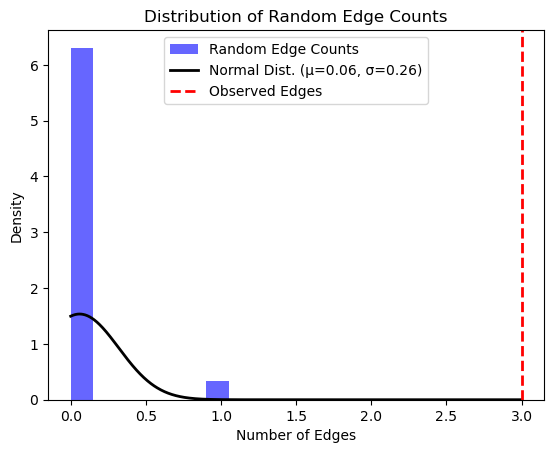

z score for a random nodes: 11.318321441048338

P-value: 0.0062
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0007321/associations?projection=associationByStudy
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RTTN%0dAKR1C1&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-

/Users/aliaarman/Desktop/thesis/code/disease.py:15: RuntimeWarning: invalid value encountered in scalar divide
  z_score = (observed_edges - mean) / std
/Users/aliaarman/anaconda3/lib/python3.11/site-packages/scipy/stats/_distn_infrastructure.py:1988: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


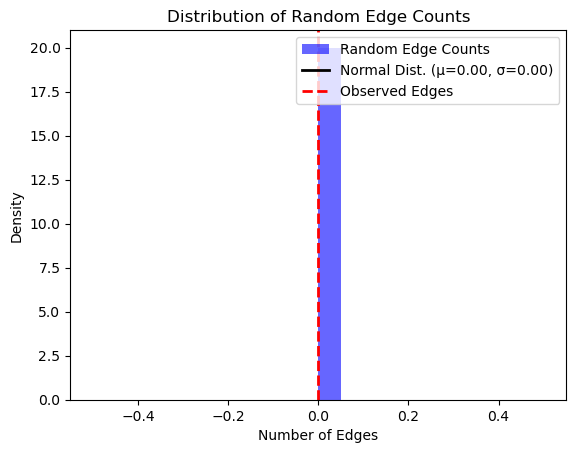

z score for a random nodes: nan

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0002367/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing kidney cancer: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000166/associations?projection=associationByStudy
Genes: 6

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PAX8%0dHLA-DQA1%0dCLPTM1L%0dHLA-B%

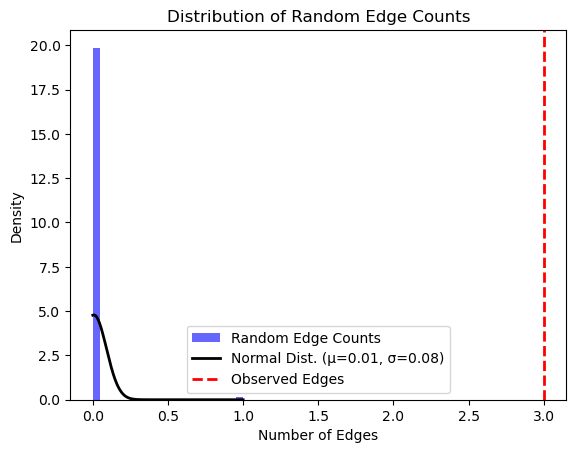

z score for a random nodes: 35.899059640831226

P-value: 2.54e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0008903/associations?projection=associationByStudy
Genes: 11

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=LOC102723824%0dLINC02056%0dZRANB1%0dHRH4%0dLINC01377%0dLINC02039%0dMAP7%0dCSMD1%0dMIR4675%0dATP8B1%0dGRIK1&species=9606

Proteins: 6

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Fa

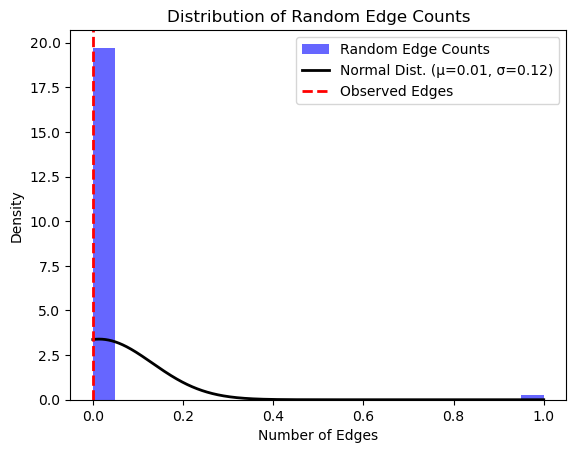

z score for a random nodes: -0.11915864618843422

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000349/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing clear cell renal carcinoma: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002890/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&speci

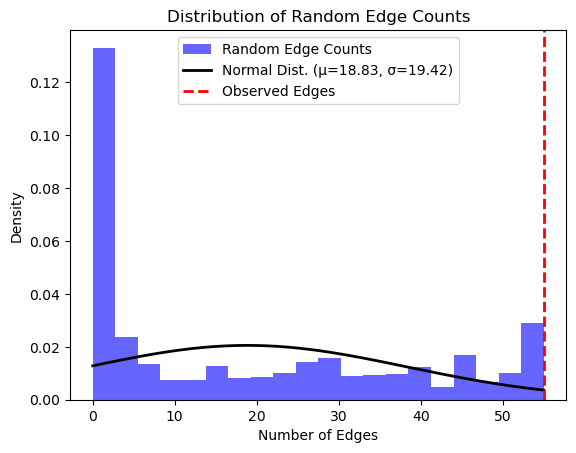

z score for a random nodes: 1.8624217775514356

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0001056/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing gastric cancer: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0007254/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

F

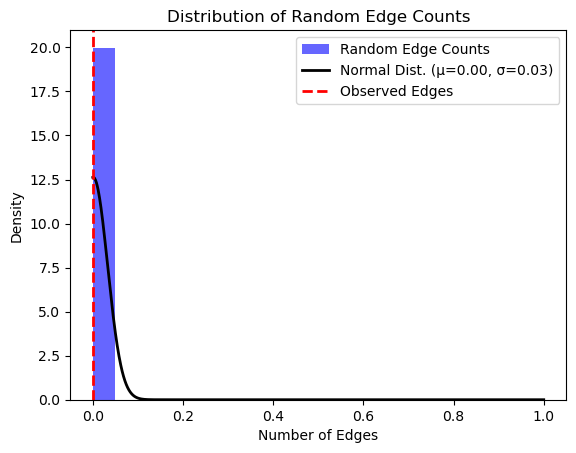

z score for a random nodes: -0.03163859985841663

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006999/associations?projection=associationByStudy
Genes: 4

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RASA1%0dCCNH%0dNAALADL2%0dKLK3&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string

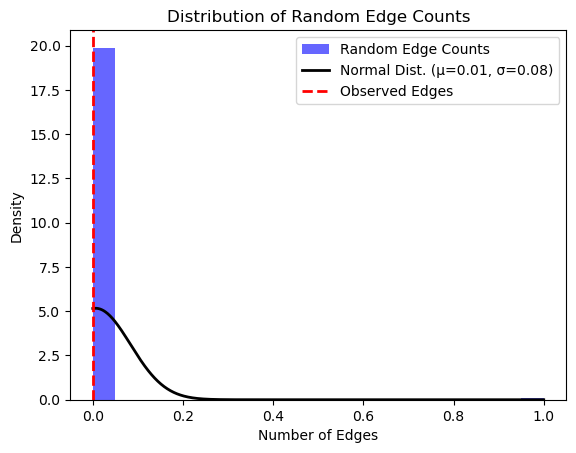

z score for a random nodes: -0.07769309688655059

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002427/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing myeloid neoplasm: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003860/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

F

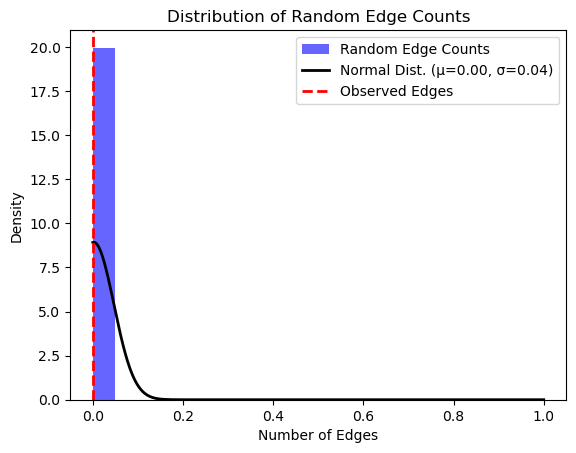

z score for a random nodes: -0.04476614810358452

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0001187/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing urinary bladder cancer: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003869/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species

In [36]:
print(output5)
output10 = compute_clustering(cancerous[10:])

In [39]:
print(len(output10))
print(output10)

56
[{'name': 'triple-negative breast cancer', 'efoID': 'EFO_0005537', 'num_edges': 0, 'z_score': -0.09529814069846938}, {'name': 'colorectal cancer', 'efoID': 'MONDO_0005575', 'num_edges': 122, 'z_score': 8.832497451928058}, {'name': 'endometrial carcinoma', 'efoID': 'EFO_1001512', 'num_edges': 19, 'z_score': 13.575820369220034}, {'name': 'squamous cell lung carcinoma', 'efoID': 'EFO_0000708', 'num_edges': 53, 'z_score': 5.1666667650467835}, {'name': 'gastric carcinoma', 'efoID': 'EFO_0000178', 'num_edges': 1, 'z_score': 1.710041075614297}, {'name': 'gastric adenocarcinoma', 'efoID': 'EFO_0000503', 'num_edges': 1, 'z_score': 7.843202074411681}, {'name': 'estrogen-receptor negative breast cancer', 'efoID': 'EFO_1000650', 'num_edges': 23, 'z_score': 11.952356914056848}, {'name': 'ovarian mucinous adenocarcinoma', 'efoID': 'EFO_0006462', 'num_edges': 0, 'z_score': -0.08980265101338747}, {'name': 'cervical carcinoma', 'efoID': 'EFO_0001061', 'num_edges': 19, 'z_score': 21.242508697405846},

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000305/associations?projection=associationByStudy
Genes: 252

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GLG1%0dRAD51L1%0dintergenic%0dFGFR2%0dMAP3K1%0dTOX3%0dESR1%0dC6orf97%0dSLC4A7%0dKLF4%0dACTL7A%0dRAD23B%0dTNRC9%0dLOC643714%0dLSP1%0dCDKN2A%0dCDKN2B%0dANKRD16%0dFBXO18%0dZNF365%0dZMIZ1%0dFGF3%0dMYEOV%0dCCND1%0dORAOV1%0dFGF19%0dFGF4%0dECHDC1%0dRNF146%0dMRPS30%0dERBB4%0dLRRN2%0dPIK3C2B%0dMDM4%0dLGR6%0dUBE2T%0dPTPN7%0dFTO%0dKIAA1752%0dTERT%0dPTHLH%0dMERIT40%0dPEX14%0dEBF1%0dNTN4%0dBRCA2%0dN4BP2L1%0dMIR1972-2%0dMKL1%0dTNIP3%0dSLC45A1%0dSIAH2%0dTCF7L2%0dNR%0dBCL2L15%0dAP4B1%0dDCLRE1B%0dHIPK1%0dPTPN22%0dMETAP1D%0dDLX1%0dDLX2%0dDIRC3%0dITPR1%0dEGOT%0dTGFBR2%0dTET2%0dADAM29%0dRAB3C%0dFOXQ1%0dRANBP9%0dARHGEF5%0dNOBOX%0dMYC%0dMIR1208%0dDNAJC1%0dMLLT10%0dDKFZp761E198%0dOVOL1%0dSNX32%0dCFL1%0dMUS81%0dN4BP2L2%0dPAX9%0dSLC25A21%0dCCDC88C%0dCDYL2%0dSSBP4%0dISYNA1%0dELL%0dC19orf61%0dKCNN4

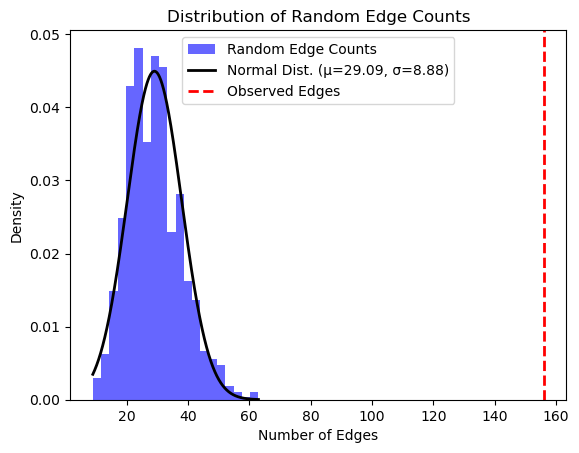

z score for a random nodes: 14.29446187282527

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001663/associations?projection=associationByStudy
Genes: 195

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dTCF2%0dLOC340602%0dNUDT10%0dNUDT11%0dEHBP1%0dSLC22A3%0dMSMB%0dKLK3%0dLMTK2%0dHNF1B%0dCTBP2%0dJAZF1%0dNR%0dINSC%0dTET2%0dACOXL%0dIGF2%0dIGF2AS%0dINS%0dTH%0dC16orf78%0dVGLL3%0dPDLIM5%0dKIF13A%0dSPATA16%0dBAI3%0dPTPRU%0dPKIA%0dDAB2IC%0dUPF2%0dANP32D%0dDNAH12%0dMYEOV%0dBAIAP2L1%0dRNASE9%0dSYK%0dC9orf123%0dCLVS2%0dCWC22%0dLOC63930%0dINHBA%0dDNAH5%0dPPP1R14A%0dMIR656%0dEEFSEC%0dCD180%0dTNRC6B%0dSNX16%0dANXA13%0dLOC285830%0dNKX3.1%0dANK2%0dNR2F2%0dTSEN2%0dEVC%0dAMIGO2%0dTTLL1%0dBIK%0dMCAT%0dPACSIN2%0dCD200R1L%0dITAGA6%0dMIR622%0dMIR4319%0dCEP152%0dPLCL1%0dABLIM1%0dTMTC2%0dACTBL2%0dC7orf66%0dTNC%0dCNTN6%0dNCRNA00284%0dTHADA%0dACTC1%0dMN1%0dZNF280B%0dC18orf34%0dCH

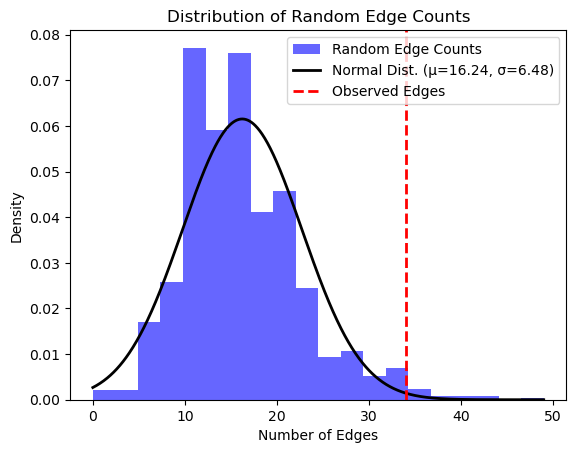

z score for a random nodes: 2.7397304751672293

P-value: 6.5e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004986/associations?projection=associationByStudy
Genes: 46

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TMEM129%0dSLBP%0dTACC3%0dFGFR3%0dMYC%0dTP63%0dPSCA%0dBC042052%0dSLC14A1%0dCLK3%0dCYP1A2%0dACTRT3%0dMYNN%0dTERC%0dLRRC34%0dLSP1%0dC20orf187%0dLOC339593%0dCDKAL1%0dNR%0dJAG1%0dPOU5F1B%0dPVT1%0dCBX6%0dAPOBEC3A%0dCCNE1%0dNAT2%0dTERT%0dCLPTM1L%0dUGT1A%0dGSTM1%0dFOXF2%0dHTR5A%0dPAXIP1%0dINSIG1%0dPRKAR2B%0dTAGAP%0dRSPH3%0dEZR%0dFMN1%0dCLPTML%0dintergenic%0dSLC14A2%0dUHRF1BP1%0dNBEA%0dCWC27&species=9606

Proteins: 41

Number of edges: 14

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for

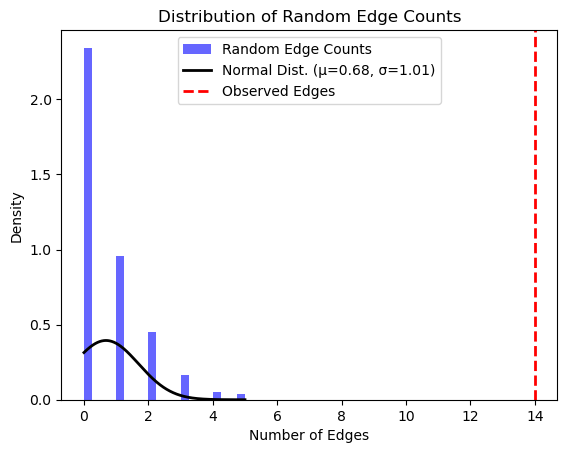

z score for a random nodes: 13.169594572442627

P-value: 3.42e-07
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006352/associations?projection=associationByStudy
Genes: 12

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=AIF1%0dHLA%0dFADS1%0dFADS2%0dFADS3%0dFEN1%0dEPHA7%0dVCAN%0dGRIN2A%0dTBX5%0dRTTN%0dAKR1C1&species=9606

Proteins: 12

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https

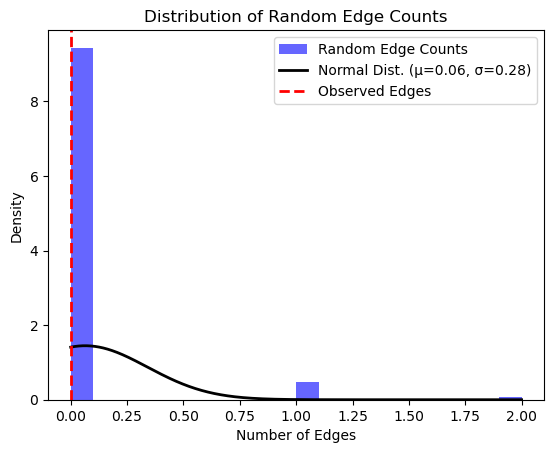

z score for a random nodes: -0.2322991616556164

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002916/associations?projection=associationByStudy
Genes: 28

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEATR3%0dHAP1%0dXBP1%0dST6GAL1%0dSMG6%0dPTPN2%0dCHEK2%0dPLCE1%0dNOC3L%0dHSCB%0dC12orf51%0dCSNK1A1%0dTBL1XR1%0dSEMA5B%0dANP32A%0dPDE4D%0dACAD10%0dRUNX1%0dUNC5CL%0dRPL6%0dSLC39A6%0dADH1B%0dADH4%0dIGFB2%0dSLC10A2%0dBRAP%0dALDH2%0dADH6&species=9606

Proteins: 27

Number of edges: 7

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many R

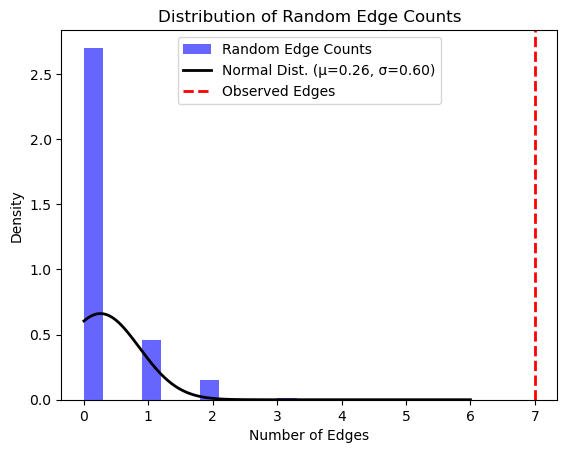

z score for a random nodes: 11.170953473244028

P-value: 0.0055
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001071/associations?projection=associationByStudy
Genes: 391

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CHRNA3%0dCLPTM1L%0dBAT3%0dTGM5%0dNR%0dGPC5%0dTERT%0dintergenic%0dCHRNA5%0dPSMA4%0dLOC123688%0dCHRNB4%0dCRP%0dIL1RAP%0dPTHR2%0dPPL%0dTP63%0dMIPEP%0dMTMR3%0dMSH5%0dhTERT%0dBPTF%0dTNFAIP6%0dRIF1%0dVTI1A%0dROS1%0dDCBLD1%0dHLA class II%0dERCC2%0dXPD%0dPHACTR2%0dPMS1%0dSTAT1%0dHIBCH%0dINPP1%0dBRCA2%0dFRY%0dCHEK2%0dRAD52%0dSMAD6%0dSMAD3%0dGNG2%0dNID2%0dFRMD6%0dLRFN2%0dSP4%0dDNAH11%0dDBT%0dRTCA-AS1%0dLMNA%0dNONE%0dKCNT2%0dPLD5%0dLINC01347%0dCEP170%0dTTC34%0dACTRT2%0dAK5%0dDNAJB4%0dGIPC2%0dMGC27382%0dPTGFR%0dFHL2%0dLOC285000%0dMLK7-AS1%0dTMEM237%0dITSN2%0dNCOA1%0dFSHR%0dNRXN1%0dLOC102800447%0dETAA1%0dLOC101927701%0dMBOAT2%0dRBMS3%0dCACNA2D3%0dADRA2C%0dFAM86EP%0dLOC10192827

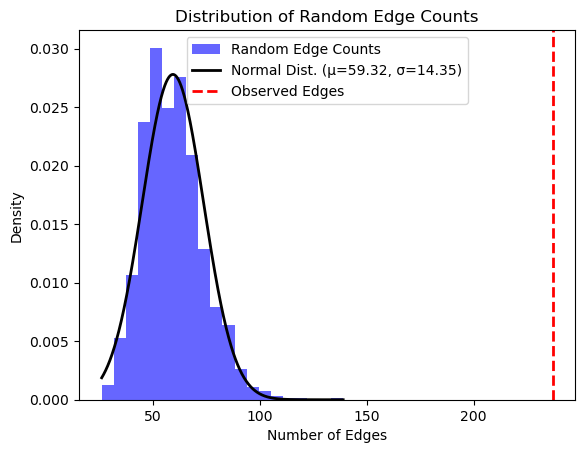

z score for a random nodes: 12.384415476792961

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000707/associations?projection=associationByStudy
Genes: 52

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEATR3%0dHAP1%0dXBP1%0dST6GAL1%0dSMG6%0dPTPN2%0dCHEK2%0dSLC39A6%0dBRCA2%0dFRY%0dLRFN2%0dSP4%0dDNAH11%0dSLC45A2%0dIRF4%0dTYR%0dHERC2%0dDEF8%0dMC1R%0dRALY%0dFOXP1%0dTPRG1%0dTP63%0dHLA-DQA1%0dBNC2%0dCNTLN%0dOCA2%0dSPATA33%0dRP1-168P16.2%0dRP11-428J1.2%0dLINC01149%0dLPP%0dALS2CR12%0dTRPS1%0dCCR12P%0dDTNBP1%0dSEC16A%0dBACH2%0dKRT5%0dRPL5P32%0dTPM3P2%0dTUBB3%0dPARK2%0dSRC%0dST3GAL1%0dERBB2IP%0dintergenic%0dRP11-395F4.1%0dHAPLN3%0dCSMD1%0dPRF1%0dPPP2R2C&species=9606

Proteins: 45

Number of edges: 15

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Faile

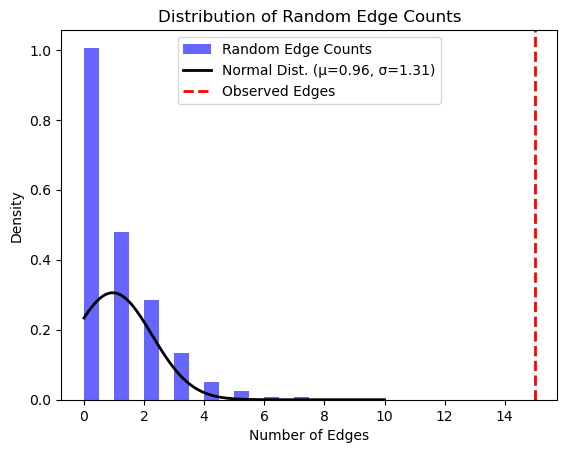

z score for a random nodes: 10.760521483645325

P-value: 7.19e-07
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000571/associations?projection=associationByStudy
Genes: 171

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TP63%0dTERT%0dCLPTM1L%0dAPOM%0dBAT3%0dTRNAA-UGC%0dCHRNA5%0dCHRNA3%0dBPTF%0dBTNL2%0dNR%0dUBAC1%0dDLG2%0dIntergenic%0dNWD2%0dKIAA1239%0dCAPZB%0dAFTPH%0dAQP3%0dSECISBP2L%0dRNLS%0dFAM194B%0dEPHB1%0dRP11-753N8.1%0dAC097713.3%0dLMCD1-AS1%0dC1D%0dFOXP1%0dAC020626.1%0dNTM%0dAKR1B10%0dROBO2%0dNAALADL2%0dTLDC2%0dSATB1%0dTMEM218%0dTUB%0dRP11-269F21.3%0dZNRD1%0dNAF1%0dSLC52A1%0dZFP3%0dHSD17B2%0dMPHOSPH6%0dTBK1%0dRASSF3%0dSBF2%0dLOC554223%0dHLA-G%0dKIAA1456%0dDLC1%0dMPZL2%0dACTR2%0dSPRED2%0dLOC101054525%0dTRPC6%0dLPCAT1%0dHLA-A%0dHCG9%0dGABBR1%0dMOG%0dMICALCL%0dPARVA%0dNRG1%0dLRFN1%0dGMFG%0dGIPC2%0dMGC27382%0dADAMTS7%0dETAA1%0dLOC101927701%0dOBFC1%0dSLK%0dCEACAM21%0dCEACAM4%

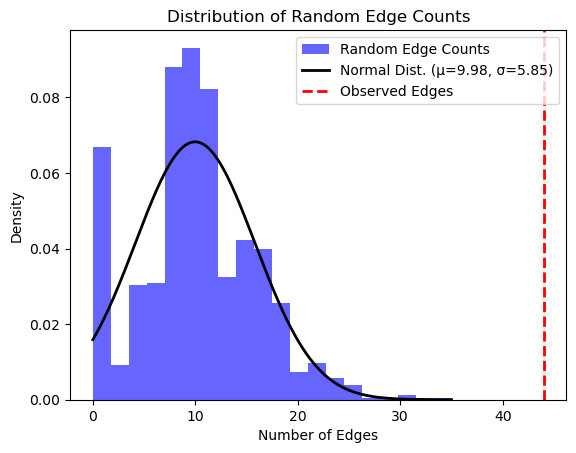

z score for a random nodes: 5.818677055326006

P-value: 6.19e-13
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004252/associations?projection=associationByStudy
Genes: 97

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ITGA9%0dTNFRSF19%0dHLA-DQ%0dHLA-DR%0dHLA-A%0dHLA-C%0dHLA-B%0dMDS1%0dEVI1%0dCDKN2B%0dCDNK2A%0dGABBR1%0dHLA-F%0dHLA%0dCREB5%0dKIF2B%0dWBSCR17%0dC5%0dMIR1973%0dADAM12%0dRHBDD1%0dERG%0dDGKB%0dDLD%0dTUSC1%0dRBFOX1%0dADCY3%0dNTRK2%0dVRK2%0dMIR4432%0dKCNQ4%0dDPP6%0dFBXL7%0dZNF365%0dPPFIA2%0dRHOT1%0dCOMMD10%0dNRG3%0dPCLO%0dMIR548%0dCRTAC1%0dOLFM4%0dBC038529%0dFAM155A%0dJAK2%0dZFHX3%0dETV3%0dIMPACT%0dLINC00290%0dSPERT%0dHIP1%0dCPA6%0dOSR1%0dLRMP%0dEDN2%0dFLT4%0dN4BP2L1%0dGAS7%0dINTU%0dSMAD3%0dEYS%0dGRIK1%0dMANEA%0dFAM19A5%0dHMGXB3%0dEPC1%0dC1orf130%0dADD2%0dLOC10050737%0dBTG3%0dDUSP1%0dZNF507%0dEU250752%0dMIR3147%0dPID1%0dSUMF1%0dFOXC1%0dPRPF38B%0dCNTNAP2%0dEMR1%0dTBX3%0dM

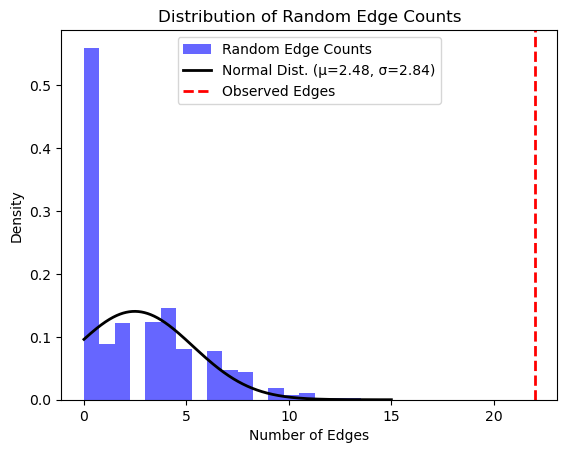

z score for a random nodes: 6.8786163083220035

P-value: 1.68e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003060/associations?projection=associationByStudy
Genes: 44

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=EIF4E2%0dETS2%0dDSCAM%0dSLC17A8%0dNR1H4%0dSCYL2%0dGAS2L3%0dAPCDD1%0dNAPG%0dFAM38B%0dNR%0dC3orf21%0dFAM154A%0dCPS1%0dMIER2%0dintergenic%0dANKS1A%0dDLST%0dTHSD7B%0dNCOA2%0dCDH8%0dLIPC%0dNALCN%0dSLC35D2%0dGPR113%0dLINC00290%0dCAMK2D%0dTNS3%0dSEPT7%0dCDKN2A%0dTP63%0dBAZ1A%0dVTI1A%0dTERT%0dFOXP4%0dBPTF%0dMYNN%0dMHC%0dCASP8%0dNRG1%0dMPZL3%0dCHRNA5%0dCYP2A6%0dDCBLD1&species=9606

Proteins: 43

Number of edges: 6

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.or

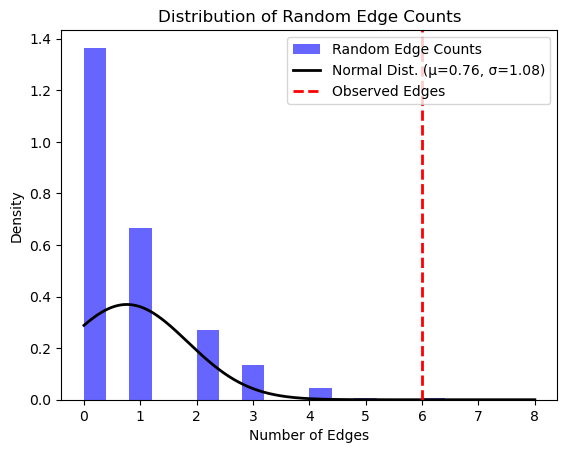

z score for a random nodes: 4.851851851851852

P-value: 0.0032
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005537/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=MDM4%0dPTHLH%0dTERT%0dintergenic%0dESR1&species=9606

Proteins: 5

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https

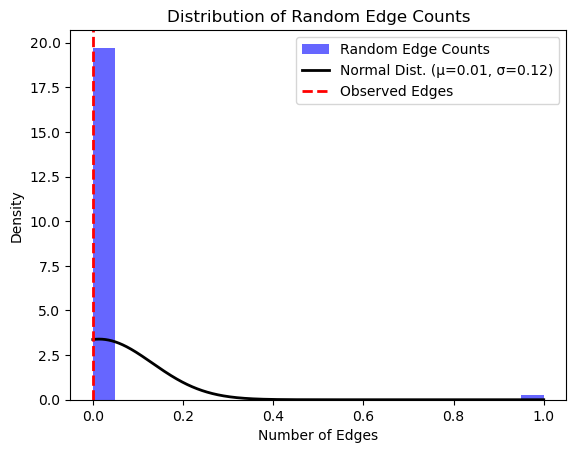

z score for a random nodes: -0.11915864618843422

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005575/associations?projection=associationByStudy
Genes: 278

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=EPB41L2%0dTMEM200A%0dFAM190A%0dTENM3%0dAGA%0dintergenic%0dLOC101928923%0dDPP10%0dLINC01121%0dGRIA1%0dHCN1%0dMGST1%0dPIK3C2G%0dIL16%0dKIAA1456%0dLONRF1%0dRPL27AP8%0dSUCLA2%0dVN1R86P%0dZNF492%0dPNMAL1%0dMORC1%0dDPP6%0dFLJ22763%0dGATA3%0dGATA-AS1%0dMEIS1%0dDNMT3AP1%0dNPM1P5%0dST8SIA2%0dMRPL42P4%0dTNS3%0dACOXL%0dLCORL%0dRPL21P46%0dELOVL5%0dDCC%0dBMP4%0dRHPN2%0dCDH1%0dDUSP10%0dLAMA5%0dMYNN%0dDIP2B%0dATF1%0dNR%0dEIF3H%0dSMAD7%0dMYC%0dBMP2%0dNABP1%0dCRAC1%0dHMPS%0dGREM1%0dCCND2%0dTBX3%0dLAMC1%0dC1orf110%0dDCBLD1%0dGOPC%0dCDKN1A%0dPOLD3%0dSHROOM2%0dPOU5FIP1%0dHsG57825%0dDQ515897%0dPLEKHG6%0dTNFRSF1A%0dCD9%0dMYRF%0dFADS1%0dFADS2%0dFEN1%0dNXN%0dTGFB1%0dB9D2%0dPITX1%0dHAO1%

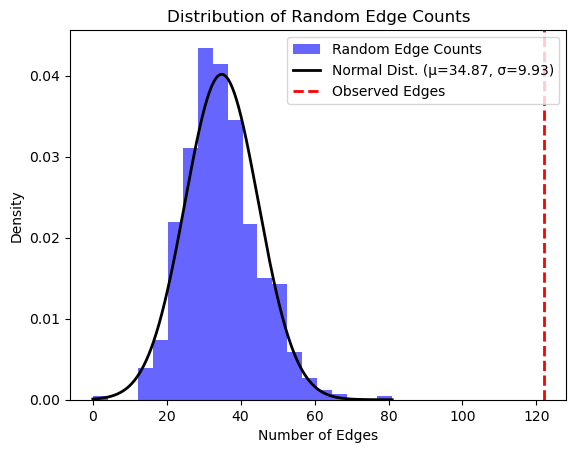

z score for a random nodes: 8.774793763816321

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/ppi_enrichment
Failed to retrieve PPI enrichment data.
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001514/associations?projection=associationByStudy
Genes: 10

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEY2%0dNCOA7%0dMYC%0dEIF2AK%0dBMF%0dAKT1%0dSIVA1%0dHNF1B%0dCYP19A1%0dKLF12&species=9606

Proteins: 9

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests 

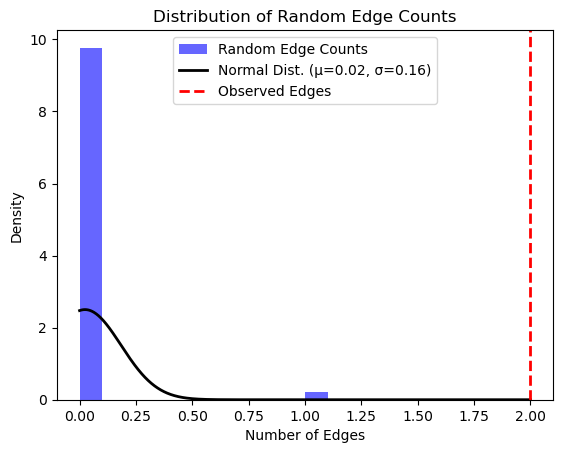

z score for a random nodes: 12.392673285625433

P-value: 0.1006
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001512/associations?projection=associationByStudy
Genes: 60

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=Intergenic%0dLOC643623%0dKLF5%0dSOX4%0dCASC15%0dCDKAL1%0dHNF1B%0dMYC%0dKLF12%0dHEY2%0dNCOA7%0dEIF2AK%0dBMF%0dAKT1%0dSIVA1%0dCYP19A1%0dTOMM20P1%0dPCDH10%0dMBOAT1%0dSGCZ%0dEXT1%0dPRICKLE1%0dCDKN3%0dNR%0dKLF3%0dTLR10%0dTFAP2D%0dPTPRD%0dBCL11A%0dLOC101929006%0dLOC105375005%0dBPTF%0dNCAM2%0dPPARG%0dCSMD2%0dGNL2%0dRSP01%0dLPPR4%0dEEFSEC%0dRUVBL1%0dPPP1R14C%0dCPVL%0dCDKN2A%0dCDKN2B%0dWT1%0dFCHSD2%0dSSPN%0dNAV3%0dLOC107984536%0dSH2B3%0dLOC107984437%0dEVI2A%0dNF1%0dSKAP1%0dGATA6%0dLOC105372563 %0dSRP9%0dZSCAN5%0dCYP3A7%0dLOC105372563&species=9606

Proteins: 49

Number of edges: 19

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/a

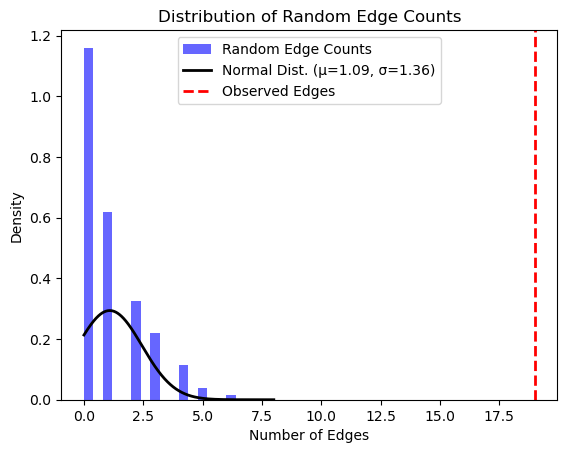

z score for a random nodes: 13.193343889756488

P-value: 1.55e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000708/associations?projection=associationByStudy
Genes: 199

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dRP11-576M8.2%0dRP11-410D17.2%0dLCORL%0dIPPK%0dESM1%0dDCLK1%0dCTD-2503O16.4%0dAL109618.1%0dDCUN1D4%0dTHRB%0dZSCAN9%0dFAM155A%0dAC007389.3%0dIL1RL2%0dNF1%0dBTBD9%0dPC%0dWWOX%0dRP11-369E15.1%0dNBAS%0dEZH2%0dTMEM221%0dSLC22A2%0dPLD5%0dDLG2%0dTMEFF1%0dKB-1980E6.3%0dGALNTL6%0dGPD2%0dLRP11%0dNPAS3%0dRP4-724E13.2%0dELOVL5%0dGABRB1%0dHS2ST1%0dSVOPL%0dSNTG2%0dSLC1A6%0dMETTL20%0dFAM124B%0dSPI1%0dGHR%0dRP11-526D8.7%0dDAB2IP%0dSH2B3%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dIntergenic%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dGBAP1%0dKCNH1%0dKCNN3%0dADAR%0dDCAF8%0dLOC101928565%0dXCL2%0dEDN2%0dHIVEP3%0dKDM4A%0dLINC01361%0dLOC101927587%

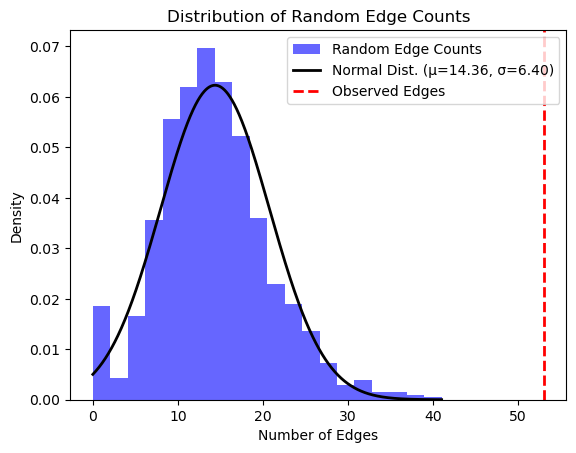

z score for a random nodes: 6.035585502878795

P-value: 1.9e-12
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000178/associations?projection=associationByStudy
Genes: 25

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PLCE1%0dNOC3L%0dNR%0dZBTB20%0dPRKAA1%0dPTGER4%0dLRFN2%0dSP4%0dDNAH11%0dPSCA%0dMTX1%0dHCN3%0dMUC1%0dintergenic%0dATM%0dTTC33%0dUNC5CL%0dTSPO2%0dOPCML%0dASH1L%0dlnc-POLR3G-4%0dGCLET%0dNSUN3%0dLOC285419%0dANKRD50&species=9606

Proteins: 22

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: htt

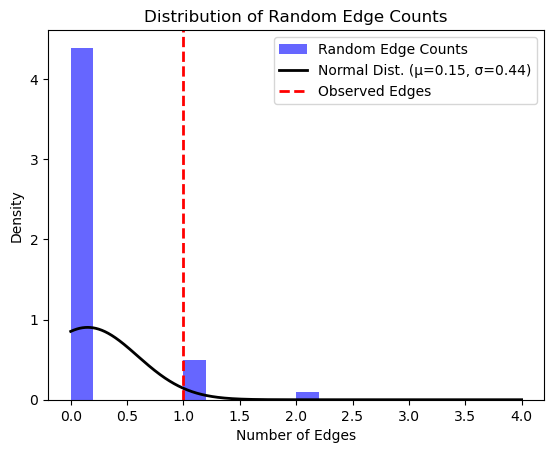

z score for a random nodes: 1.9224079103855778

P-value: 0.3798
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000503/associations?projection=associationByStudy
Genes: 7

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dMTX1%0dHCN3%0dMUC1%0dATM%0dCHD6%0dPSCA&species=9606

Proteins: 7

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests f

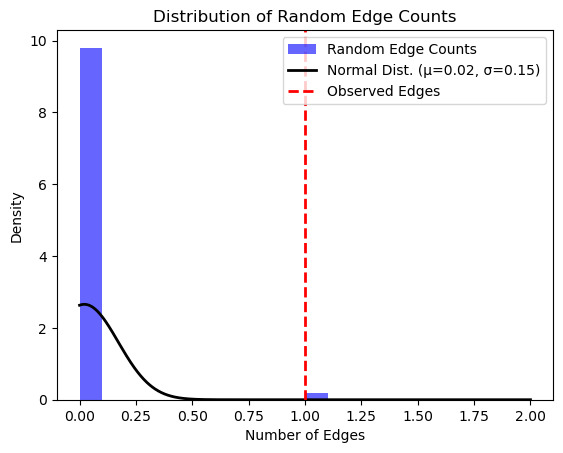

z score for a random nodes: 6.518126273921757

P-value: 0.0573
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000650/associations?projection=associationByStudy
Genes: 66

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HEPACAM%0dHEPN1%0dCCDC15%0dSLC37A2%0dTMEM218%0dFEZ1%0dMGC39545%0dSTT3A%0dCHEK1%0dACRV1%0dPATE1%0dPATE2%0dPATE3%0dPATE4%0dHYLS1%0dPKNOX2%0dROBO4%0dTERT%0dTNFSF10%0dNR%0dESR1%0dKLF5%0dLGR6%0dWDR43%0dMIR4757%0dFTO%0dMDM4%0dANKLE1%0dADCY9%0dL3MBTL3%0dKDELC2%0dCDH2%0dCCNE1%0dANXA13%0dRPL23AP53%0dPEX14%0dIntergenic%0dINHBB%0dZNF365%0dLSP1%0dPTHLH%0dTOX3%0dADHB8%0dMERIT40%0dPPIL3%0dCLK1%0dFAM126B%0dNDUFB3%0dKLF12%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dRALY%0dFRY%0dMTX1%0dNEK10%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dSH2B3%0dGBAP1%0dKCNH1&species=9606

Proteins: 60

Number of edges: 23

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://stri

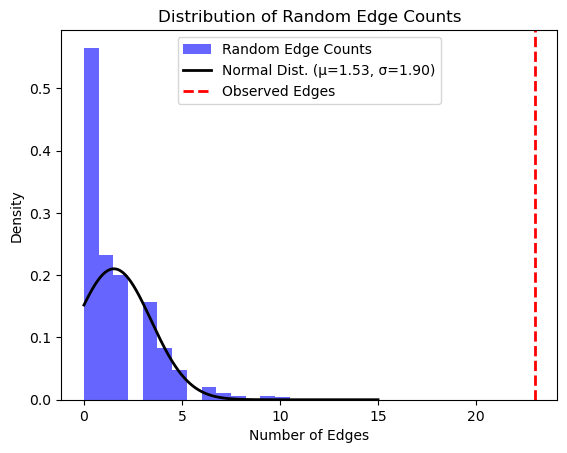

z score for a random nodes: 11.317970121484953

P-value: 1.59e-10
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006462/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HOXD3%0dPAX8%0dIFNL3%0dIFNL4%0dNR&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retr

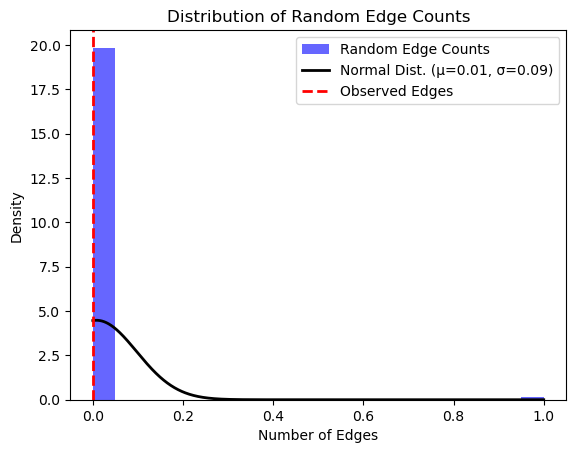

z score for a random nodes: -0.08980265101338746

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001061/associations?projection=associationByStudy
Genes: 40

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA%0dHLA-B%0dHLA-DPB2%0dHLA-DRB1%0dHLA-DQA1%0dMICA%0dintergenic%0dZNF804B%0dEXOC1%0dGSDMB%0dNR%0dADGRV1%0dHPVC1%0dLINC01445%0dVSTM2A-OT1%0dVSTM2A%0dTTC34%0dACACB%0dIntergenic%0dINS-IGF2%0dSOX9%0dPAX8%0dCLPTM1L%0dHLA-DQB1%0dMICB%0dMCCD1%0dGABRB1%0dTBXAS1%0dSGK223%0dCLDN23%0dSULF1%0dSLCO5A1%0dSUGT1P3%0dELF1%0dLRRC28%0dMEF2A%0dLOC100505817%0dFBXO15%0dTNF%0dHLA-C&species=9606

Proteins: 33

Number of edges: 19

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org

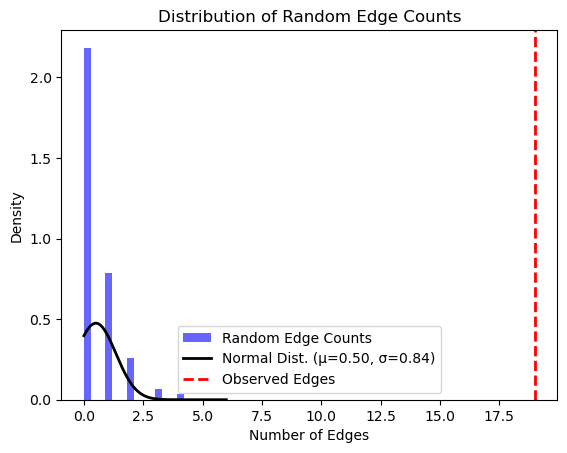

z score for a random nodes: 22.014139500825724

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002618/associations?projection=associationByStudy
Genes: 175

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=BACH1%0dDAB2%0dPRLHR%0dTFF1%0dFAM19A5%0dMIPEPP2%0dBAI3%0dSLC1A1%0dARID1B%0dTFRC%0dNR%0dARL4C%0dDPP6%0dFAM91A1%0dFOXQ1%0dLOC284998%0dLOC387933%0dLOC730242%0dLOC731559%0dMYO1D%0dNDFIP2%0dPARK2%0dPRPSAP2%0dRNF149%0dRNF43%0dRNF5P1%0dTHSD7B%0dBICD1%0dABO%0dKLF12%0dKLF5%0dNR5A2%0dCLPTM1L%0dSBF2%0dc18orf1%0dintergenic%0dGRID1%0dGTF2H1%0dZFP1%0dCTRB1%0dCFDP1%0dTMEM170A%0dCHST6%0dCHST5%0dTMEM231%0dGABARAPL2%0dADAT1%0dKARS%0dTERF21P%0dLDHD%0dBCAR1%0dCTRB2%0dFA2H%0dWDR59%0dZNFR1%0dLINC00977%0dMIR1208%0dPVT1%0dMYC%0dADAMTS13%0dURAD%0dFLT3%0dPAN3-AS1%0dPAN3%0dGSX1%0dPDX1-AS1%0dPDX1%0dATP5EP2%0dCDX2%0dSNORD125%0dRHBDD3%0dEWSR1%0dCHEK2%0dTTC28%0dHSCB%0dCCDC117%0dXBP1%0dZNRF3%0dKREM

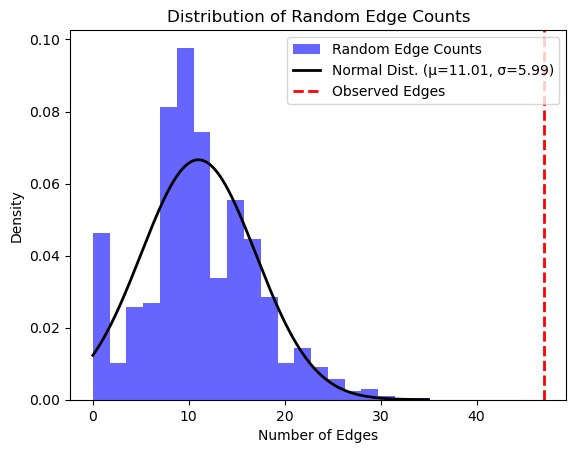

z score for a random nodes: 6.009946241045287

P-value: 1.08e-09
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001252/associations?projection=associationByStudy
Genes: 1

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PRKAA1&species=9606

Proteins: 1

Number of edges: 52

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-he

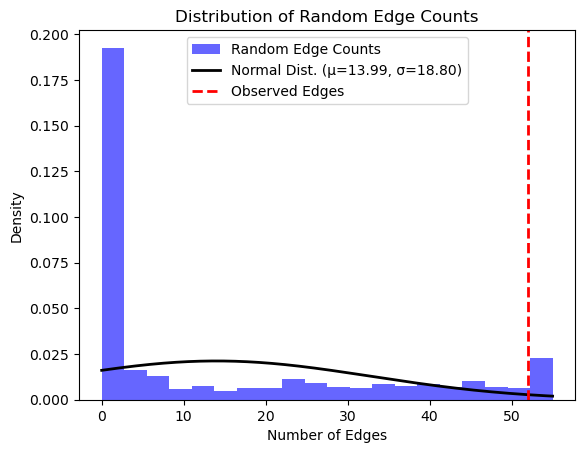

z score for a random nodes: 2.0222106560165223

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004992/associations?projection=associationByStudy
Genes: 16

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PPL%0dGLYR1%0dPHB%0dZNF652%0dKCNE2%0dRCAN1%0dNR%0dRP11-266A24.1%0dTMX1%0dCNIH3%0dPRSS1%0dEPHB6%0dTRPV6%0dTRPV5%0dPIP%0dTP53&species=9606

Proteins: 15

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for ran

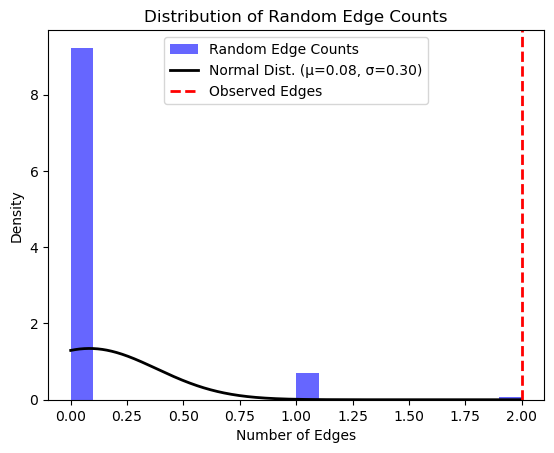

z score for a random nodes: 6.458133937639161

P-value: 0.1195
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004288/associations?projection=associationByStudy
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dISM1%0dHCN1%0dDSG3%0dPARVG%0dC20orf27%0dDPP10%0dSYMPK&species=9606

Proteins: 8

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too M

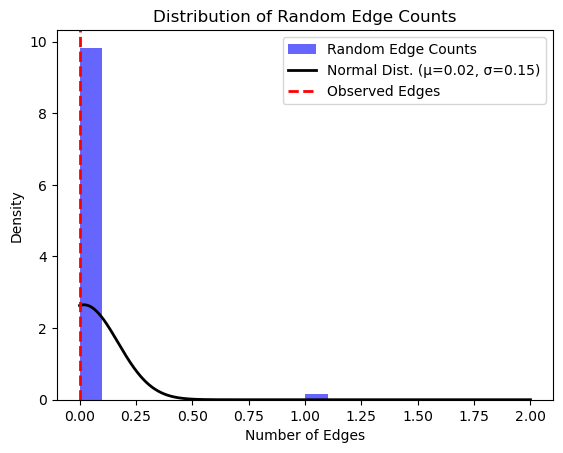

z score for a random nodes: -0.1262772109594041

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001075/associations?projection=associationByStudy
Genes: 110

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=C19orf62%0dMERIT40%0dANKLE1%0dBNC2%0dLOC648570%0dCNTLN%0dHOXD1%0dHOXD3%0dMYC%0dTHEM75%0dSKAP1%0dNR%0dTIPARP%0dintergenic%0dCHMP4C%0dFABP5%0dPMP2%0dFABP12%0dIMPA1%0dSLC10A5%0dZFAND1%0dSNX16%0dFABP4%0dNEBL%0dC10orf113%0dC10orf114%0dSKIDA1%0dDNAJC1%0dMLLT10%0dHNF1B%0dACACA%0dC17orf78%0dTADA2A%0dDUSP14%0dSYNRG%0dDDX52%0dTBC1D3F%0dTBC1D3%0dMRPL45%0dGPR179%0dSOCS7%0dARHGAP23%0dBRIP1%0dLINC02183%0dBRCA1%0dIntergenic%0dPDSS1%0dSH2D4B%0dLOC646730%0dBTBD10%0dPTH%0dHSPB7%0dZBTB7B%0dTET2%0dJAZF1%0dARHGEF5%0dPCAT1/PCAT2%0dMIR1208/PVT1%0dCDKN2A/CDKN2B%0dHABP2%0dINCENP%0dTPCN2%0dCCDC88C%0dSTXBP4%0dGATAD2A%0dBCL2L11%0dBRCA2%0dRAD51B%0dBABAM1%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHLA

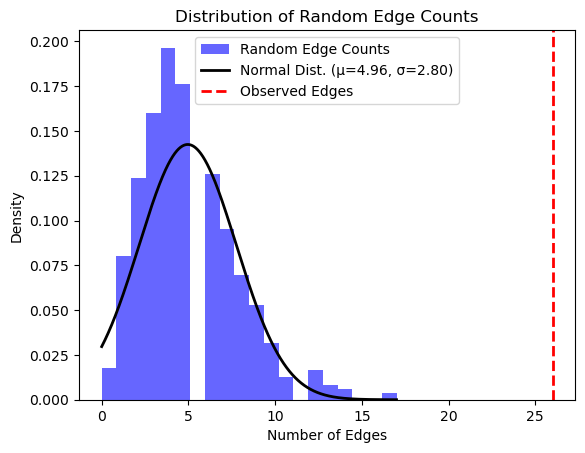

z score for a random nodes: 7.513219928044866

P-value: 1.89e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000042/associations?projection=associationByStudy
Genes: 1

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR&species=9606

Proteins: 1

Number of edges: 55

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header

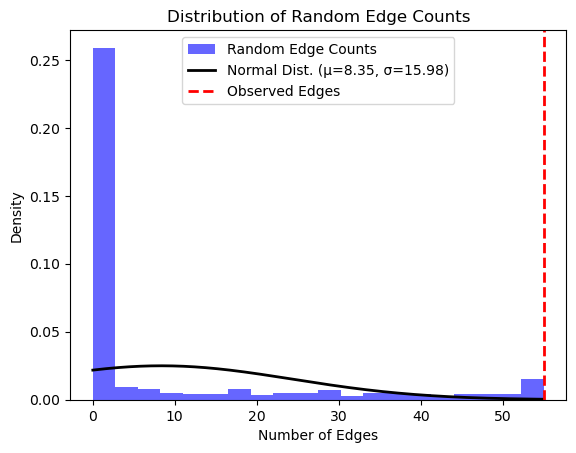

z score for a random nodes: 2.9190935179023754

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001515/associations?projection=associationByStudy
Genes: 20

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dIntergenic%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dSH2B3%0dGBAP1%0dKCNH1&species=9606

Proteins: 19

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to re

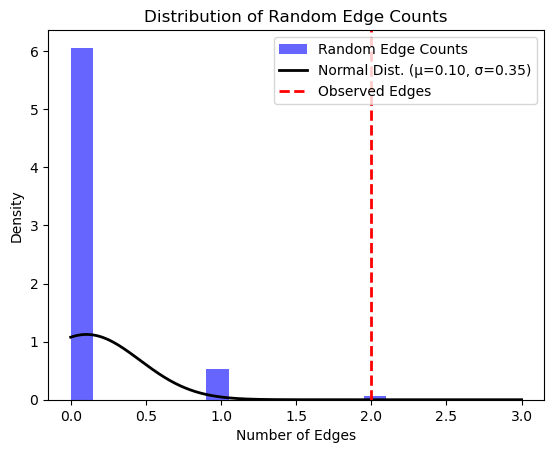

z score for a random nodes: 5.339087406680829

P-value: 0.09
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001516/associations?projection=associationByStudy
Genes: 27

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dFST%0dMAGEC1%0dLOC105376360%0dPRPSAP1%0dGABRG3%0dLOC105377300%0dGK2%0dBRCA2%0dRAD51B%0dHNF1B%0dBABAM1%0dIntergenic%0dRALY%0dFRY%0dMTX1%0dNEK10%0dTERT%0dHLA-C%0dCDKN2B%0dAS1%0dFGFR2%0dTUBA1C%0dKRT8%0dSH2B3%0dGBAP1%0dKCNH1&species=9606

Proteins: 24

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests

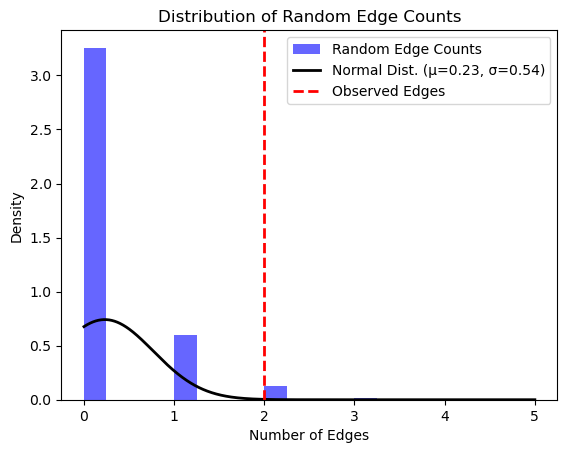

z score for a random nodes: 3.2869970417348746

P-value: 0.1324
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000182/associations?projection=associationByStudy
Genes: 31

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DRB1%0dHLA-DQA1%0dGRIK1%0dHLA_DRB1%0dHLA_DQA1%0dHLA-DQ%0dHLA-DR%0dMICA%0dSTAT4%0dGLB1%0dC2%0dC14orf143%0dUBE4B%0dKIF1B%0dPGD%0dCDK14%0dTM6SF2%0dWNT3A%0dWNT9A%0dPNPLA3%0dVEPH1%0dFZD4%0dHLA%0dDYSF%0dSAMM50%0dTLL1%0dDLC1%0dAGA%0dMIR572%0dMRPS11%0dHLA-DQB1&species=9606

Proteins: 27

Number of edges: 8

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 4

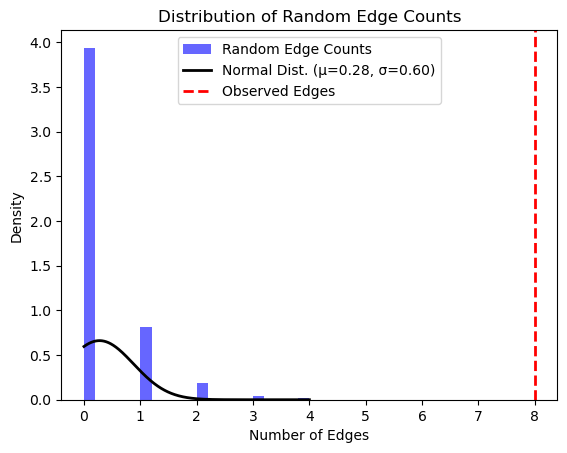

z score for a random nodes: 12.805501547036199

P-value: 4.58e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004606/associations?projection=associationByStudy
Genes: 4

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DCC%0dNR%0dABCB4%0dABCB1&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db

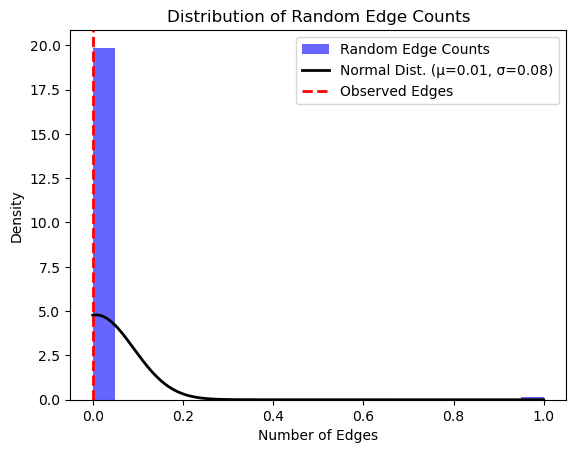

z score for a random nodes: -0.08396038004871989

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005406/associations?projection=associationByStudy
Genes: 97

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=Intergenic%0dintergenic%0dFAT3%0dRNF4%0dSnoU13%0dCOX15%0dCNNM1%0dWNT8B%0dNKX2-3%0dPLEKHG6%0dCD9%0dMHC%0dEIF3H%0dSATB2%0dGATA3%0dLINC00917%0dZMIZ1-AS1%0dZMIZ1%0dPOLR3A%0dSMAD3%0dGREM1%0dBOC%0dBMP5%0dTBX3%0dMED13L%0dKLF5%0dBMP2%0dCCND2%0dRAB40B%0dMETRLN%0dHEXDC%0dMYC%0dBMP4%0dHAO1%0dYAP1%0dPTPN1%0dPOLD3%0dNXN%0dLINC00603%0dPTGER4%0dTERT%0dCLPTM1L%0dMYO1G%0dSNHG15%0dCCM2%0dTBRG4%0dDACT1%0dTCF7L2%0dLOC146513%0dFOXL1%0dVTI1A%0dA1CF%0dPRKG1%0dSMAD7%0dDIP2B%0dATF1%0dATOH1%0dSMARCAD1%0dBMPR1B%0dFKBP5%0dTEAD3%0dDUSP10%0dLAMA5%0dRPS21%0dMYRF%0dFEN1%0dFADS1%0dTGFB1%0dB9D2%0dRHPN2%0dGPATCH1%0dc11orf53%0dCOLCA1%0dCOLCA2%0dCTNNB1%0dPNKD%0dTMBIM1%0dSTARD13%0dRFC3%0dPITX1%0dH2AFY%0

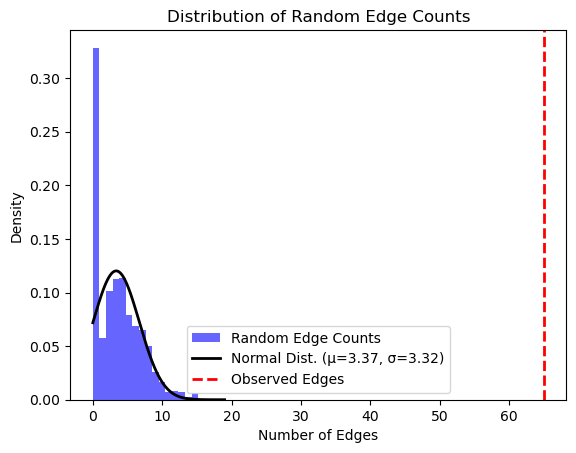

z score for a random nodes: 18.56992448495612

P-value: 3.11e-15
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002892/associations?projection=associationByStudy
Genes: 22

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FOXE1%0dNKX2-1%0dTMOD1%0dC9orf97%0dNCBP1%0dXPA%0dHEMGN%0dKRT18P13%0dC9orf156%0dDIRC3%0dNRG1%0dMBIP%0dFOXE-1%0dNR%0dPCNXL2%0dLRRC34%0dTERC%0dNREP%0dEPB41L4A%0dOBFC1%0dSMAD3%0dTERT&species=9606

Proteins: 20

Number of edges: 8

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-

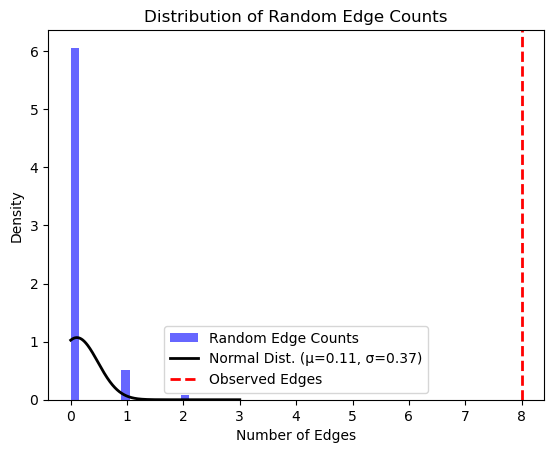

z score for a random nodes: 21.156256303016338

P-value: 6.37e-07
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004193/associations?projection=associationByStudy
Genes: 144

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RCC2%0dARHGEF10L%0dPADI4%0dPADI6%0dRHOU%0dUBAC2%0dMC1R%0dEXOC2%0dTP53%0dTGM3%0dRGS22%0dTERT%0dKRT5%0dCDKN2A%0dCDKN2B%0dKLF14%0dCLPTM1L%0dMYCN%0dFAM49A%0dALS2CR12%0dCASP8%0dCASP10%0dZFHX4%0dZFHX4-AS1%0dGATA3%0dRP11-428L9.1%0dRP11-428L9.2%0dIRF4%0dSLC45A2%0dRALY%0dTYR%0dOCA2%0dFOXP1%0dBNC2%0dLPP%0dHLA-DQA2%0dCUX1%0dZBTB10%0dLINC00111%0dPLIN3%0dHLA-B%0dTNS3%0dNEU1%0dOBFC1%0dMIR3939%0dCASC15%0dJDP2%0dCPVL%0dRAC1%0dPHTF1%0dST3GAL6%0dCTLA4%0dAC099344.3%0dSEC16A%0dATP11A%0dHAL%0dTRPS1%0dRAET1M%0dCTC-537E7.3%0dRP11-130C19.3%0dAC107057.1%0dCCR12P%0dGPX4%0dZBTB7B%0dCCDC88B%0dZNF365%0dAC020743.2%0dSMC2%0dPPARGC1B%0dCTC-518P12.6%0dAC017060.1%0dSCARNA8%0dFGF10%0dCYP1B1%0dRN7

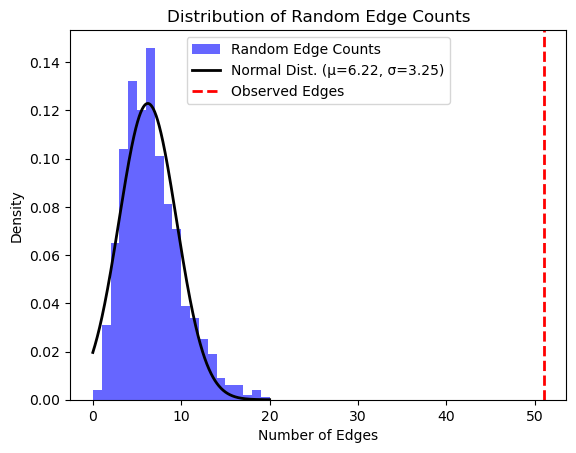

z score for a random nodes: 13.793422047605496

P-value: 7.5e-13
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006953/associations?projection=associationByStudy
Genes: 70

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CHRNA3%0dNR%0dSDR9C7%0dLMCD1-AS1%0dSTAT6%0dPCSK2%0dADARB2%0dGPATCH2%0dKIAA0753%0dTUB%0dSYT9%0dRNLS%0dFAM194B%0dEPHB1%0dRP11-753N8.1%0dAC097713.3%0dC1D%0dFOXP1%0dAC020626.1%0dNTM%0dAKR1B10%0dROBO2%0dNAALADL2%0dTLDC2%0dSATB1%0dTMEM218%0dRP11-269F21.3%0dRP11-576M8.2%0dRP11-410D17.2%0dLCORL%0dIPPK%0dESM1%0dDCLK1%0dCTD-2503O16.4%0dAL109618.1%0dDCUN1D4%0dTHRB%0dZSCAN9%0dFAM155A%0dAC007389.3%0dIL1RL2%0dNF1%0dBTBD9%0dPC%0dWWOX%0dRP11-369E15.1%0dNBAS%0dEZH2%0dTMEM221%0dSLC22A2%0dPLD5%0dDLG2%0dTMEFF1%0dKB-1980E6.3%0dGALNTL6%0dGPD2%0dLRP11%0dNPAS3%0dRP4-724E13.2%0dELOVL5%0dGABRB1%0dHS2ST1%0dSVOPL%0dSNTG2%0dSLC1A6%0dMETTL20%0dFAM124B%0dSPI1%0dGHR%0dRP11-526D8.7&species=9606



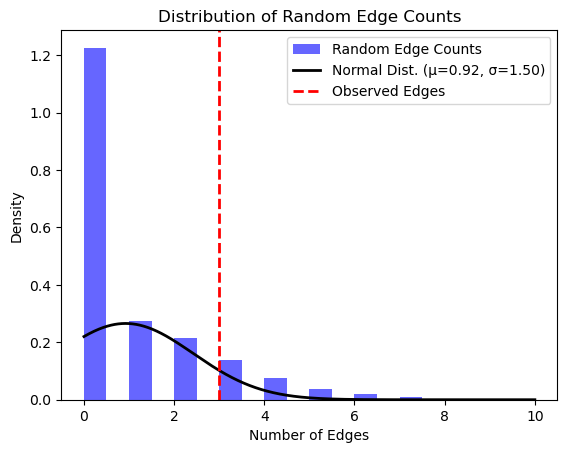

z score for a random nodes: 1.3835156654345142

P-value: 0.1377
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0010176/associations?projection=associationByStudy
Genes: 85

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SCARNA8%0dEPB41L1%0dTYR%0dAC004824.1%0dALS2CR12%0dSNORD77%0dAC010745.4%0dRP1-168P16.2%0dGOLPH3L%0dFOXP1%0dY_RNA%0dLINC01149%0dJDP2%0dLPP%0dRP11-335H2.2%0dLINC00111%0dZNF276%0dBCAS4%0dZBTB7B%0dCTLA4%0dPPARGC1B%0dRP11-428J1.2%0dHLA-B%0dZNF365%0dCTC-518P12.6%0dRP5-1028L10.2%0dAC107057.1%0dRNU6-846P%0dRAC1%0dTNS3%0dAC020743.2%0dRP11-278I4.2%0dCCDC88B%0dATP11A%0dSMC2%0dRP1-186E20.1%0dHAL%0dBRCA2%0dST3GAL6%0dHLA-DPA1%0dU3%0dGPX4%0dTGM3%0dCCR6%0dAC017060.1%0dCFL1%0dCCR12P%0dCYP1B1%0dTERT%0dRN7SKP240%0dRP11-128M1.1%0dHLA-DQA1%0dCUX1%0dMIR29A%0dHERC2%0dPHTF1%0dCDKN2B-AS1%0dBACH2%0dBNC2%0dKRT5%0dCLPTM1%0dERG%0dEXO1%0dRP4-799G3.2%0dRNYes4P15%0dMC1R%0dDEF8%0dRP11-115I9.1%0dIRF

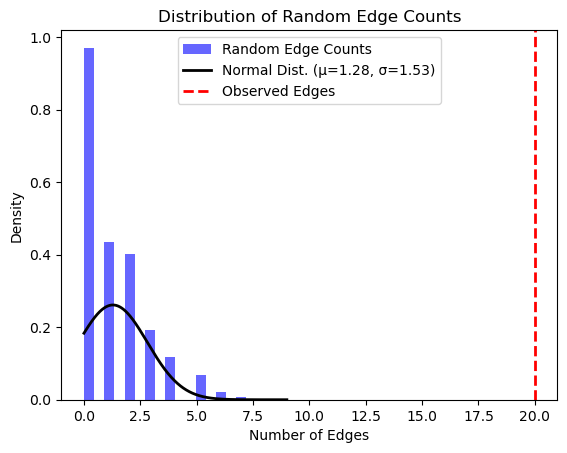

z score for a random nodes: 12.262985686488715

P-value: 3.22e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000181/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DQB1%0dCCHCR1%0dZNRD1-AS1%0dintergenic%0dNR&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for

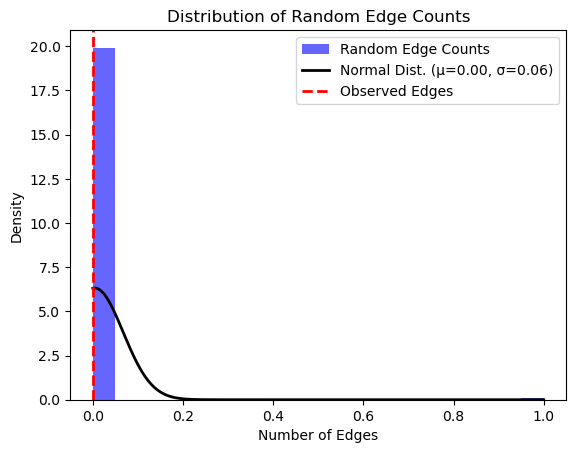

z score for a random nodes: -0.06337242505244779

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009260/associations?projection=associationByStudy
Genes: 23

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RGS22%0dNR%0dCDKN2B%0dKRT5%0dFOXP1%0dCPVL%0dDEFB135%0dRHOU%0dMC1R%0dIRF4%0dLINC-PINT%0dFAM49A%0dZFHX4%0dCLPTM1L%0dALS2CR12%0dTYR%0dRALY%0dASIP%0dTGM3%0dTHNSL2%0dRCC2%0dLOC105755953%0dIntergenic&species=9606

Proteins: 21

Number of edges: 5

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.or

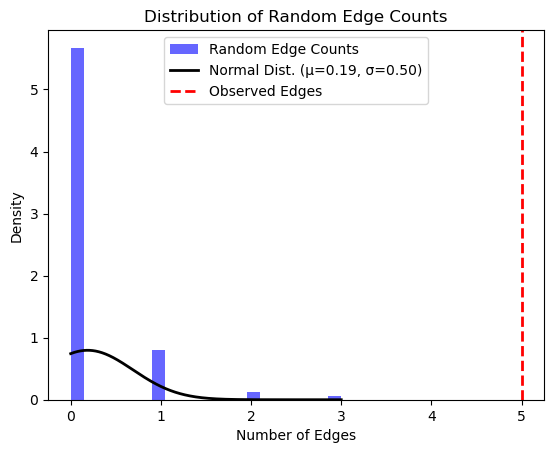

z score for a random nodes: 9.611398107109265

P-value: 9.62e-08
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001927/associations?projection=associationByStudy
Genes: 36

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ARNT%0dSETDB1%0dIntergenic%0dALS2CR12%0dFOXP1%0dEIF4E3%0dTPRG1%0dTP63%0dSLC45A2%0dIRF4%0dHLA-DQA1%0dBACH2%0dAGR3%0dAHR%0dTRPS1%0dTYRP1%0dBNC2%0dCNTLN%0dSEC16A%0dZNF143%0dWEE1%0dTYR%0dCADM1%0dBUD13%0dKRT6A%0dKRT5%0dHAL%0dOCA2%0dTCF25%0dTUBB3%0dRALY%0dNR%0dBRCA2%0dRALY-ASIP%0dMC1R%0dLPP&species=9606

Proteins: 35

Number of edges: 16

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random no

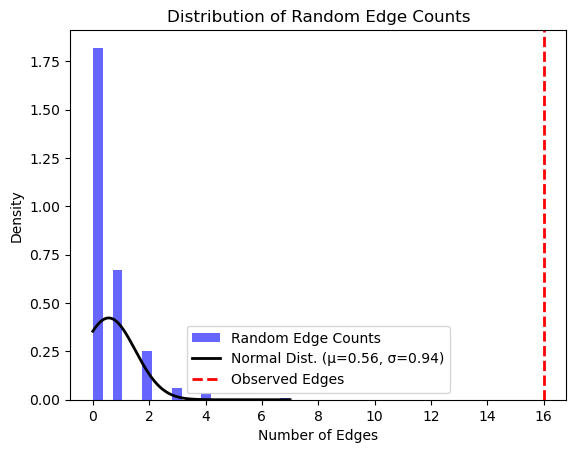

z score for a random nodes: 16.362742748348452

P-value: 1.31e-14
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000649/associations?projection=associationByStudy
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dFGFR2%0dCASC16%0dintergenic%0dRAB9P1%0dZNF613%0dRHOBTB2%0dPDLIM2&species=9606

Proteins: 6

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error:

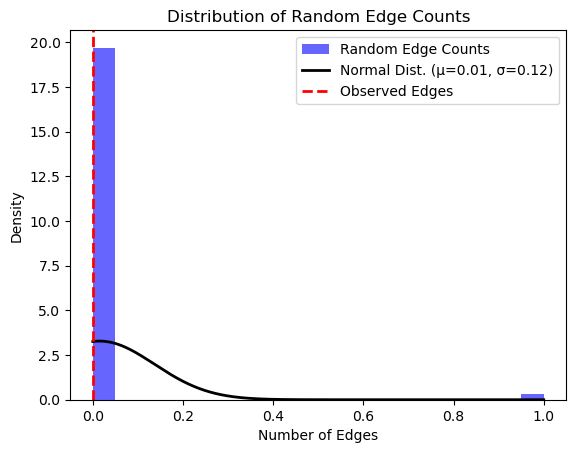

z score for a random nodes: -0.12340351046845906

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009781/associations?projection=associationByStudy
Genes: 1

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FGFR2&species=9606

Proteins: 1

Number of edges: 16

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-heade

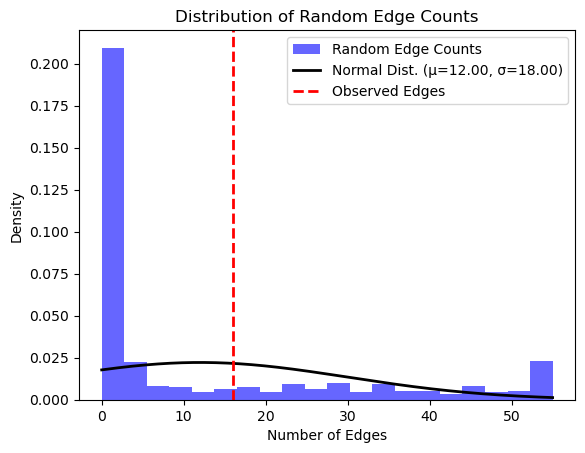

z score for a random nodes: 0.22225995473840401

P-value: 0.0762
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009361/associations?projection=associationByStudy
Genes: 6

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SLC22A16%0dZBTB20%0dCCDC141%0dRASGRF2%0dIntergenic%0dNR&species=9606

Proteins: 6

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Reque

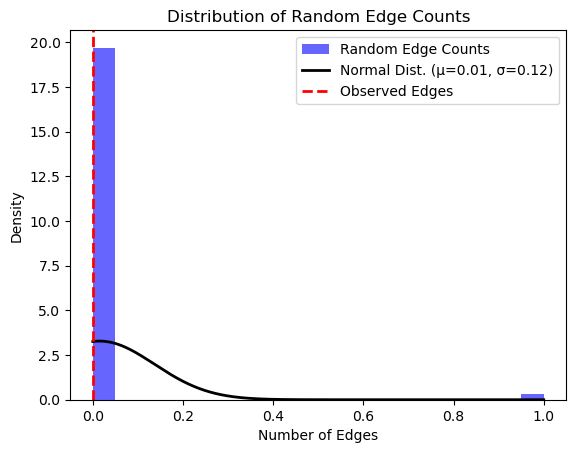

z score for a random nodes: -0.12340351046845904

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000702/associations?projection=associationByStudy
Genes: 75

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DYNC2H1%0dEPHB1%0dPPP2R3A%0dBBX%0dMARCH1%0dMIR5684%0dNONE%0dLINC00290%0dFCHO2%0dADGRV1%0dNEDD9%0dHMGN4%0dABT1%0dZNF322%0dGUSBP2%0dIFITM4P%0dHCG4%0dTRIM39-RPP21%0dHLA-E%0dSFTA2%0dHCG22%0dC6orf15%0dBAG6%0dNEU1%0dHLA-DRB1%0dHLA-DQA1%0dBMP6%0dSCIN%0dSKAP2%0dHOXA1%0dFAM167A-AS1%0dC8orf48%0dSGCZ%0dSH3GL2%0dADAMTSL1%0dNRP1%0dLINC00838%0dCRTAM%0dSTK33%0dFUT4%0dPIWIL4%0dRAD52%0dA2ML1%0dPHC1%0dBRCA2%0dLINC00383%0dRGS6%0dFOXN3%0dALDH1A2%0dAQP9%0dCHRNB4%0dLOC646938%0dLOC101927286%0dADAD2%0dVSTM1%0dTMA16%0dFSTL4%0dWSPAR%0dBTN3A1%0dIER3%0dLINC00243%0dHLA-C%0dHLA-B%0dCOL21A1%0dDST%0dUMAD1%0dIL33%0dDISC1FP1%0dLINC00936%0dLINC00615%0dTMEM179%0dMIR4710%0dCHRNA5%0dUBE2G1%0dSPNS3&speci

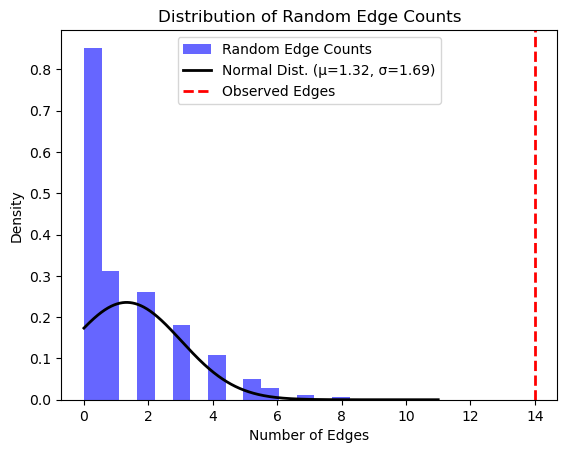

z score for a random nodes: 7.490466285250332

P-value: 1.33e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000681/associations?projection=associationByStudy
Genes: 25

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ITPR2%0dNR%0dSCARB1%0dEPAS1%0dPP13439%0dintergenic%0dMYC%0dPVT1%0dZEB2%0dPDZD2%0dAX746803%0dAK094674%0dBTBD11%0dSAMD5%0dDPF3%0dKDELC2%0dTNFRSF10B%0dRHOBTB2%0dOBFC1%0dATM%0dFAF1%0dLRRIQ4%0dRBFOX1%0dSLC6A18%0dSTEAP3&species=9606

Proteins: 21

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url

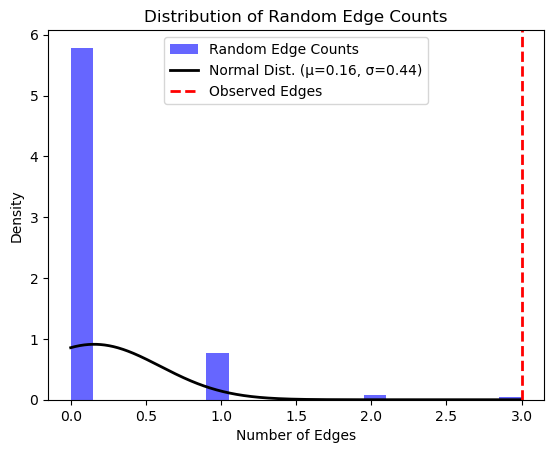

z score for a random nodes: 6.496198969539089

P-value: 0.0631
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000478/associations?projection=associationByStudy
Genes: 45

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FOXP1%0dNR%0dBARX1%0dPTPDC1%0dFOXF1%0dCRTC1%0dMTRNR2L9%0dMGST1%0dLMO3%0dPRSS55%0dRP1L1%0dDPYSL2%0dCEP72%0dASZ1%0dRNF144A%0dLOC339788%0dACTBL2%0dPLK2%0dAPOB%0dAK098570%0dLSP1P3%0dLDAH%0dGDF7%0dALDH1A2%0dCFTR%0dMSRA%0dBLK%0dLINC00208%0dLOC105369996%0dTBX5%0dKHDRBS2%0dTPPP%0dMHC%0dTMOD1%0dSATB2%0dLOC732275%0dCDR1%0dSPANXB2%0dRND3%0dRBM43%0dLOC340268%0dSNORD114-31%0dLOC100130814%0dHTR3C%0dC2orf43&species=9606

Proteins: 34

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Request

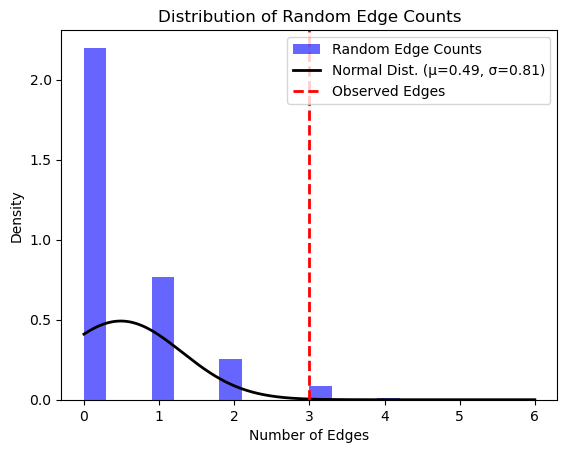

z score for a random nodes: 3.094523451421377

P-value: 0.0104
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005221/associations?projection=associationByStudy
Genes: 26

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FBXO36%0dSLC16A14%0dSP110%0dSP140%0dSP140L%0dSP100%0dC10orf107%0dARID5B%0dMIR548AV%0dCACNA2D2%0dC3orf18%0dHEMK1%0dCISH%0dMAPKAPK3%0dMIR4787%0dDOCK3%0dLOC102546298%0dNDST1%0dSYNPO%0dMYOZ3%0dRBM22%0dDCTN4%0dSMIM3%0dIRGM%0dZNF300%0dZNF300P1&species=9606

Proteins: 22

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too

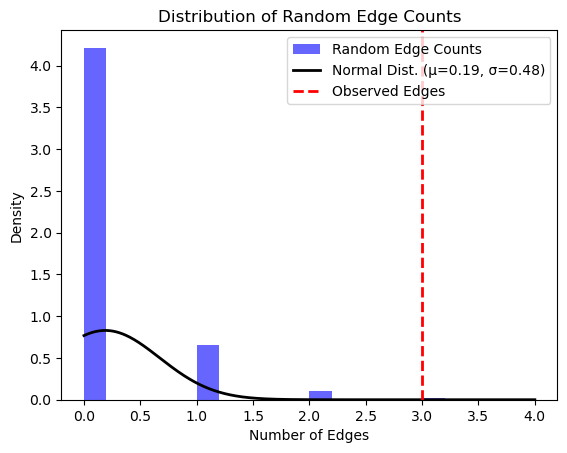

z score for a random nodes: 5.845110761015819

P-value: 0.00019
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1002017/associations?projection=associationByStudy
Genes: 11

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dOBFC1%0dNRG1%0dDIRC3%0dMSRB3%0dVAV3%0dPCNXL2%0dNKX2-1%0dSEPT11%0dFHIT%0dFOXE1&species=9606

Proteins: 10

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://strin

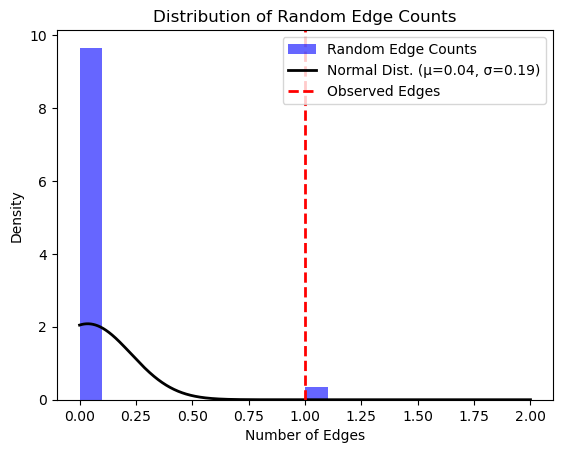

z score for a random nodes: 5.031764836222423

P-value: 0.0503
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000641/associations?projection=associationByStudy
Genes: 9

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NRG1%0dDIRC3%0dMSRB3%0dVAV3%0dPCNXL2%0dNKX2-1%0dSEPT11%0dFHIT%0dFOXE1&species=9606

Proteins: 8

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: To

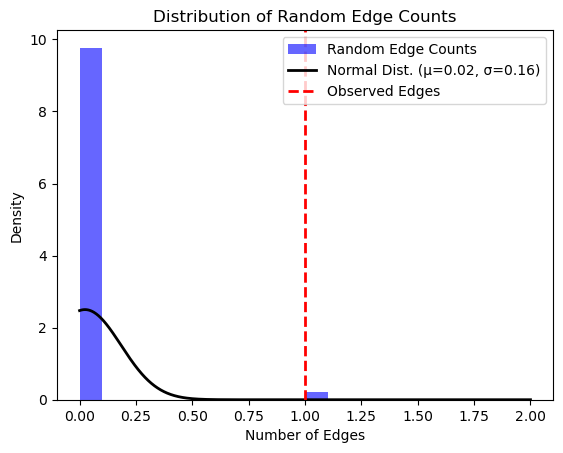

z score for a random nodes: 6.1210774933048695

P-value: 0.0153
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001931/associations?projection=associationByStudy
Genes: 15

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GALNT14%0dMUC21%0dHLA-DQA1%0dBTBD11%0dADH1B%0dLINC01229%0dintergenic%0dKCNC4%0dLOC105369574%0dTENM3%0dADCY2%0dCSGALNACT1%0dWDFY3%0dLOC105374446%0dHLA-DQB1&species=9606

Proteins: 12

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to r

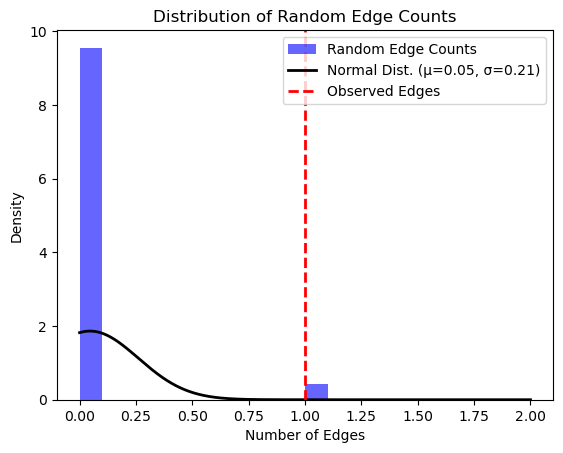

z score for a random nodes: 4.453666973119295

P-value: 0.0492
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005570/associations?projection=associationByStudy
Genes: 15

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GPN1%0dC2orf16%0dZNF512%0dCCDC121%0dADH1B%0dCLPTM1L%0dCDKN2B-AS1%0dLAMC3%0dLOC105376298%0dLOC105370811%0dNR2F2-AS1%0dintergenic%0dMICB%0dAIF1%0dHLA-DQB1&species=9606

Proteins: 11

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to ret

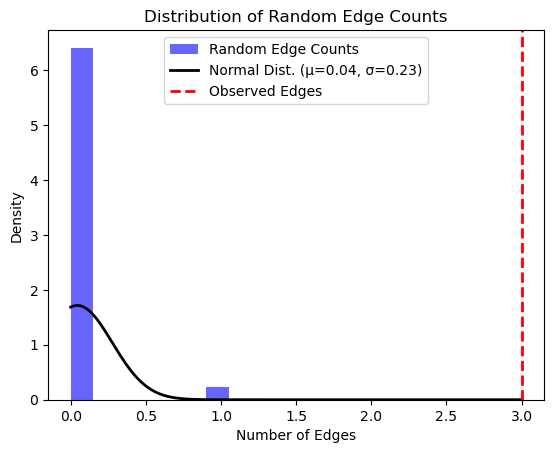

z score for a random nodes: 12.71306719630369

P-value: 1.68e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000657/associations?projection=associationByStudy
Genes: 11

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dEFR3A%0dAC011343.1%0dSLC22A23%0dANO1%0dPYGL%0dNIN%0dABHD12B%0dCDX1%0dKLF14%0dLINC00513&species=9606

Proteins: 9

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to re

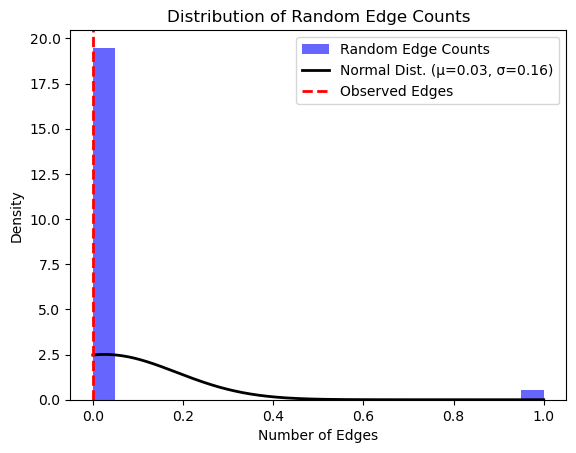

z score for a random nodes: -0.1633831238975984

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1001950/associations?projection=associationByStudy
Genes: 7

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PTGER3%0dSTAB1%0dTLR9%0dNISCH%0dFAM118A%0dFBLN1%0dNR&species=9606

Proteins: 7

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests fo

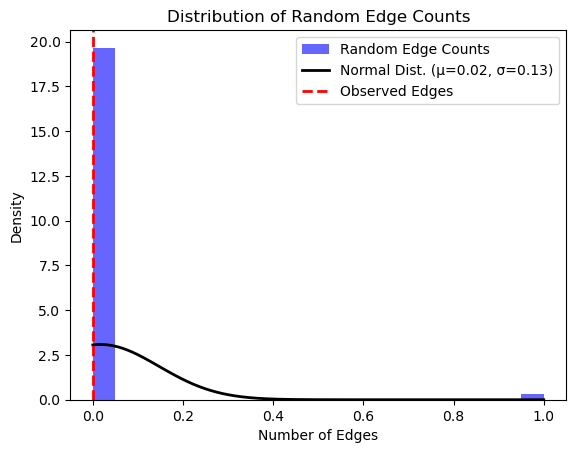

z score for a random nodes: -0.13150664608837076

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005088/associations?projection=associationByStudy
Genes: 31

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TERT%0dCLPTM1L%0dDMRT1%0dATF7IP%0dSPRY4%0dKITLG%0dintergenic%0dBAK1%0dSLC25A44%0dUCK2%0dDAZL%0dCENPE%0dCATSPER3%0dPITX1%0dPRDM14%0dHEATR3%0dRAD51C%0dTEX14%0dMCM3AP%0dC17orf47%0dPPM1E%0dSEPT4%0dTRIM37%0dSKA2%0dRFWD3%0dGLG1%0dMLKL%0dLIPG%0dMAD1L1%0dSMARCAD1%0dHPGDS&species=9606

Proteins: 30

Number of edges: 7

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve d

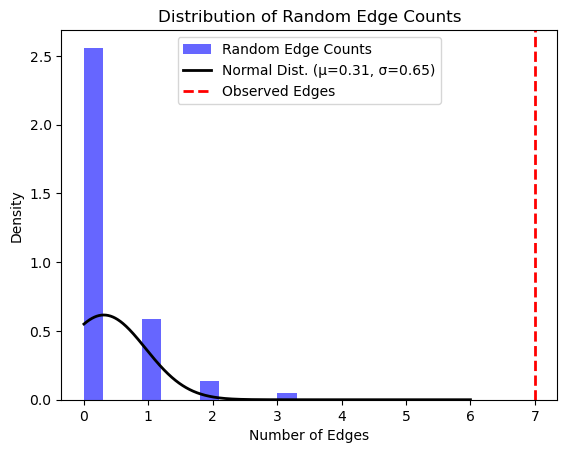

z score for a random nodes: 10.336617602488264

P-value: 3.98e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006861/associations?projection=associationByStudy
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PRKACB%0dLOC643174%0dTOX3%0dRAD51B%0dNR&species=9606

Proteins: 4

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed t

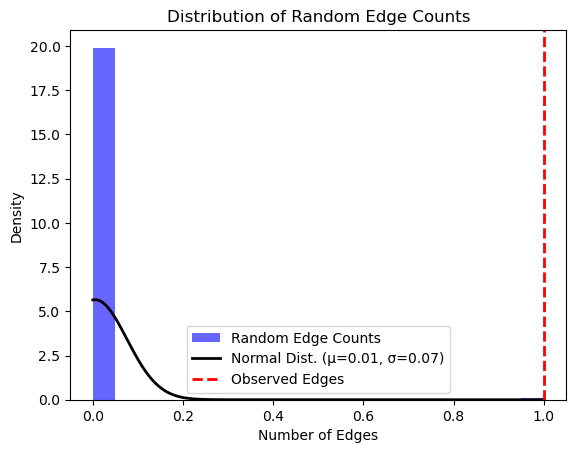

z score for a random nodes: 14.106735979665881

P-value: 0.0654
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004806/associations?projection=associationByStudy
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PTHR2%0dPPL&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no

/Users/aliaarman/Desktop/thesis/code/disease.py:15: RuntimeWarning: invalid value encountered in scalar divide
  z_score = (observed_edges - mean) / std
/Users/aliaarman/anaconda3/lib/python3.11/site-packages/scipy/stats/_distn_infrastructure.py:1988: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


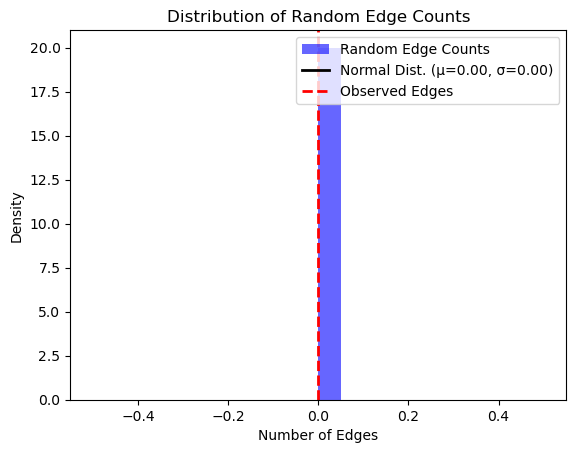

z score for a random nodes: nan

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004284/associations?projection=associationByStudy
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ADH1B%0dADH7%0dADH1C%0dHEL308%0dADH%0dFAM175A%0dALDH2%0dNR&species=9606

Proteins: 8

Number of edges: 9

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: htt

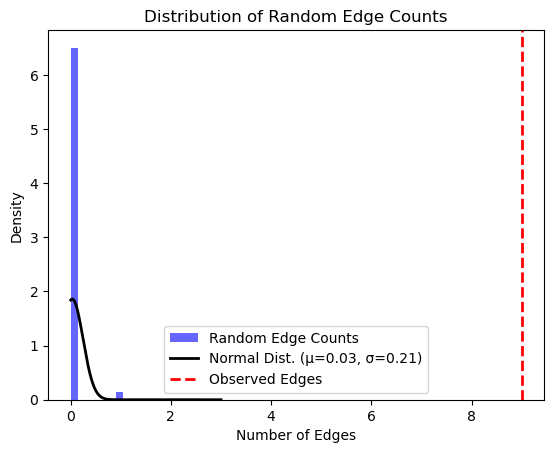

z score for a random nodes: 41.800462118648994

P-value: 4.44e-15
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000326/associations?projection=associationByStudy
Genes: 32

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dRTEL1%0dTERT%0dCCDC26%0dCDKN2A%0dCDKN2B%0dPHLDB1%0dEGFR%0dTERC%0dNR%0dC12orf41%0dPAPPA2%0dKLF7%0dLMF1%0dSLC16A8%0dMPG%0dRAVER2%0dHEATR3%0dTP53%0dLRRC4C%0dMDM4%0dIDH1%0dOBFC1%0dAKAP6%0dETFA%0dZBTB16%0dVTI1A%0dAKT3%0dLRIG1%0dMAML2%0dVTl1A%0dPOLR3B&species=9606

Proteins: 30

Number of edges: 21

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve da

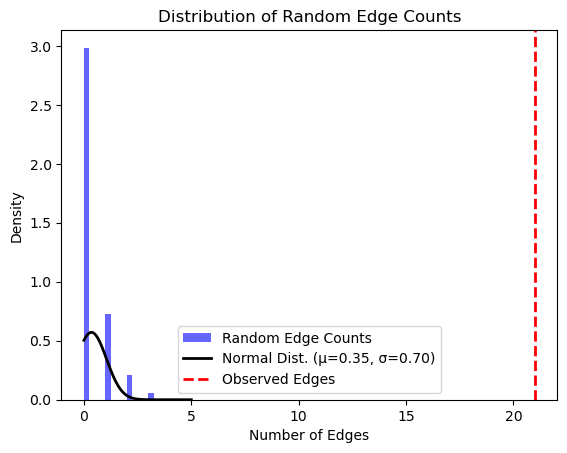

z score for a random nodes: 29.56504684350319

P-value: 8.13e-08
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000096/associations?projection=associationByStudy
Genes: 14

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DQB1%0dintergenic%0dC6orf15%0dSTG%0dPSORS1%0dCXCR5%0dHLA%0dETS1%0dLPP%0dBCL2%0dPVT1%0dC17orf62%0dCD86%0dSLC14A2&species=9606

Proteins: 12

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random no

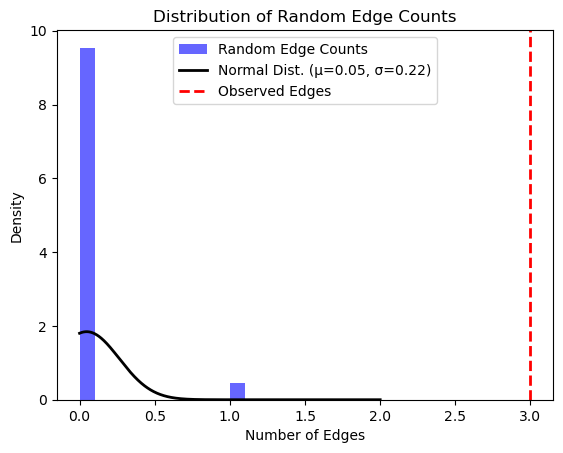

z score for a random nodes: 13.651560041894117

P-value: 0.0068
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004230/associations?projection=associationByStudy
Genes: 38

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HNF1B%0dSFPQ%0dintergenic%0dADAM12%0dLINGO2%0dLOC643623%0dLOC100131869%0dRNASET2%0dCACNA2D3%0dECT2L%0dTET2%0dSH2B3%0dGUCY1A2%0dCDKN2B-AS1%0dGMCL1%0dMGAT5B%0dLITAF%0dLSAMP%0dKLF4%0dNPAS3%0dHOXB1%0dTSHZ1%0dNANP%0dZNF429%0dRNGTT%0dARL5B%0dSCAF8%0dTDP2%0dPSMC3IP%0dTMTC1%0dCSRNP3%0dEZH2%0dFBP1%0dGDPD5%0dPRCP%0dLIMA1%0dCLEC3A%0dNCAM2&species=9606

Proteins: 35

Number of edges: 5

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed

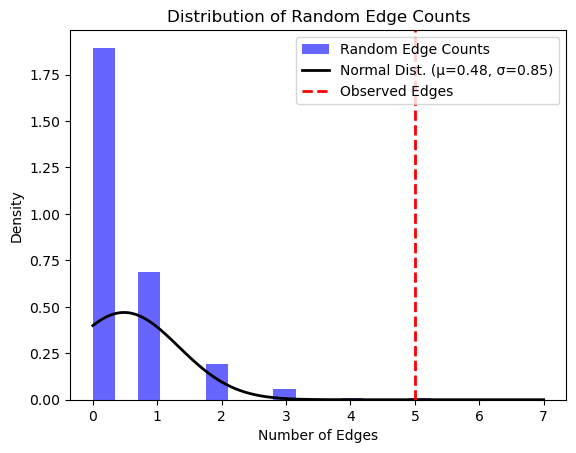

z score for a random nodes: 5.314431785538791

P-value: 4.96e-05
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005922/associations?projection=associationByStudy
Genes: 17

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TMEM173%0dTP53%0dATP1B2%0dHLA%0dCDKN2B%0dCDKN2A%0dNR%0dPLCE1%0dKIAA1516%0dCASP8%0dALS2CR12%0dRUNX1%0dCHEK2%0dCCDC117%0dXBP1%0dPDE4D%0dPDE4DN2&species=9606

Proteins: 15

Number of edges: 7

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clu

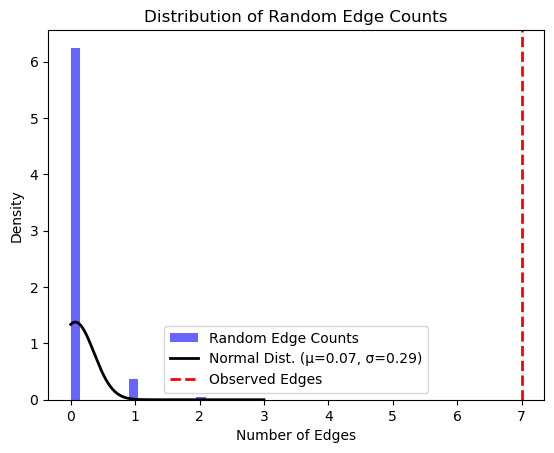

z score for a random nodes: 23.91315796497973

P-value: 0.0106
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0009443/associations?projection=associationByStudy
Genes: 17

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SIAH2%0dPDE7B%0dCCDC170%0dESR1%0dBET1%0dASPH%0dCDKN2B-AS1%0dDCAF12%0dFGFR2%0dDOCK1%0dITPR2%0dPGAM1P5%0dNTN4%0dIntergenic%0dTOX3%0dSLC39A11%0dCASC16&species=9606

Proteins: 14

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve

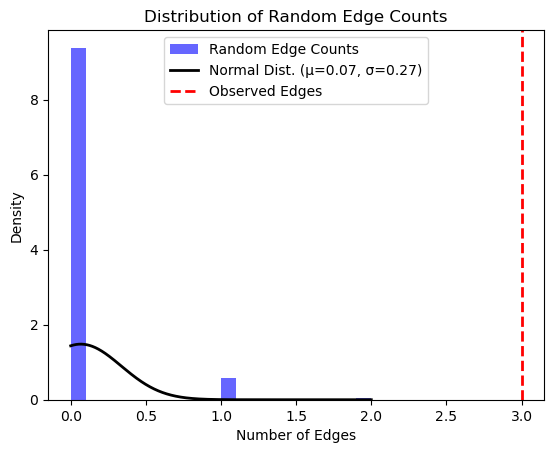

z score for a random nodes: 10.892062274426246

P-value: 0.0062
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0007321/associations?projection=associationByStudy
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RTTN%0dAKR1C1&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-

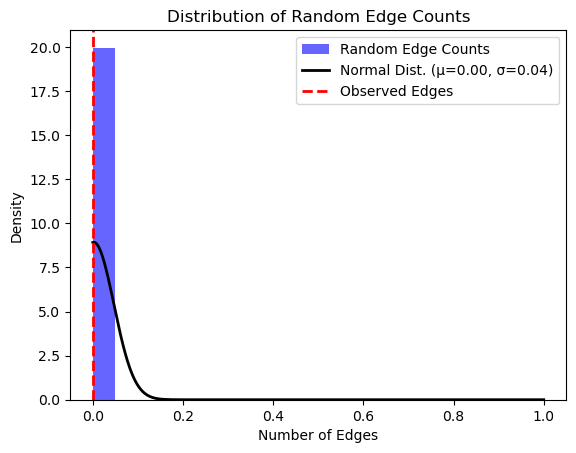

z score for a random nodes: -0.04476614810358452

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0002367/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing kidney cancer: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000166/associations?projection=associationByStudy
Genes: 6

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PAX8%0dHLA-DQA1%0

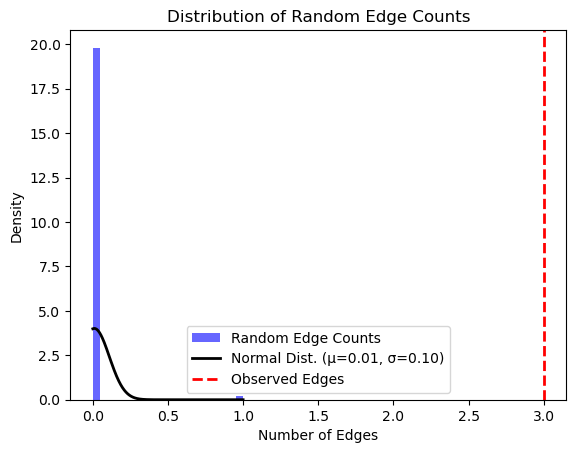

z score for a random nodes: 30.050630676250446

P-value: 2.54e-06
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0008903/associations?projection=associationByStudy
Genes: 11

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=LOC102723824%0dLINC02056%0dZRANB1%0dHRH4%0dLINC01377%0dLINC02039%0dMAP7%0dCSMD1%0dMIR4675%0dATP8B1%0dGRIK1&species=9606

Proteins: 6

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Fa

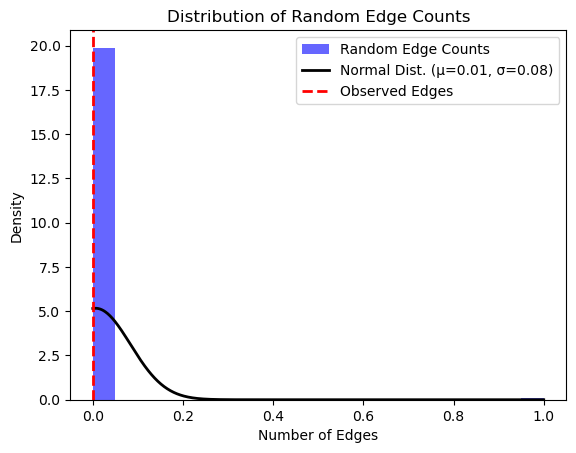

z score for a random nodes: -0.07769309688655059

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000349/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing clear cell renal carcinoma: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002890/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&speci

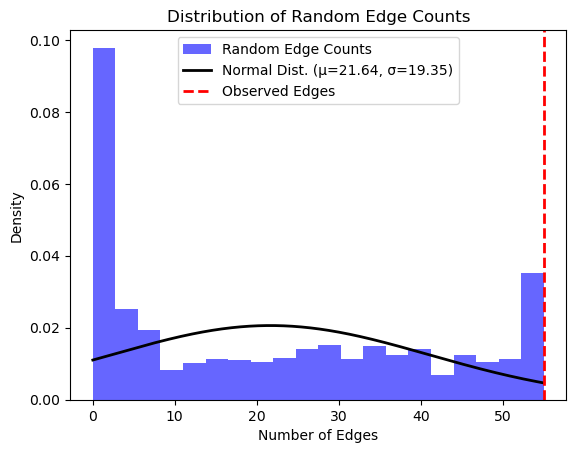

z score for a random nodes: 1.7235601659834547

P-value: 0.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0001056/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing gastric cancer: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0007254/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

F

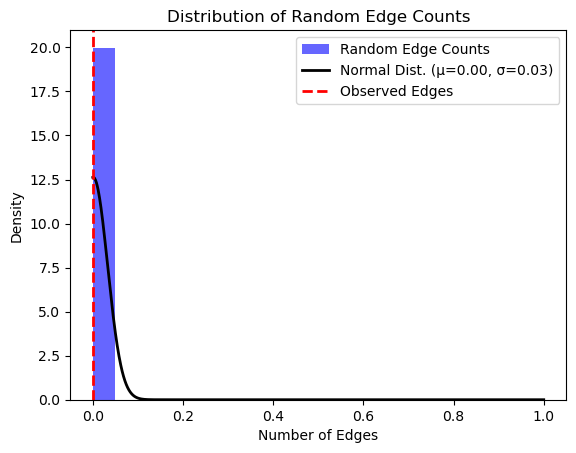

z score for a random nodes: -0.03163859985841663

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006999/associations?projection=associationByStudy
Genes: 4

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RASA1%0dCCNH%0dNAALADL2%0dKLK3&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string

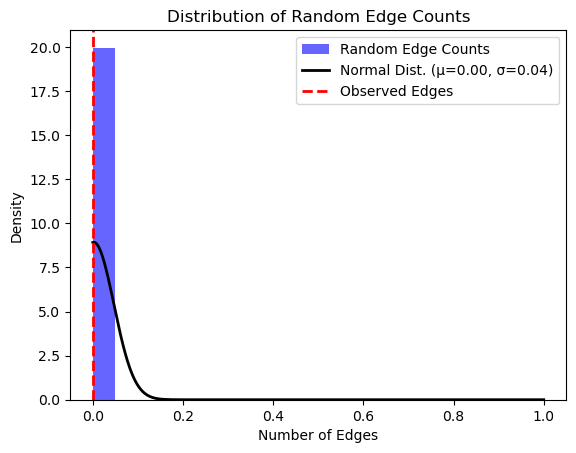

z score for a random nodes: -0.04476614810358452

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0002427/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing myeloid neoplasm: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003860/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

F

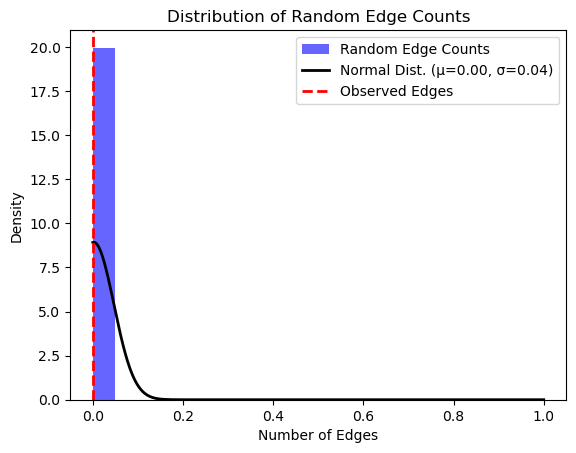

z score for a random nodes: -0.04476614810358452

P-value: 1.0
--------------------------------------------

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0001187/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing urinary bladder cancer: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003869/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species

In [40]:
output100 = compute_clustering(cancerous)

In [41]:
print(output100)
print(len(output100))

[{'name': 'contraception, breast carcinoma', 'efoID': 'EFO_0000305', 'num_edges': 156, 'z_score': 14.29446187282527}, {'name': 'carrier status, prostate carcinoma', 'efoID': 'EFO_0001663', 'num_edges': 34, 'z_score': 2.7397304751672293}, {'name': 'urinary bladder carcinoma', 'efoID': 'MONDO_0004986', 'num_edges': 14, 'z_score': 13.169594572442627}, {'name': 'laryngeal squamous cell carcinoma', 'efoID': 'EFO_0006352', 'num_edges': 0, 'z_score': -0.2322991616556164}, {'name': 'esophageal carcinoma', 'efoID': 'EFO_0002916', 'num_edges': 7, 'z_score': 11.170953473244028}, {'name': 'lung carcinoma', 'efoID': 'EFO_0001071', 'num_edges': 237, 'z_score': 12.384415476792961}, {'name': 'squamous cell carcinoma', 'efoID': 'EFO_0000707', 'num_edges': 15, 'z_score': 10.760521483645325}, {'name': 'lung adenocarcinoma', 'efoID': 'EFO_0000571', 'num_edges': 44, 'z_score': 5.818677055326006}, {'name': 'nasopharyngeal neoplasm', 'efoID': 'EFO_0004252', 'num_edges': 22, 'z_score': 6.8786163083220035}, {'

In [16]:
cancerous_clustering = [{'name': 'contraception, breast carcinoma', 'efoID': 'EFO_0000305', 'num_edges': 156, 'z_score': 14.29446187282527}, {'name': 'carrier status, prostate carcinoma', 'efoID': 'EFO_0001663', 'num_edges': 34, 'z_score': 2.7397304751672293}, {'name': 'urinary bladder carcinoma', 'efoID': 'MONDO_0004986', 'num_edges': 14, 'z_score': 13.169594572442627}, {'name': 'laryngeal squamous cell carcinoma', 'efoID': 'EFO_0006352', 'num_edges': 0, 'z_score': -0.2322991616556164}, {'name': 'esophageal carcinoma', 'efoID': 'EFO_0002916', 'num_edges': 7, 'z_score': 11.170953473244028}, {'name': 'lung carcinoma', 'efoID': 'EFO_0001071', 'num_edges': 237, 'z_score': 12.384415476792961}, {'name': 'squamous cell carcinoma', 'efoID': 'EFO_0000707', 'num_edges': 15, 'z_score': 10.760521483645325}, {'name': 'lung adenocarcinoma', 'efoID': 'EFO_0000571', 'num_edges': 44, 'z_score': 5.818677055326006}, {'name': 'nasopharyngeal neoplasm', 'efoID': 'EFO_0004252', 'num_edges': 22, 'z_score': 6.8786163083220035}, {'name': 'non-small cell lung carcinoma', 'efoID': 'EFO_0003060', 'num_edges': 6, 'z_score': 4.851851851851852}, {'name': 'triple-negative breast cancer', 'efoID': 'EFO_0005537', 'num_edges': 0, 'z_score': -0.11915864618843422}, {'name': 'colorectal cancer', 'efoID': 'MONDO_0005575', 'num_edges': 122, 'z_score': 8.774793763816321}, {'name': 'endometrial endometrioid carcinoma', 'efoID': 'EFO_1001514', 'num_edges': 2, 'z_score': 12.392673285625433}, {'name': 'endometrial carcinoma', 'efoID': 'EFO_1001512', 'num_edges': 19, 'z_score': 13.193343889756488}, {'name': 'squamous cell lung carcinoma', 'efoID': 'EFO_0000708', 'num_edges': 53, 'z_score': 6.035585502878795}, {'name': 'gastric carcinoma', 'efoID': 'EFO_0000178', 'num_edges': 1, 'z_score': 1.9224079103855778}, {'name': 'gastric adenocarcinoma', 'efoID': 'EFO_0000503', 'num_edges': 1, 'z_score': 6.518126273921757}, {'name': 'estrogen-receptor negative breast cancer', 'efoID': 'EFO_1000650', 'num_edges': 23, 'z_score': 11.317970121484953}, {'name': 'ovarian mucinous adenocarcinoma', 'efoID': 'EFO_0006462', 'num_edges': 0, 'z_score': -0.08980265101338746}, {'name': 'cervical carcinoma', 'efoID': 'EFO_0001061', 'num_edges': 19, 'z_score': 22.014139500825724}, {'name': 'pancreatic carcinoma', 'efoID': 'EFO_0002618', 'num_edges': 47, 'z_score': 6.009946241045287}, {'name': 'gastric cardia carcinoma', 'efoID': 'EFO_1001252', 'num_edges': 52, 'z_score': 2.0222106560165223}, {'name': 'response to bevacizumab, overall survival, cancer', 'efoID': 'MONDO_0004992', 'num_edges': 2, 'z_score': 6.458133937639161}, {'name': 'rectum cancer, colonic neoplasm', 'efoID': 'EFO_0004288', 'num_edges': 0, 'z_score': -0.1262772109594041}, {'name': 'ovarian carcinoma', 'efoID': 'EFO_0001075', 'num_edges': 26, 'z_score': 7.513219928044866}, {'name': 'ovarian clear cell adenocarcinoma', 'efoID': 'EFO_1000042', 'num_edges': 55, 'z_score': 2.9190935179023754}, {'name': 'ovarian endometrioid carcinoma', 'efoID': 'EFO_1001515', 'num_edges': 2, 'z_score': 5.339087406680829}, {'name': 'progression free survival, ovarian serous carcinoma', 'efoID': 'EFO_1001516', 'num_edges': 2, 'z_score': 3.2869970417348746}, {'name': 'hepatocellular carcinoma', 'efoID': 'EFO_0000182', 'num_edges': 8, 'z_score': 12.805501547036199}, {'name': 'gallbladder neoplasm', 'efoID': 'EFO_0004606', 'num_edges': 0, 'z_score': -0.08396038004871989}, {'name': 'colorectal cancer, colorectal adenoma', 'efoID': 'EFO_0005406', 'num_edges': 65, 'z_score': 18.56992448495612}, {'name': 'thyroid carcinoma', 'efoID': 'EFO_0002892', 'num_edges': 8, 'z_score': 21.156256303016338}, {'name': 'basal cell carcinoma', 'efoID': 'EFO_0004193', 'num_edges': 51, 'z_score': 13.793422047605496}, {'name': 'family history of lung cancer', 'efoID': 'EFO_0006953', 'num_edges': 3, 'z_score': 1.3835156654345142}, {'name': 'keratinocyte carcinoma', 'efoID': 'EFO_0010176', 'num_edges': 20, 'z_score': 12.262985686488715}, {'name': 'head and neck squamous cell carcinoma', 'efoID': 'EFO_0000181', 'num_edges': 0, 'z_score': -0.06337242505244779}, {'name': 'non-melanoma skin carcinoma', 'efoID': 'EFO_0009260', 'num_edges': 5, 'z_score': 9.611398107109265}, {'name': 'cutaneous squamous cell carcinoma', 'efoID': 'EFO_1001927', 'num_edges': 16, 'z_score': 16.362742748348452}, {'name': 'estrogen-receptor positive breast cancer', 'efoID': 'EFO_1000649', 'num_edges': 0, 'z_score': -0.12340351046845906}, {'name': 'progesterone-receptor negative breast cancer', 'efoID': 'EFO_0009781', 'num_edges': 16, 'z_score': 0.22225995473840401}, {'name': 'colorectal mucinous adenocarcinoma', 'efoID': 'EFO_0009361', 'num_edges': 0, 'z_score': -0.12340351046845904}, {'name': 'small cell lung carcinoma', 'efoID': 'EFO_0000702', 'num_edges': 14, 'z_score': 7.490466285250332}, {'name': 'renal cell carcinoma', 'efoID': 'EFO_0000681', 'num_edges': 3, 'z_score': 6.496198969539089}, {'name': 'esophageal adenocarcinoma', 'efoID': 'EFO_0000478', 'num_edges': 3, 'z_score': 3.094523451421377}, {'name': 'cholangiocarcinoma', 'efoID': 'EFO_0005221', 'num_edges': 3, 'z_score': 5.845110761015819}, {'name': 'differentiated thyroid carcinoma', 'efoID': 'EFO_1002017', 'num_edges': 1, 'z_score': 5.031764836222423}, {'name': 'papillary thyroid carcinoma', 'efoID': 'EFO_0000641', 'num_edges': 1, 'z_score': 6.1210774933048695}, {'name': 'human papilloma virus infection, oropharynx cancer', 'efoID': 'EFO_1001931', 'num_edges': 1, 'z_score': 4.453666973119295}, {'name': 'human papilloma virus infection, oral cavity cancer', 'efoID': 'EFO_0005570', 'num_edges': 3, 'z_score': 12.71306719630369}, {'name': 'rectum cancer', 'efoID': 'EFO_1000657', 'num_edges': 0, 'z_score': -0.1633831238975984}, {'name': 'disease recurrence, colon carcinoma', 'efoID': 'EFO_1001950', 'num_edges': 0, 'z_score': -0.13150664608837076}, {'name': 'testicular carcinoma', 'efoID': 'EFO_0005088', 'num_edges': 7, 'z_score': 10.336617602488264}, {'name': 'male breast carcinoma', 'efoID': 'EFO_0006861', 'num_edges': 1, 'z_score': 14.106735979665881}, {'name': 'lung carcinoma, asbestos exposure measurement', 'efoID': 'EFO_0004806', 'num_edges': 0, 'z_score': np.nan}, {'name': 'upper aerodigestive tract neoplasm', 'efoID': 'EFO_0004284', 'num_edges': 9, 'z_score': 41.800462118648994}, {'name': 'central nervous system cancer', 'efoID': 'EFO_0000326', 'num_edges': 21, 'z_score': 29.56504684350319}, {'name': 'neoplasm of mature B-cells', 'efoID': 'EFO_0000096', 'num_edges': 3, 'z_score': 13.651560041894117}, {'name': 'colorectal cancer, endometrial neoplasm', 'efoID': 'EFO_0004230', 'num_edges': 5, 'z_score': 5.314431785538791}, {'name': 'esophageal squamous cell carcinoma', 'efoID': 'EFO_0005922', 'num_edges': 7, 'z_score': 23.91315796497973}, {'name': 'BRCAX breast cancer', 'efoID': 'EFO_0009443', 'num_edges': 3, 'z_score': 10.892062274426246}, {'name': 'laryngeal squamous cell carcinoma, hypopharynx cancer', 'efoID': 'EFO_0007321', 'num_edges': 0, 'z_score': -0.04476614810358452}, {'name': 'cervical carcinoma, Cervical Intraepithelial Neoplasia Grade 2/3', 'efoID': 'EFO_1000166', 'num_edges': 3, 'z_score': 30.050630676250446}, {'name': 'lung cancer', 'efoID': 'MONDO_0008903', 'num_edges': 0, 'z_score': -0.07769309688655059}, {'name': 'cervical cancer', 'efoID': 'MONDO_0002974', 'num_edges': 55, 'z_score': 1.7235601659834547}, {'name': 'hepatitis virus-related hepatocellular carcinoma', 'efoID': 'EFO_0008505', 'num_edges': 0, 'z_score': -0.03163859985841663}, {'name': 'cancer aggressiveness measurement', 'efoID': 'EFO_0006999', 'num_edges': 0, 'z_score': -0.04476614810358452}, {'name': 'extrahepatic bile duct carcinoma', 'efoID': 'MONDO_0003090', 'num_edges': 0, 'z_score': -0.04476614810358452}]

In [24]:
for i in range(len(cancerous_clustering)):
    if np.isnan(cancerous_clustering[i]['z_score']):
        cancerous_clustering[i]['z_score'] = -0.04476614810358452

In [42]:
for e in output100:
    if e['num_edges'] == 0:
        print(e)

{'name': 'laryngeal squamous cell carcinoma', 'efoID': 'EFO_0006352', 'num_edges': 0, 'z_score': -0.2322991616556164}
{'name': 'triple-negative breast cancer', 'efoID': 'EFO_0005537', 'num_edges': 0, 'z_score': -0.11915864618843422}
{'name': 'ovarian mucinous adenocarcinoma', 'efoID': 'EFO_0006462', 'num_edges': 0, 'z_score': -0.08980265101338746}
{'name': 'rectum cancer, colonic neoplasm', 'efoID': 'EFO_0004288', 'num_edges': 0, 'z_score': -0.1262772109594041}
{'name': 'gallbladder neoplasm', 'efoID': 'EFO_0004606', 'num_edges': 0, 'z_score': -0.08396038004871989}
{'name': 'head and neck squamous cell carcinoma', 'efoID': 'EFO_0000181', 'num_edges': 0, 'z_score': -0.06337242505244779}
{'name': 'estrogen-receptor positive breast cancer', 'efoID': 'EFO_1000649', 'num_edges': 0, 'z_score': -0.12340351046845906}
{'name': 'colorectal mucinous adenocarcinoma', 'efoID': 'EFO_0009361', 'num_edges': 0, 'z_score': -0.12340351046845904}
{'name': 'rectum cancer', 'efoID': 'EFO_1000657', 'num_edge

In [106]:
efos = []
for e in output100:
    efos.append(e['efoID'])
print(efos)
print(len(efos))



['EFO_0000305', 'EFO_0001663', 'MONDO_0004986', 'EFO_0006352', 'EFO_0002916', 'EFO_0001071', 'EFO_0000707', 'EFO_0000571', 'EFO_0004252', 'EFO_0003060', 'EFO_0005537', 'MONDO_0005575', 'EFO_1001514', 'EFO_1001512', 'EFO_0000708', 'EFO_0000178', 'EFO_0000503', 'EFO_1000650', 'EFO_0006462', 'EFO_0001061', 'EFO_0002618', 'EFO_1001252', 'MONDO_0004992', 'EFO_0004288', 'EFO_0001075', 'EFO_1000042', 'EFO_1001515', 'EFO_1001516', 'EFO_0000182', 'EFO_0004606', 'EFO_0005406', 'EFO_0002892', 'EFO_0004193', 'EFO_0006953', 'EFO_0010176', 'EFO_0000181', 'EFO_0009260', 'EFO_1001927', 'EFO_1000649', 'EFO_0009781', 'EFO_0009361', 'EFO_0000702', 'EFO_0000681', 'EFO_0000478', 'EFO_0005221', 'EFO_1002017', 'EFO_0000641', 'EFO_1001931', 'EFO_0005570', 'EFO_1000657', 'EFO_1001950', 'EFO_0005088', 'EFO_0006861', 'EFO_0004806', 'EFO_0004284', 'EFO_0000326', 'EFO_0000096', 'EFO_0004230', 'EFO_0005922', 'EFO_0009443', 'EFO_0007321', 'EFO_1000166', 'MONDO_0008903', 'MONDO_0002974', 'EFO_0008505', 'EFO_0006999',

In [84]:
for i in range(len(output100)):
    if output100[i]['efoID'] not in cancerous[i]:
        print(output100[i])
        print(i)
        

{'name': 'cervical carcinoma, Cervical Intraepithelial Neoplasia Grade 2/3', 'efoID': 'EFO_1000166', 'num_edges': 3, 'z_score': 30.050630676250446}
61
{'name': 'lung cancer', 'efoID': 'MONDO_0008903', 'num_edges': 0, 'z_score': -0.07769309688655059}
62
{'name': 'cervical cancer', 'efoID': 'MONDO_0002974', 'num_edges': 55, 'z_score': 1.7235601659834547}
63
{'name': 'hepatitis virus-related hepatocellular carcinoma', 'efoID': 'EFO_0008505', 'num_edges': 0, 'z_score': -0.03163859985841663}
64
{'name': 'cancer aggressiveness measurement', 'efoID': 'EFO_0006999', 'num_edges': 0, 'z_score': -0.04476614810358452}
65
{'name': 'extrahepatic bile duct carcinoma', 'efoID': 'MONDO_0003090', 'num_edges': 0, 'z_score': -0.04476614810358452}
66


In [110]:
null_genes = []
for i in range(len(cancerous)):
    if cancerous[i][1] not in efos:
        null_genes.append(cancerous[i])
print(null_genes)
print(len(null_genes))

[('kidney cancer', 'MONDO_0002367'), ('clear cell renal carcinoma', 'EFO_0000349'), ('renal carcinoma', 'EFO_0002890'), ('papillary renal cell carcinoma', 'EFO_0000640'), ('survival time, estrogen-receptor positive breast cancer, breast carcinoma, HER2 negative breast carcinoma, progesterone-receptor positive breast cancer', 'EFO_0009782'), ('age of onset of colorectal cancer', 'OBA_2050327'), ('bile duct cancer', 'MONDO_0003059'), ('skin neoplasm', 'EFO_0004198'), ('mouth neoplasm', 'EFO_0003868'), ('liver neoplasm', 'EFO_1001513'), ('brain neoplasm', 'EFO_0003833'), ('luminal A breast carcinoma', 'MONDO_0021116'), ('gastric cancer', 'MONDO_0001056'), ('breast cancer', 'MONDO_0007254'), ('uterine carcinoma', 'EFO_0002919'), ('myeloid neoplasm', 'EFO_0002427'), ('pancreatic neoplasm', 'EFO_0003860'), ('thyroid cancer', 'MONDO_0002108'), ('urinary bladder cancer', 'MONDO_0001187'), ('breast neoplasm', 'EFO_0003869'), ('prostate cancer', 'MONDO_0008315'), ('skin carcinoma in situ', 'MOND

In [111]:
output_null = compute_clustering(null_genes)

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0002367/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing kidney cancer: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000349/associations?projection=associationByStudy
Genes: 0

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: B

In [98]:
print(cancerous[60])
print(output100[60])
print(cancerous[99])

('laryngeal squamous cell carcinoma, hypopharynx cancer', 'EFO_0007321')
{'name': 'laryngeal squamous cell carcinoma, hypopharynx cancer', 'efoID': 'EFO_0007321', 'num_edges': 0, 'z_score': -0.04476614810358452}
('colorectal carcinoma', 'EFO_1001951')


Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004806/associations?projection=associationByLocation
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PTHR2%0dPPL&species=9606

Proteins: 2

Number of edges: 0

Random edges calculation completed.



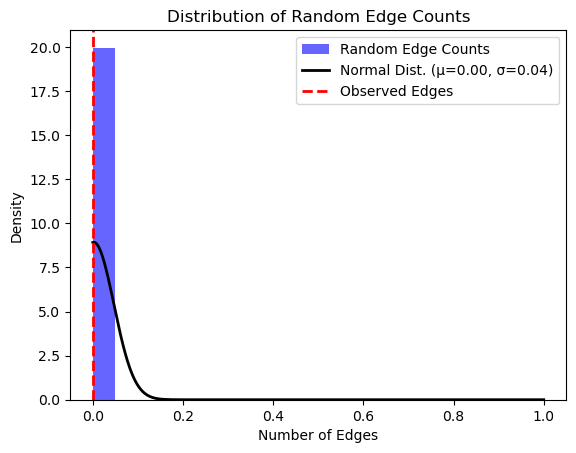

z score for a random nodes: -0.04476614810358452



(0, -0.04476614810358452)

In [23]:
d = Disease('lung carcinoma, asbestos exposure measurement', 'EFO_0004806')
d.quantify_clustering()

In [12]:
d = Disease('body mass index', 'EFO_0004340')
d.quantify_clustering()

Failed to retrieve data: 500

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004340/associations?projection=associationByLocation
retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network


AttributeError: 'NoneType' object has no attribute 'raise_for_status'

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000274/associations?projection=associationByLocation
Genes: 116

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=OVOL1%0dACTL9%0dKIF3A%0dZBTB10%0dNCF4%0dBAT1%0dC11orf30%0dIL18R1%0dIL1RL1%0dIL18RAP%0dHLA-C%0dGPSM3%0dC6orf10%0dNLRP10%0dOR10A3%0dLOC100505634%0dGLB1%0dCCDC80%0dLOC100630917%0dCARD11%0dMIR1208%0dZNF365%0dEGR2%0dADO%0dCLEC16A%0dCYP24A1%0dPFDN4%0dIL13%0dFLG%0dTNXB%0dCREBL1%0dLRRC32%0dRAD50%0dRP1-91G5.3%0dLCE5A%0dFLG-AS1%0dRN7SL335P%0dMFN2%0dSMARCA4%0dGRM4%0dRP11-13N12.1%0dANXA6%0dTNIP1%0dPRKRA%0dmiRNA548n%0dRASIP1%0dSNORA31%0dSPRR3%0dSPRR1B%0dPTPRN2%0dBC087858%0dTBL1XR1%0dMYT1L%0dRP11-219G17.4%0dMGMT%0dOR2W5%0dretro-NONO%0dZGLP1%0dFDX1L%0dRP11-973H7.1%0dRP11-548M13.1%0dCHST8%0dKIAA1109%0dRP11-74C3.1%0dPRR5L%0dSTEAP2-AS1%0dTGM3%0dR3HCC1L%0dKPNA3%0dLCE1E%0dLCE3E%0dIL4%0dHLA-B%0dMICA%0dIL2%0dIL21%0dTNFRSF6B%0dc6orf10%0dEDC%0dXIRP2%0dDMRTA1%0dRNF111%0dNR%0dLCE3A%0dSLC9A4 %0d

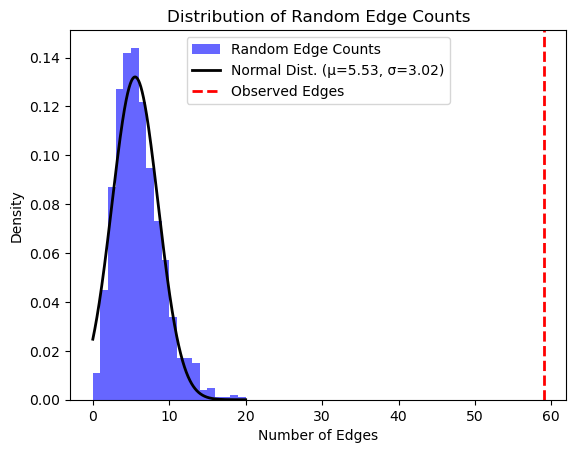

z score for a random nodes: 17.699347823353584

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000676/associations?projection=associationByLocation
Genes: 303

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ANXA6%0dTNIP1%0dPRKRA%0dmiRNA548n%0dFLG-AS1%0dRASIP1%0dRAD50%0dSNORA31%0dSPRR3%0dSPRR1B%0dPTPRN2%0dBC087858%0dTBL1XR1%0dMYT1L%0dRP11-219G17.4%0dMGMT%0dOR2W5%0dAC010733.4%0dLCE3A%0dTNFAIP3%0dKIAA1919%0dCTB-11I22.1%0dAC008697.1%0dUBLCP1%0dSTAT2%0dCS%0dTRAF3IP2%0dREV3L%0dRNU6-147P%0dRP11-674N23.1%0dPDE4A%0dretro-DNAJB6%0dFAP%0dIFIH1%0dDDX58%0dNOS2%0dTCEB3%0dKCNH7%0dAC008703.1%0dRNF114%0dPOLI%0dQTRT1%0dIL23R%0dLINC00583%0dABHD5%0dERAP1%0dIFNLR1%0dELMO1%0dACO1%0dNFKBIA%0dSLIT3%0dAC144521.1%0dRPS26%0dAL357060.1%0dEXOC2%0dBTD%0dLRRC43%0dRP11-973H7.1%0dICAM5%0dTMEM158%0dLARS2%0dCSMD1%0dRP11-405K6.1%0dANO3%0dEBF1%0dpiR-30261%0dRP11-340A13.2%0dADAM19%0dAF064858.6%0dSLC45A1%0dRAP1GAP2%0dretro-NONO%0dZGLP1%0dFDX1L%0dRP11-548M13.1%0dC

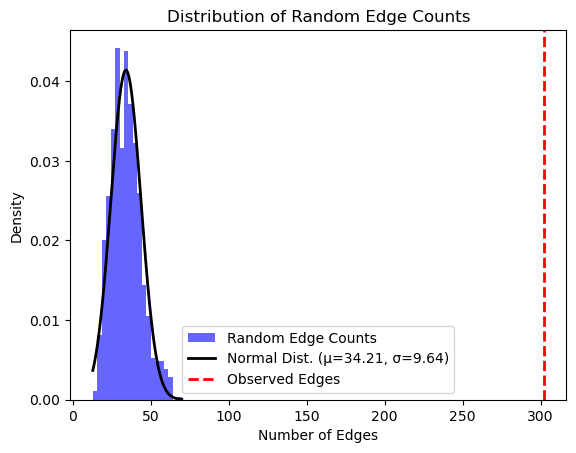

z score for a random nodes: 27.783078258761645

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005427/associations?projection=associationByLocation
Genes: 34

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=OR2J2%0dTRIM27%0dZNF311%0dOR2W1%0dOR2B3%0dLOC651503%0dOR214J1%0dOR5V1%0dOR12D3%0dOR2J3%0dintergenic%0dRNF111%0dMYO1E%0dAF429306%0dBRUNOL4%0dC16orf75%0dCOL27A1%0dDOCK1%0dEPB41L3%0dIRX5%0dKCNJ11%0dKCNK5%0dKIAA1992%0dLHFPL3%0dLMX1B%0dPLCB1%0dRAB8B%0dXIRP1%0dWDR48%0dGORASP1%0dTTC21A%0dCSRNP1%0dSCN11A%0dSERPINA13&species=9606

Proteins: 30

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Cli

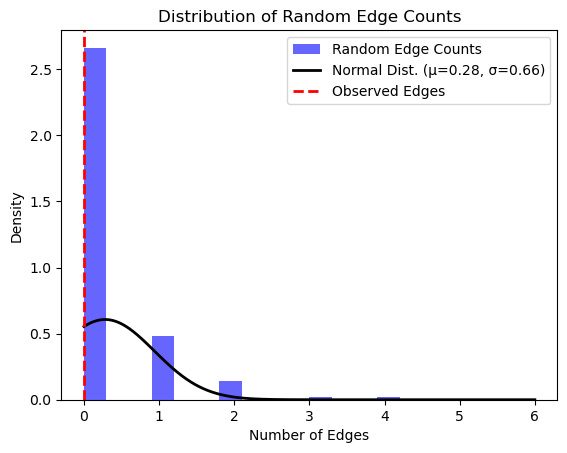

z score for a random nodes: -0.4275085883365956

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006516/associations?projection=associationByLocation
Genes: 10

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FLJ45721%0dEIF4G3%0dNFE2L3%0dSMARCA2%0dRASGRF2%0dCCKKR%0dSNTG1%0dTGFA%0dSTIM2%0dCOL8A1&species=9606

Proteins: 8

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string

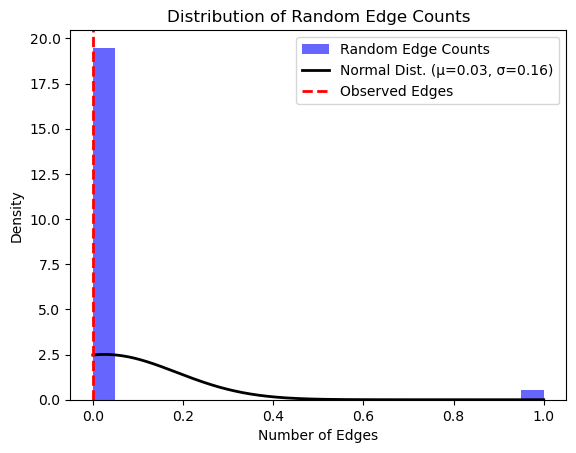

z score for a random nodes: -0.1633831238975984

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0018309/associations?projection=associationByLocation
Genes: 17

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RET%0dGALNACT-2%0dRASGEF1A%0dNRG1%0dSTIM2%0dSLC6A20%0dDEFB129%0dLOC100509398%0dCSGALNACT2%0dNOC4L%0dCARD14%0dSEMA3C/3D%0dPHOX2B%0dVRK2%0dFANCL%0dSEMA3%0dNR&species=9606

Proteins: 13

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to re

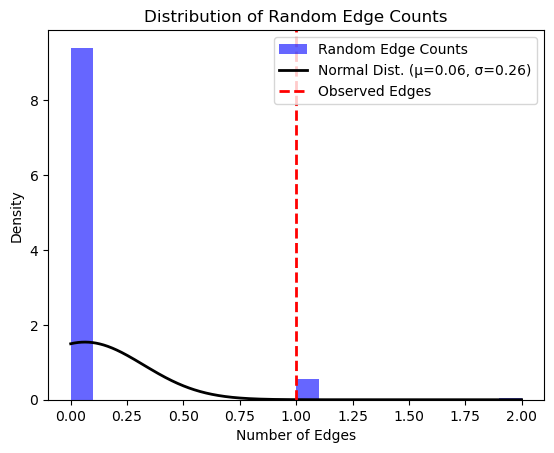

z score for a random nodes: 3.6191096526198874

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006522/associations?projection=associationByLocation
Genes: 3

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DDAH1%0dintergenic%0dNR&species=9606

Proteins: 3

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering d

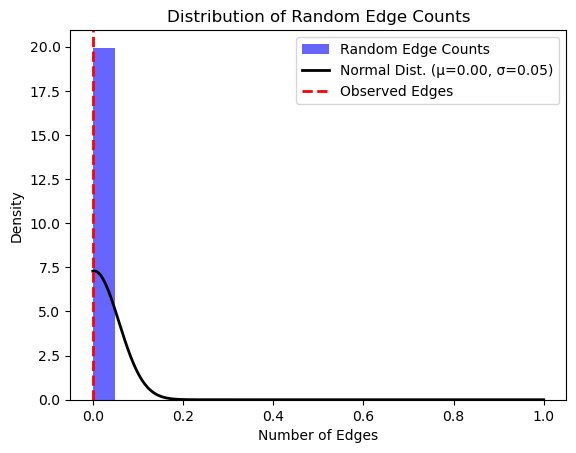

z score for a random nodes: -0.05485459945386285

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006523/associations?projection=associationByLocation
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TES%0dDNAJA5%0dDAZL%0dASB17%0dTFB2M%0dSLC6A5%0dLOC441282%0dAGXT2&species=9606

Proteins: 7

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-hea

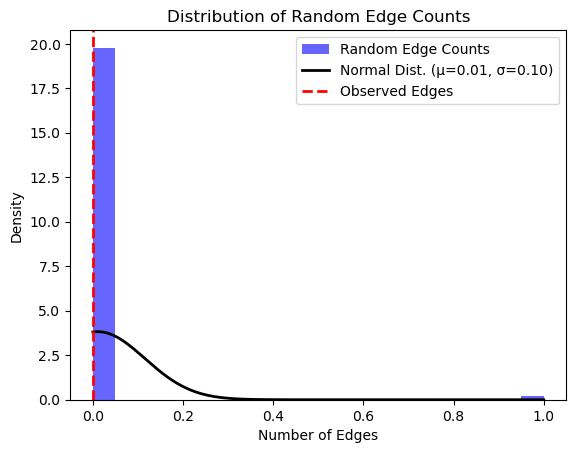

z score for a random nodes: -0.10546253270162946

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004314/associations?projection=associationByLocation
Genes: 302

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DQB1%0dHLA-DQA2%0dMICAL3%0dLOC389602%0dLOC285889%0dME3%0dPRSS23%0dMSRB3%0dMN1%0dNPNT%0dZKSCAN3%0dKANSL1%0dCDC123%0dHTR4%0dHHIP%0dLOC153910%0dGPR126%0dTNS1%0dTET2%0dGSTCD%0dC10orf11%0dKCNS3%0dCCDC91%0dRP11-538P18.2%0dAK097794%0dNCR3%0dTSEN54%0dCFDP1%0dZGPAT%0dAHNAK%0dABLIM3%0dCDON%0dRPUSD4%0dGLIS3%0dNR%0dTBX5%0dRBM19%0dMTAP%0dWWP2%0dBBS9%0dDIRC3%0dLINC00824%0dLINC00977%0dTHSD7A%0dWNT4%0dZBTB40%0dPTGFR%0dIFI44L%0dZCCHC6%0dGAS1%0dEYS%0dLOC340073%0dKCTD16%0dPRELID2%0dERC2%0dMIR181A1HG%0dMIR2054%0dINTU%0dMBNL2%0dOXGR1%0dRSRC1%0dCSGALNACT1%0dHCG4B%0dZNF184%0dLOC100507173%0dSPAG17%0dTBX15%0dSLC44A4%0dDARS%0dCXCR4%0dSLMAP%0dFERMT1%0dBMP2%0dGYPA%0dHHIP-AS1%0dARL15%0dAP3B1%0dP4HA2-AS1%0dCYFIP2%0dADAM19%0dBMP6%0dAGER%0dARMC2%0

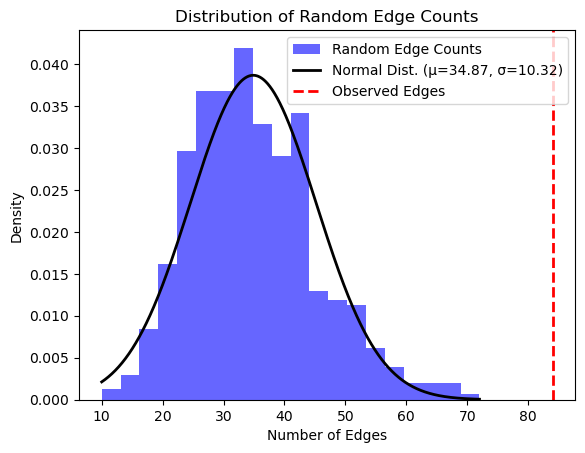

z score for a random nodes: 4.760437602716445

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005854/associations?projection=associationByLocation
Genes: 130

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FGF20%0dNR%0dPRDM16%0dBSND%0dLINC00486%0dDLG1%0dSYCP2L%0dFAM20C%0dFERD3L%0dNKAIN3%0dTUSC1%0dOSTF1%0dABCA1%0dAKR1E2%0dSVIP%0dCHRDL2%0dDYRK4%0dST8SIA2%0dRBFOX1%0dFTO%0dPMP22%0dLAMA3%0dZNF776%0dRBX1%0dC5orf66%0dHLA-DQB1%0dHLA-DQA1%0dIL1RL1%0dTLR1%0dTLR10%0dCAMK4%0dWDR36%0dLRRC32%0dC11orf30%0dHLA-B%0dHLA-C%0dRMI2%0dCLEC16A%0dGSDMB%0dZPBP2%0dIL21%0dIL2%0dID2%0dRNF144A%0dIL33%0dRANBP6%0dPLCL1%0dTPRG1%0dLPP%0dCELF2%0dGATA3%0dAAGAB%0dSMAD3%0dZBTB10%0dTPD52%0dSULT1A1%0dSULT1A2%0dIL13%0dRAD50%0dTTC6%0dTMEM75%0dMYC%0dNFATC2%0dKCNG1%0dCAPSL%0dIL7R%0dCDK2AP1%0dC12orf65%0dBACH2%0dGJA10%0dCXCR5%0dDDX6%0dAL590714.1%0dFCER1G%0dITPKA%0dRTF1%0dMANBA%0dNFKB1%0dJAZF1%0dTAX1BP1%0dATXN2%0dSH2B3%0dABO%0dOBP2B%0dVPRBP%0dFOSL2%0dRBKS%0dACTR1A%0dTME

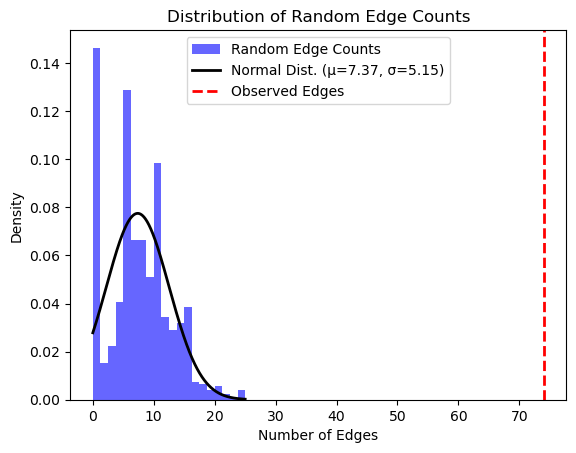

z score for a random nodes: 12.94607595333447

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003918/associations?projection=associationByLocation
Genes: 28

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dNR%0dAC011752.1%0dAC067959.1%0dLINC01171%0dGPR83%0dMRE11A%0dSMCO2%0dCTB-57H20.1%0dATP2B4%0dC6ORF183%0dCCDC162P%0dAC093901.1%0dPLCB1%0dAC124997.1%0dCDH4%0dARRB1%0dCTD-2562J17.7%0dCTD-2562J17.9%0dRP11-266O8.1%0dRP11- 45A12.2%0dTSPAN18%0dNRG1%0dC12orf79%0dFTO%0dRMST%0dNEDD1%0dCAMK1D&species=9606

Proteins: 15

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-

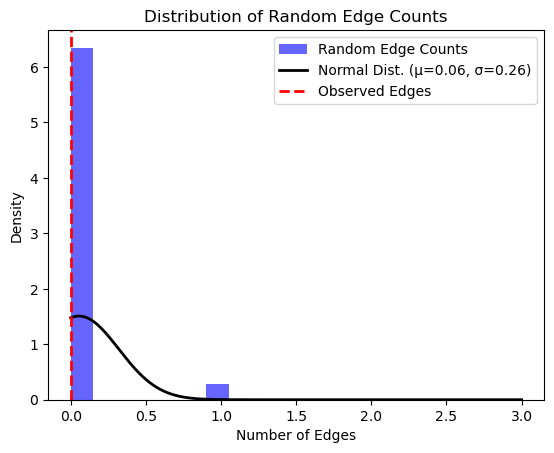

z score for a random nodes: -0.207917591612039

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003884/associations?projection=associationByLocation
Genes: 238

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CST9%0dCST3%0dCST4%0dFNDC4%0dIFT172%0dGCKR%0dDAB2%0dC9%0dRGS14%0dPRR7%0dPFN3%0dGRK6%0dSLC34A1%0dF12%0dLMAN2%0dATXN2%0dCPS1%0dWDR37%0dWDR72%0dPIP5K1B%0dFAM122A%0dAMIGO1%0dSORT1%0dATXN7L2%0dSYPL2%0dCYB561D1%0dPSMA5%0dDACH1%0dUBE2Q2%0dFBX022%0dBCAS3%0dTBX2%0dC17orf82%0dSOX11%0dTFDP2%0dSETDB1%0dLASS2%0dANXA9%0dPRUNE%0dFAM63A%0dBNIPL%0dCCDC123%0dECAT8%0dSLC7A9%0dSLC22A2%0dSLC6A13%0dJARID1A%0dSLC6A12%0dVEGFA%0dPRKAG2%0dRNASEH2C%0dKAT5%0dOVOL1%0dNAT8%0dNAT8B%0dALMS1%0dPHTF2%0dRSBN1L%0dTMEM60%0dCCDC158%0dSHROOM3%0dSPATA5L1%0dGATM%0dUMOD%0dACSM5%0dGP2%0dPDILT%0dSTC1%0dMPPED2%0dDDX1%0dPVT1%0dNR%0dMYH9%0dKLHL29%0dDHX35%0dLOC339568%0dCOX18%0dADAMTS3%0dEPHA7%0dSLC24A4%0dCPSF2%0dNCRNA00113%0dADAMTS5%0dDGUOK%0dTET3%0dESRRG%0dGPATCH2%0dR

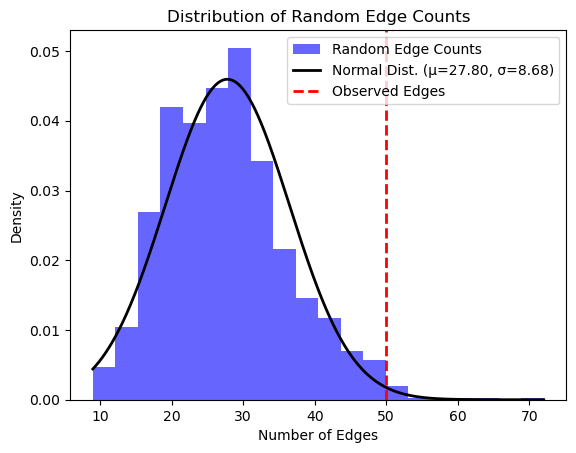

z score for a random nodes: 2.55695933145869

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004239/associations?projection=associationByLocation
Genes: 17

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DQ%0dHLA-DP%0dHLA-DPA3%0dHLA-DPB1%0dHLA-DQB2%0dHLA-DQA2%0dCFB%0dNOTCH4%0dHLA-DOA%0dCD40%0dHLA-C%0dEHMT2%0dHLA-DQB1%0dHLA-DPA1%0dTCF19%0dGRHL2%0dNR&species=9606

Proteins: 14

Number of edges: 19

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https

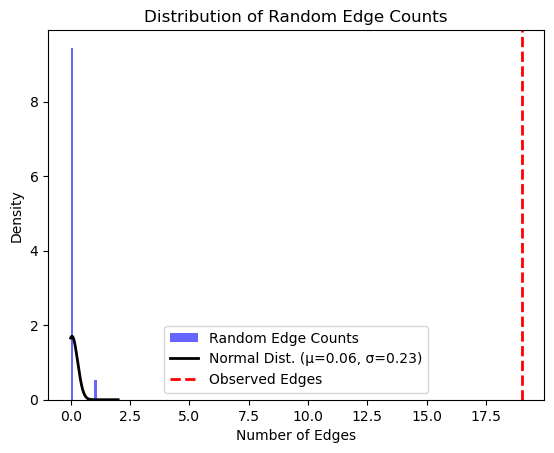

z score for a random nodes: 80.87754335746865

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004216/associations?projection=associationByLocation
Genes: 48

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dETV3L%0dETV3%0dGLT25D2%0dRGL1%0dLOC729257%0dFLJ39061%0dFZD7%0dC5orf15%0dFLJ31818%0dGPR85%0dYWHAZ%0dPTPRD%0dPITRM1%0dAMOTL1%0dCWC15%0dJMJD2D%0dKIRREL3%0dC12orf28%0dPAWR%0dGSX1%0dPDX1%0dLIG4%0dABHD13%0dSPATA8%0dA2BP1%0dPKD1L3%0dKIAA0174%0dDHODH%0dPKD1L2%0dC16orf46%0dATP8B1%0dMFHAS1%0dZBTB16%0dPPM1K%0dSLC6A1%0dRIT1%0dADH1C%0dC1QTNF7%0dPDE10A%0dSELPLG%0dTOX2%0dERCC4%0dLOC343052%0dKIAA1345%0dZNF330%0dNAG%0dARHGAP22&species=9606

Proteins: 46

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db

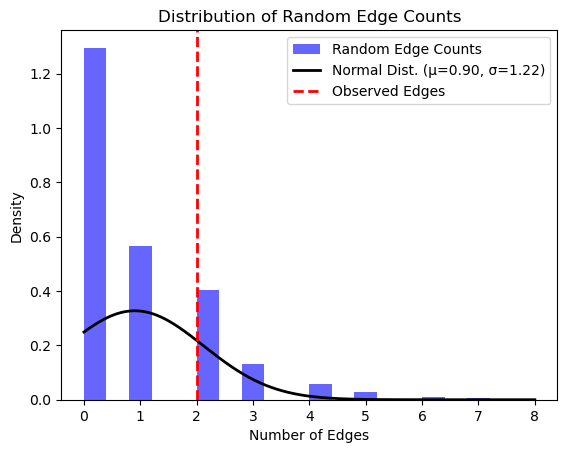

z score for a random nodes: 0.9006064980306959

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005426/associations?projection=associationByLocation
Genes: 16

MIR146B%0dLOC100505761%0dRIC8B%0dCBFA2T3%0dCLIP2%0dPATJ%0dintergenic%0dITGA8%0dSLC22A18AS&species=96062%0dDCLK2%0dN4BP1%0dCBLN1%0dGPR31%0dCCR6%0d

Proteins: 14

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to 

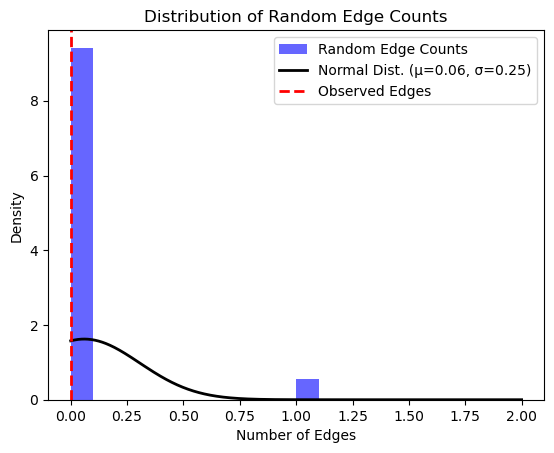

z score for a random nodes: -0.2441365376313478

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003756/associations?projection=associationByLocation
Genes: 491

CNNM2%0dCCDC68%0dODZ4%0dHDAC4%0dMGC16025%0dPPP2R2B%0dFAM155A%0dSLC35F2%0dRAB39%0dAS3MT%0dMAP4K4%0dIL1R2%0dDPYD%0dMIR137%0dNTRK3%0dELTD1%0dITIH3%0dTCF4%0dCACNB2%0dGRIN2A%0dANKS1B%0dSTT3A%0dPCGEM1%0dCSMD1%0dNT5C2%0dCUEDC2%0dEXT1%0dRIT2%0dKDM3B%0dFAM53C%0dBAG5%0dAPOPT1%0dHSPE1-MOB4%0dMOB4%0dMRPS33%0dBRAF%0dMEF2C%0dSNX19%0dCNNM2%0dRCOR2%0dMARK2%0dCTNND1%0dBTBD18%0dGID4%0dATPAF2%0dIntergenic%0dC2orf69%0dTYW5%0dRBKS%0dMRPL33%0dMAD1L1%0dGRM3%0dKIAA1324L%0dSHMT2%0dNXPH4%0dRTN1%0dC15orf53%0dZSCAN31%0dZKSCAN3%0dIMMP2L%0dCHRNA3%0dCHRNB4%0dSLC30A9%0dDCAF4L1%0dSLC39A8%0dCNTN4%0dNPAS3%0dTFAP2B%0dTFAP2D%0dNRGN%0dVSIG2%0dACADS%0dSPPL3%0dSORCS3%0dAMBRA1%0dHARBI1%0dZSCAN2%0dWDR73%0dIGSF9B%0dMYO18A%0dCRYBA1%0dSOX5%0dOSBPL3%0dDFNA5%0dNOX4%0dFOLH1B%0dVPS45%0dOTUD7B%0dEPHX2%0dCLU%0dFURIN%0dFES%0dOLFM4%0dMOCS2%0dITGA2%0dFADS2%0dFAD

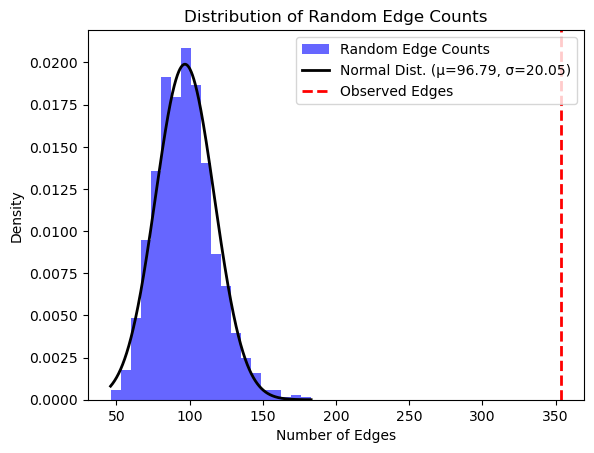

z score for a random nodes: 12.828229679504418

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003758/associations?projection=associationByLocation
Genes: 30

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CDH10%0dCDH9%0dSEMA5A%0dTAS2R1%0dNR%0dintergenic%0dMACROD2%0dPPP2R5C%0dPARD3B%0dTAF1C%0dTRIM33%0dBCAS2%0dDENND2C%0dAMPD1%0dNRAS%0dCSDE1%0dNEDD1%0dCASDE1%0dNFIA%0dAS2%0dESRRG%0dSYNPR%0dTENM2%0dSNX29%0dASIC2%0dUTY%0dKDM5D%0dTBL1Y%0dEIF1AY%0dDDX3Y&species=9606

Proteins: 28

Number of edges: 14

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/

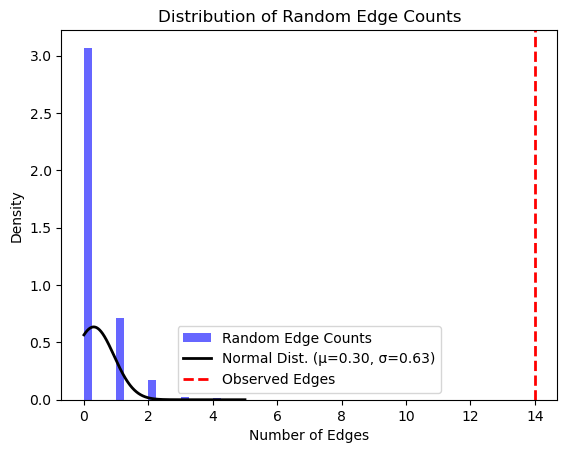

z score for a random nodes: 21.788229092324425

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004197/associations?projection=associationByLocation
Genes: 23

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA-DPB1%0dHLA-DP%0dEHMT2%0dTCF19%0dGRIN2A%0dHLA-DPA1%0dHLA-DQB1%0dHAL-DQB2%0dHLA-DQB2%0dHLA-C%0dUBE2L3%0dCDK14%0dKIF1B%0dHLA-DRB1%0dHLA-DPA2%0dLACE1%0dMIR219A1%0dINTS10%0dCSGALNACT1%0dLPL%0dSLC18A1%0dATP6V1B2%0dLZTS1&species=9606

Proteins: 19

Number of edges: 13

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Faile

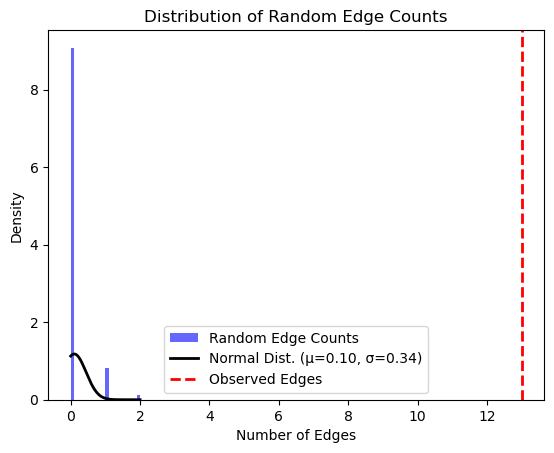

z score for a random nodes: 38.13227984341836

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000729/associations?projection=associationByLocation
Genes: 507

%0dNKX2%0dNKX3%0dRNF186%0dHLA-DQB1%0dIL22%0dDLD%0dFCGR2C%0dREL%0dCCDC139%0dCEP72%0dTPPP%0dSTAC2%0dFBXL20%0dMED1%0dCRKRS%0dPPP1R1B%0dSTARD3%0dTCAP%0dPERLD1%0dERBB2%0dC17orf37%0dGRB7%0dNEUROD2%0dKIF21B%0dC1orf81%0dCACNA1S%0dPSMG1%0dSATB2%0dC6orf10%0dCIITA%0dUQCC%0dCEP250%0dPROCR%0dADA%0dRFTN2%0dPLCL1%0dPRKCD%0dITIH4%0dNFKB1%0dMANBA%0dSLC9A3%0dCARD11%0dTTYH3%0dTSPAN33%0dMAML2%0dJRKL%0dNXPE1%0dNXPE4%0dITPKA%0dNDUFAF1%0dNUSAP1%0dITGAL%0dCALM3%0dFAM26F%0dGPD2%0dACTR3B%0dCPXM2%0dCOL13A1%0dPFKFB4%0dMST1R%0dUCN2%0dGPX1%0dIP6K2%0dIP6K1%0dUSP4%0dMYTL%0dHCG9%0dIRF8%0dIntergernic%0dCFB%0dBAT2%0dMSH5%0dHSPA1L%0dSLC44A4%0dNOTCH4%0d3.8-1%0dHCG26%0dPTPRC%0dADCY7%0dNR%0dHDAC11%0dC6orf15%0dCDSN%0dPSORS1C2%0dHCG27%0dHLA-C%0dHLA-B%0dMCCD1%0dATP6V1G2%0dLTA%0dTNF%0dLTB%0dNCR3%0dAIF1%0dBAG6%0dC6orf47%0dGPANK1%0dLY6G5B%0dLY6G5C%0dLY6G6

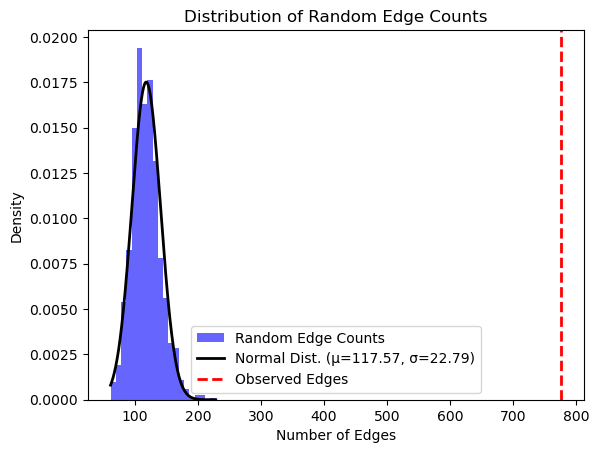

z score for a random nodes: 28.941408769353906

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005090/associations?projection=associationByLocation
Genes: 580

CNNM2%0dNT5C2%0dCSMD1%0dPCGEM1%0dODZ4%0dSTT3A%0dMMP16%0dGRIN2A%0dCACNB2%0dTCF4%0dITIH3%0dELTD1%0dDPYD%0dMIR137%0dNTRK3%0dMAP4K4%0dIL1R2%0dAS3MT%0dSLC35F2%0dRAB39%0dFAM155A%0dPPP2R2B%0dHDAC4%0dMGC16025%0dCENTG2%0dother genes%0dSNX8%0dNUDT1%0dFTSJ2%0dMAD1L1%0dhas-mir-137%0dPTBP2%0dFEZ1%0dEl24%0dPKNOX2%0dMHC%0dKCNMB2%0dNLRC5%0dMSRA%0dNMUR2%0dCOMMD10%0dZDBF2%0dGPR1%0dADAM23%0dSPTLC1%0dROR2%0dTHAP3%0dPRKD3%0dFOXN2%0dTMEM17%0dNR4A2%0dPCGF3%0dGSX2%0dSGCD%0dPCLO%0dYTHDF3%0dPSCA%0dZDHHC21%0dELAVL2%0dKCNMA1%0dSORCS3%0dB3GAT1%0dCASP12%0dMGAT4C%0dSMIM2%0dNIN%0dPPP2R5E%0dPSMD11%0dDCC%0dFUT2%0dROBO1%0dNAA11%0dPRKG2%0dTENM3%0dIGIP%0dPHF2%0dPCDH15%0dSAMD13%0dTMEFF2%0dCERS5%0dATXN7L3B%0dUFM1%0dENOX1%0dRCBTB1%0dTTC7B%0dCRHR1%0dEXOC2%0d9648%0dPPFIA2%0dCNTNAP5%0dTMTC1%0dITIH4%0dTRIM26%0dANP32E%0dAPH1A%0dC1orf51%0dC1orf54%0dCA14

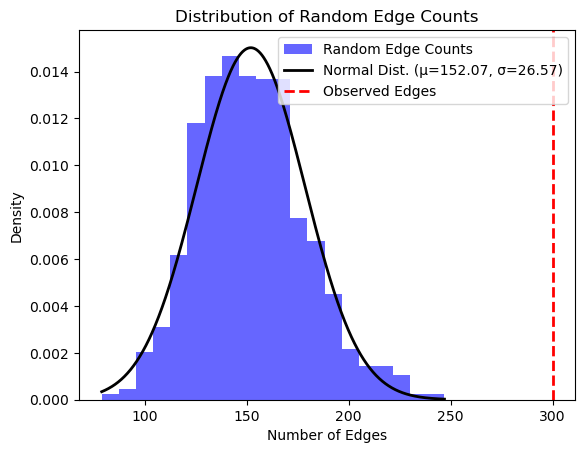

z score for a random nodes: 5.568342322355979

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004270/associations?projection=associationByLocation
Genes: 49

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=MEIS1%0dBTBD9%0dMAP2K5%0dLBXCOR1%0dPTPRD%0dSKOR1%0dintergenic%0dTOX3%0dBC034767%0dUTRN%0dPRMT6%0dNTNG1%0dDCDC2C%0dC1D%0dAPLF%0dCCDC148%0dPKP4%0dTANC1%0dCNTN4%0dCRBN%0dLRRN1%0dATP2C1%0dASTE1%0dRNF8%0dCCDC167%0dMDGA1%0dGLO1%0dADAM2%0dSTEAP4%0dZNF804B%0dDACH1%0dDIS3%0dDPH6%0dMEIS2%0dSEMA6D%0dSMAD3%0dCLN6%0dHOXBcluster%0dPRAC1%0dSETBP1%0dMYT1%0dSLC40A1%0dRANBP17%0dMICALL2%0dUNCX%0dLMO1%0dPMAIP1%0dNR%0dLGR6&species=9606

Proteins: 46

Number of edges: 10

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-head

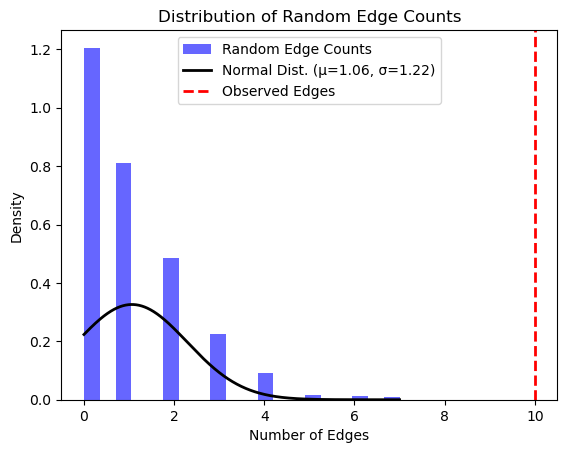

z score for a random nodes: 7.306195658824575

Failed to retrieve data: 500

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004340/associations?projection=associationByLocation
retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=&species=9606

Failed to retrieve data: 400

Failed to retrieve protein mappings.
Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data.
Number of edges: 0

Failed to retrieve data: 400 Client Error: Bad Request for url: https://string-db.org/api/image/network
Error processing body mass index: 'NoneType' object has no attribute 'raise_for_status'
Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004979/associations?projection=associationByLocation
Genes: 582

%0dSIM2%0dFAM19A2%0dRANBP6%0dLOC728792%0dORMDL3%0dRAD50%0dSCG3%0dKIAA1271%0dPDE4D%0dCRB1%0dDENND1B%0dIL13%0dIL18R1%0dIL2RB%0dGSDMB%0dHLA-DQ

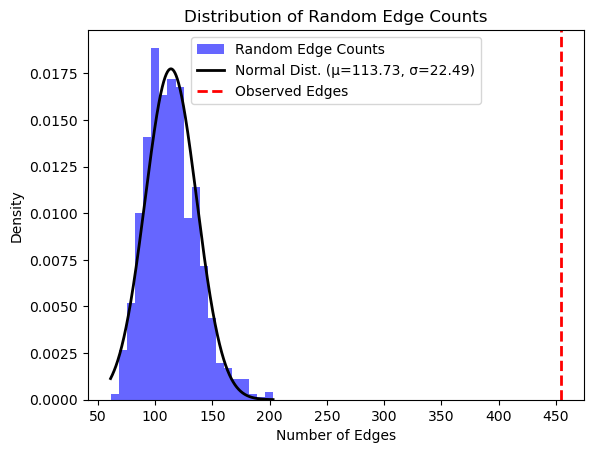

z score for a random nodes: 15.17635514649311

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004232/associations?projection=associationByLocation
Genes: 41

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SEMA6A%0dXKR6%0dMIR4675%0dLRRC32%0dC11orf30%0dCCDC81%0dLOC283710%0dKLF13%0dHSF2BP%0dNR%0dSLC25A24%0dCAPN14%0dTSLP%0dNOVA1%0dSTAT6%0dANKRD27%0dDSG1%0dWDR36%0dintergenic%0dC6orf48%0dHSPA1B%0dJAZF1%0dDEXI%0dCLEC16A%0dTMEM182%0dRAD50%0dSOX4%0dMATN2%0dPRKG1%0dRHOG%0dSHANK2%0dEMSY%0dGPR12%0dRORA%0dSMAD3%0dGALNT1%0dNAMPT%0dJAK2%0dCCNY%0dCPNE4%0dURGCP&species=9606

Proteins: 37

Number of edges: 6

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random node

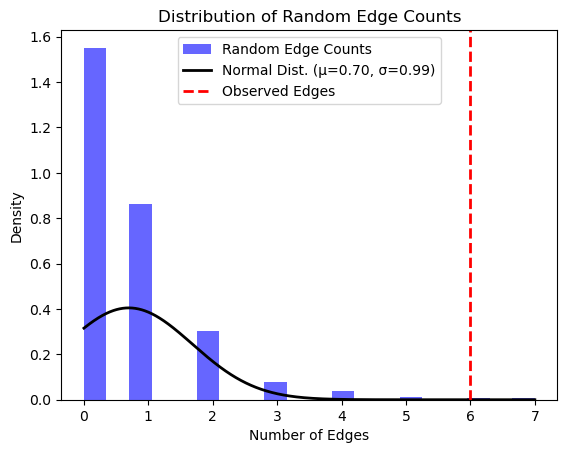

z score for a random nodes: 5.3810042898006785

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005301/associations?projection=associationByLocation
Genes: 517

%0dC3orf1%0dTMEM39A%0dCD5%0dDLEU1%0dEXTL2%0dFCRL3%0dGPR65%0dHHEX%0dIL22RA2%0dKIAA0564%0dMAF%0dMALT1%0dMAMSTR%0dNFKB1%0dMANBA%0dMAP3K14%0dMAPK1%0dMERTK%0dMMEL1%0dMPV17L2%0dMYB%0dMYC%0dMYNN%0dOLIG3%0dNCOA5%0dNDFIP1%0dNFKBIZ%0dODF3B%0dSCO2%0dIL7%0dPKIA%0dPLCL2%0dTHEMIS%0dPTPRK%0dPVR%0dPVT1%0dRGS1%0dRGS14%0dRPS6KB1%0dRREB1%0dSAE1%0dSLC30A7%0dVCAM1%0dSOX8%0dSP140%0dSYK%0dTCF7%0dTNFSF14%0dZBTB46%0dZFP36L1%0dZNF438%0dZNF767%0dZNF746%0dSLC15A2%0dDRB1%0dC6orf10%0dDQA1%0dVAV2%0dZNF433%0dCBLB%0dHLA-DQB1%0dHLA-DRB%0dTMEM47%0dDSC1%0dMRGPRE%0dEGFL6%0dARHGEF10%0dLOC339788%0dARL11%0dMMP10%0dHACE1%0dVTI1A%0dSAMD12%0dNAP5%0dTLL1%0dAK127238%0dRNASEL%0dLOC285501%0dMAZ%0dL3MBTL3%0dSHMT1%0dERG%0dANKRD55%0dIntergenic%0dPLEKHG5%0dBCL10%0dPHGDH%0dFCRL1%0dSLAMF7%0dCENPO%0dFLJ16341%0dSTAT4%0dCCR4%0dFOXP1%0dTET2%0dPXT1%0dCARD11%0dJAZF1

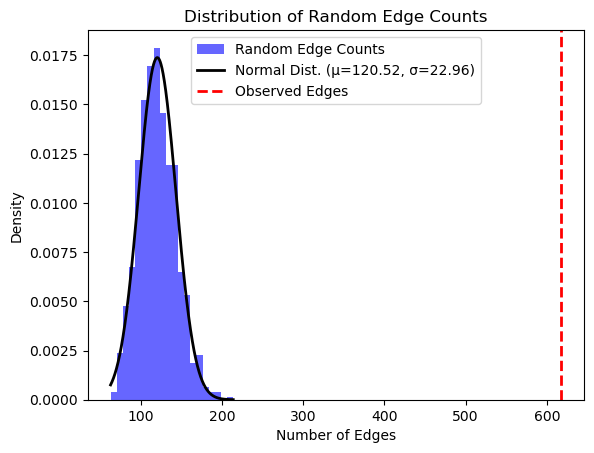

z score for a random nodes: 21.67131600923396

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005532/associations?projection=associationByLocation
Genes: 8

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ABI3BP%0dIFT43%0dNR%0dHLF%0dRAD51L1%0dRIMS1%0dRGMB%0dAKAP9&species=9606

Proteins: 8

Number of edges: 0

Failed to retrieve data: ('Connection aborted.', RemoteDisconnected('Remote end closed connection without response'))
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: ('Connection aborted.', RemoteDisconnected('Remote end closed connection without response'))
Failed to retrieve clustering data for random nodes.
Random edges calculation completed.



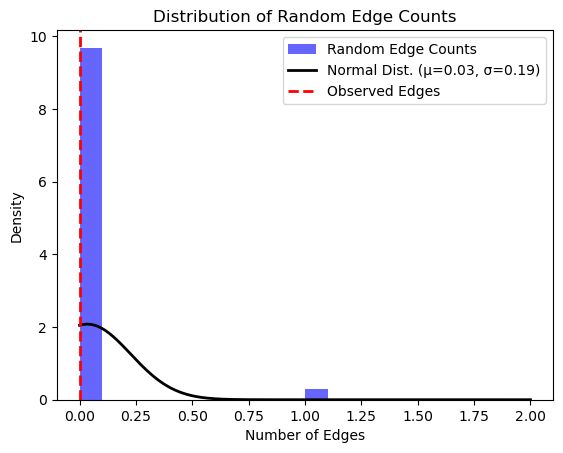

z score for a random nodes: -0.17713138981698098

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004541/associations?projection=associationByLocation
Genes: 185

%0dANK1%0dMTNR1B%0dATP11A%0dTUBGCP3%0dFN3K%0dTMPRSS6%0dG6PC3%0dCCT3%0dTMEM79%0dc1orf85%0dHBS1L%0dMYB%0dintergenic%0dFADS2%0dCYBA%0dMYO9B%0dFN3KRP%0dKLF4%0dKCNQ1%0dSCRN3%0dCDT1%0dSOX30%0dG6PD%0dSMIM1%0dSYF2%0dCERS2%0dFDPS%0dATP2B4%0dPROX1-AS1%0dATAD2B%0dRAB10%0dZFP36L2%0dFOXN2%0dARHGAP25%0dSPC25%0dPNKD%0dTMBIM1%0dLOC646736%0dSYN2%0dUSP4%0dTMEM110-MUSTN1%0dTMEM110%0dADCY5%0dSLC2A2%0dFNDC3B%0dIGF2BP2%0dLPP-AS2%0dFREM3%0dZBED3-AS1%0dMIR1303%0dHAVCR1%0dRREB1%0dFAM65B%0dLRRC16A%0dHFE%0dLINC00240%0dOR2B6%0dGPX6%0dZNF311%0dNFKBIL1%0dPPIL6%0dDGKB%0dPDCD5%0dGIPR%0dVSX1%0dRBM38%0dA4GALT%0dCD99L2%0dNSDHL%0dMLXIPL%0dARPC1A%0dASB15%0dSLC20A2%0dTRIB1%0dCDKN2B-AS1%0dVPS13A%0dC9orf47%0dABO%0dDNLZ%0dCDC123%0dGAD2%0dSIRT3%0dINS%0dINS-IGF2%0dLOC440028%0dAMPD3%0dNR1H3%0dFADS1%0dARHGAP42%0dC2CD2L%0dCCND2-AS1%0dPHB2%0dPFKM%0dSTAC3

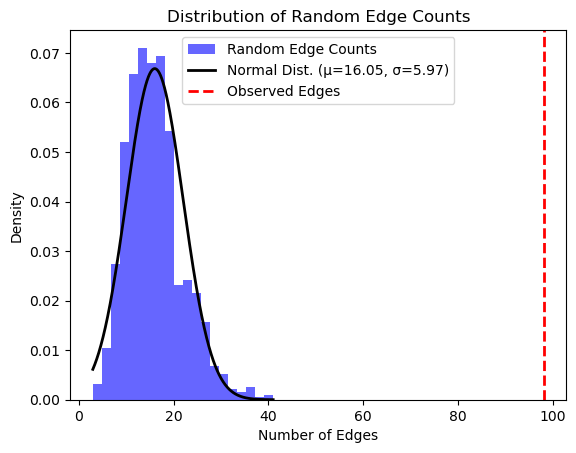

z score for a random nodes: 13.729760173380198

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004235/associations?projection=associationByLocation
Genes: 3

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=LOXL1%0dTBC1D21%0dCACNA1A&species=9606

Proteins: 3

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering

/Users/aliaarman/Desktop/thesis/code/disease.py:15: RuntimeWarning: invalid value encountered in scalar divide
  z_score = (observed_edges - mean) / std
/Users/aliaarman/anaconda3/lib/python3.11/site-packages/scipy/stats/_distn_infrastructure.py:1988: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


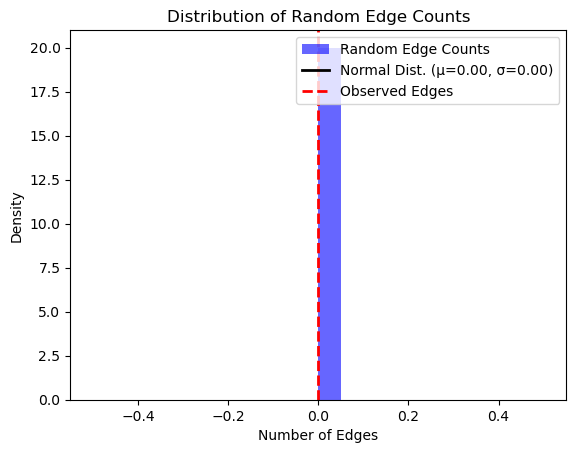

z score for a random nodes: nan

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0007915/associations?projection=associationByLocation
Genes: 359

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CD80%0dAFF1%0dLEF1%0dLRRC18%0dWDFY4%0dNR%0dSLC15A4%0dUBE2L3%0dHIC2%0dHLA-DRB1%0dTNFSF4%0dRASGRP3%0dSTAT4%0dTNIP1%0dPRDM1%0dATG5%0dTNFAIP3%0dIKZF1%0dIRF5%0dBLK%0dETS1%0dELF1%0dTNXB%0dHLA-DR3%0dITGAM%0dLAMC2%0dCOL25A1%0dPTTG1%0dSLC1A7%0dKIAA1542%0dintergenic%0dHLA-DQA2%0dRPL7AP59%0dOR4A15%0dNOTCH4%0dC6orf10%0dTMC2%0dHLA-DQA1%0dNAALADL2%0dBANK1%0dTNPO3%0dHLA region%0dPXK%0dC8orf13%0dITGAX%0dNTNG2%0dGHR%0dSOCS6%0dNEGR1%0dc10orf64%0dSNRPC%0dZNF184%0dFCGR2A%0dLAMC1%0dEDEM3%0dBIN1%0dKCNJ3%0dCNTN6%0dC2%0dSEC61G%0dMTG1%0dEHF%0dFAM98B%0dTYRO3%0dSPATA8%0dMED1%0dRASSF2%0dRNF114%0dHLA-DQB1%0dDGUOK%0dTET3%0dARID5B%0dRTKN2%0dCREBL2%0dGPR19%0dCDKN1B%0dDRAM1%0dAPOBEC4%0dSCN10A%0dBACH2%0dSLC29A3%0dSEZ6L2%0dDDA1%0dCD44%0dUHRF1BP1%0dCLEC16A%0dUSMG5%0dBC0

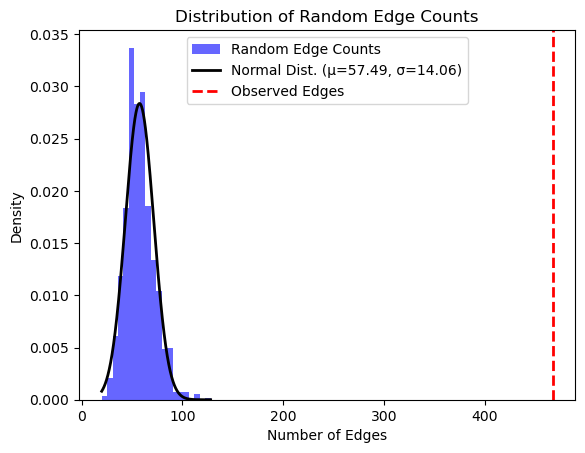

z score for a random nodes: 29.118141913188666

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005180/associations?projection=associationByLocation
Genes: 350

%0dPOL3S%0dWNT3%0dRIT2%0dPRDM15%0dSCARB2%0dSREBF1%0dRAI1%0dSYT4%0dUSP25%0dUNC13B%0dSTH%0dC8orf4%0dCLRN3%0dC4orf26%0dLMNB1%0dC17orf68%0dCCDC82%0dTMC3%0dCOL13A1%0dHLA%0dHUSEYO%0dDSG3%0dOCA2%0dATF6%0dQSER1%0dPRRG4%0dAAK1%0dDDRGK1%0dBCKDK%0dSTX1B%0dFGF20%0dSIPA1L2%0dINPP5F%0dTMEM163%0dTMEM175%0dDGKQ%0dFAM47E%0dHLA-DQB%0dGPNMB%0dMIR4697%0dTMEM229B%0dSPPL2B%0dGCH1%0dVPS13C%0dDIRC1%0dCOL3A1%0dTCEANC2%0dLDLRAD1%0dTMEM59%0dMX2%0dZP3%0dPABPN1L%0dKCNIP4%0dHTR2A%0dLPPR1%0dPRDM2%0dKIAA1026%0dWNT9A%0dLOC728728%0dPLEKHN1%0dCYP1B1%0dC2orf58%0dCOL5A2%0dFLJ23172%0dFNDC3B%0dC3orf67%0dLOC339902%0dLOC285194%0dIGSF11%0dPAQR3%0dARD1B%0dFGF10%0dMRPS30%0dTSG1%0dMANEA%0dPDE10A%0dFLJ43860%0dNCRNA00051%0dANXA1%0dLOC100130911%0dDMRT2%0dSMARCA2%0dBARX1%0dPTPDC1%0dFLJ35379%0dLOC100132423%0dMDGA2%0dATPBD4%0dLOC100288892%0dC18orf1%0dZNF396%

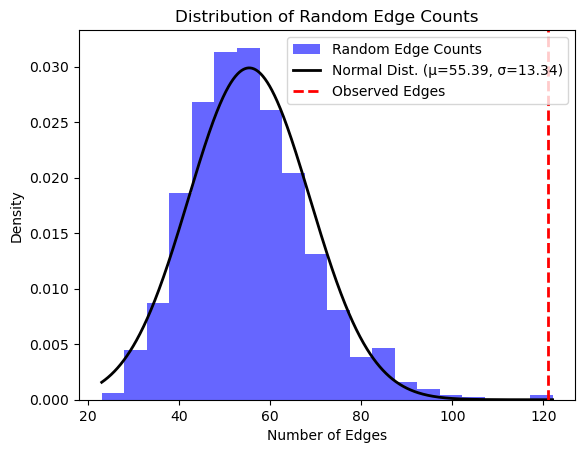

z score for a random nodes: 4.917470892363766

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004311/associations?projection=associationByLocation
Genes: 34

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SCN10A%0dCH25H%0dFAS%0dC18orf20%0dLOC643448%0dintergenic%0dRNF19A%0dANKRD46%0dSCN5A%0dCDKN1A%0dTBX5%0dRNF11%0dCDKN2C%0dFAF1%0dC1orf185%0dIGFBP3%0dKLF12%0dSLC25A26%0dLRIG1%0dDKK1%0dGOSR2%0dPLEC%0dGATA4%0dCLCNKA%0dCASQ2%0dTTN%0dCWC27%0dBAG3%0dSMARCB1%0dCCDC141%0dSERPINB9%0dMTSS1%0dALPK3%0dSLC35F1&species=9606

Proteins: 32

Number of edges: 7

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too 

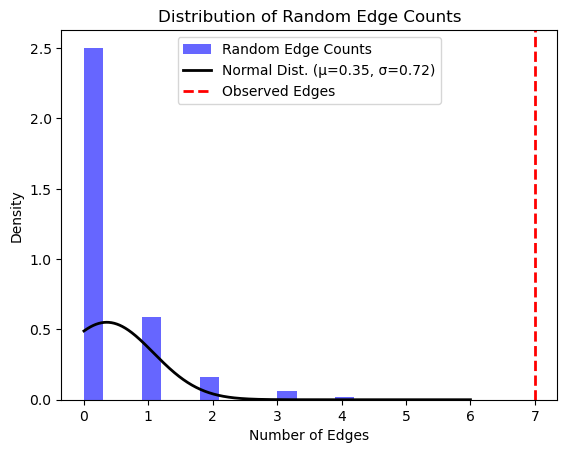

z score for a random nodes: 9.175113102543097

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001358/associations?projection=associationByLocation
Genes: 36

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TLL1%0dTRPS1%0dRPS29%0dGRIN1%0dCOBL%0dAKT3%0dTECRL%0dMTRNR2L5%0dSLC4A5%0dFAM49B%0dZMAT3%0dPRKCA%0dOTOR%0dNDRG1%0dGABBR2%0dPOGK%0dPTPRV%0dLGR6%0dCSMD1%0dPRTFDC1%0dUST%0dLHX2%0dSIPA1L2%0dKAT2B%0dDPP6%0dKIAA1456%0dADCY8%0dMIR3166%0dMEX3B%0dintergenic%0dUNC13C%0dTBC1D2%0dSDC2%0dAK092087%0dNR%0dANKRD55&species=9606

Proteins: 33

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: T

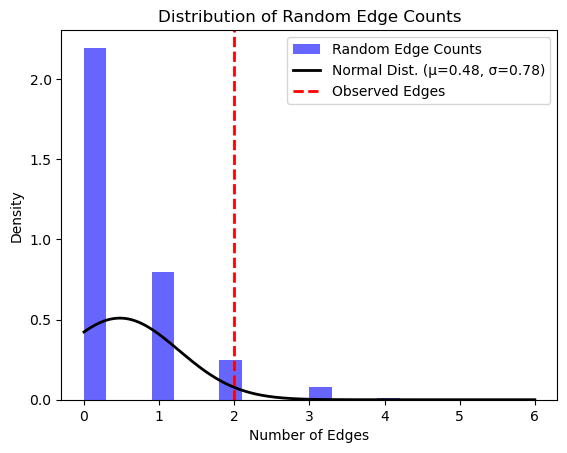

z score for a random nodes: 1.9431293239620504

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0016046/associations?projection=associationByLocation
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ZNF664%0dNCOR2&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Err

/Users/aliaarman/Desktop/thesis/code/disease.py:15: RuntimeWarning: invalid value encountered in scalar divide
  z_score = (observed_edges - mean) / std
/Users/aliaarman/anaconda3/lib/python3.11/site-packages/scipy/stats/_distn_infrastructure.py:1988: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


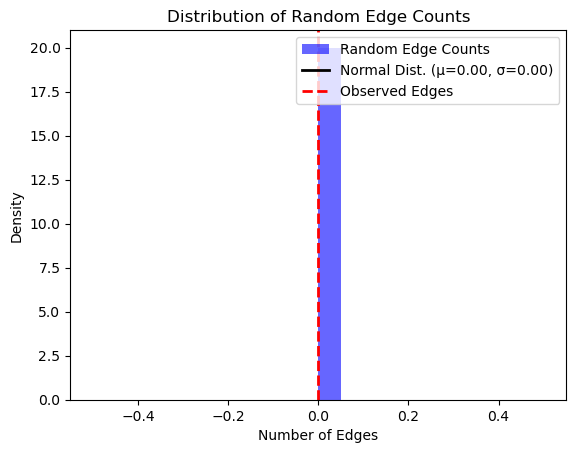

z score for a random nodes: nan

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000341/associations?projection=associationByLocation
Genes: 365

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FOXG1%0dLINC00928%0dTICRR%0dMYCN%0dDDX1%0dCOMMD10%0dGNG5P5%0dFAM19A2%0dLOC645949%0dNUF2%0dSCLT1%0dTFAP2C%0dCHRNA3%0dFAM13A%0dHHIP%0dRIN3%0dMMP12%0dTGFB2%0dCHRNA5%0dPSMA4%0dIREB2%0dAGPHD1%0dSCGB1A1%0dAHNAK%0dASRGL1%0dAPIP%0dEHF%0dTCF1%0dHNF1A%0dRP1-23E21.2%0dAC090398.2%0dFGB%0dAC138517.1%0dC21orf34%0dJAKMIP3%0dRP1-21O18.1%0dWNT7A%0dKB-1137H10.1%0dP2RX7%0dEYA1%0dHYDIN%0dSFTPD%0dATP2C2%0dRP11-369J21.2%0dRP11-369J21.4%0dRP11-369J21.6%0dRP11-369J21.5%0dANXA11%0dHLA-C%0dFGFR3P%0dRP11-479O17.4%0dPSORS1C1%0dCCHCR1%0dRNF150%0dFUT8%0dPELI2%0dOPCML%0dNTM%0dGYPA%0dHHIP-AS1%0dCHRNA4%0dLOC123688%0dRAB4B%0dEGLN2%0dCYP2A6%0dDLG2%0dKLHL7%0dNUPL2%0dGNG2%0dHTR4%0dADGRG6%0dGPR126%0dTHSD4%0dADAM19%0dEEFSEC%0dCFDP1%0dARMC2%0dPID1%0dDSP%0dMTCL1%0dNPNT%0dGSTCD

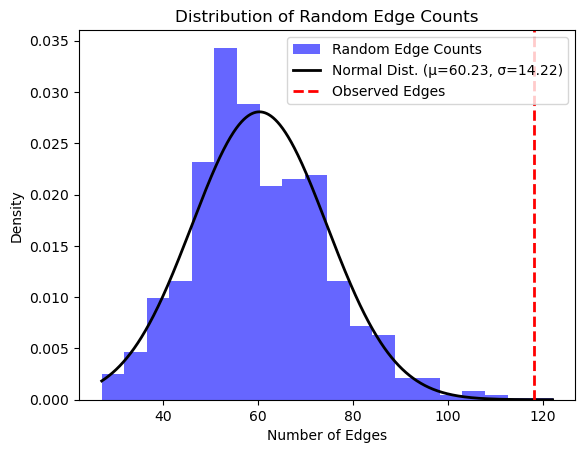

z score for a random nodes: 4.064251020167978

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004465/associations?projection=associationByLocation
Genes: 269

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ZMAT4%0dintergenic%0dPRDM5%0dMTNR1B%0dGCKR%0dG6PC2%0dFOXA2%0dLOC642791%0dARHGEF3%0dFAM180A%0dUNQ1940%0dNIPSNAP3B%0dLOC284395%0dJDP2%0dC2CD4B%0dSLC30A8%0dTCF7L2%0dGCK%0dSLC2A2%0dTMEM195%0dDGKB%0dADCY5%0dMADD%0dADRA2A%0dFADS1%0dGLIS3%0dPROX1%0dCRY2%0dABCB11%0dSIX2%0dSIX3%0dLEPR%0dIGF1R%0dCDKAL1%0dABCC11%0dCDKN2A%0dCDKN2B%0dPDK1%0dRAPGEF4%0dKANK1%0dPPP1R3B%0dPCSK1%0dMRPL33%0dARAP1%0dDPYSL5%0dPDX1%0dOR4S1%0dGRB10%0dLMO1%0dRREB1%0dFBXL10%0dFOXN3%0dVPS13C%0dIGF2BP2%0dZNF626%0dCA10%0dBCAT1%0dSCL9A2%0dMFSD9%0dWDR37%0dPPP1R12A%0dNIPAL2%0dFBXO8%0dIGF1%0dCDC14C%0dPCDH15%0dGPR126%0dIDDM8%0dADAM12%0dSLC39A11%0dLOX%0dMGAT1%0dGRIN3A%0dPPARGC1A%0dHTR2B%0dNMUR1%0dPHF17%0dMYO10%0dPMFBMP1%0dCYP19A1%0dEIF2C2%0dSLC39A12%0dRPL7AP27%0dSNX30%0dCT

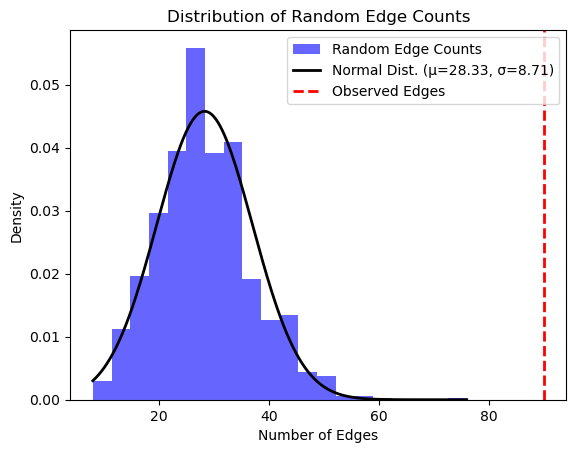

z score for a random nodes: 7.078138979711672

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004190/associations?projection=associationByLocation
Genes: 188

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ABCA1%0dPMM2%0dFOXC1%0dNR%0dGMDS%0dTMCO1%0dAFAP1%0dLOC102467147-C5orf67%0dFOXF2-FOXCUT%0dANGPT1%0dCDKN2B-AS1%0dABCA1-SLC44A1%0dLMX1B%0dME3%0dARHGEF12%0dC14orf39%0dGAS7%0dCAV1%0dCAV2%0dCDKN2B%0dSIX6%0dSIX1%0dNCKAP5%0dCDKN2BAS%0dZFPM2%0dLRP12%0dITIH1%0dTXNRD2%0dATXN2%0dCDC7%0dTGFBR3%0dC17orf57%0dMPP7%0dIntergenic%0dCDKN2B-AS%0dCRYGS%0dLINC02052%0dTBCCD1%0dMYOF%0dXRCC6P1%0dCYP26A1%0dCYP26C1%0dEXOC6%0dLOC105376277%0dLMO7%0dLPP%0dTHSD7A%0dCTTNBP2%0dLSM8%0dMEIS1%0dDGKD%0dCOL11A1%0dBNIP1%0dSEMA3C%0dCACNA2D1%0dLMO4%0dPKN2-AS1%0dTMEM181%0dRARB%0dDGKG/TBCCD1%0dPNPT1%0dCADM2%0dANKH%0dPDE7B%0dPKHD1%0dFAM120B%0dTSC22D2%0dIKZF2%0dFBXO32%0dZNF280D%0dTCF12%0dLINC00540%0dACOXL%0dPRKAG2%0dEXOC2%0dFMNL2%0dCHEK2%0dMADD%0dPLCE1%0dBICC1%0dTMTC2

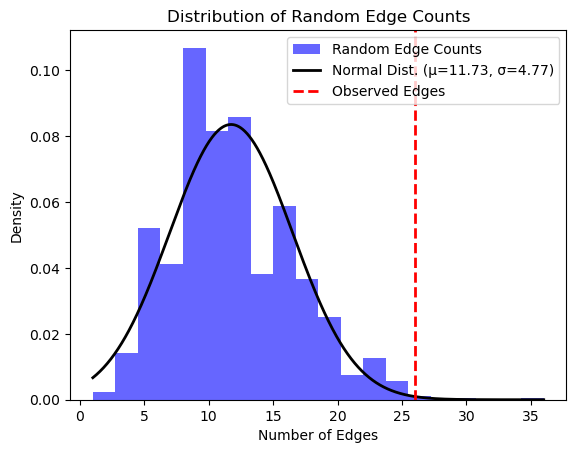

z score for a random nodes: 2.987865515700341

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005208/associations?projection=associationByLocation
Genes: 324

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=RHOC%0dHOXD8%0dLPHN2%0dARL15%0dPIK3R1%0dEYA4%0dASTN2%0dSLC7A6%0dEPB41L3%0dRNF152%0dLRP2%0dIGFBP2%0dAC005534.6%0dRERG%0dR3HDM2%0dSHROOM3%0dDAB2%0dETV5%0dSLC34A1%0dVEGFA%0dSLC22A2%0dUNCX%0dTMEM60%0dPRKAG2%0dSTC1%0dPIP5K1B%0dWDR37%0dA1CF%0dKCNQ1%0dMPPED2%0dCASP9%0dSYPL2%0dANXA9%0dCACNA1S%0dDDX1%0dGCKR%0dNAT8%0dCPS1%0dTFDP2%0dINO80%0dDPEP1%0dSIPA1L3%0dWDR72%0dSLC6A13%0dRNASEH2C%0dTSPAN9%0dDACH1%0dGATM%0dUBE2Q2%0dUMOD%0dSLC47A1%0dCDK12%0dBCAS3%0dNFATC1%0dSLC7A9%0dTP53INP2%0dBCAS1%0dCST3%0dCST9%0dATXN2%0dALMS1%0dLOC100132354%0dDCDC5%0dPHTF2%0dIGFBP5%0dSPATA5L1%0dPDILT%0dMICALL2%0dADAM28%0dMED1%0dNR%0dGAB2%0dSOX5%0dTRIM51HP%0dOR4A16%0dKRR1%0dPHLDA1%0dTRPV4%0dCUX2%0dDGKH%0dCOL4A2%0dSPPL2A%0dAP4E1%0dCEMIP%0dIGF1R%0dZNF436%0dGBAP1%0

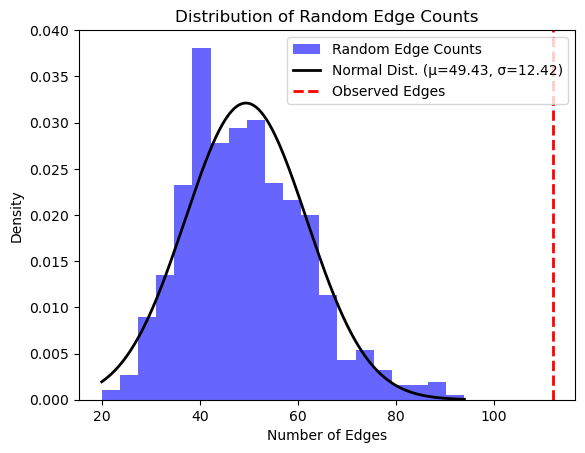

z score for a random nodes: 5.037883359661828

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0007079/associations?projection=associationByLocation
Genes: 97

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dC15orf32%0dUSP12%0dZNF124%0dC3orf31%0dHIP1%0dPECR%0dCAST%0dERAP1%0dPPP2R2B%0dESR1%0dNKAIN1%0dSNRNP40%0dZCCHC17%0dFABP3%0dSERINC2%0dKIAA0040%0dPKNOX2%0dADH4%0dADH1C%0dADH6%0dADH1A%0dADH7%0dADH1B%0dADH5%0dANKS1%0dMBNL2%0dDCC%0dNR%0dGPD1L%0dSH3BP5%0dNXPH2%0dARL15%0dUTP20%0dOXTR%0dFAF1%0dOPA3%0dSPATA13%0dWDR7%0dEFHA2%0dALDH2%0dNEIL2%0dOPCML%0dGALNT10%0dSLC6A15%0dSYT17%0dLHPP%0dSIX3%0dMYC%0dTSPAN5%0dGCKR%0dSLC39A8%0dMDF1C%0dPKHD1%0dDRD2%0dFTO%0dMICB%0dBRAP%0dMETAP1%0dMARCKS%0dEIF4E%0dGSTM3%0dGSTM4%0dEPS8L3%0dSPATS2L%0dPPP1R16B%0dFAM83D%0dZNF697%0dANKS1B%0dAGBL4%0dCTNNA2%0dLINGO1%0dCCSER1%0dFAM162A%0dSEMA3A%0dIntergenic%0dLOC100507053%0dHPGD%0dRHAG%0dAOX2P%0dLOC101927285%0dCNTN5%0dGNAL%0dPPFIA2%0dB3GALT5%0dPRSS54%0

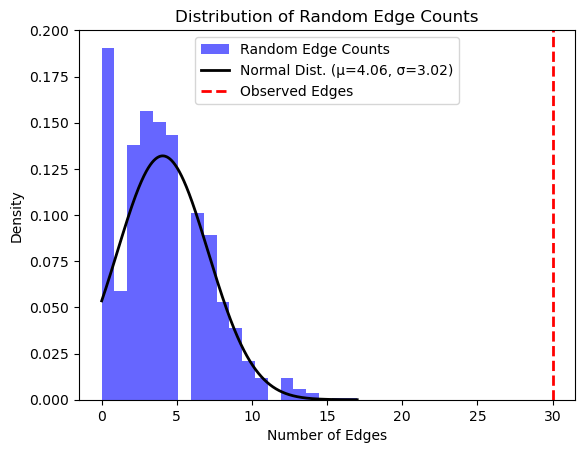

z score for a random nodes: 8.584698945728075

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003894/associations?projection=associationByLocation
Genes: 225

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SGOL1%0dLINC00691%0dNKIRAS1%0dNR1D2%0dRPL15%0dTHRB%0dUBE2E1%0dUBE2E2%0dLOC643723%0dLOC728463%0dRRP15%0dTGFB2%0dAK097288%0dFST%0dITGA1%0dITGA2%0dLOC257396%0dPELO%0dMOCS2%0dNDUFS4%0dAK096023%0dAY927499%0dC6orf89%0dCCDC167%0dCPNE5%0dFGD2%0dFTSJD2%0dMDGA1%0dMIR4462%0dMTCH1%0dPI16%0dPIM1%0dPPIL1%0dRNF8%0dTBC1D22B%0dTMEM217%0dTRNA_Gln%0dZFAND3%0dTGFA%0dADD2%0dASPRV1%0dMir_548%0dATP6V1B1%0dC2orf42%0dCD207%0dCLEC4F%0dFAM136A%0dFIGLA%0dLOC100133985%0dPCBP1%0dPCBP1-AS1%0dPCYOX1%0dSNRPG%0dTIA1%0dTRNA%0dTRNA_Gly%0dTRNA_Pseudo%0dVAX2%0dAX746604%0dAX747517%0dBANF1%0dBC010924%0dC11orf68%0dCATSPER1%0dCCDC85B%0dCDC42EP2%0dCST6%0dCTSW%0dDPF2%0dDQ587981%0dDRAP1%0dEFEMP2%0dEHBP1L1%0dEIF1AD%0dFAM89B%0dFIBP%0dFOSL1%0dFRMD8%0dGAL3ST3%0dKAT5%0dKC

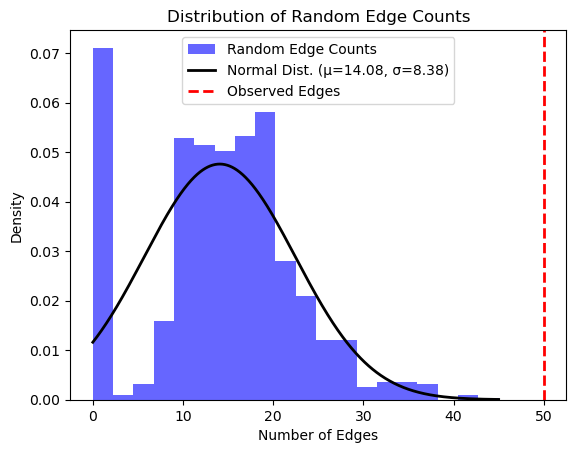

z score for a random nodes: 4.287123083562297

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005187/associations?projection=associationByLocation
Genes: 15

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PIK3C3%0dSERPINA12%0dESRRAP2%0dLRRK2%0dBACE2%0dPLAC4%0dC21orf130%0dFAM3B%0dGCKR%0dPPP1R3B%0dMHC%0dZP4%0dLINCO1139%0dAC073333.8%0dHLA-A&species=9606

Proteins: 10

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client E

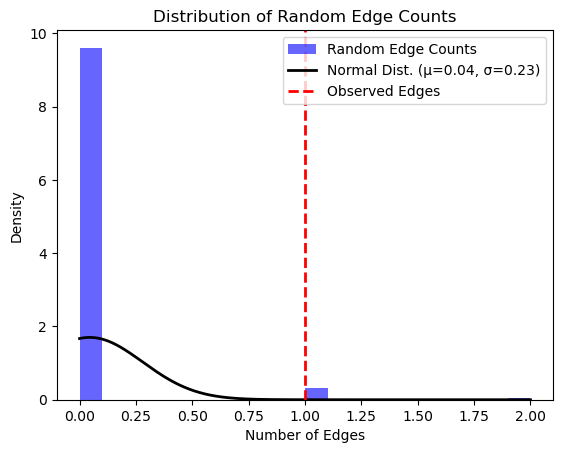

z score for a random nodes: 4.073059482945758

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004307/associations?projection=associationByLocation
Genes: 55

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ADCY5%0dTCF7L2%0dVPS13C%0dGCKR%0dGIPR%0dMTNR1B%0dSUPV3L1%0dSRGN%0dHK1%0dVPS26A%0dHKDC1%0dGLP2R%0dGCK%0dKCNQ1%0dPEX11A%0dUTP3%0dHERC1%0dTBC1D4%0dNR%0dDHX37%0dSPON1%0dSERPINA1%0dMACF1%0dTDG%0dSLC5A1%0dHOXD1%0dCLEC10A%0dABO%0dF13A1%0dLOC105374569%0dPAPPA2%0dADAM30%0dST8SIA6%0dARHGEF17%0dBTNL3%0dRAPGEF4%0dPOLR1C%0dZFAND2A%0dUNCX%0dGPT%0dCOBLL1%0dIGF2BP2%0dCAMK2B%0dLOC157273%0dABCC8%0dHNF1A-AS1%0dCLEC14A%0dSLC2A4%0dMED9%0dBCL2%0dHHEX%0dEXOC6%0dSMCO4%0dIRS1%0dNYAP2&species=9606

Proteins: 52

Number of edges: 30

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Ma

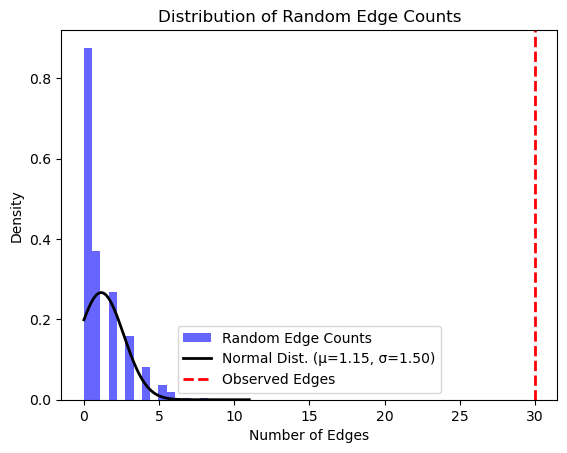

z score for a random nodes: 19.293175369272543

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000537/associations?projection=associationByLocation
Genes: 215

%0dC5orf23%0dNPR3%0dPLCE1%0dEBF1%0dMOV10%0dSLC39A8%0dFURIN%0dFES%0dSLC12A9%0dIGSF5%0dKLHL29%0dOPRM1%0dSLC30A1%0dCACNA1D%0dCYP21A2%0dMED13L%0dSLC4A7%0dCASZ1%0dFGF5%0dGUCY1A3%0dCYP17A1%0dSOX6%0dALDH2%0dPRDM16%0dMTHFR%0dKCNK3%0dBANK1%0dLINC02571%0dHCP5%0dMPIG6B%0dSLC44A4%0dHOXA10%0dCABCOCO1%0dCNNM2%0dNT5C2%0dSBF2%0dCAND1.11%0dNR1H3%0dPSMC3%0dMTCH2%0dPTPRJ%0dOR4X1%0dGRM5%0dARHGAP42%0dATXN2%0dLOC101926933%0dSEMA7A%0dFAM219B%0dLOC105371345%0dPLCD3%0dHOXB3%0dINSR%0dRGL3%0dEVX1%0dHOXA cluster%0dULK4%0dIGFBP3%0dCDH17%0dFRMD3%0dTARID%0dTCF21%0dPLEKHG1%0dGPR20%0dHOXA3%0dNOS3%0dPTPMT1%0dCERS5%0dCUX2%0dPRDM8%0dLSP1%0dLOC102723639%0dLOC105377005%0dHOTTIP%0dLOC105375794%0dLOC100133669%0dCAPZA1%0dCDKN2B-AS1%0dDMRTA1%0dHOXA9%0dCYP11B1%0dCYP11B2%0dFGD5%0dSLC22A7%0dFIGN%0dGRB14%0dGUCY1B3%0dTNNT3%0dSWAP70%0dCRIP3%0dENPEP%0dC20orf

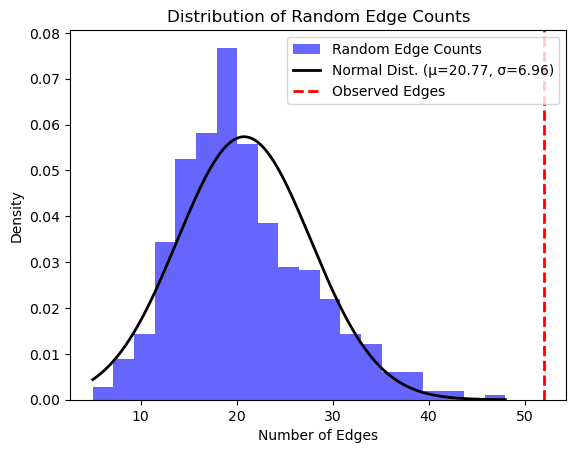

z score for a random nodes: 4.488574935195237

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005676/associations?projection=associationByLocation
Genes: 4

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SH2B3%0dCARD10%0dHLA-DQA1%0dHLA-DQB1&species=9606

Proteins: 4

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve 

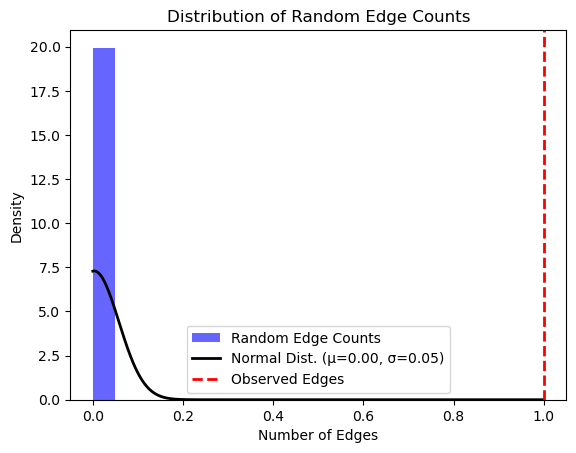

z score for a random nodes: 18.230011885167087

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000555/associations?projection=associationByLocation
Genes: 29

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=KDELR2%0dGRID2IP%0dHES6%0dFGF2%0dNUDT6%0dSPRY1%0dPCDH15%0dNCAM1%0dHLA-C%0dPIK3CD%0dIntergenic%0dFAM98A%0dABLIM2%0dMTSS1%0dCPNE8%0dEPSTI1%0dintergenic%0dLIG4%0dFAM155A%0dWSCD1%0dDPH5%0dS1PR1%0dFHIT%0dHECW1%0dLOC100506895%0dHAMP%0dHPN-AS1%0dMIR5196%0dNR&species=9606

Proteins: 25

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.or

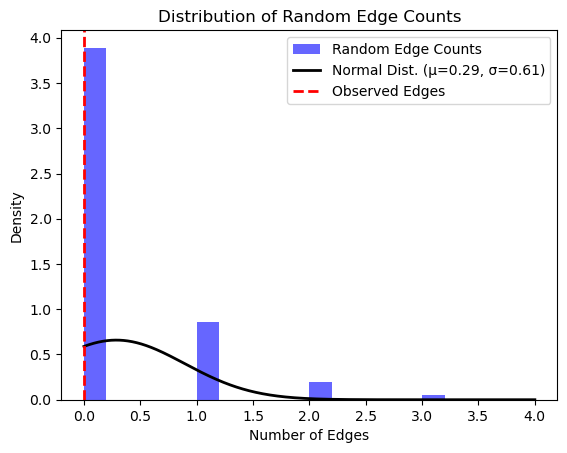

z score for a random nodes: -0.473987954498048

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000649/associations?projection=associationByLocation
Genes: 174

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GLT6D1%0dLBP%0dKCNJ16%0dSCN2A%0dTGIF1%0dC15orf2%0dLRP12%0dSEMA6A%0dDAOA%0dGRIK1%0dIQSEC1%0dNLGN1%0dCCDC13%0dSNRPN%0dSETMAR%0dKIAA1804%0dKCNK1%0dPKN2%0dFBXO38%0dHTR4%0dUHRF2%0dGLDC%0dTPD52L3%0dIL33%0dTBC1D1%0dPTTG2%0dCLIC5%0dRUNX2%0dCSMD3%0dTRPS1%0dCAMTA1%0dVAMP3%0dFOS%0dJDP2%0dODZ2%0dWWC1%0dGRID1%0dMI346%0dWAPAL%0dKIAA1715%0dEVX2%0dEXTLP2%0dOTOF%0dC2Orf70%0dCIB4%0dTTLL11%0dDAB2IP%0dFZD8%0dANKRD30A%0dNCR2%0dEMR1%0dVAV1%0dNPY%0dZNF860%0dSTT3B%0dOSBPL10%0dGPD1L%0dCMTM8%0dFHOD3%0dKIAA1328%0dTPGS2%0dRAB28%0dBOD1L%0dNKX3-2%0dHSP90AB2P%0dCDKL1%0dMAP4K5%0dATL1%0dNIN%0dSOS2%0dL2HGDH%0dATP5S%0dSAV1%0dNR%0dARHGAP18%0dLAMA2%0dSEL1L%0dHAS2AS%0dHAS2%0dCDH2%0dRAB6C%0dPIK3C3%0dA2BP1%0dNMUR2%0dZNF385D%0dDEFA1%0dRIT2%0dTHSD4%0dFAM135B%0dCA

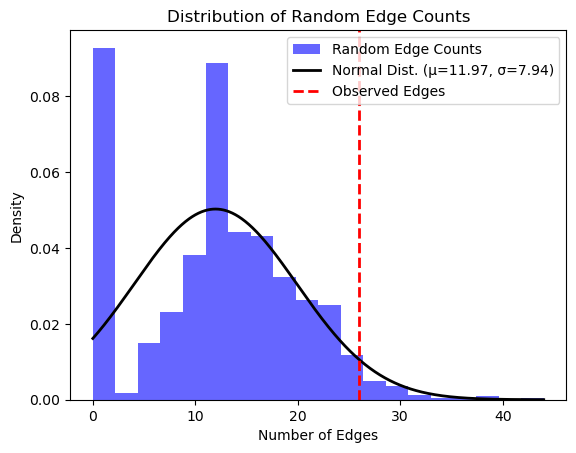

z score for a random nodes: 1.7665339755124099

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005669/associations?projection=associationByLocation
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PMF1%0dSLC25A44%0dNR%0dOR52E4%0dFAM160A1&species=9606

Proteins: 5

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retr

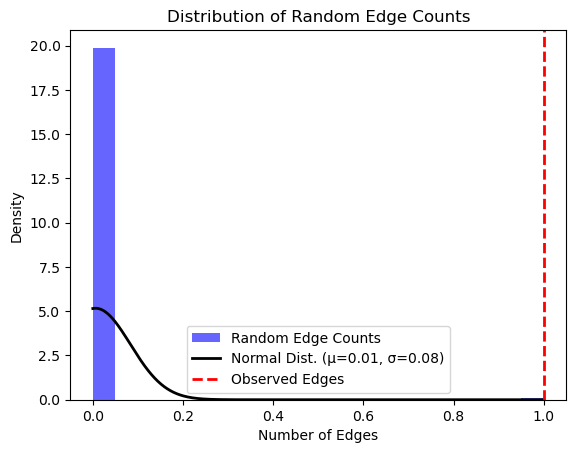

z score for a random nodes: 12.871156384205213

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005782/associations?projection=associationByLocation
Genes: 71

%0dSFI1%0dDAOA%0dC22orf30%0dSV2B%0dEIF4ENIF1%0dPLXNA4%0dCCBE1%0dWBSCR17%0dHLA-A29.1%0dHCG9%0dCNTNAP2%0dZNF318%0dCRIP3%0dSLC22A7%0dCUL9%0dDNPH1%0dTTBK1%0dISG20%0dTRIOBP%0dCCDC17%0dLMX1A%0dSPTBN1%0dFLJ46066%0dCLRN2%0dARHGEF28%0dABLIM3%0dHLA-DRB1%0dSNAP91%0dEYA4%0dSYNJ2%0dGRB10%0dSLC26A5%0dATP6V0A4%0dAGO2%0dCDH23%0dEXOC6%0dCTBP2%0dTUB%0dTYR%0dPHLDB1%0dLMO7%0dNID2%0dTBC1D24%0dACADVL%0dTBX2%0dFBF1%0dFSCN2%0dTMPRSS9%0dSLC4A11%0dTMPRSS3%0dBAIAP2L2%0dKLHDC7B%0dWDR3%0dILDR1%0dABCC10%0dCHMP4C%0dSH2D4B%0dC10orf90%0dMPZL2%0dLOXHD1%0dCCDC68%0dACAN&species=9606

Proteins: 67

Number of edges: 8

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests f

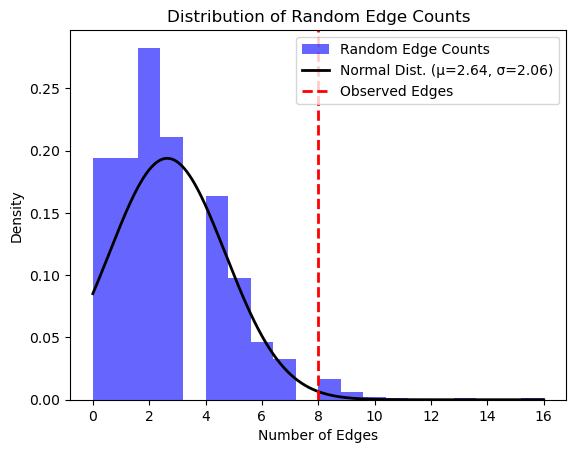

z score for a random nodes: 2.6025239471748827

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005178/associations?projection=associationByLocation
Genes: 29

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=COG5%0dDOT1L%0dMCF2L%0dNR%0dGNL3%0dGLT8D1%0dCDC5L%0dSUPT3H%0dFTO%0dCAMK2B%0dDNAH10%0dNACA2%0dNCOA3%0dIFRD1%0dALDH1A2%0dDUS4L%0dTGFA%0dSLC30A10%0dLYPLAL1%0dCHADL%0dCOMP%0dRFLNA%0dMAPT%0dLRRC37A4P%0dMAPK8IP1P2%0dRP1L1%0dMIR4286%0dKANSL1%0dLRRC37A&species=9606

Proteins: 26

Number of edges: 5

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api

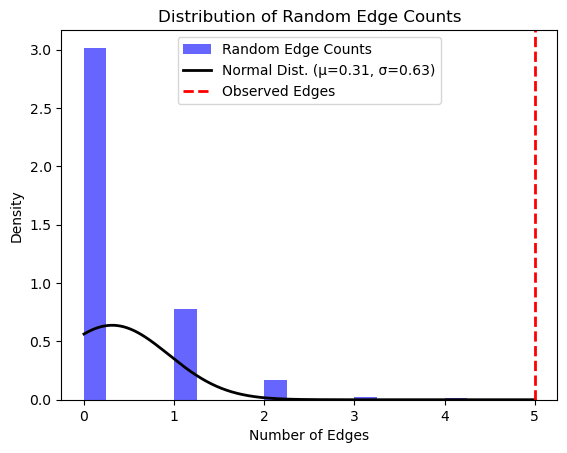

z score for a random nodes: 7.495305851048206

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005678/associations?projection=associationByLocation
Genes: 10

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ABCC9%0dNEK11%0dintergenic%0dKCNMB2%0dSORCS2%0dACBD7%0dNELL1%0dKIRREL3%0dSUDS3%0dDCUN1D3&species=9606

Proteins: 10

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://strin

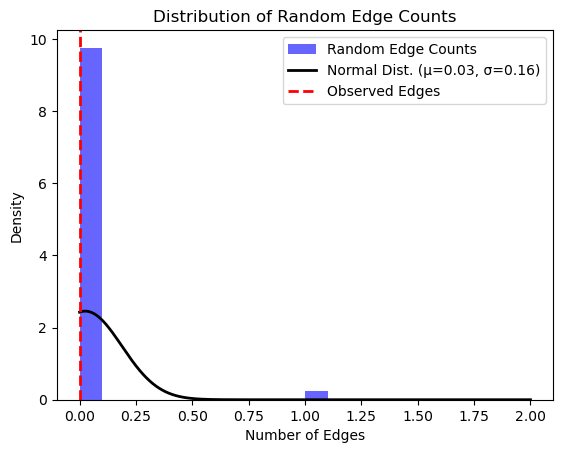

z score for a random nodes: -0.15393726795176982

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004975/associations?projection=associationByLocation
Genes: 360

%0dCDON%0dCUGBP2%0dFBXL7%0dCACNA2D3%0dSUZ12P1%0dINPPD5%0dPRRC2C%0dFMN2%0dDMXL1%0dMEGF10%0dFLJ33630%0dSAP30L%0dNKAIN2%0dPDE7B%0dPLEKHG1%0dBZW2%0dTSPAN13%0dCYCS%0dELMO1%0dLIMS2%0dMOBP%0dCTNNA2%0dAFF1%0dANKRD55%0dPGAM5P1%0dMAN2A1%0dCAMK4%0dEXOC4%0dCSMD1%0dST18%0dNCS1%0dPPAPDC1A%0dRRAS2%0dPSMA1%0dSPON1%0dARHGAP20%0dSLC4A8%0dCRADD%0dANO4%0dCLMN%0dGABRG3%0dLIPC%0dFLJ45256%0dVAT1L%0dCACNA1G%0dOSBPL7%0dSP6%0dMRPL10%0dBCAS3%0dLOC390956%0dTGM6%0dPARVB%0dHECW1%0dGRIN2B%0dKIAA0743%0dRP11-242G20.2%0dRP11-572M11.4%0dRIMBP2%0dVSNL1%0dMPP7%0dRP11-291J9.2%0dSLC2A9%0dAP003097.1%0dAC015804.1%0dIntergenic%0dHTR7%0dSMEK1%0dDKFZP434H0512%0dFOXE1%0dGRIN3A%0dZNF599%0dC6orf203%0dKCNN2%0dCDKAL1%0dCDC5L%0dDST%0dSIK1%0dZNF273%0dMLK4%0dDDX18&species=9606PMS2CL%0dZNF12%0dTHSD7A%0dTMEM106B%0dNFIC%0dTUSC1%0dZNF292%0dCDC42EP3%0dUTS2D%0dPA

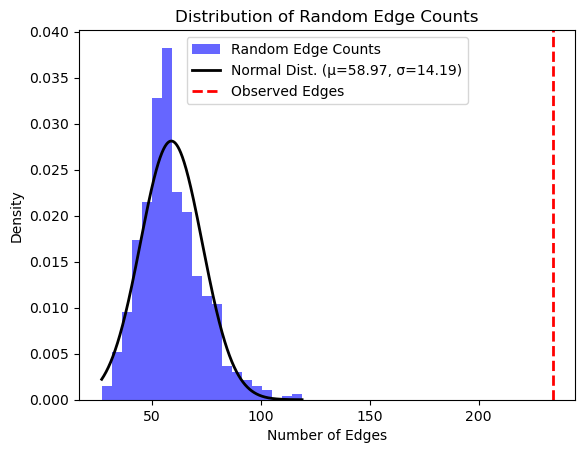

z score for a random nodes: 12.336119118979862

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003888/associations?projection=associationByLocation
Genes: 410

CNNM2%0dCCDC68%0dMHC region%0dODZ4%0dHDAC4%0dMGC16025%0dPPP2R2B%0dFAM155A%0dSLC35F2%0dRAB39%0dAS3MT%0dMAP4K4%0dIL1R2%0dDPYD%0dMIR137%0dNTRK3%0dELTD1%0dITIH3%0dTCF4%0dCACNB2%0dGRIN2A%0dKIF5C%0dLYPD6B%0dZNF804A%0dANO5%0dSLC17A6%0dZMIZ1%0dGRIK1%0dSEMA3A%0dIFI44L%0dIFI44%0dSLC45A1%0dRERE%0dENO1%0dDCP1B%0dCACNA1C%0dANK3%0dSMARCA2%0dMMP16%0dSYNE1%0dZFPM2%0dBANK1%0dLRRC7%0dSTIP1%0dFERMT3%0dTRPT1%0dBCL11A%0dGRM5%0dTMX3%0dARSB%0dGRIK4%0dNCL%0dTCEB1%0dSHFM1%0dTNFRSF10A%0dCHMP7%0dTNFRSF10D%0dLOXL2%0dMLIP%0dMAD1L1%0dSTIM1%0dPTPRF%0dSPAG16%0dSORCS3%0dRNF219-AS1%0dSGO1-AS1%0dLINC00461%0dLINC01288%0dDUSP6%0dCADPS2%0dFOXP2%0dCAMTA1%0dPTCHD2%0dSKINTL%0dSLC5A9%0dPRELP%0dFMOD%0dIL19%0dIL10%0dTEX41%0dAPELA%0dOR2J2%0dOR14J1%0dKDELR2%0dDAGLB%0dPOU6F2%0dYAE1D1%0dNUPR1L%0dSLC28A3%0dCCDC3%0dCAMK1D%0dTENM4%0dLINC00424%0dLINC00540%0dDLE

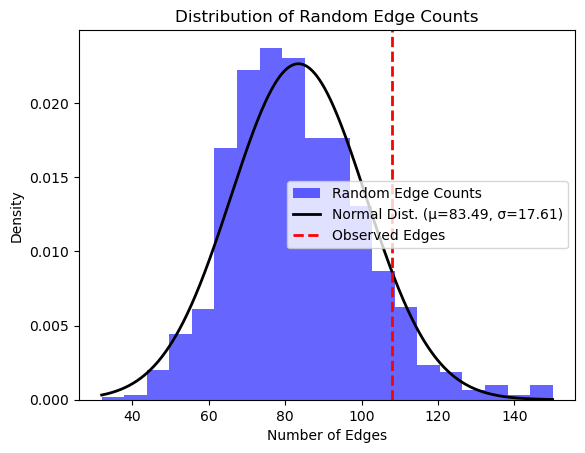

z score for a random nodes: 1.3917096074288322

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004265/associations?projection=associationByLocation
Genes: 46

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=OSBPL10%0dintergenic%0dMAPK10%0dLOC388882%0dIGLL1%0dSH2B3%0dATXN2%0dSYTL3%0dCSMD3%0dEDNRA%0dHDAC9%0dIPO5%0dRAP2A%0dNR%0dCNNM1%0dRGL1%0dWWOX%0dMACF1%0dHABP2%0dUTRN%0dBMP8A%0dMTHFD1L%0dNUTM2F%0dDHS%0dCOG6%0dNSMCE1%0dPTDSS1%0dCELSR2%0dSORT1%0dF5%0dHLA-B%0dLPA%0dIL6%0dLPL%0dCDKN2B-AS1%0dABO%0dTCF7L2%0dCREB3L1%0dMMP3%0dRP11-359M6.3%0dPTPN11%0dCOL4A1%0dSMOC1%0dCHRNA3%0dLOC732538%0dLDLR&species=9606

Proteins: 42

Number of edges: 8

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to ret

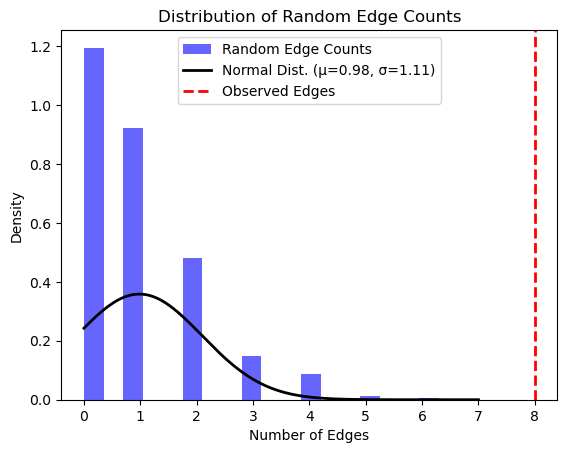

z score for a random nodes: 6.304729807821004

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001645/associations?projection=associationByLocation
Genes: 423

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ADAMTS7%0dSORT1%0dANRIL%0dCDKN2A%0dCDKN2B%0dCDKN2BAS%0dPHACTR1%0dLDLR%0dSMARCA4%0dKCNE2%0dZC3HC1%0dTCF21%0dWDR12%0dPPAP2B%0dMRAS%0dSMG6%0dRASD1%0dPEMT%0dRAI1%0dABO%0dLPL%0dZNF259%0dAPOA1%0dAPO5A%0dSH2B3%0dEDNRA%0dNT5C2%0dCNNM2%0dCYP17A1%0dSLC22A3%0dLPAL2%0dLPA%0dCXCL12%0dCOL4A1%0dCOL4A2%0dANKS1A%0dMIA3%0dLIPA%0dNOA1%0dREST%0dNOS3%0dSMAD3%0dMFGE8%0dABHD2%0dBCAS3%0dPMAIP1%0dMC4R%0dPOM121L9P%0dADORA2A%0dZNF507%0dLOC400684%0dKSR2%0dSWAP70%0d9p21%0dPLG%0dATP2B1%0dPDGFD%0dAPOE%0dAPOC1%0dTRIB1%0dFURIN%0dFES%0dKIAA1462%0dHDAC9%0dVAMP5%0dVAMP8%0dGGCX%0dIL6R%0dZEB2%0dACO74093.1%0dGUCY1A3%0dHHIPL1%0dAK097927%0dKCNK5%0dPCSK9%0dPLCL1%0dKCNAB1%0dDCLK2%0dITGA1%0dIntergenic%0dTRPA1%0dC9orf84%0dintergenic%0dADCY3%0dCENPO%0dDYNC2LI1%0dPLEKH

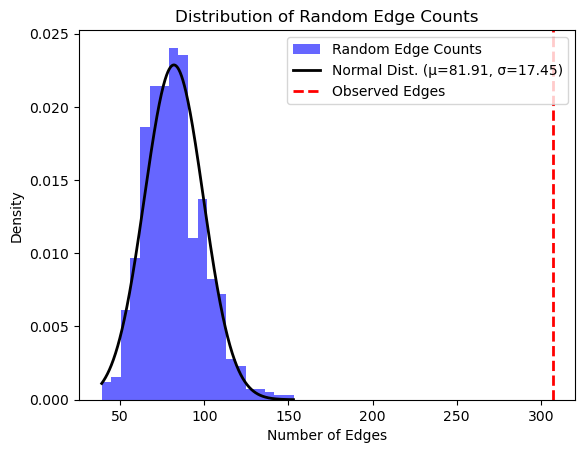

z score for a random nodes: 12.897934788911895

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004570/associations?projection=associationByLocation
Genes: 98

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SLCO1B3%0dUGT1A1%0dG6PD%0dCLGN%0dELMOD2%0dSLC22A18%0dKRCC1%0dHIST1H2BC%0dintergenic%0dSEMA3C%0dARHGEF7%0dLST-3TM12%0dSLCO1B1%0dSLCO1A2%0dERCC4%0dAC073072.5%0dRNU7-62P%0dKLHL1%0dRP11-648C16.1%0dAC013262.1%0dRP5-837I24.4%0dAC068954.1%0dRP11-58O3.2%0dUGT1A10%0dUGT1A%0dLOC339766%0dUSP40%0dC8orf42%0dLST3%0dCCDC19%0dDCHS2%0dORMDL1%0dDGKD%0dC21orf49%0dPLA2R1%0dZMYND8%0dKCNH5%0dFGF14%0dST3GAL1%0dTMEM18%0dRUNX3%0dPITPNC1%0dMROH2A%0dUGT1A9%0dHJURP%0dUGT1A7%0dUGT1A8%0dUGT1A13P%0dUGT1%0dUGT1A6%0dUGT1A4%0dUGT1A5%0dUGT1A3%0dUGT%0dLOC100286922%0dUGT1A12P%0dUGT1A11P%0dRPL17P11%0dRPL1%0dDNAJB3%0dUGT1A2P%0dNR%0dATG16L1%0dFRMD6-AS2%0dLOC105375238%0dF2RL1%0dLOC105378465/SORCS3%0dLOC105374525%0dCOL4A2%0dIGSF21%0dLOC105376605%0dCBLN2%0dASIC2%0d

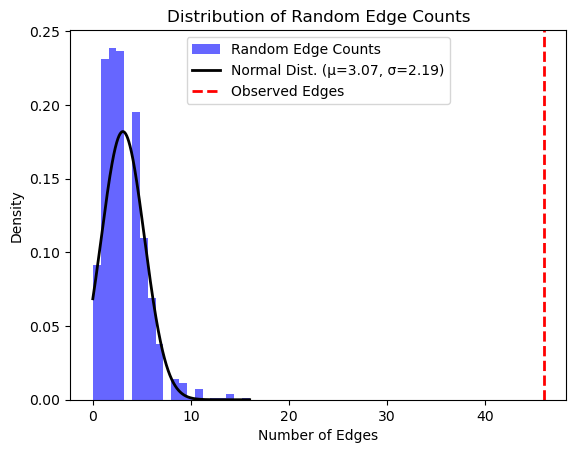

z score for a random nodes: 19.572874351135944

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004534/associations?projection=associationByLocation
Genes: 50

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CD163%0dCKM%0dLILRB5%0dBIN1%0dLOC101926940%0dLINC00603%0dBVES%0dABO%0dGAB2%0dSAMD4A%0dLOC100996291%0dSOCS3%0dMKL1%0dANO5%0dNR%0dCSF1%0dIQGAP3%0dGCKR%0dC2orf16%0dNEB%0dCAND2%0dLINC01094%0dHBEGF%0dLOC101927697%0dEBF1%0dRFX6%0dVGLL2%0dSNX13%0dUBAP1%0dMYPN%0dBORCS7-ASMT%0dCNNM2%0dFAM175B%0dZRANB1%0dAKAP6%0dPSMA6%0dNFKBIA%0dNMB%0dPSMD3%0dCSF3%0dAPOH%0dPEPD%0dBACH1%0dHORMAD2%0dSPANXN3%0dSLITRK4%0dCPN1%0dAPOBEC1%0dKLF5%0dLINC00392&species=9606

Proteins: 43

Number of edges: 6

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-

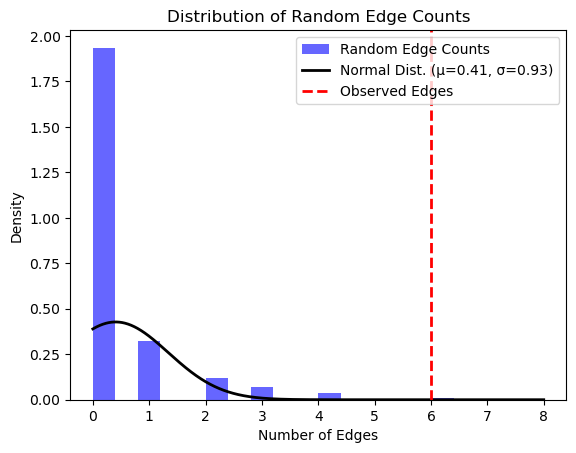

z score for a random nodes: 5.9951112435058125

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000474/associations?projection=associationByLocation
Genes: 65

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CAMSAP1L1%0dNR%0dGSTA4%0dPTPRD%0dARHGAP11B%0dC1orf94%0dintergenic%0dSCN1A%0dSNX11%0dSKAP1%0dCDK5RAP3%0dPNPO%0dATAD4%0dCOPZ2%0dhsa-mir-152%0dNFE2L1%0dCBX1%0dPLA2G4A%0dZEB2%0dCHRM3%0dMAST4%0dPCDH7%0dGOLIM4%0dGABRA2%0dBCL11A%0dFANCL%0dSCN3A%0dSCN2A%0dTTC21B%0dHEATR3%0dBRD7%0dEPHB1%0dHACE1%0dHDAC9%0dTNS3%0dMIR548H4%0dC9orf92%0dBNC2%0dIFNA6%0dLOC100506422%0dGFRA1%0dCCDC172%0dXR_246024.1%0dLINC00558%0dWDR89%0dADPGK-AS1%0dCRAMP1L%0dTMEM204%0dIFT140%0dHN1L%0dCOTL1%0dNDUFV2%0dLOC100505776%0dLOC101927537%0dDNAJC5B%0dPDE7A%0dABRA%0dPTCHD3%0dSYT2%0dCUX2%0dLINC02356%0dBRAP%0dALDH2%0dNAA25%0dRPH3A&species=9606

Proteins: 55

Number of edges: 4

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/a

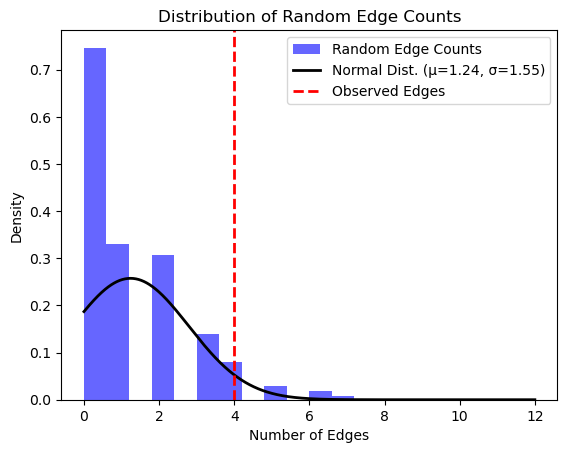

z score for a random nodes: 1.7814238934492752

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003095/associations?projection=associationByLocation
Genes: 50

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=COL13A1%0dLTBP3%0dEHBP1L1%0dEFCAB4B%0dFARP1%0dintergenic%0dFDFT1%0dST8SIA1%0dCACNA2D1%0dPNPLA3%0dC10orf122%0d23231%0dMACROD2%0dSLC9A9%0dSLC46A3%0dPTPRU%0dPARVB%0dSAMM50%0dDCLK1%0dNGF%0dZP4%0dPZP%0dDDX60L%0dPALLD%0dYIPF1%0dHS3ST1%0dLPPR4%0dGC%0dLCP1%0dSLC38%0dA8%0dMARC1%0dFAM107B%0dTRIB1%0dZNF101%0dCOMMD1%0dFAM171A1%0dNR%0dTM6SF2%0dZNF512%0dGPN1%0dMUM1%0dC2orf16%0dGCKR%0dGATAD2A%0dNCAN%0dAPOE%0dFTO%0dLPL%0dSUGP1&species=9606

Proteins: 49

Number of edges: 10

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/t

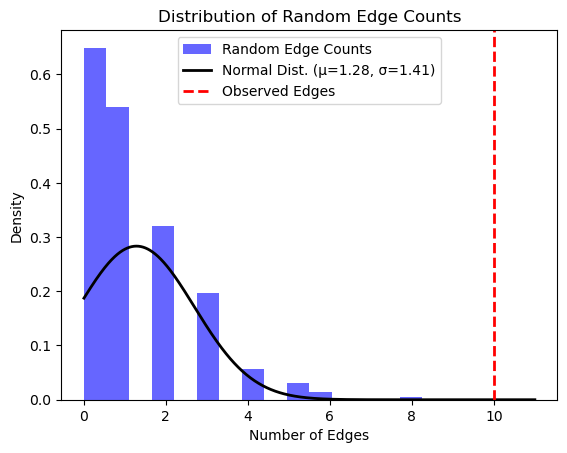

z score for a random nodes: 6.190013201955711

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001378/associations?projection=associationByLocation
Genes: 54

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DNAH11%0dULK4%0dDTNB%0dNR%0dCCND1%0dMYNN%0dTERC%0dPSORS1C1%0dCCHCR1%0dTCF19%0dPOU5F1%0dCDSN%0dTNFRSF13B%0dCBX7%0dELL2%0dTOM1%0dASXL2%0dLRRC34%0dPSORS1C2%0dHLA%0dCDCA7L%0dDTNBP1%0dJARID2%0dATG5%0dPRDM1%0dSMARCD3%0dCHPF2%0dCCAT1%0dCDKN2A%0dp16INK4A%0dWAC%0dRFWD3%0dPREX1%0dIntergenic%0dACTRT3%0dPRR14%0dSRCAP%0dRP11-146F11.1%0dBCL2L11%0dEOMES%0dIRF4%0dBAK1%0dGRAMD1B%0dSP110%0dLPP%0dPVT1%0dBMF%0dIRF8%0dNCAPH2%0dNCK1%0dMYH11%0dFOPNL%0dABCC1%0dABCC6&species=9606

Proteins: 50

Number of edges: 20

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for u

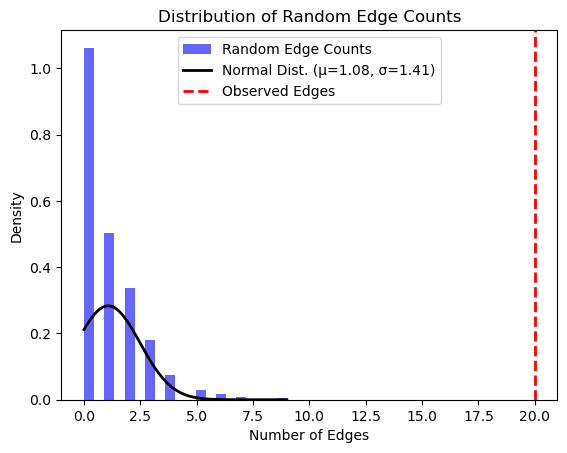

z score for a random nodes: 13.437573650027392

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004274/associations?projection=associationByLocation
Genes: 143

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ABCG2%0dSLC2A9%0dSLC22A11%0dA2BP1%0dABCA1%0dABCC8%0dABCC9%0dABCG1%0dALX4%0dATP1A4%0dBDKRB2%0dCACNA2D3%0dCarboxyl peptidase E%0dCFTR%0dCYP2C8%0dCYP2E1%0dFSTL4%0dFOXA2%0dHGF%0dJAZF1%0dLHFPL3%0dLIPC%0dPDE1C%0dPRKCA%0dPPARD%0dPPARGC1%0dPTPRD%0dRARB%0dSLC13A3%0dSLC22A1%0dSLC22A18AS%0dTPST1%0dTRPA1%0dVDR%0dWNT5B%0dALDH16A1%0dNR%0dMYL2%0dCUX2%0dGCKR%0dCNIH-2%0dMAP3K11%0dRFX3%0dKCNQ1%0dBCAS3%0dFAM35A%0dNIPAL1%0dHIST1H2BF%0dHIST1H4E%0dSLC22A12%0dSLC17A1%0dSLC17A4%0dSLC16A9%0dSFMBT1%0dMUC1%0dGALNTL5%0dPKD2%0dNAP1L5%0dALDH2%0dSHLD2%0dPIBF1%0dACSM2B%0dARID5B%0dTOLLIP%0dAS1%0dBRSK2%0dMLXIP%0dPDZK1%0dTACR1%0dEVA1A%0dLOC100128993%0dSLC38A1%0dMTX1%0dLRP2%0dHAGLR%0dIntergenic%0dWDR1%0dCLNK%0dLOC105377323%0dMEPE%0dSPP1%0dPPM1K-DT%0dADH1B%0

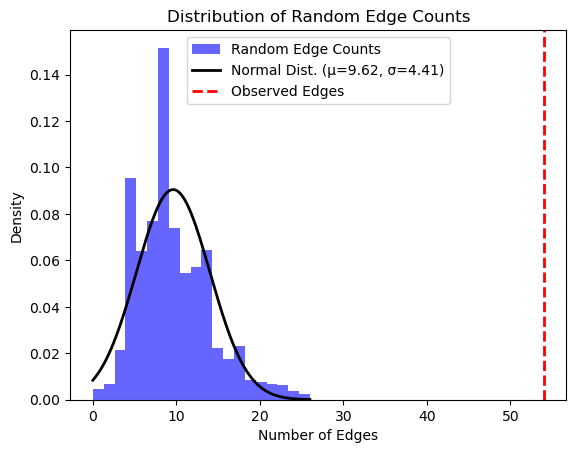

z score for a random nodes: 10.064635261197205

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004251/associations?projection=associationByLocation
Genes: 22

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=JAK2%0dEGFEM1P%0dMECOM%0dHBS1L%0dMYB%0dGATA2%0dSCHIP1%0dKPNA4%0dTET2%0dTERT%0dNUDT3%0dHMGA1%0dMKLN1%0dGFI1B%0dATM%0dSH2B3%0dATXN2%0dMRPS31%0dZNF521%0dRUNX1%0dCHEK2%0dHSCB&species=9606

Proteins: 21

Number of edges: 12

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Random edges calculation completed.



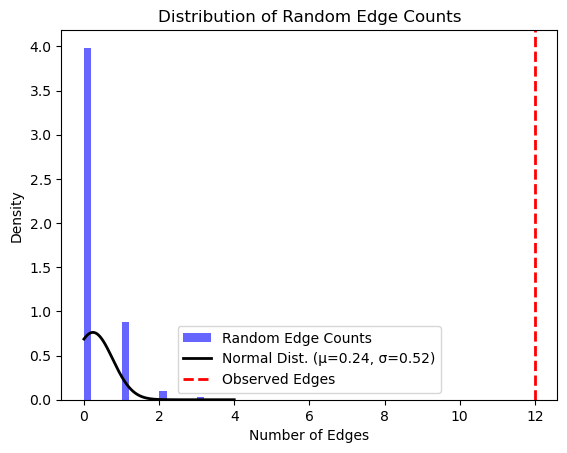

z score for a random nodes: 22.47319826262625

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006882/associations?projection=associationByLocation
Genes: 24

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=LINC00968%0dPENK%0dCCDC7%0dC10orf68%0dITGB1%0dNR%0dSTK32B%0dCLIP2%0dGTF2IRD1%0dSTPG2%0dRAP1GDS1%0dARHGAP26%0dLINC01844%0dAC005592.3%0dMKI67%0dCRY1%0dLINC00400%0dPTPN21%0dLOC107984782%0dSLC38A7%0dRASSF2%0dTSPEAR%0dLL21NC02-1C16.2%0dPOFUT2&species=9606

Proteins: 17

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-he

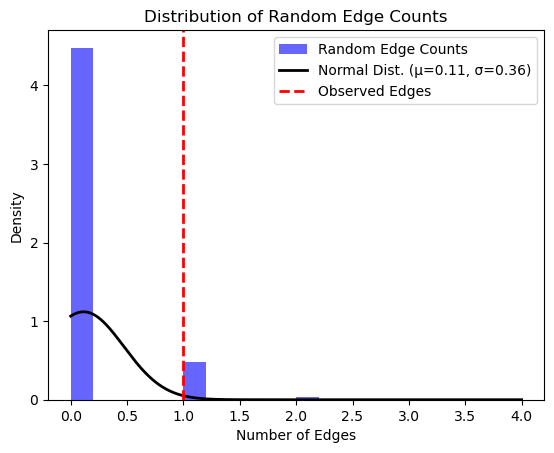

z score for a random nodes: 2.4861368009174023

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000656/associations?projection=associationByLocation
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PRNP%0dGRM8%0dSTX6%0dGAL3ST1%0dBMERB1&species=9606

Proteins: 5

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retriev

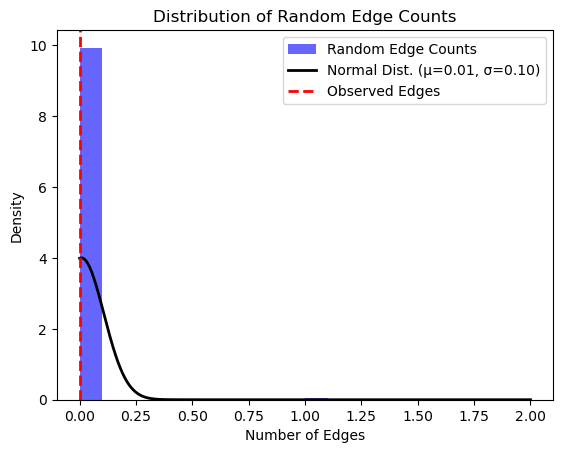

z score for a random nodes: -0.0802572353905128

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_1000651/associations?projection=associationByLocation
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PCDH9%0dSCAPER%0dTHEMIS%0dNBAS%0dGATA3&species=9606

Proteins: 5

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retri

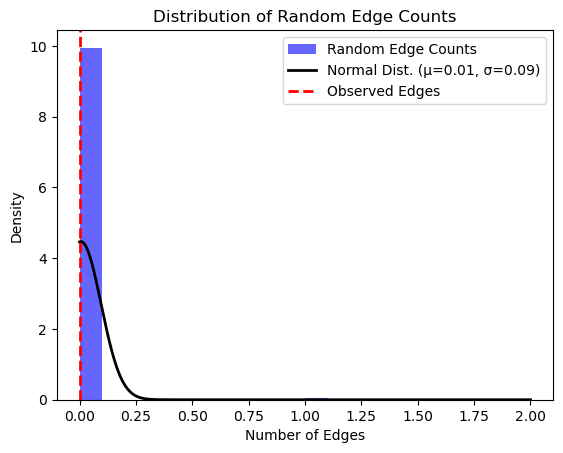

z score for a random nodes: -0.06723348523552919

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005147/associations?projection=associationByLocation
Genes: 273

%0dTNP2%0dPRM3%0dC16orf75%0dCTLA4%0dHLA%0dIL2RA%0dC12orf30%0dERBB3%0dCLEC16A%0dPTPN2%0dEDG7%0dGLIS3%0dRASGRP1%0dUBASH3A%0dINS%0dIFIH1%0dCAPSL%0dIL7R%0dKIAA0350%0dCD226%0dAFF3%0dLOC150577%0dHLA-DRB1%0dIL2%0dSH2B3%0dIL10%0dC6orf173%0dCOBL%0dC10orf59%0dCD69%0dIL27%0dORMDL3%0dPGM1%0dMHC%0dCDK2%0dRAB5B%0dSUOX%0dIKZF4%0dCUX2%0dADAD1%0dIGF2AS%0dTYK2%0dIL2RB%0dLMO7%0dEFR3B%0d3NCOA1%0dC2orf79%0dCENPO%0dADCY3%0dDNAJC27%0dPOMC%0dDNMT3A%0dWDR27%0dC6orf120%0dPHF10%0dTCTE3%0dC6orf208%0dLOC154449%0dDLL1%0dFAM120B%0dPSMB1%0dTBP%0dPCD2%0dLOC100128081%0dTNFRSF11B%0dFOSL2%0dNR%0dDIO3%0dDLK1%0dMEG3%0dRTL1%0dTRAFD1%0dPTPN11%0dLNK%0dICOSLG%0dIntergenic%0dCCR5%0dIL21%0dIKZF1%0dGPR183%0dDEXI%0dBCAR1%0dIKZF3%0dGSDMB%0dCCR7%0dFUT2%0dC1QTNF6%0dRAC2%0dBTN3A1%0dGATA3%0dHLA-DQB1%0dCENPW%0dRNLS%0dSTK39%0dLRP1B%0dCOBL/LOC100129427/GRB10%

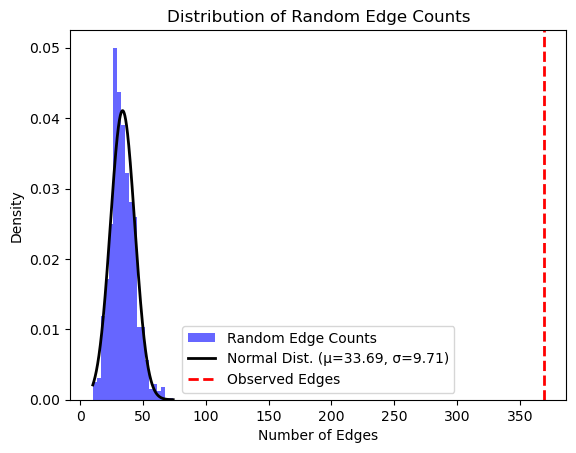

z score for a random nodes: 34.515276021812355

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005045/associations?projection=associationByLocation
Genes: 3

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA%0dHLA-DRB1%0dHLA-DQA1&species=9606

Proteins: 3

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering

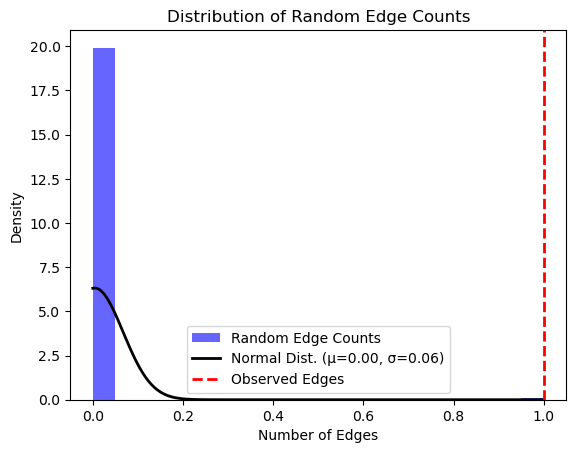

z score for a random nodes: 15.7797338380595

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005080/associations?projection=associationByLocation
Genes: 9

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SCGB1A1%0dAHNAK%0dASRGL1%0dAPIP%0dEHF%0dTRIM46%0dTP63%0dintergenic%0dACVR1B&species=9606

Proteins: 9

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv

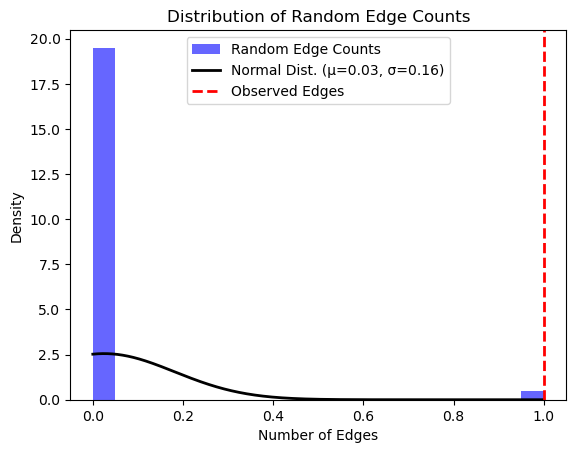

z score for a random nodes: 6.244997998398398

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005081/associations?projection=associationByLocation
Genes: 12

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SFTPD%0dATP2C2%0dRP11-369J21.2%0dRP11-369J21.4%0dRP11-369J21.6%0dRP11-369J21.5%0dANXA11%0dHLA-C%0dFGFR3P%0dRP11-479O17.4%0dPSORS1C1%0dCCHCR1&species=9606

Proteins: 6

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Cli

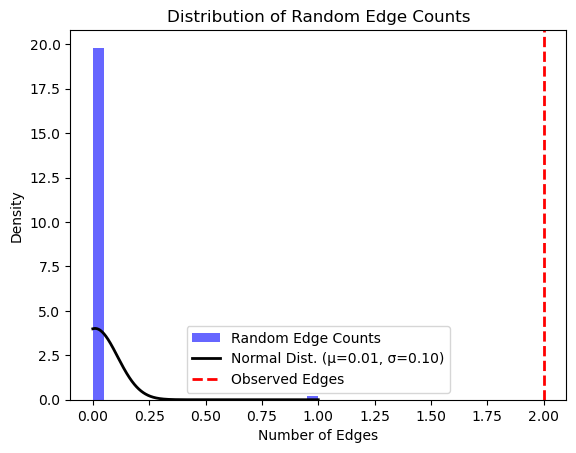

z score for a random nodes: 20.00025252365832

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004682/associations?projection=associationByLocation
Genes: 168

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NOS1AP%0dKCNQ1%0dGINS3%0dNDRG4%0dSLC38A7%0dGOT2%0dCNOT1%0dc6orf204%0dSLC35F1%0dPLN%0dASF1A%0dNPHP4%0dCHDS%0dACOT7%0dPLEKHG5%0dKLH21%0dRNF207%0dKCNH2%0dLITAF%0dTNFRSF17%0dCLEC16A%0dSNN%0dZC3H7A%0dSCN5A%0dLIG3%0dRFFL%0dintergenic%0dTCL6%0dARHGAP10%0dLOC100132805%0dPTPRG%0dPDE3A%0dTTN%0dELMO1%0dATP1B1%0dKCNJ2%0dOLFML2B%0dC6orf204%0dSLC8A1%0dRPL21%0dTBX5%0dKCNE1%0dDPP6%0dFGFBP2%0dLDB2%0dLOC647020%0dROS1%0dGNAL%0dGABPAP%0dCAMK1D%0dCREBBP%0dADAMTSL1%0dDPH5%0dCCND2%0dCNTNAP2%0dPOU3F2%0dSKCG-1%0dLRFN5%0dRPSAP1%0dAACP%0dFASTKD2%0dFBX028%0dNR%0dMKL2%0dPRKCA%0dNUCKS1%0dNKD2%0dNSUN5C%0dC7orf51%0dSRL%0dYPEL2%0dTCEA3%0dSP3%0dCCDC141%0dSPATS2L%0dSCN10A%0dC3ORF75%0dSLC4A4%0dSMARCAD1%0dGFRA3%0dGMPR%0dCAV1%0dNCOA2%0dLAPTM4B%0dAZIN1%0dGBF1%0

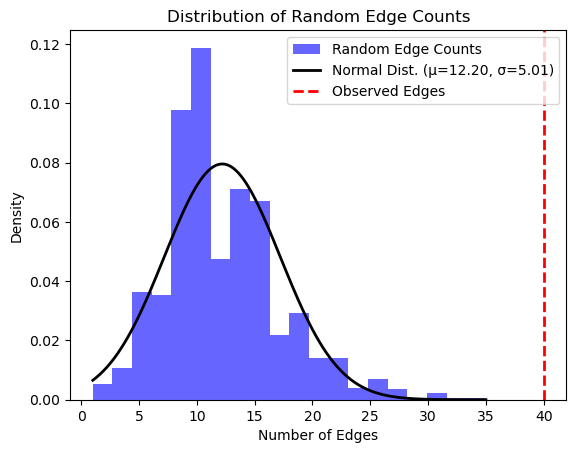

z score for a random nodes: 5.546710665797813

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0004985/associations?projection=associationByLocation
Genes: 536

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CLTA%0dGNE%0dRNF38%0dGLIPR2%0dRECK%0dLINC01121%0dSRBD1%0dROR2%0dNFIL3%0dAUH%0dMIR3910%0dintergenic%0dANTXR2%0dPCAT4%0dADM%0dMYO18B%0dIFT88%0dANXA1%0dNPAS3%0dSP8%0dST8SIA2%0dC15orf32%0dSDCCAG8%0dITIH1%0dMHC%0dMAD1L1%0dCSMD1%0dNR%0dCDH23%0dFBXL17%0dLOC100287612%0dMARCKS%0dTRIM42%0dMCTP2%0dSEPHS1P2%0dTCF7L2%0dTMEM132B%0dWWOX%0dGYPA%0dMIR4778%0dAPOB%0dPER4%0dAC096669.1%0dSLC25A26%0dRP11-250B2.3%0dTRANK1%0dCACNA1C%0dPIK3C2A%0dIFI44L%0dSNAP91%0dPRSS35%0dLBA%0dNUMB%0dFBLN2%0dATP6V1H%0dGNL3%0dPBRM1%0dWSC domain containing 1%0dMYOM3%0dAKR1D1%0dKIF5B%0dBASP1%0dTMEM217%0dINPP4A%0dCRYBB2P1%0dother genes%0dSPTLC1%0dKCNMB2%0dNLRC5%0dMSRA%0dNMUR2%0dCOMMD10%0dZDBF2%0dGPR1%0dADAM23%0dNCAN%0dDPY19L3%0dRPGRIP1L%0dDGKH%0dNF1A%0dCTNNA2%0dNEK

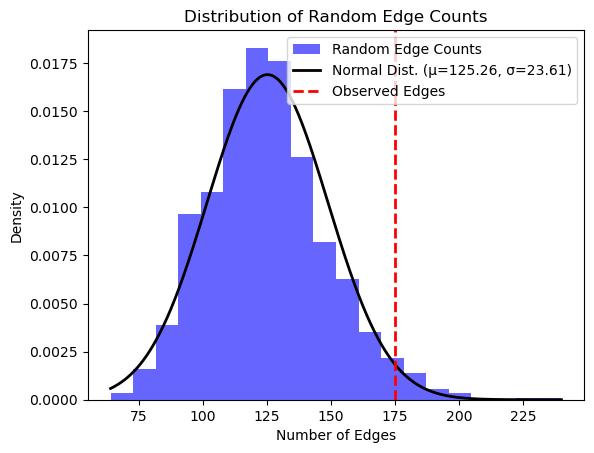

z score for a random nodes: 2.106897687924965

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0001073/associations?projection=associationByLocation
Genes: 117

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SOX6%0dFTO%0dMRPS22%0dPAX5%0dMC4R%0dPTER%0dMAF%0dNPC1%0dPRL%0dTMEM18%0dNEGR1%0dPRKCH%0dLEPR%0dPACS1%0dRMST%0dCCDC77%0dOTUD1%0dKIAA1217%0dSLC8A1%0dSCNN1A%0dFARS2%0dNINJ1%0dTCF4%0dFOXF1%0dPRMT6%0dTBCE%0dTFAP2B%0dMSRA%0dLYPLAL1%0dZNF248%0dITPR3%0dTRAM1L1%0dMUC15%0dFBN2%0dRARB%0dRAFTLIN%0dPRF1%0dC20orf133%0dMLN%0dFLJ20309%0dRTN4%0dUBE2E3%0dFAT1%0dMTNR1A%0dASAH1%0dLHFPL3%0dWWOX%0dPITPNB%0dNCAM2%0dPCDH9%0dINHBB%0dARG1%0dNRXN3%0dLRRFIP1%0dIRS1%0dSPRY2%0dLINGO2%0dSH2B1%0dOLFM4%0dLOC144233%0dETV5%0dSEC16B%0dRPL27A%0dGIPR%0dRABEP2%0dC5orf37%0dBDNF%0dGPRC5B%0dGNPDA2%0dFANCL%0dADCY3%0dPOMC%0dMAP2K5%0dTNNI3K%0dHNF4G%0dRPTOR%0dCADM2%0dGNAT2%0dZZZ3%0dMRPS33P4%0dADCY9%0dHS6ST3%0dCAMK1G%0dRGS6%0dFLJ39743%0dALPK1%0dBC041448%0dHOXB5%0dKC6%0d

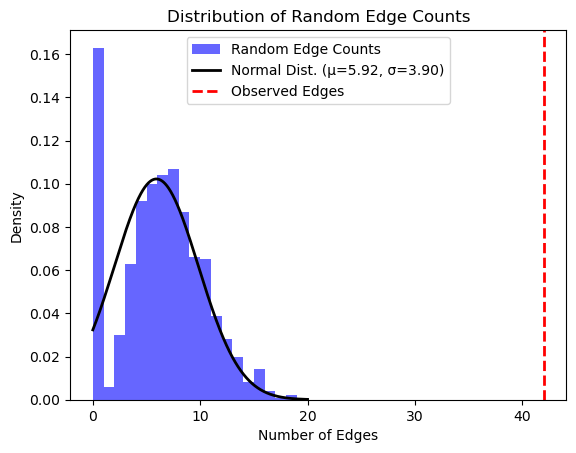

z score for a random nodes: 9.24532708510887

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006333/associations?projection=associationByLocation
Genes: 10

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=intergenic%0dTF%0dHFE%0dTFR2%0dTMPRSS6%0dTFRC%0dERFE%0dHBS1L%0dDUOX2%0dFFAR2&species=9606

Proteins: 10

Number of edges: 9

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/

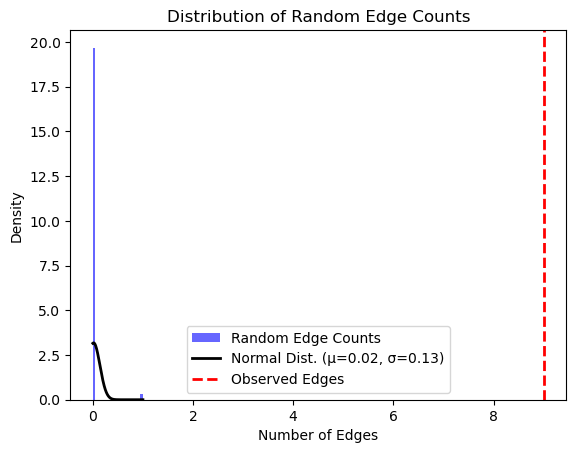

z score for a random nodes: 71.59986487701288

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006332/associations?projection=associationByLocation
Genes: 33

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TMPRSS6%0dHFE%0dTFR2%0dintergenic%0dTF%0dLOC102467081%0dNCKAP5%0dMIR3679%0dLOC101927620%0dMIR5580%0dDTWD2%0dNR%0dLRRC16A%0dSCGN%0dHIST1H2BH%0dHIST1H3G%0dNOTCH4%0dHLA-DQB1%0dFIG4%0dZDHHC14%0dZFAT%0dDNMT3B%0dERG%0dAC104820.2%0dLEPR%0dIL6R%0dERFE%0dLRIG1%0dHBS1L%0dIKZF1%0dDUOX2%0dABCA5%0dFFAR2&species=9606

Proteins: 28

Number of edges: 8

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many

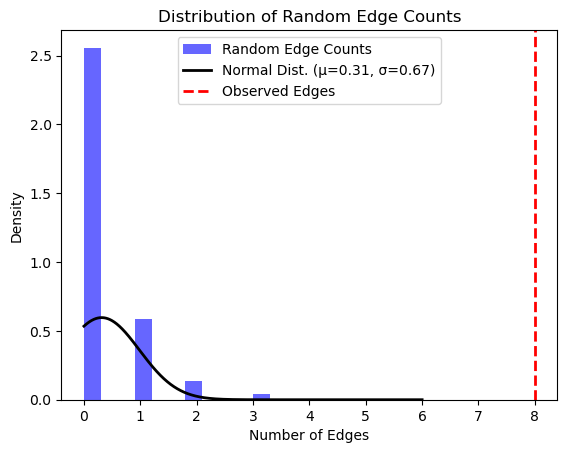

z score for a random nodes: 11.490804845149324

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000183/associations?projection=associationByLocation
Genes: 78

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=MICB%0dHLA-DRA%0dERAP1%0dIL13%0dNR%0dEOMES%0dHBS1L%0dMYB%0dREL%0dPVT1%0dGATA3%0dHLA class II%0dHLA class I%0dintergenic%0dTCF3%0dCLSTN2%0dCLEC16A%0dLPP%0dPTPRK%0dAHI1%0dITPR3%0dUQCC2%0dIP6K3%0dOLIG3%0dTNFAIP3%0dPOU2AF1%0dMAPK3%0dCORO1A%0dNCOA5%0dCD40%0dPTPN22%0dCACNA1I%0dSTAB1%0dZNF526%0dCPLANE1%0dDLK1%0dRTN4RL2%0dPGRMC1%0dSH3BP2%0dISLR%0dTMEM169%0dCDCP2%0dOPN1SW and CALU%0dPRR12%0dESYT3%0dTM7SF3%0dAOPEP%0dLGI4%0dSHANK2%0dSLC18A3 and CHAT%0dMYOD1%0dKRT39 and LOC107985072%0dFCGBP%0dKIF16B%0dTEX55 and IGSF11%0dSERPINF2%0dATP13A5 and ATP13A5-AS1%0dACE%0dMAGEC1%0dZNF823%0dC19orf57%0dACSM3 and ERI2%0dARHGEF28%0dMEGF11%0dDECR2%0dBCL2L11%0dDTNB%0dULK4%0dTERC%0dIRF4%0dBAK1%0dGRAMD1B%0dSP110%0dELL2%0dBMF%0dIRF8%0dNCAPH2%0dNCK1&spec

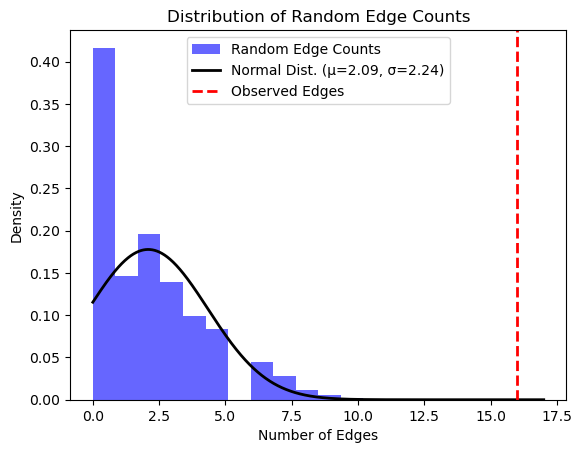

z score for a random nodes: 6.2001537690863

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0011382/associations?projection=associationByLocation
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=BCL11A%0dOR51I1%0dOR51I2%0dNPRL3%0dOR51L1&species=9606

Proteins: 5

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retr

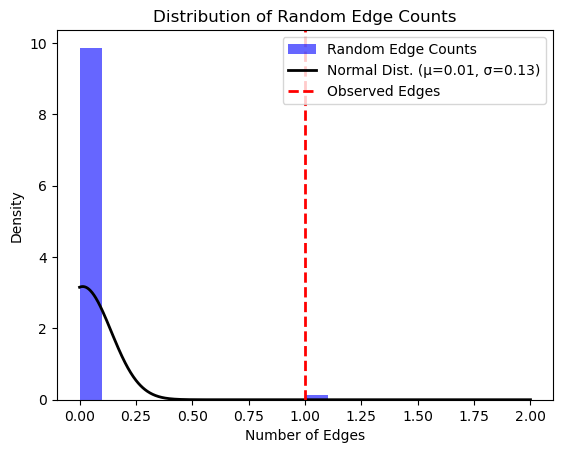

z score for a random nodes: 7.843202074411681

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004467/associations?projection=associationByLocation
Genes: 95

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SASH1%0dPANK1%0dARAP1%0dMADD%0dPCSK1%0dTCF7L2%0dC2CD4B%0dC2CD4A%0dVPS13C%0dSLC30A8%0dLARP6%0dSGSM2%0dSNX7%0dLYPLAL1%0dTMEM18%0dDPYSL5%0dGCKR%0dCOBLL1%0dLOC646736%0dIRS1%0dPPARG%0dTRAIP%0dITIH3%0dADCY5%0dLINC01214%0dFAM13A%0dTET2%0dHHIP%0dPDGFC%0dARL15%0dLOC101928448%0dLOC101927697%0dMICB%0dC6orf1%0dVEGFA%0dRSPO3%0dQKI%0dGRB10%0dPHTF2%0dKLF14%0dLOC157273%0dBLK%0dNKX2-6%0dGLIS3%0dTLE4%0dABO%0dPTEN%0dMACROD1%0dPDE3A%0dGYS2%0dHDAC7%0dHMGA2%0dIGF1%0dDNAH10%0dCOL4A2%0dRBL2%0dBCL2%0dINSR%0dMAP2K7%0dPEPD%0dCASC20%0dMYBL2%0dEYA2%0dD21S2088E%0dAR%0dCHRDL1%0dRPS10-NUDT3%0dNUDT3%0dFOXP4%0dSYT1%0dMTNR1B%0dCDKAL1%0dDHX37%0dKANK1%0dAXDND1%0dG6PC2%0dLINC02438%0dSLC9B1P3%0dJMJD1C%0dKIF11%0dAMBRA1%0dLINC02750%0dSPRY2%0dIRS2%0dEAPP%0dLRFN5%0d

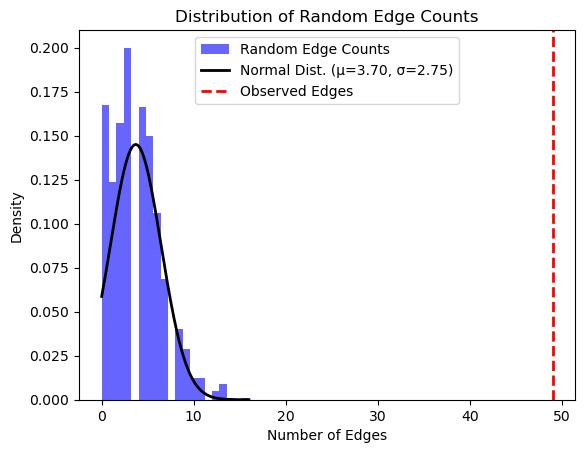

z score for a random nodes: 16.466740455421515

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000217/associations?projection=associationByLocation
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=CA10%0dCOL14A1%0dMRPL13%0dintergenic%0dLY86-AS1&species=9606

Proteins: 4

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed 

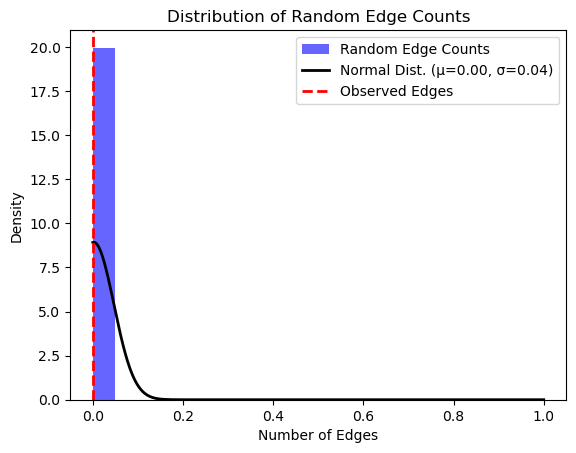

z score for a random nodes: -0.04476614810358452

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005148/associations?projection=associationByLocation
Genes: 292

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TCF7L2%0dSLC30A8%0dCDKAL1%0dCDC123%0dCAMK1D%0dSPRY2%0dHHEX%0dC2CD4B%0dNR%0dFTO%0dROR2%0dOSBPL1A%0dLIMS2%0dDAAM1%0dIGF2BP2%0dJAZF1%0dCDKN2A%0dCDKN2B%0dMHC%0dMACF1%0dTOMM40%0dAPOE%0dANKRD55%0dKCNJ11%0dPPARG%0dintergenic%0dMARCH1%0dPCNXL2%0dLPIN2%0dHMG20A%0dHUNK%0dPEX5L%0dCR2%0dC6orf57%0dACHE%0dTCERG1L%0dZPLD1%0dKIF11%0dFLJ16165%0dPLS1%0dHNF1A%0dIDE%0dZMIZ1%0dKCNQ1%0dARAP1%0dCENTD2%0dKLHDC5%0dPRC1%0dSLC16A13%0dHNF1B%0dTCF2%0dGIPR%0dC2CD4A/B%0dFAF1%0dGCKR%0dUBE2E2%0dPSMD6%0dADCY5%0dCCDC85A%0dFAM60A%0dDMRTA1%0dASB3%0dATP8B2%0dMIR4686%0dINAFM2%0dRPL19P16%0dC16orf74%0dADH5P4%0dZBTB20%0dKIAA1456%0dSALL4P5%0dMAEA%0dIGFBP2%0dGCC1%0dFSCN3%0dPAX4%0dMIR129%0dLEP%0dANK1%0dGLIS3%0dTLE4%0dTLE1%0dGPSM1%0dIG2BP2%0dHLA-DQA2%0dLAMA1%0dSH

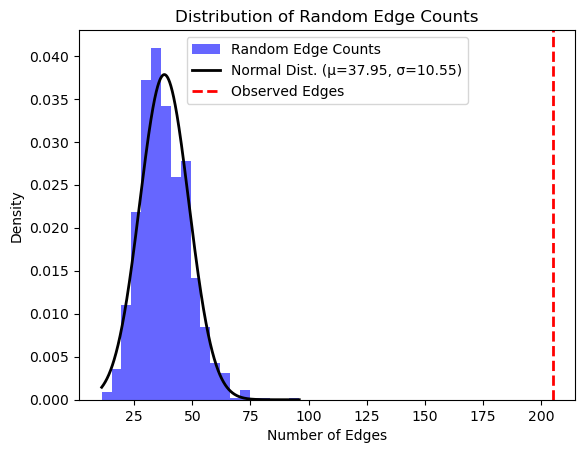

z score for a random nodes: 15.835505717049731

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004351/associations?projection=associationByLocation
Genes: 201

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=GJA1%0dMYH6%0dMYH7%0dNDNG%0dintergenic%0dSLC35F1%0dSLC12A9%0dUFSP1%0dFADS1%0dCD34%0dHMGB3P18%0dCANX%0dMAML1%0dCCDC141%0dSYT10%0dRNF220%0dCD46%0dGCKR%0dSPEG%0dB3GNT7%0dIP6K1%0dGNB4%0dSCLC35F1%0dGNGT1%0dMET%0dCHRM2%0dTP53I11%0dFADS2%0dCACNA1C%0dPDE3A%0dSOX5%0dCPNE8%0dRASSF3%0dRGS6%0dFLRT2%0dHCN4%0dMYH11%0dFHOD3%0dKIAA1755%0dCSMD1%0dASPH%0dICMT%0dKLHL42%0dMAPKAP1%0dZNF367%0dALG10B%0dGAREM%0dCDH2%0dGPATCH2%0dZNF800%0dCTAGE1%0dGATA6%0dCCDC58%0dPPARGC1A%0dPPFIA2%0dBCL11A%0dAPOE%0dAPOC1%0dPVRL2%0dNDRG2%0dARHGEF40%0dZNF219%0dSREBF1%0dRAI%0dCDH6%0dMKLN1%0dRNF207%0dCDC23%0dFRMD4B%0dTTN%0dADCK1%0dTEKT5%0dC19orf47%0dMAP3K10%0dZHX3%0dEMILIN3%0dFEN1%0dTMEM258%0dMYRF%0dTANC1%0dSRRT%0dACHE%0dEPHB4%0dGIGYF1%0dPCOLCE%0dGNG11%0dNMNAT1%0dLZI

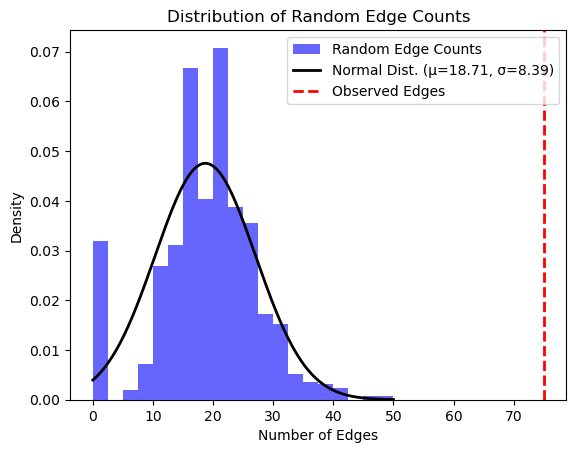

z score for a random nodes: 6.709077129100175

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006788/associations?projection=associationByLocation
Genes: 32

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=TTC7B%0dintergenic%0dMFAP3L%0dTMEM132D%0dGUCY1A2%0dOR8A1%0dCXCL1%0dDUPD1%0dPKD1L1%0dLOC152225%0dPDE4B%0dAURKB%0dIQCE%0dNR%0dNTRK2%0dMYH15%0dTMEM106B%0dGIGYF2%0dKCNJ13%0dSDK1%0dCNGB3%0dEDIL3%0dKNL1%0dRAD51-AS1%0dRAD51%0dRMDN3%0dGCHFR%0dDNAJC17%0dC15orf62%0dZFYVE19%0dPTPRT%0dADCY2&species=9606

Proteins: 30

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests fo

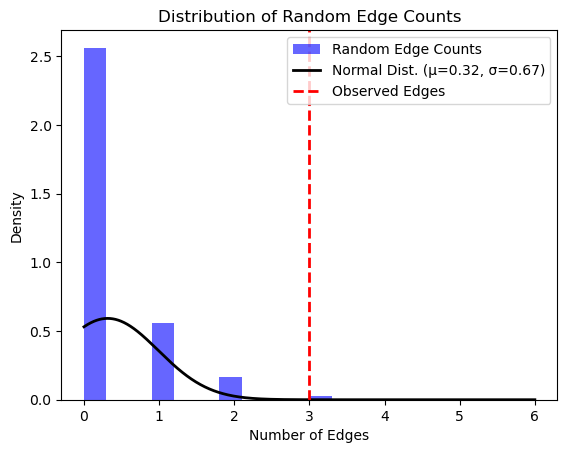

z score for a random nodes: 3.9858780518746793

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004579/associations?projection=associationByLocation
Genes: 29

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=FCER1A%0dRAD50%0dSUCLG2%0dHLA-DQB1%0dWWP2%0dHLA-DQA2%0dSTAT6%0dNAB2%0dIL13%0dHLA-G%0dHLA-A%0dDARC%0dOR10J3%0dIL4R%0dID2%0dLPP%0dOPRK1%0dDOCK10%0dOR6X1%0dHLA-DRB1%0dIL21R%0dHCG27%0dHLA-C%0dCRIM1%0dZNF71%0dTLN1%0dSYNPO2%0dLOC730217%0dCDH13&species=9606

Proteins: 25

Number of edges: 20

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-

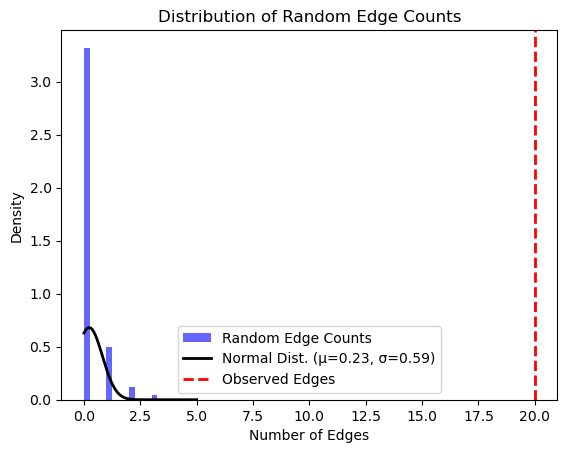

z score for a random nodes: 33.69554156917635

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0700076/associations?projection=associationByLocation
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=BMP2%0dBBS9&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for rando

/Users/aliaarman/Desktop/thesis/code/disease.py:15: RuntimeWarning: invalid value encountered in scalar divide
  z_score = (observed_edges - mean) / std
/Users/aliaarman/anaconda3/lib/python3.11/site-packages/scipy/stats/_distn_infrastructure.py:1988: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


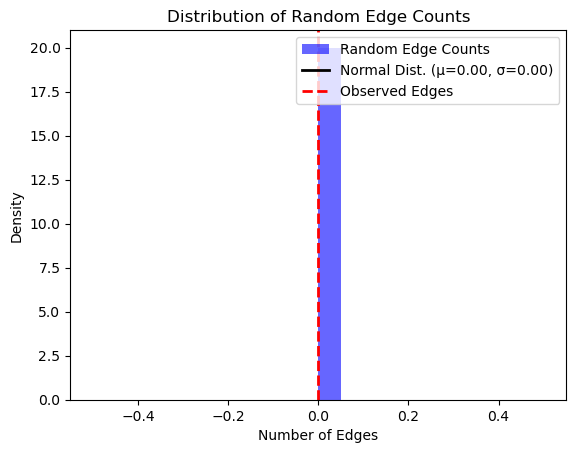

z score for a random nodes: nan

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0003819/associations?projection=associationByLocation
Genes: 212

%0dPKD2%0dSPP1%0dMEPE%0dIBSP%0dDMP1%0dDSPP%0dABCG2%0dATXN7L1%0dNT5DC1%0dBCORL1%0dEDNRA%0dTWSG1%0dIFT88%0dCTNNA3%0dZNF516%0dLPAR3%0dLPPR5%0dNKX2-3%0dTGFBR1%0dNR4A3%0dMYO16%0dACAD9%0dZNF827%0dNR%0dRARB%0dIRX4%0dIRX2%0dMIR346%0dTRAF3IP2%0dFAT3%0dMTNR1B%0dCD300E%0dSLC9A3R1%0dCHST8%0dKCTD15%0dC5orf66%0dCA12%0dALLC%0dPTGER3%0dZRANB2%0dMIR186%0dPGAP1%0dMIR1305%0dIQGAP2%0dS100Z%0dNDUFA4%0dTHSD7A%0dTAF1B%0dGRHL1%0dKLF11%0dPDIA6%0dHES1%0dLSG1%0dMIR148%0dSNX10%0dIFRD1%0dPTCH1%0dSLC5A12%0dCCDC34%0dLGR4%0dAPOBR%0dSH2B1%0dPLCG2%0dCDH13%0dCTSB%0dAIRE%0dTRPM2%0dTSPEAR%0dARHGEF16%0dSNORA47%0dCRHBP%0dF2R%0dPOLD1%0dACPT%0dKLK1%0dKLK4%0dSIGLEC9%0dCD33%0dFKBP14%0dNOD1%0dHS3ST4%0dCD1D%0dCD1A%0dCD1C%0dPYHIN1%0dLARP7%0dMIR302A%0dRUFY1%0dMAML1%0dGRM6%0dMIR6874%0dHPVC1%0dVSTM2A%0dEGFR%0dANGPT2%0dDEFB1%0dDEFA1%0dDEFA1B%0dDEFA1P%0dDEFA3%0dDEFA4%0dDEFA6

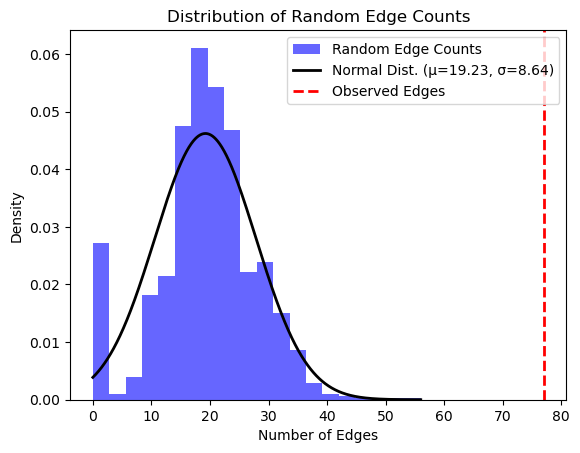

z score for a random nodes: 6.6893454039137605

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004611/associations?projection=associationByLocation
Genes: 196

%0dHIST1H4C%0dKSR2%0dPKNOX1%0dNR0B2%0dINSIG2%0dPPARA%0dABCG58%0dAPOH%0dPRXCA&species=9606=APOB%0dHMGCR%0dPCSK9%0dHLA-C%0dABO%0dHPR%0dLDLR%0dCELSR2%0dPSRC1%0dSORT1%0dCOL4A3BP%0dMGC2650%0dBLOC1S3%0dXTP7%0dAPOE%0dCILP2%0dPBX4%0dAPOC2%0dAPOC4%0dAPOC1%0dNCAN%0dB3GALT4%0dCADM1%0dAPOA5%0dBUD13%0dAPCDD1L%0dSTX16%0dIL1RAPL1%0dGK%0dSORL1%0dBLID%0dTOMM40%0dDZIP1%0dKIAA1199%0dLPA%0dLIMCH1%0dRNF175%0dCUX2%0dDHODH%0dHP%0dZHX3%0dNR%0dRPH3A%0dAQP9%0dLIPC%0dNR1H4%0dTNFAIP1%0dMIR4422%0dPLPP3%0dLOC101927787%0dLINC01132%0dHS1BP3%0dTIMD4%0dMIR148A%0dNFE2L3%0dUBXN2B%0dCYP7A1%0dTRIB1%0dLINC00861%0dZPR1%0dTBL2%0dOIT3%0dapoB%0dHNF1A%0dRORA%0dCARM1%0dRASIP1%0dHNF4A%0dC12orf51%0dIRF2BP2%0dGCKR%0dABCG8%0dIL1F10%0dGCNT4%0dHLA-DQB1%0dFRK%0dPPP1R3B%0dFADS2%0dST3GAL4%0dBRAP%0dRNF130%0dintergenic%0dTNIK%0dSMARCA4%0dDTNB%0dPDGFD%0dPLEKHO2%0dZF

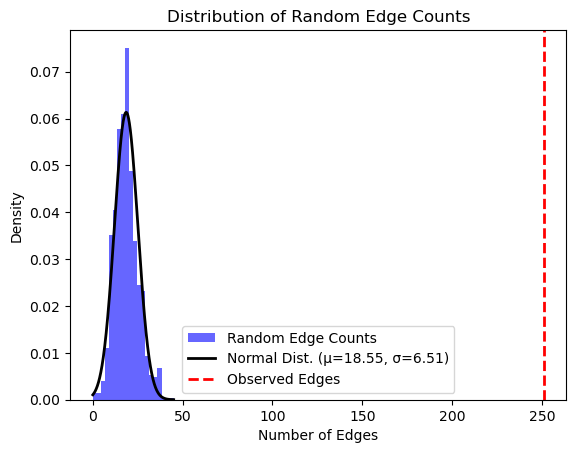

z score for a random nodes: 35.730033544449945

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0005129/associations?projection=associationByLocation
Genes: 73

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PPARD%0dCCDC102A%0dHSPA1A46%0dLINC02429%0dMIR548AG1%0dNR%0dCDKN2C%0dEFNA3%0dADCK3%0dSOX2%0d0T%0dHLA-DQB1%0dTHSD7A%0dIGFBP3%0dLOC730338%0dZNF800%0dLOC157273%0dTNKS%0dCDKN2B-AS1%0dDMRTA1%0dBAMBI%0dLINC01517%0dRIC8A%0dLOC338694%0dOCA2%0dWWP2%0dPLEKHH3%0dNPLOC4%0dMETRNL%0dJAG1%0dLOC101929395%0dSLC24A3%0dLRP1B%0dKYNU%0dOT%0dTNS3%0dCASP7%0d5' LOC338694%0dCAPRIN2%0dPLB1%0dCDKN2B%0dRBFOX1%0dSEPT9%0dCASZ1%0dADGRL2%0dFAM46C%0dLINC00970%0dTRIB2%0dDIRC3%0dRARB%0dATXN7%0dC4orf22%0dBMP3%0dKCNQ5%0dQKI%0dCREB5%0dBIN3%0dEGR3%0dPLCE1%0dODF3%0dBET1L%0dMVK%0dFAM222A%0dSTXBP6%0dBMP4%0dRORA%0dVPS13C%0dALDOA%0dRHOT1%0dRHBDL3%0dMIR2117HG%0dCPAMD8%0dHORMAD2&species=9606

Proteins: 59

Number of edges: 3

Failed to retrieve data: 429 Client Error

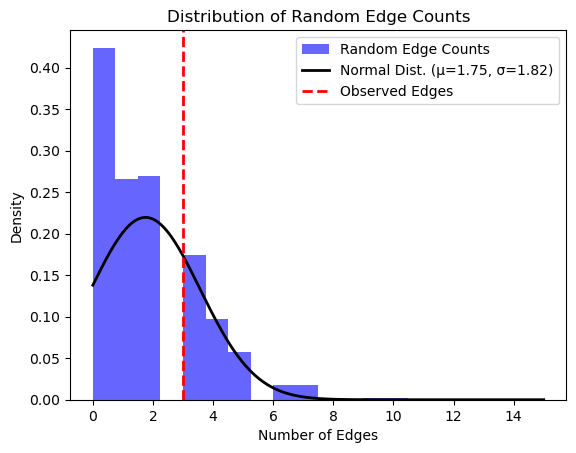

z score for a random nodes: 0.686949766062811

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004535/associations?projection=associationByLocation
Genes: 43

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DYSF%0dHPN%0dSCN1B%0dFNDC4%0dGCKR%0dSERPINF2%0dWDR81%0dTNFRSF11A%0dZCCHC2%0dFCGRT%0dRPS11%0dFRMD5%0dWDR76%0dPSMC3%0dGCKR-FNDC4%0dCHRNA5%0dCHRNA3%0dLOC100129550%0dSEMA5B%0dRGS12%0dSPCS3%0dVEGFC%0dTNPO1%0dFCHO2%0dHLA-C%0dHLA-B%0dMLXIPL%0dVPS37D%0dPTPN3%0dSERPINA5%0dCYP1A2%0dCSK%0dTNFRSF13B%0dHPN-AS1%0dLINC01094%0dBMP2K%0dLOC401312%0dLOC541472%0dGSG1%0dEMP1%0dMIR150%0dNR%0dSLC14A2&species=9606

Proteins: 36

Number of edges: 2

Random edges calculation completed.



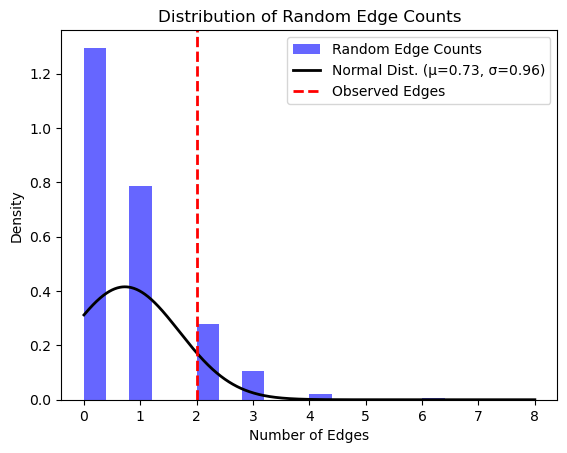

z score for a random nodes: 1.3254154924807433

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005420/associations?projection=associationByLocation
Genes: 14

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=PIK3C2G%0dHS3ST5%0dTBXAS1%0dNR%0dGMDS%0dASCC3%0dPSD3%0dOBFC1%0dRFX7%0dSEMA5B%0dLOC100132731%0dRBPMS%0dCUBN%0dNTN1&species=9606

Proteins: 13

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Reque

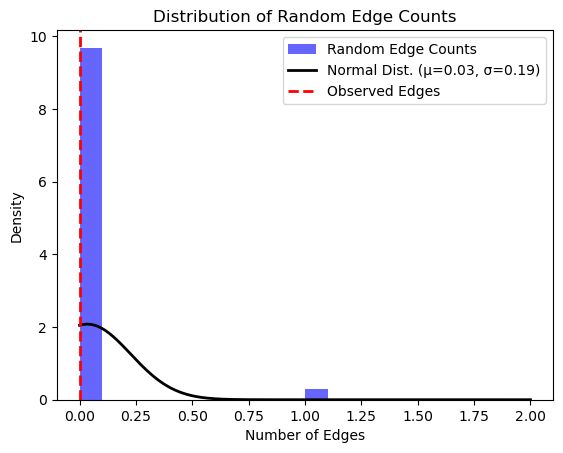

z score for a random nodes: -0.177131389816981

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004776/associations?projection=associationByLocation
Genes: 13

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SIX3%0dRGPD2%0dSH3BP5%0dNR2C2%0dZFYVE20%0dHIVEP1%0dPLEKHG1%0dPKNOX2%0dLOC339568%0dKCND2%0dNA%0dHTR1A%0dIPO11&species=9606

Proteins: 11

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests f

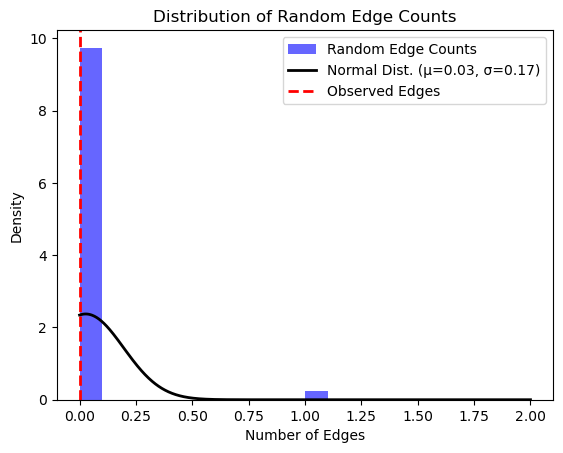

z score for a random nodes: -0.16058063792223523

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005668/associations?projection=associationByLocation
Genes: 4

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HTR3D%0dHTR3C%0dABCC5%0dPARL&species=9606

Proteins: 4

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clust

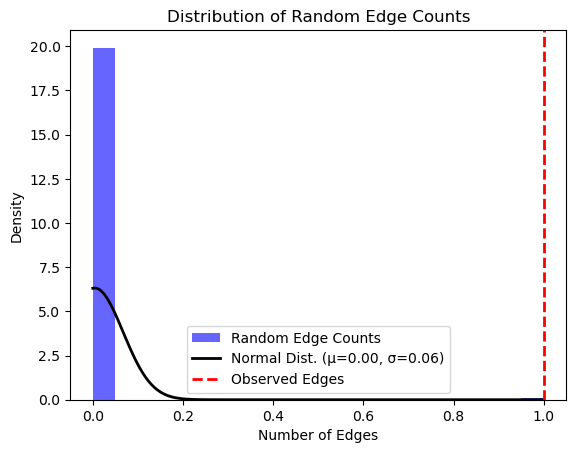

z score for a random nodes: 15.7797338380595

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0015263/associations?projection=associationByLocation
Genes: 16

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SCN5A%0dNCOA7%0dHEY2%0dSCN10A%0dHDDC2%0dTBX20%0dGATA4%0dZFPM2%0dWT1%0dTBX5%0dIRX3%0dCRNDE%0dIRX5%0dPRKCA%0dMAPRE2%0dMYO18B&species=9606

Proteins: 15

Number of edges: 11

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-n

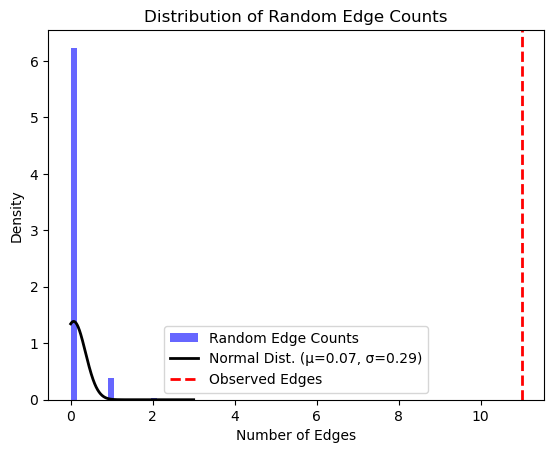

z score for a random nodes: 37.973756495509065

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004214/associations?projection=associationByLocation
Genes: 41

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=DAB2IP%0dCKDN2B%0dCDKN2A%0dLRP1%0dLDLR%0dRBBP8%0dCDKN2B%0dCDKN2BAS%0dANKRD44%0dFBN1%0dCDKN2B-AS1%0dANRIL%0dCELSR2%0dPSRC1%0dSORT1%0dIL6R%0dSMYD2%0dLINC00540%0dZNF335%0dPCIF1%0dMMP9%0dERG%0dFERMT1%0dC2orf43%0dGDF7%0dAC012065.7%0dMEPE%0dCDKN1A%0dRP11-136O12.2%0dTRIB1%0dLIPA%0dZNF259%0dAPOA5%0dADAMTS8%0dCRISPLD2%0dCTAGE1%0dAPOE%0dPCSK9%0dLPA%0dCHRNA3%0dABHD16B&species=9606

Proteins: 34

Number of edges: 22

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data

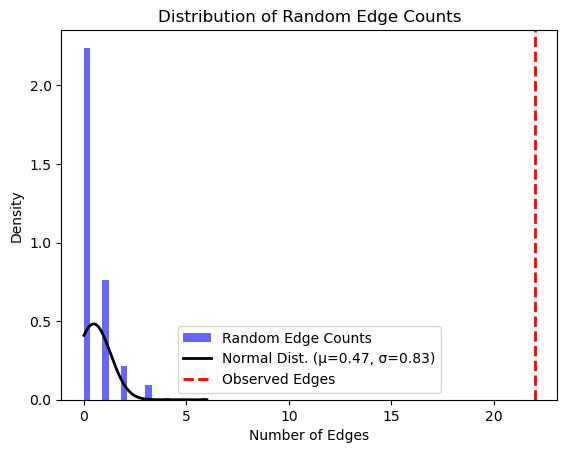

z score for a random nodes: 26.03835937171938

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/Orphanet_93957/associations?projection=associationByLocation
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dARSG&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for rand

/Users/aliaarman/Desktop/thesis/code/disease.py:15: RuntimeWarning: invalid value encountered in scalar divide
  z_score = (observed_edges - mean) / std
/Users/aliaarman/anaconda3/lib/python3.11/site-packages/scipy/stats/_distn_infrastructure.py:1988: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


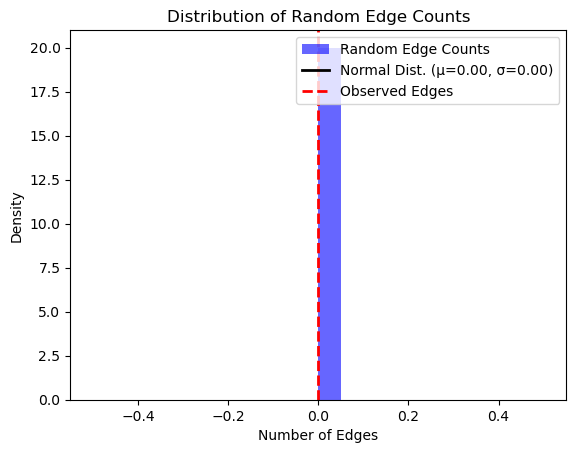

z score for a random nodes: nan

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004220/associations?projection=associationByLocation
Genes: 21

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=AKD2%0dintergenic%0dIL28B%0dDDRGK1%0dITPA%0dKIAA0494%0dARHGEF10L%0dDNASE2B%0dSCG2%0dCWH43%0dSLC22A3%0dRP11-157J24.1%0dEPHA7%0dOLFM1%0dIL28A%0dIL29%0dIL-28B%0dHLA%0dHLA-DQB1%0dHLA-DQA1%0dDEPDC5&species=9606

Proteins: 19

Number of edges: 6

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random 

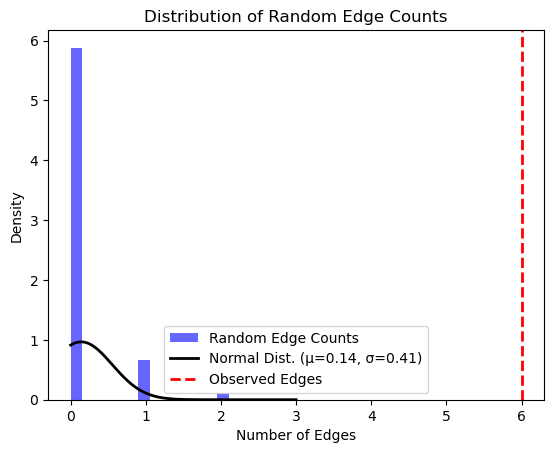

z score for a random nodes: 14.195896385167222

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000403/associations?projection=associationByLocation
Genes: 23

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=LNX2%0dCDC42BPB%0dEXOC2%0dARAP3%0dNCOA1%0dITSN2%0dMYC%0dPVT1%0dNR%0dHLA-B%0dCD86%0dMMEL1%0dIntergenic%0dTNPO2%0dNCOA5%0dLOC440836%0dARGFXP1%0dSNCAIP%0dSNX2%0dLOC100652953%0dMARCKS%0dHDAC2%0dKALRN&species=9606

Proteins: 19

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clusterin

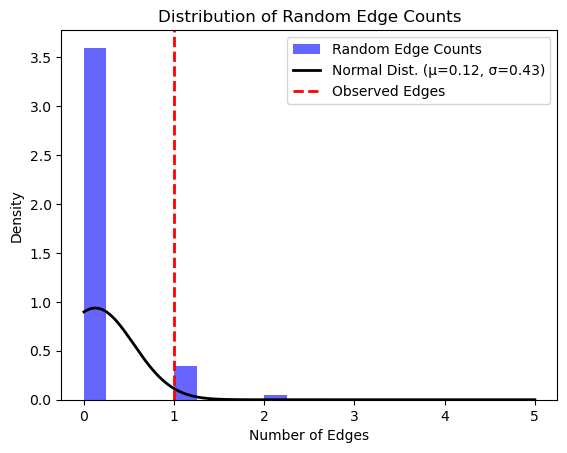

z score for a random nodes: 2.0545624206091153

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0018092/associations?projection=associationByLocation
Genes: 9

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=EGR2%0dADO%0dZNF365%0dC1orf141%0dIL23R%0dHLA-DRA%0dHLA-DRB5%0dHLA-DRB1%0dHLA-DQA1&species=9606

Proteins: 9

Number of edges: 6

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.o

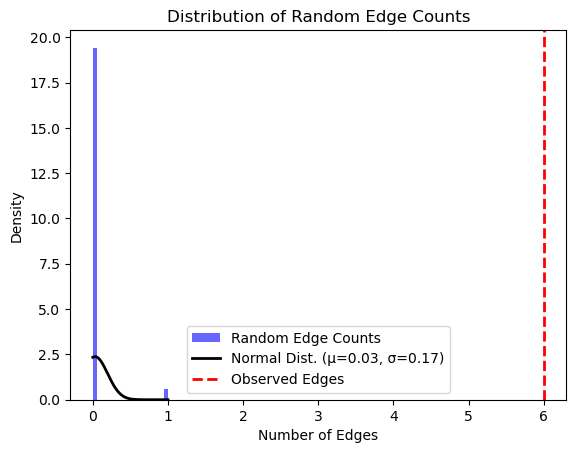

z score for a random nodes: 35.58266380247474

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0006342/associations?projection=associationByLocation
Genes: 10

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NPY%0dOSTCP2%0dCTD-2353F22.1%0dFCER1G%0dDEFA1A3%0dAC018755.18%0dSIGLEC5%0dCRYBB2P1%0dABLIM2%0dGRK5&species=9606

Proteins: 5

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: http

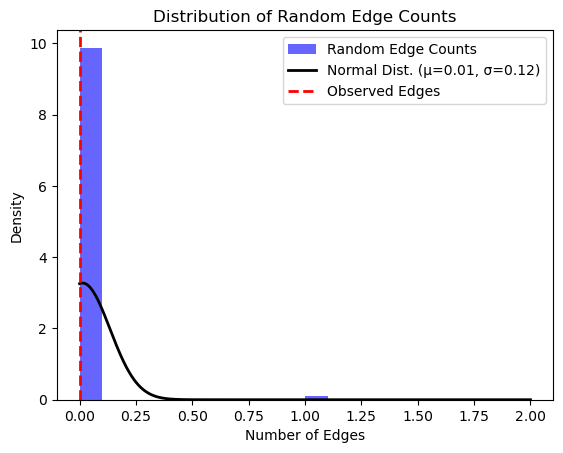

z score for a random nodes: -0.10674760375242262

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005941/associations?projection=associationByLocation
Genes: 18

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=AREG%0dPRDM6%0dESR1%0dMAGI2%0dZNF365%0dLSP1%0dTNNT3%0dintergenic%0dIGF1%0dC20orf187%0dTMEM184B%0dPLA2G6%0dSGSM3%0dMKL1%0dTNRC6B%0dNR%0dPRKG1%0dCSTF2T&species=9606

Proteins: 17

Number of edges: 1

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve 

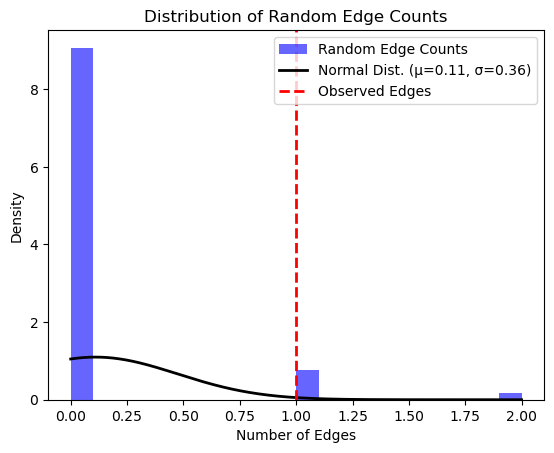

z score for a random nodes: 2.4505728005501197

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005942/associations?projection=associationByLocation
Genes: 3

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=SV2C%0dPARVB%0dintergenic&species=9606

Proteins: 3

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering

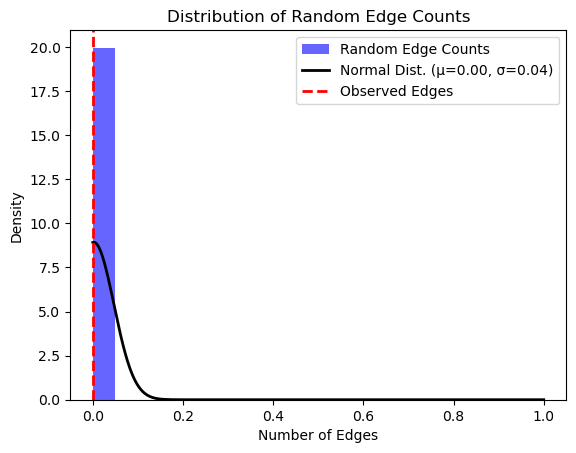

z score for a random nodes: -0.04476614810358452

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0011599/associations?projection=associationByLocation
Genes: 5

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=HLA%0dERAP2%0dLNPEP%0dERAP1%0dTECPR2&species=9606

Proteins: 5

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retr

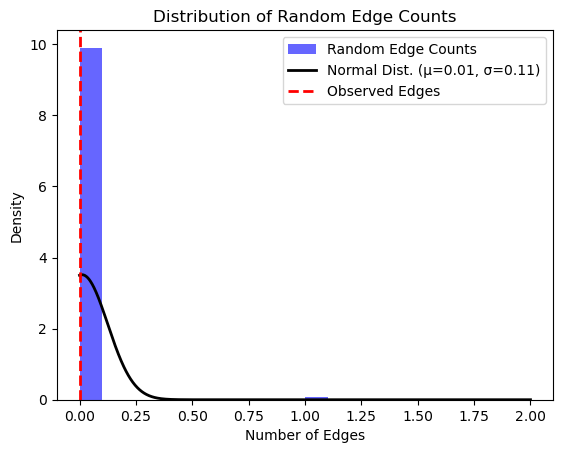

z score for a random nodes: -0.09692852714332871

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004791/associations?projection=associationByLocation
Genes: 6

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NEGR1%0dPLAT%0dSTX2%0dSERPINE1%0dSTXBP5%0dPOLB&species=9606

Proteins: 6

Number of edges: 2

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed

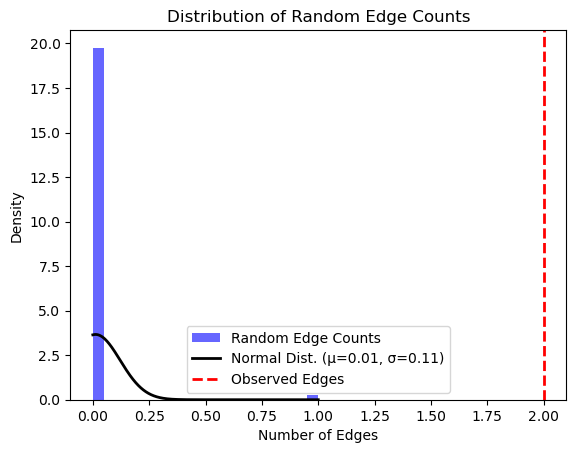

z score for a random nodes: 18.257751205510527

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0000195/associations?projection=associationByLocation
Genes: 148

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=BUD13%0dCETP%0dZNF259%0dLPL%0dAPOA5%0dFADS1%0dFADS2%0dGLTP%0dTCF7L2%0dPKMYT1%0dERCC4%0dSTOML3%0dC11orf10%0dFLJ41733%0dGIT2%0dHERPUD1%0dPMAIP1%0dZNF644%0dENG%0dCRTAC1%0dDYRK1A%0dEDC4%0dLIPC%0dSMEK2%0dAPOB%0dGCKR%0dGALNT2%0dHCG26%0dMICB%0dABCA1%0dNR1H3%0dMLXIPL%0dAPOE%0dTOMM40%0dFTO%0dG6PC2%0dTMEM195%0dDGKB%0dGCK%0dCAMK2B%0dMTNR1B%0dC12orf51%0dMYL2%0dALDH2%0dSTAM2%0dCOLEC12%0dSLC18A1%0dZPR1%0dAPOA4%0dSIK3%0dHECTD4%0dLOC101929011%0dGPR139%0dZNF664%0dPDXDC1%0dSNX10%0dTMEM18%0dHLA-B%0dTYRO3%0dSLC39A8%0dPGS1%0dNAALADL1%0dLINC01524%0dLOC101927237%0dRSPO3%0dRBM6%0dHMGA1%0dCD300LG%0dTRIB1%0dANGPTL4%0dAPOC1%0dGADD45G%0dBPTF%0dLINC01122%0dARNT%0dTNRC6A%0dHLA-DRB1%0dLIPG%0dDR1%0dOR5R1%0dMLLT10%0dPURG%0dERICH2%0dCD68%0dKMT2A%0dSEC16B%

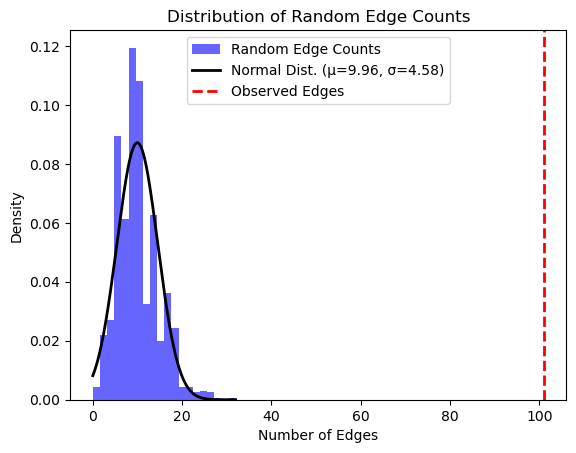

z score for a random nodes: 19.887365635706512

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0005039/associations?projection=associationByLocation
Genes: 37

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=APOE%0dTTC27%0dMETTL8%0dCHD6%0dSLC1A7%0dSELP%0dF5%0dGCFC2%0dintergenic%0dTLE1%0dLHFP%0dCOL18A1%0dS100A5%0dNR%0dSCAMP1%0dLHFPL2%0dARSB%0dEFNA5%0dIKZF1%0dMAGI2%0dMAL2%0dPRUNE2%0dRP11-232A1.1%0dARID2%0dSFRS2IP%0dCAND1%0dFRMD6%0dC20orf132%0dRPN2%0dZBP1%0dFDPSP%0dVAMP4%0dPGM2L1%0dP4HA3%0dAPOC1%0dTOMM40%0dMIR302F&species=9606

Proteins: 34

Number of edges: 3

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Clie

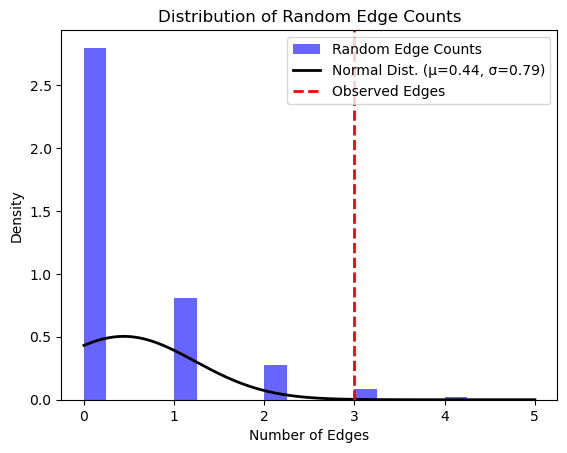

z score for a random nodes: 3.2294002690943615



In [7]:
non_cancerous_clustering = compute_clustering(noncancerous[:100], 'noncancerous_output.txt')


In [9]:
non_efos = []
for e in non_cancerous_clustering:
    non_efos.append(e['efoID'])
print(non_efos)
print(len(non_efos))

['EFO_0000274', 'EFO_0000676', 'EFO_0005427', 'EFO_0006516', 'MONDO_0018309', 'EFO_0006522', 'EFO_0006523', 'EFO_0004314', 'EFO_0005854', 'EFO_0003918', 'EFO_0003884', 'EFO_0004239', 'EFO_0004216', 'EFO_0005426', 'EFO_0003756', 'EFO_0003758', 'EFO_0004197', 'EFO_0000729', 'MONDO_0005090', 'EFO_0004270', 'MONDO_0004979', 'EFO_0004232', 'MONDO_0005301', 'EFO_0005532', 'EFO_0004541', 'EFO_0004235', 'MONDO_0007915', 'MONDO_0005180', 'EFO_0004311', 'EFO_0001358', 'MONDO_0016046', 'EFO_0000341', 'EFO_0004465', 'EFO_0004190', 'EFO_0005208', 'MONDO_0007079', 'EFO_0003894', 'EFO_0005187', 'EFO_0004307', 'EFO_0000537', 'EFO_0005676', 'EFO_0000555', 'EFO_0000649', 'EFO_0005669', 'EFO_0005782', 'MONDO_0005178', 'EFO_0005678', 'MONDO_0004975', 'EFO_0003888', 'EFO_0004265', 'EFO_0001645', 'EFO_0004570', 'EFO_0004534', 'EFO_0000474', 'EFO_0003095', 'EFO_0001378', 'EFO_0004274', 'EFO_0004251', 'EFO_0006882', 'EFO_1000656', 'EFO_1000651', 'MONDO_0005147', 'EFO_0005045', 'EFO_0005080', 'EFO_0005081', 'E

In [11]:
null_noncancerous_genes = []
for i in range(len(noncancerous[:100])):
    if noncancerous[i][1] not in non_efos:
        null_noncancerous_genes.append(noncancerous[i])
print(null_noncancerous_genes)

[('body mass index', 'EFO_0004340')]


In [26]:
for i in range(len(non_cancerous_clustering)):
    if np.isnan(non_cancerous_clustering[i]['z_score']):
        print(non_cancerous_clustering[i])

{'name': 'exfoliation syndrome', 'efoID': 'EFO_0004235', 'num_edges': 0, 'z_score': nan}
{'name': 'familial clubfoot with or without associated lower limb anomalies', 'efoID': 'MONDO_0016046', 'num_edges': 0, 'z_score': nan}
{'name': 'isolated scaphocephaly', 'efoID': 'EFO_0700076', 'num_edges': 0, 'z_score': nan}
{'name': 'Limb dystonia', 'efoID': 'Orphanet_93957', 'num_edges': 0, 'z_score': nan}


Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/Orphanet_93957/associations?projection=associationByLocation
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=NR%0dARSG&species=9606

Proteins: 2

Number of edges: 0

Random edges calculation completed.



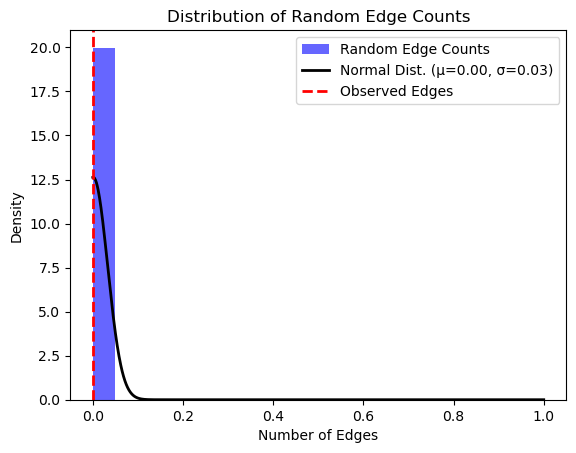

z score for a random nodes: -0.03163859985841663



(0, -0.03163859985841663)

In [30]:
d = Disease('Limb dystonia', 'Orphanet_93957')
d.quantify_clustering()

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0700076/associations?projection=associationByLocation
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=BMP2%0dBBS9&species=9606

Proteins: 2

Number of edges: 0

Random edges calculation completed.



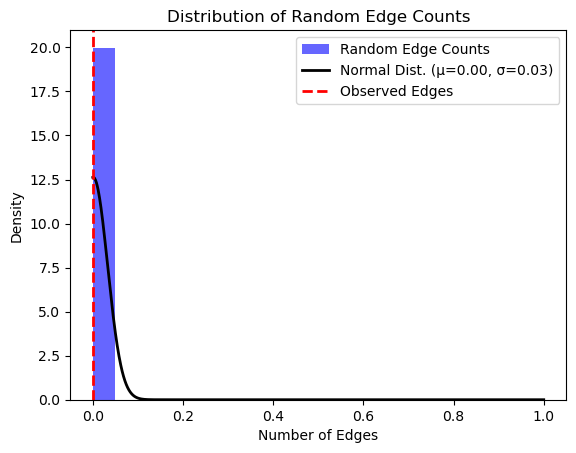

z score for a random nodes: -0.031638599858416626



(0, -0.031638599858416626)

In [29]:
d = Disease('isolated scaphocephaly', 'EFO_0700076')
d.quantify_clustering()

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/EFO_0004235/associations?projection=associationByLocation
Genes: 3

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=LOXL1%0dTBC1D21%0dCACNA1A&species=9606

Proteins: 3

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Random edges calculation completed.



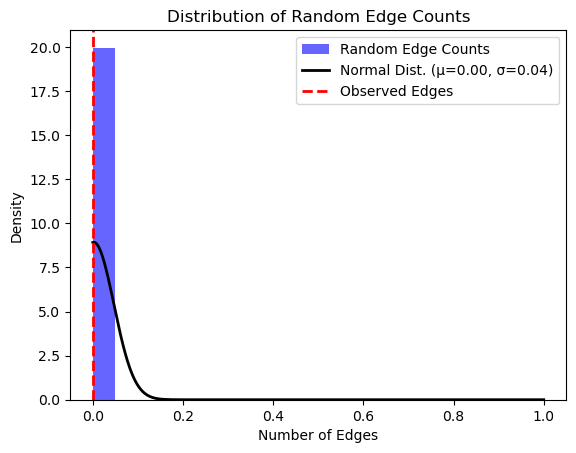

z score for a random nodes: -0.04476614810358452



(0, -0.04476614810358452)

In [27]:
d = Disease('exfoliation syndrome', 'EFO_0004235')
d.quantify_clustering()

Get genes url: https://www.ebi.ac.uk/gwas/rest/api/efoTraits/MONDO_0016046/associations?projection=associationByLocation
Genes: 2

retrieve proteins url: https://string-db.org/api/tsv-no-header/get_string_ids?identifiers=ZNF664%0dNCOR2&species=9606

Proteins: 2

Number of edges: 0

Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/networkFailed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.

Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Client Error: Too Many Requests for url: https://string-db.org/api/tsv-no-header/network
Failed to retrieve clustering data for random nodes.
Failed to retrieve data: 429 Clie

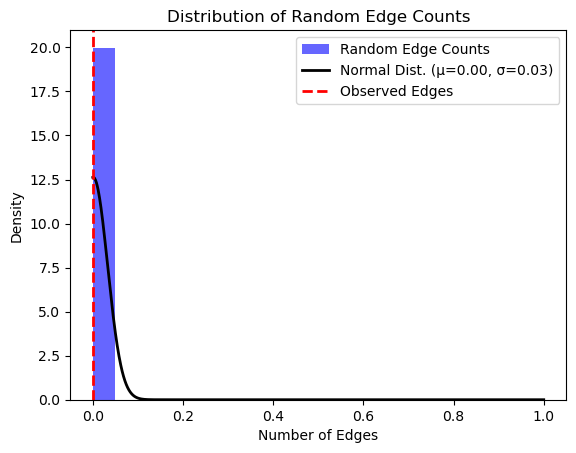

z score for a random nodes: -0.03163859985841663



(0, -0.03163859985841663)

In [28]:
d = Disease('familial clubfoot with or without associated lower limb anomalies', 'MONDO_0016046')
d.quantify_clustering()

In [31]:
for i in range(len(non_cancerous_clustering)):
    if non_cancerous_clustering[i]['efoID'] == 'EFO_0004235':
        non_cancerous_clustering[i]['z_score'] = -0.04476614810358452

for i in range(len(non_cancerous_clustering)):
    if non_cancerous_clustering[i]['efoID'] == 'MONDO_0016046':
        non_cancerous_clustering[i]['z_score'] = -0.03163859985841663
        
for i in range(len(non_cancerous_clustering)):
    if non_cancerous_clustering[i]['efoID'] == 'EFO_0700076':
        non_cancerous_clustering[i]['z_score'] = -0.031638599858416626

for i in range(len(non_cancerous_clustering)):
    if non_cancerous_clustering[i]['efoID'] == 'Orphanet_93957':
        non_cancerous_clustering[i]['z_score'] = -0.03163859985841663


/var/folders/4g/n465f8j14bq_nt2x3wjkt8pw0000gn/T/ipykernel_43642/3120185029.py:56: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([cancer_edges, non_cancer_edges], labels=['Cancerous', 'Non-Cancerous'])


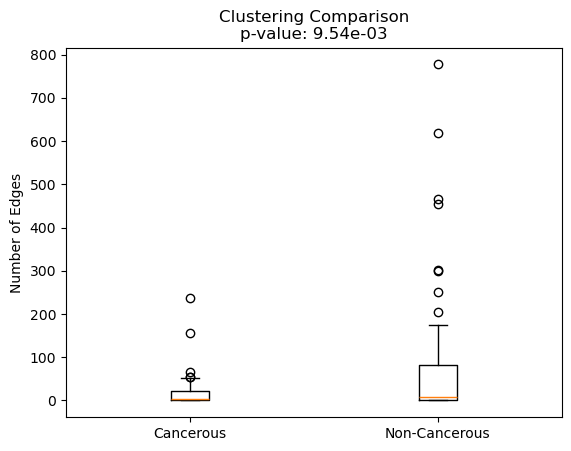

/var/folders/4g/n465f8j14bq_nt2x3wjkt8pw0000gn/T/ipykernel_43642/3120185029.py:65: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([cancer_z, non_cancer_z], labels=['Cancerous', 'Non-Cancerous'])


True number of edges
T-statistic: -2.6864160840004487, P-value: 0.00953602384331415



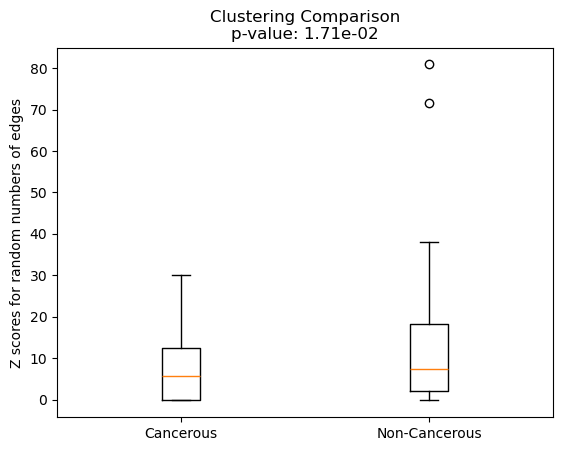

Z scores for random numbers of edges
T-statistic: -2.443818783866434, P-value: 0.01708455843793918



In [32]:
compare(cancerous_clustering, non_cancerous_clustering)